# This script is organized as the following:
1. Data cleaning
  1. Format 'date' column to proper format
  2. Fill in missing dates
  3. Forward fill the missing sales values
2. Data exploration
  1. Line plot
  2. Box plot
  3. Seasonal decomposition plot
3. Statistical testing
  1. Stationary tests(obs)
  2. Log(obs)
    * Line plot
    * Stationary test
  3. Diff(obs)
    * Stationary test
  4. Diff(Log())
    * Stationary test
  5. Seasonal(obs)
    * Stationary test
  6. Seasonal(log)
    * Stationary test
  7. Seasonal(diff())
    * Stationary test
  8. Seasonal(diff(log))
    * Stationary test
4. Model building
  1. Seasonal(obs)
    1. ACF/PACF plots
    2. Model grid search
    3. Residual diagonostic plots
  2. Seasonal(log)
    1. ACF/PACF plots
    2. Model grid search
    3. Residual diagonostic plots
  3. Seasonal(diff(obs))
    1. ACF/PACF plots
    2. Model grid search
    3. Residual diagonostic plots
5. Forecasting
  1. Seasonal(obs)
  2. Seasonal(log)
  3. Seasonal(diff(obs))

#### NOTE: If you want to quickly see the overview, just go to the end and read the summary

In [1]:
%matplotlib inline
import numpy as np
import pandas as pd

import datetime

import matplotlib.pyplot as plt
import pylab
from matplotlib.pylab import rcParams
import matplotlib.gridspec as gridspec
rcParams['figure.figsize'] = 15, 6

import statsmodels.api as sm  
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import adfuller, acf, pacf, q_stat
from statsmodels.graphics.gofplots import qqplot

from sklearn.metrics import mean_squared_error
from math import sqrt

# Step 1) Data cleaning
### 1.1) Format 'date' column to proper format
### 1.2) Fill in missing dates, i.e. category L only has half of the dates
### 1.3) Fill the missing sales values with 0 - assume 0 sales for that day due to holiday
#### - Note: we are going to forecast 90 days ahead, so our basic unit is day not hours. So we will group the data into daily sales

In [2]:
np.random.seed(42)
data = pd.read_csv('../data/siteA.csv')

In [3]:
data['Date_Name'] = data['Date_Name'].apply(lambda x: datetime.datetime.strptime(x,'%Y-%m-%d'))

In [4]:
data.head()

,Date_Name,subCategory,Purchase_Hour,sales
0,2016-02-10,A,20,8.34
1,2016-02-07,A,15,5.84
2,2016-02-28,A,18,7.38
3,2015-09-28,A,7,12.30
4,2015-09-29,A,7,24.03


In [4]:
print data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 66160 entries, 0 to 66159
Data columns (total 4 columns):
Date_Name        66160 non-null datetime64[ns]
subCategory      66160 non-null object
Purchase_Hour    66160 non-null int64
sales            66160 non-null float64
dtypes: datetime64[ns](1), float64(1), int64(1), object(1)
memory usage: 2.0+ MB
None


In [5]:
# Make a dataframe for each category, and put it into a list...len(list) = 16
# Essentially becomes a list of dataframe

def make_dataframe(df, lis):
    f = lambda x: df[df['subCategory'] == x]
    return map(f, lis)

temp_list = data['subCategory'].unique()
splitted_data = make_dataframe(data, temp_list)
print len(splitted_data)
print splitted_data[2][0:5]

16
      Date_Name subCategory  Purchase_Hour   sales
9259 2016-03-01           C              7  460.34
9260 2016-03-04           C              7  414.03
9261 2016-03-07           C              7  370.37
9262 2016-03-08           C              7  368.68
9263 2016-03-11           C              7  439.15


In [6]:
# Looks like some have missing dates, like category L has only half of the dates.

idx = pd.date_range('09-26-2015', '09-30-2016')

for i, item in enumerate(temp_list):
    splitted_data[i] = splitted_data[i].groupby(by=['Date_Name'])['sales'].sum()
    print item, ':', splitted_data[i].shape
    
    # We fill in the missing dates with value 0. Because this may be holiday and the shop made 0 sales.
    splitted_data[i].index = pd.DatetimeIndex(splitted_data[i].index)
    splitted_data[i] = splitted_data[i].reindex(idx, fill_value=0)
    print item, ':', splitted_data[i].shape, '-', splitted_data[i].index

print '\n', splitted_data[0].head()

A : (345,)
A : (371,) - DatetimeIndex(['2015-09-26', '2015-09-27', '2015-09-28', '2015-09-29',
               '2015-09-30', '2015-10-01', '2015-10-02', '2015-10-03',
               '2015-10-04', '2015-10-05',
               ...
               '2016-09-21', '2016-09-22', '2016-09-23', '2016-09-24',
               '2016-09-25', '2016-09-26', '2016-09-27', '2016-09-28',
               '2016-09-29', '2016-09-30'],
              dtype='datetime64[ns]', length=371, freq='D')
B : (345,)
B : (371,) - DatetimeIndex(['2015-09-26', '2015-09-27', '2015-09-28', '2015-09-29',
               '2015-09-30', '2015-10-01', '2015-10-02', '2015-10-03',
               '2015-10-04', '2015-10-05',
               ...
               '2016-09-21', '2016-09-22', '2016-09-23', '2016-09-24',
               '2016-09-25', '2016-09-26', '2016-09-27', '2016-09-28',
               '2016-09-29', '2016-09-30'],
              dtype='datetime64[ns]', length=371, freq='D')
C : (345,)
C : (371,) - DatetimeIndex(['2015-09-26',

In [8]:
# Check for both zero values and NA values.

print 'Zeros: ', map(lambda df: df[df==0].shape, splitted_data)
print 'NAs: ', map(lambda df: df.isnull().values.sum(), splitted_data)

Zeros:  [(26,), (26,), (26,), (52,), (32,), (26,), (26,), (26,), (41,), (28,), (177,), (26,), (26,), (25,), (71,), (43,)]
NAs:  [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


# Step 2) Data exploratory
### - We observe shop has no sales during Xmas season, Dec end~Jan beginning
### - Low sales volume during summer, May~Sep
### - Weekly seasonal effect: weekend usually lower sales volume than weekday
### - Category M has some anomalies in the summer
### - Category L are only sold half of the time in the whole year
### - Maybe it's a shop in a college cafeteria? Low student volume during the weekend, Xmas, & summer.

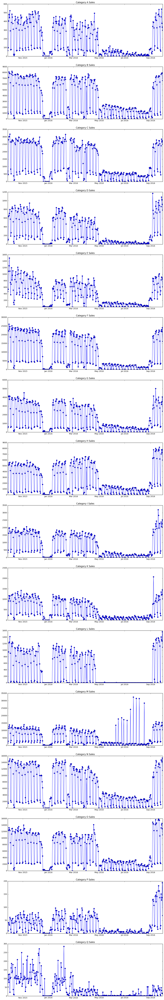

In [9]:
# Time series in connected point plot format for each category.
# We can see the missing dates(or date with 0 sales) in the time series this way

fig, axs = plt.subplots(16,1, figsize=(15, 96))
axs = axs.ravel()

for i, item in enumerate(data['subCategory'].unique()):
    axs[i].plot(splitted_data[i].index, splitted_data[i], '-o')
    axs[i].set_title('Category {} Sales'.format(item))

# Boxplots tell us: large value span from 50%~75% percentile.
## * 50% of the observations are below a small dollar value, 
## * while 75% of the observations are below a large dollar value

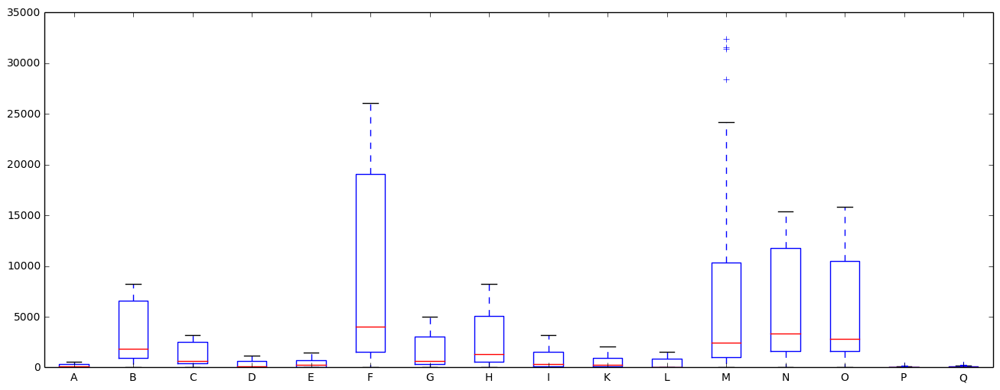

In [249]:
_ = plt.boxplot(splitted_data)
_ = plt.xticks(range(1, 17), temp_list)

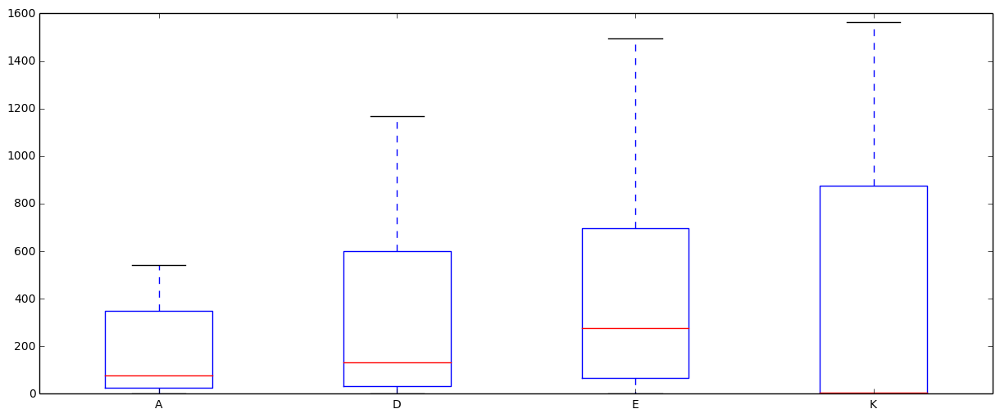

In [29]:
_ = plt.boxplot([splitted_data[0], splitted_data[3], splitted_data[4], splitted_data[10]])
_ = plt.xticks(range(1, 5), ['A', 'D', 'E', 'K'])

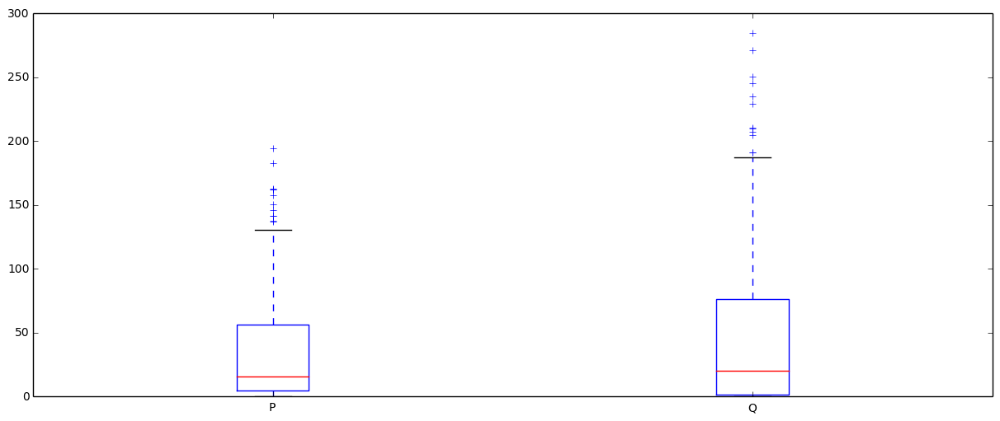

In [27]:
_ = plt.boxplot([splitted_data[14], splitted_data[15]])
_ = plt.xticks([1, 2], ['P', 'Q'])

# Histogram: 2 mountains. One is weekday sales, one is weekend sales. 
## * No sales in between the mountains.
## * Zero sales account for a good amount, so how we fill the missing values matter.

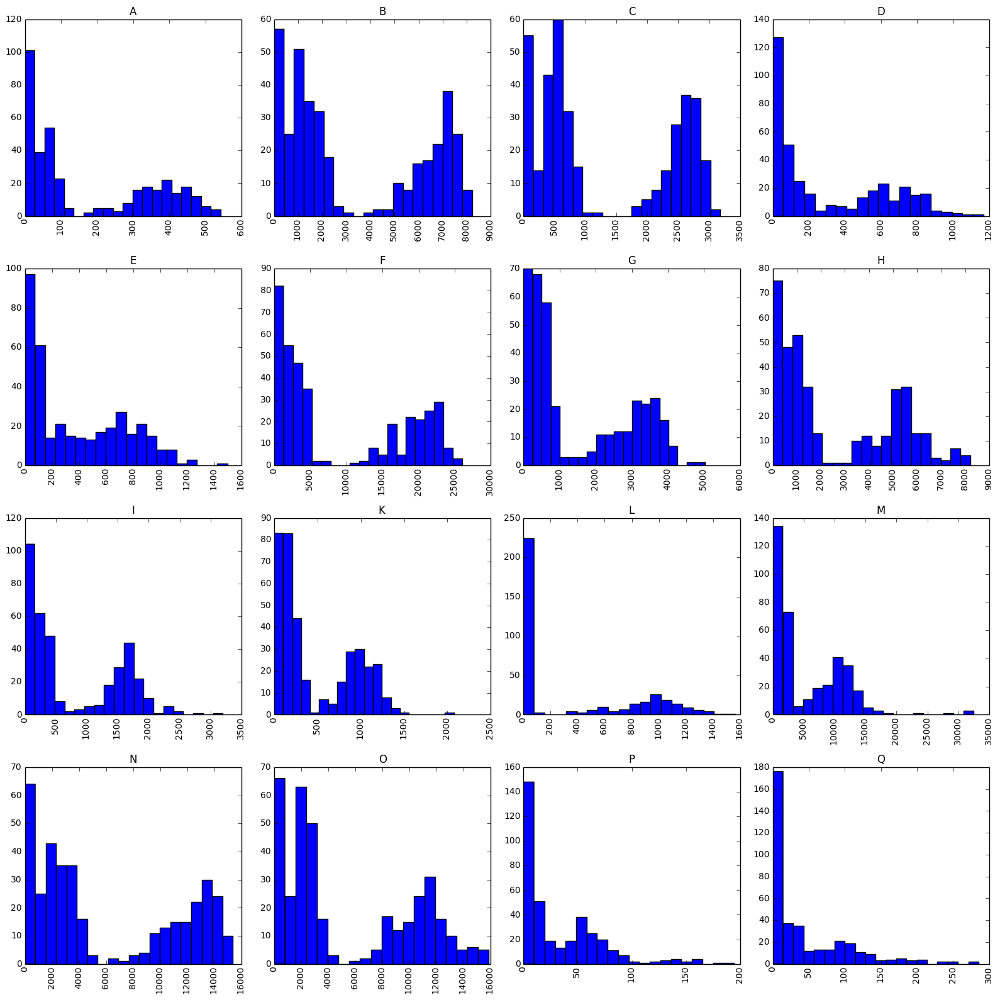

In [57]:
plt.rcParams["figure.figsize"] = (16,16)
gs = gridspec.GridSpec(4, 4)

sub = 0
for row in range(4):
    for col in range(4):
        ax = plt.subplot(gs[row, col])
        ax = plt.hist(splitted_data[sub], bins=20)
        ax = plt.title(temp_list[sub])
        ax = plt.xticks(rotation='vertical')
        sub = sub + 1
plt.tight_layout()
plt.show()

# Seasonal decomposition plots tell us: 
## * seasonality exists, 
## * not much trend, 
## * residual plot is not white noise.

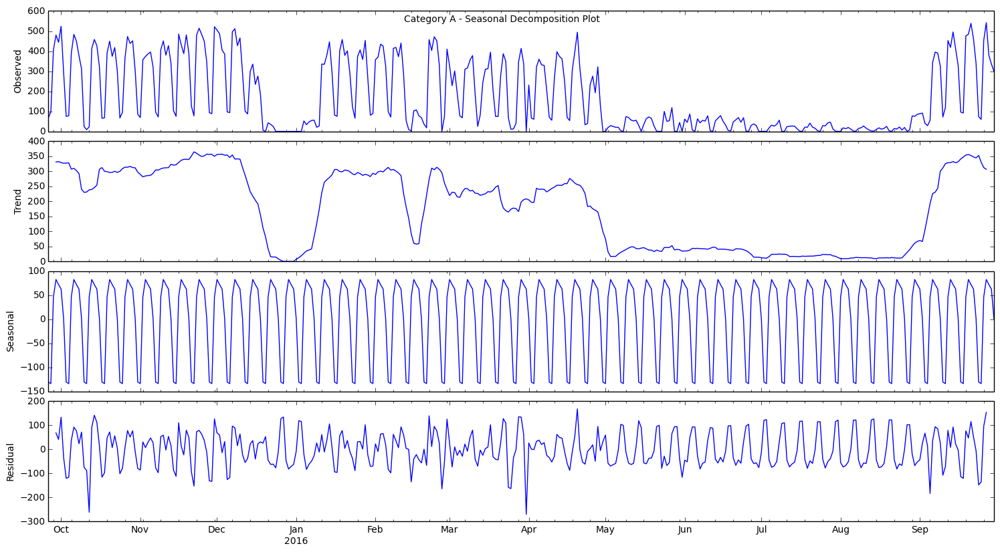

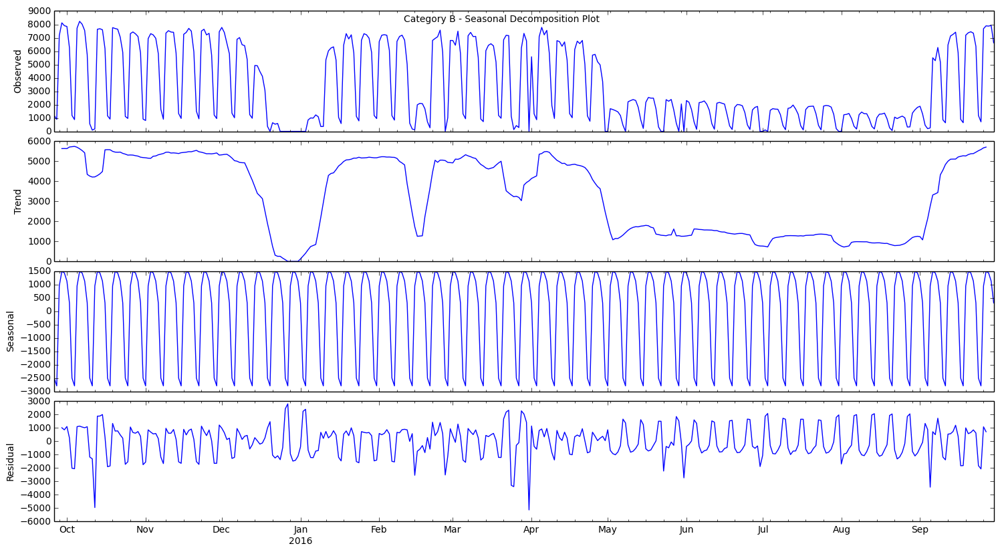

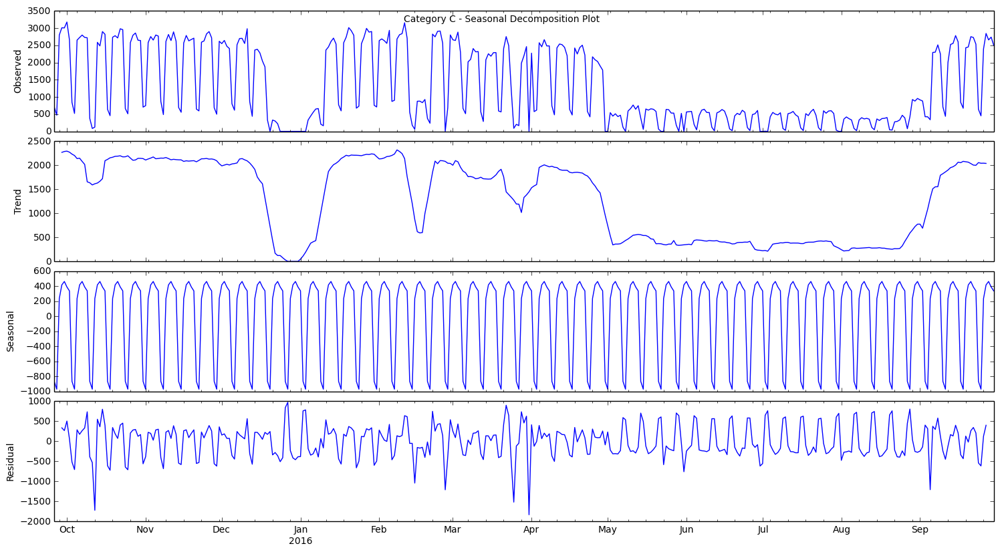

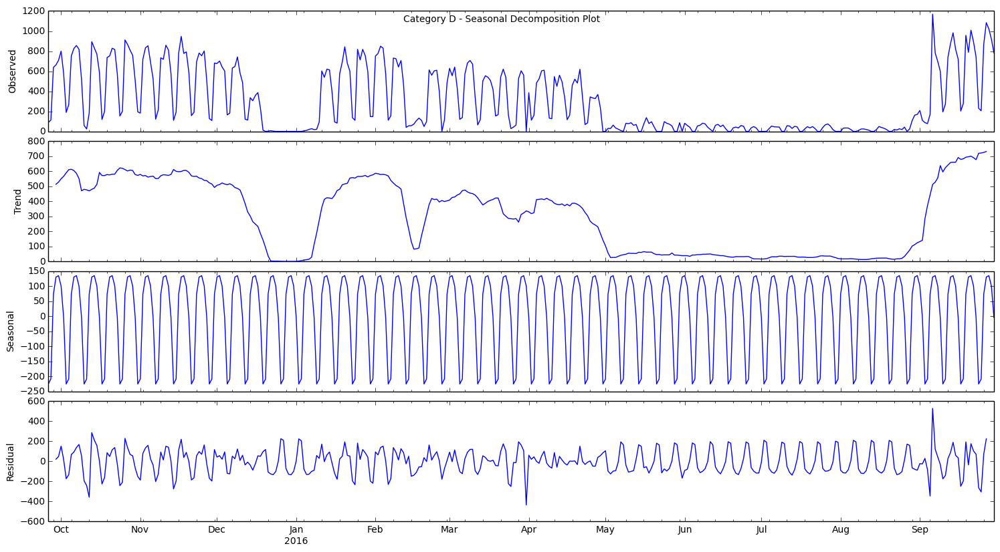

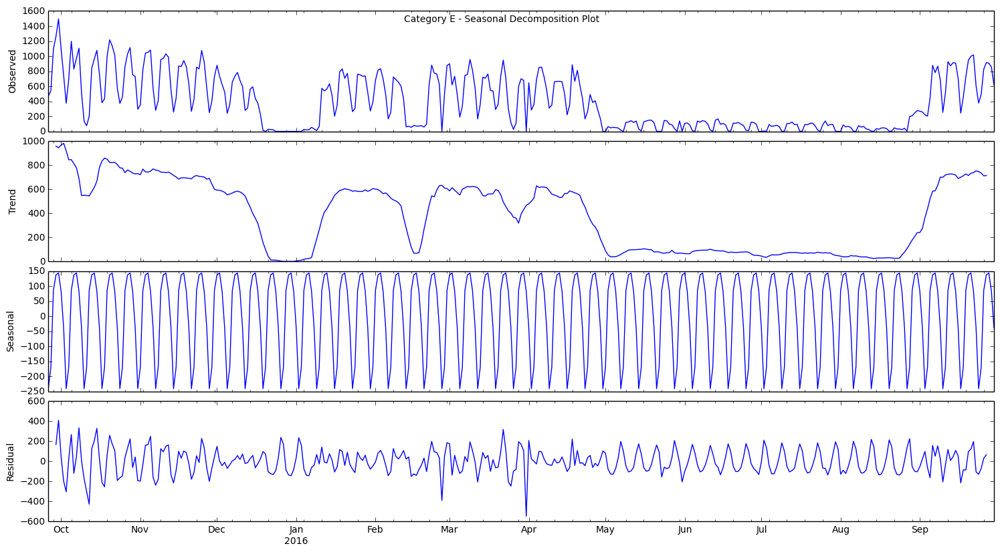

...

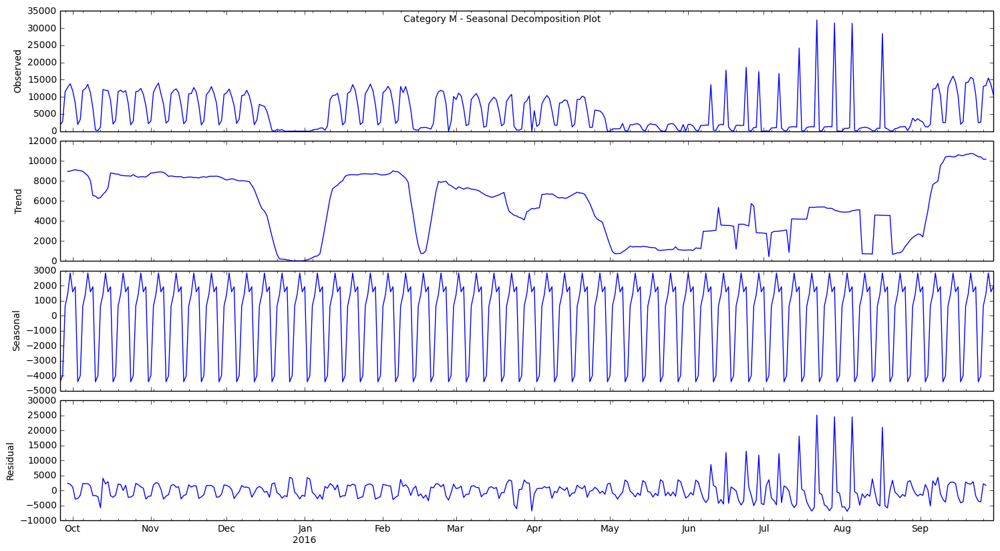

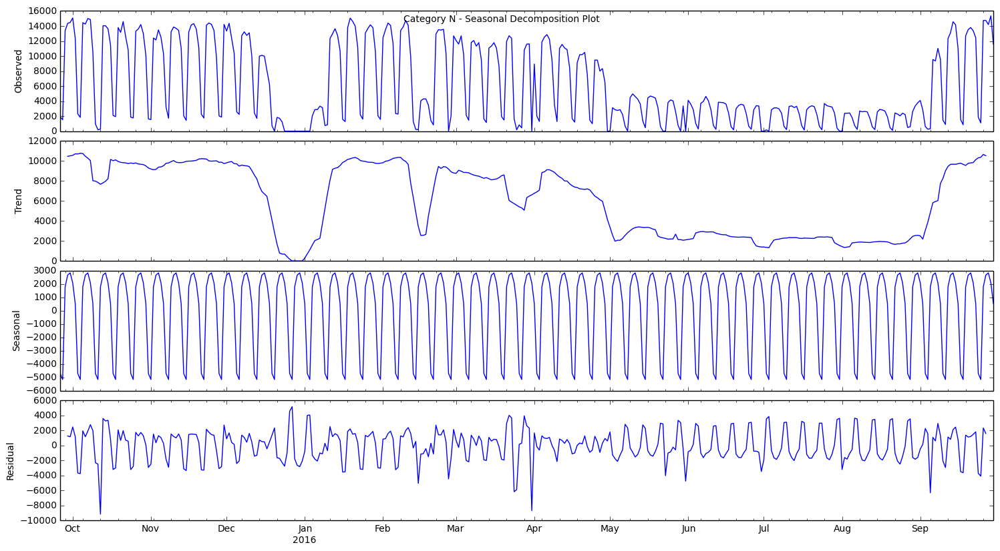

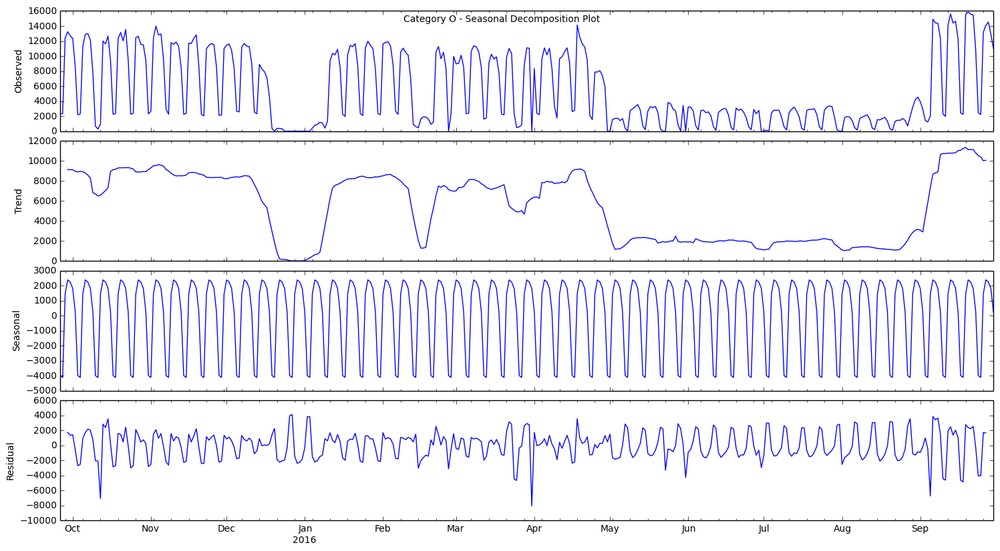

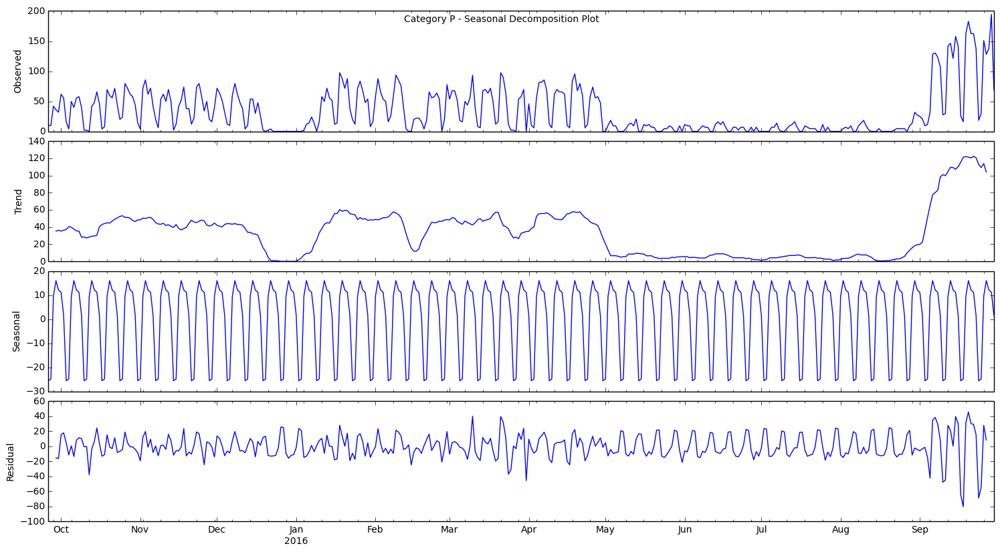

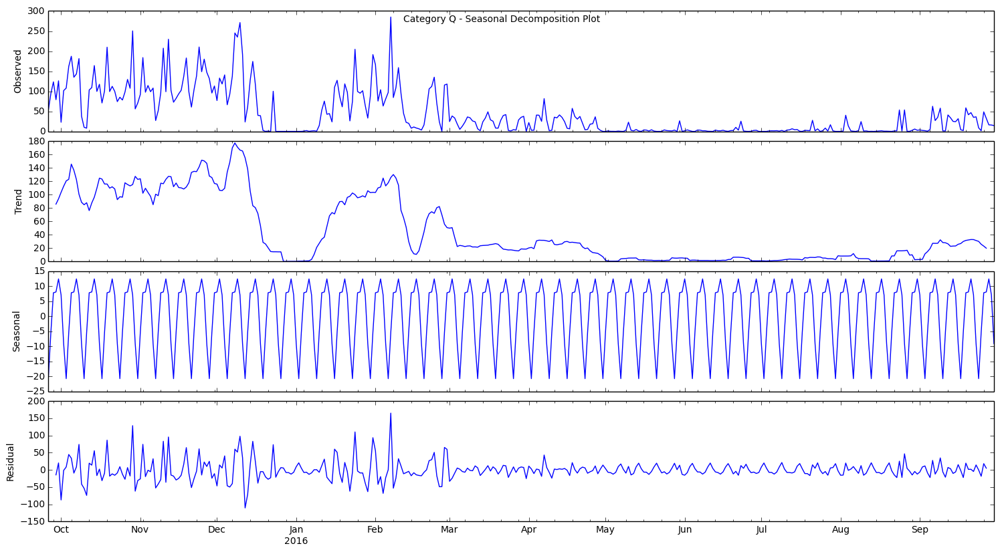

In [62]:
# Seasonal decomposition plots. Let's confirm the weekly seasonality.

def decomposition(timeseries, item):
    decomposition = seasonal_decompose(timeseries, freq=7)
    fig = plt.figure()  
    fig = decomposition.plot()  
    fig.set_size_inches(15, 8)
    fig.suptitle('Category {} - Seasonal Decomposition Plot'.format(item))

_ = map(decomposition, splitted_data, temp_list)

# Step 3) Statistical Testing
* Stationary tests(obs)
* Log(obs)
    * Line plot
    * Stationary test
* Diff(obs)
    * Stationary test
* Diff(Log())
    * Stationary test
* Seasonal(obs)
    * Stationary test
* Seasonal(log)
    * Stationary test
* Seasonal(diff())
    * Stationary test
* Seasonal(diff(log))
    * Stationary test

# Setup Stationarity Test Functions

In [73]:
# We will use Dickey-Fuller Test to check the stationarity of our time series data.
plt.rcParams["figure.figsize"] = (16,6)

def test_stationarity(timeseries, item):
    
    # Determing rolling statistics
    rol_mean = pd.rolling_mean(timeseries, window=12)
    rol_std = pd.rolling_std(timeseries, window=12)

    # Plot rolling statistics:
    original = plt.plot(timeseries, color='blue',label='Original')
    mean_ = plt.plot(rol_mean, color='red', label='Rolling Mean')
    std_ = plt.plot(rol_std, color='black', label = 'Rolling Std')
    plt.legend(loc='best')
    plt.title('Category {} - Rolling Mean & Standard Deviation'.format(item))
    plt.show(block=False)
    
    # Perform Dickey-Fuller test:
    print 'Results of Dickey-Fuller Test:'
    adf_test = adfuller(timeseries, autolag='AIC')
    adf_output = pd.Series(adf_test[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    
    for key,value in adf_test[4].items():
        adf_output['Critical Value (%s)'%key] = value
    print adf_output

In [74]:
def test_statistic(timeseries):
    adf_test = adfuller(timeseries, autolag='AIC')
    return adf_test[0]

In [256]:
def test_statistic_five(timeseries):
    adf_test = adfuller(timeseries, autolag='AIC')
    return adf_test[4]['5%']

# 3.0) Stationary Test(obs)

/Library/Python/2.7/site-packages/ipykernel/__main__.py:7: FutureWarning: pd.rolling_mean is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).mean()
/Library/Python/2.7/site-packages/ipykernel/__main__.py:8: FutureWarning: pd.rolling_std is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).std()


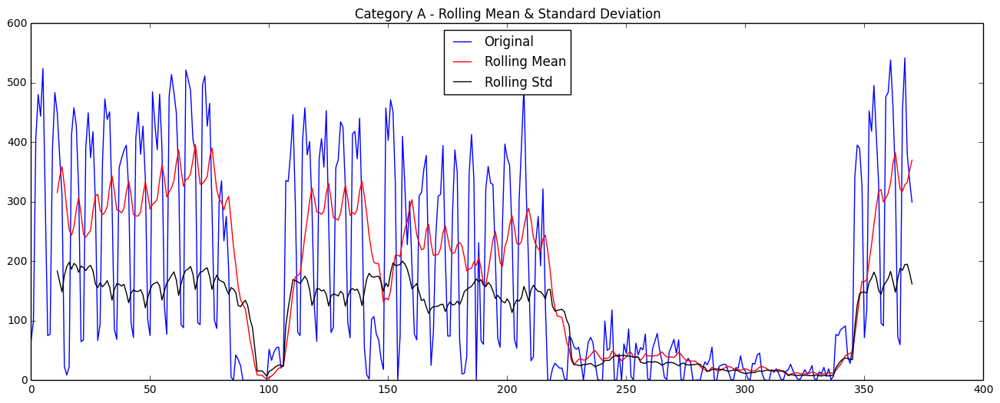

Results of Dickey-Fuller Test:
Test Statistic                  -2.295463
p-value                          0.173436
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


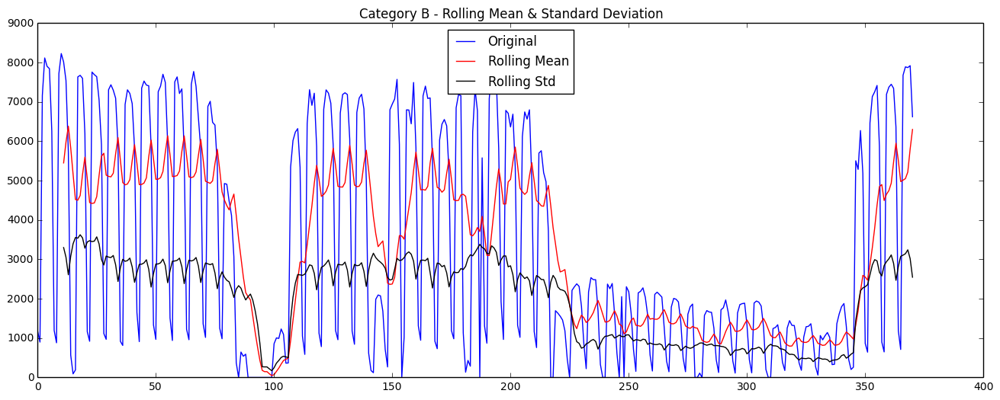

Results of Dickey-Fuller Test:
Test Statistic                  -2.428629
p-value                          0.133819
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


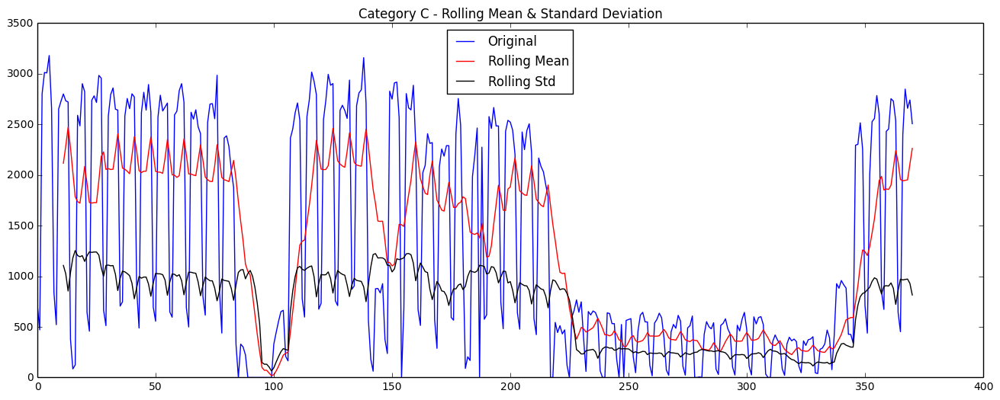

Results of Dickey-Fuller Test:
Test Statistic                  -2.466672
p-value                          0.123795
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


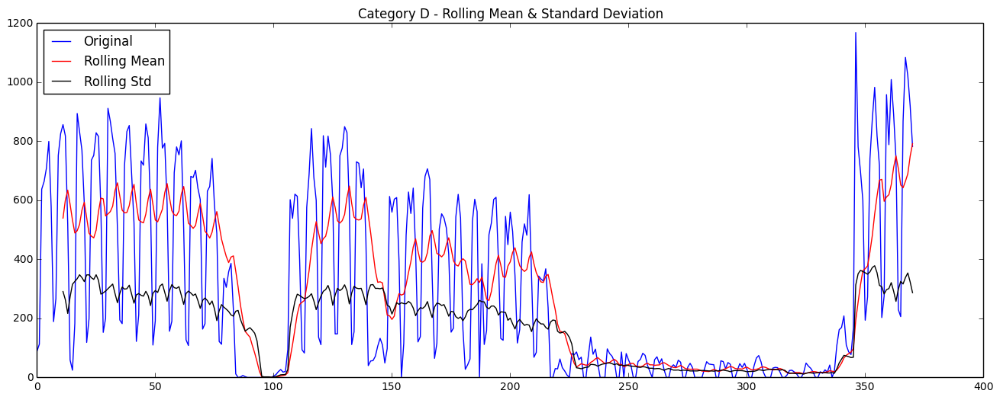

Results of Dickey-Fuller Test:
Test Statistic                  -2.255306
p-value                          0.186788
#Lags Used                       8.000000
Number of Observations Used    362.000000
Critical Value (5%)             -2.869557
Critical Value (1%)             -3.448544
Critical Value (10%)            -2.571041
dtype: float64


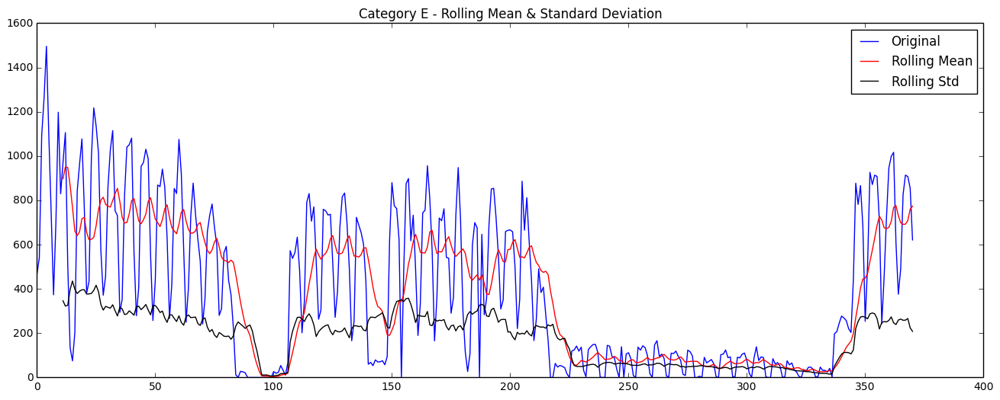

Results of Dickey-Fuller Test:
Test Statistic                  -2.023702
p-value                          0.276278
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


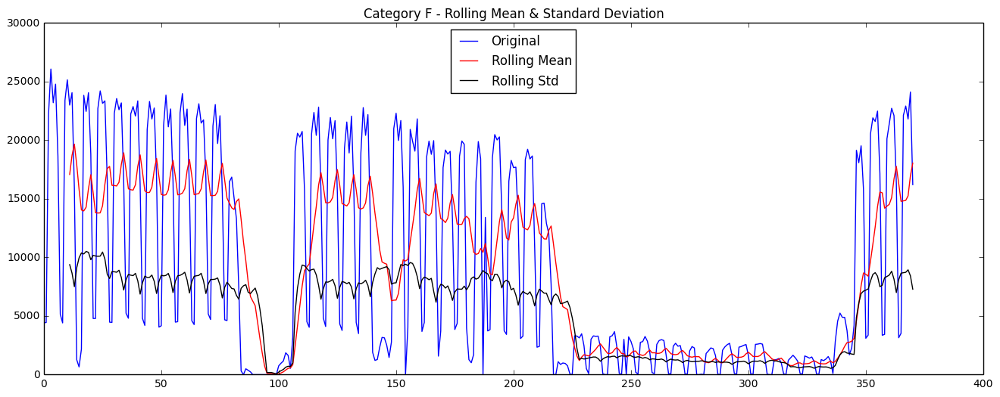

Results of Dickey-Fuller Test:
Test Statistic                  -2.251972
p-value                          0.187926
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


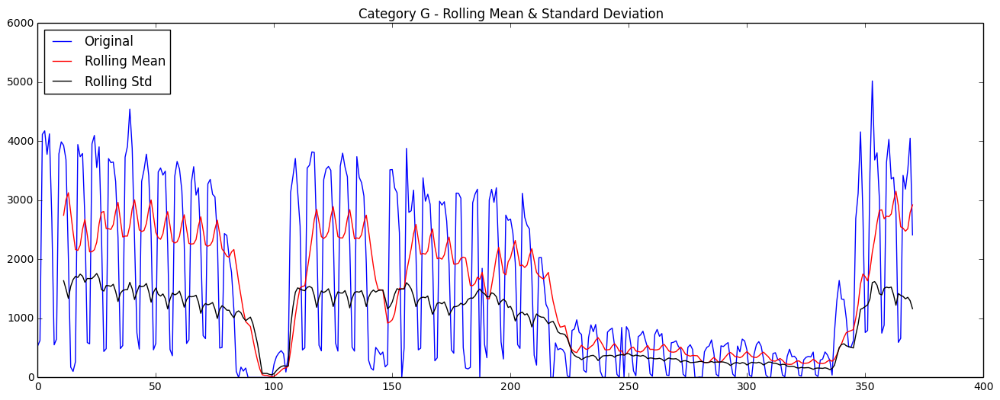

Results of Dickey-Fuller Test:
Test Statistic                  -2.361139
p-value                          0.153006
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


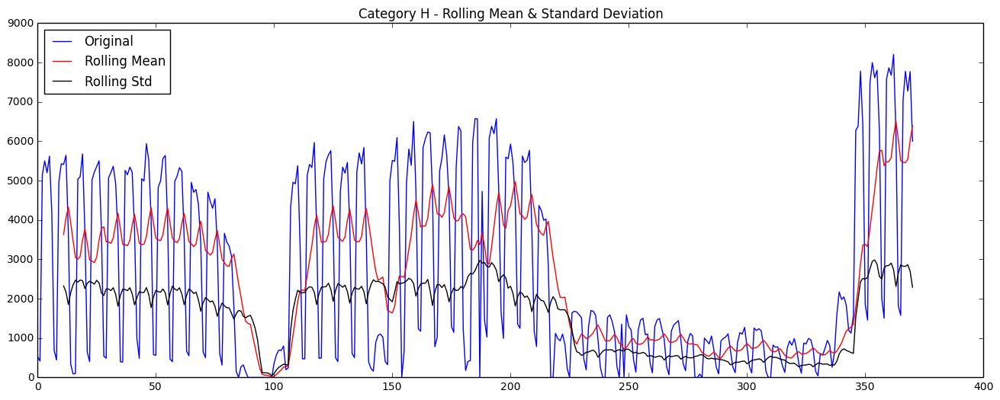

Results of Dickey-Fuller Test:
Test Statistic                  -2.173112
p-value                          0.216149
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


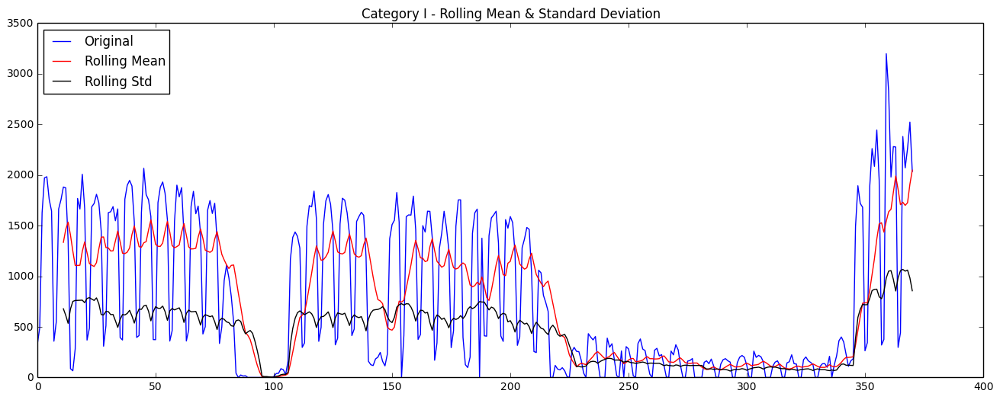

Results of Dickey-Fuller Test:
Test Statistic                  -2.155512
p-value                          0.222786
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


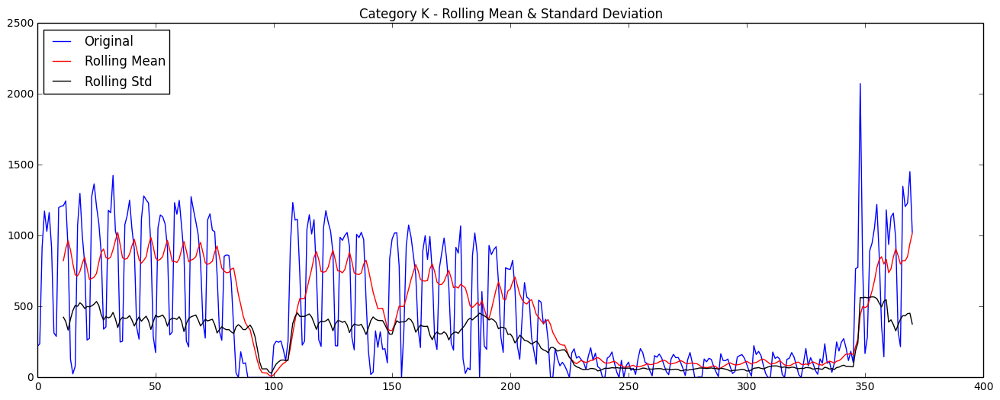

Results of Dickey-Fuller Test:
Test Statistic                  -2.132693
p-value                          0.231574
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


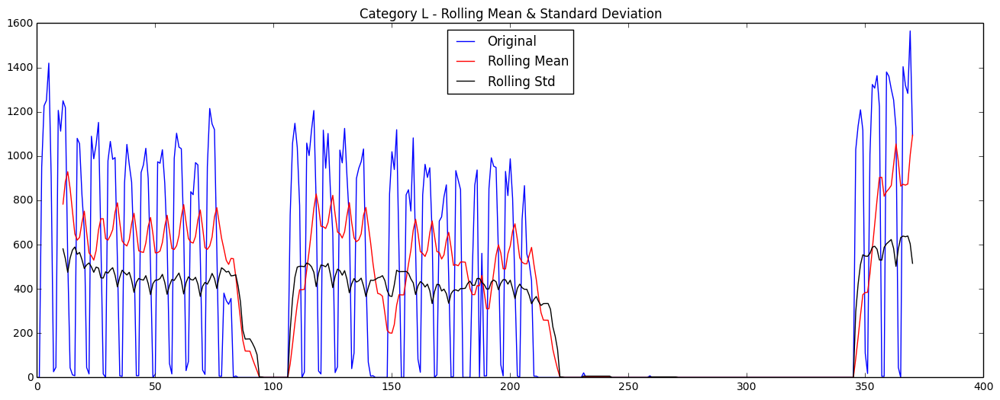

Results of Dickey-Fuller Test:
Test Statistic                  -2.164976
p-value                          0.219202
#Lags Used                      10.000000
Number of Observations Used    360.000000
Critical Value (5%)             -2.869602
Critical Value (1%)             -3.448646
Critical Value (10%)            -2.571065
dtype: float64


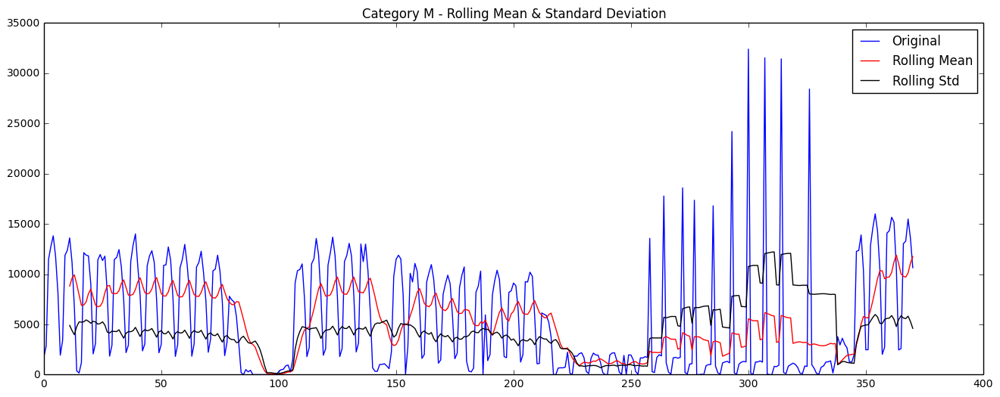

Results of Dickey-Fuller Test:
Test Statistic                  -2.717033
p-value                          0.071137
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


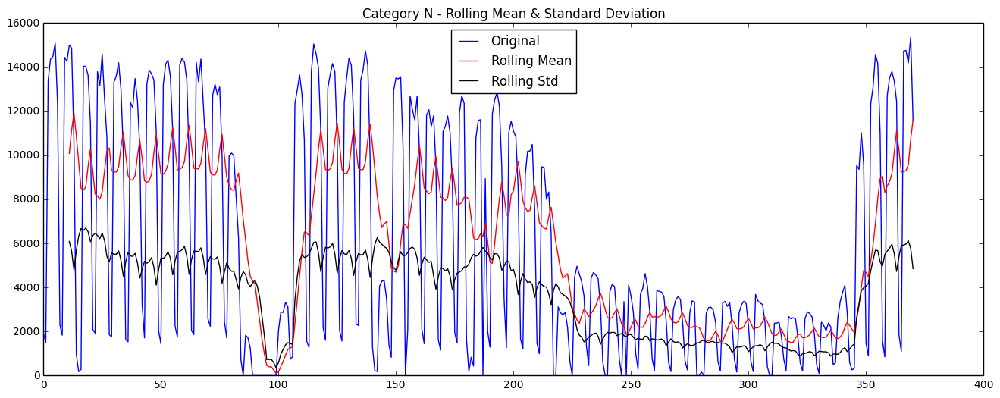

Results of Dickey-Fuller Test:
Test Statistic                  -2.408838
p-value                          0.139258
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


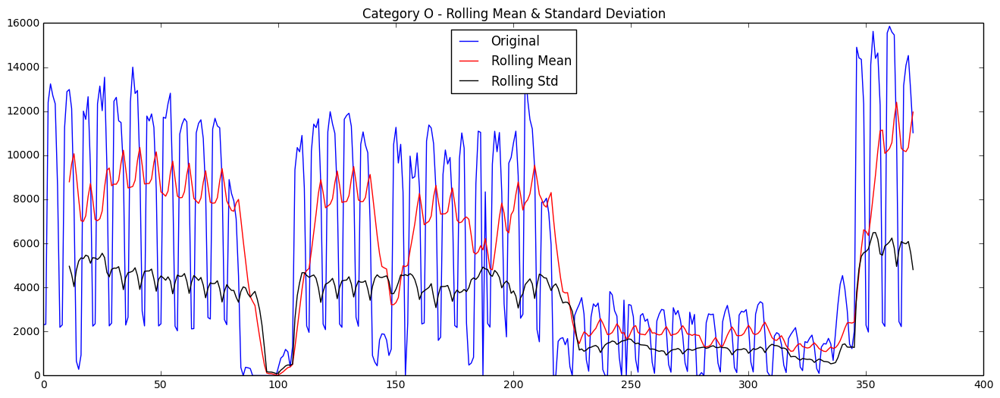

Results of Dickey-Fuller Test:
Test Statistic                  -2.493939
p-value                          0.116956
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


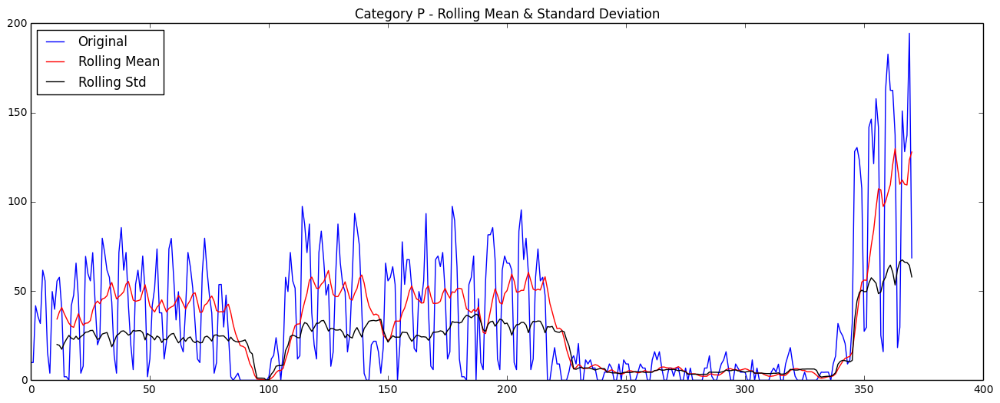

Results of Dickey-Fuller Test:
Test Statistic                  -2.402126
p-value                          0.141137
#Lags Used                       9.000000
Number of Observations Used    361.000000
Critical Value (5%)             -2.869580
Critical Value (1%)             -3.448595
Critical Value (10%)            -2.571053
dtype: float64


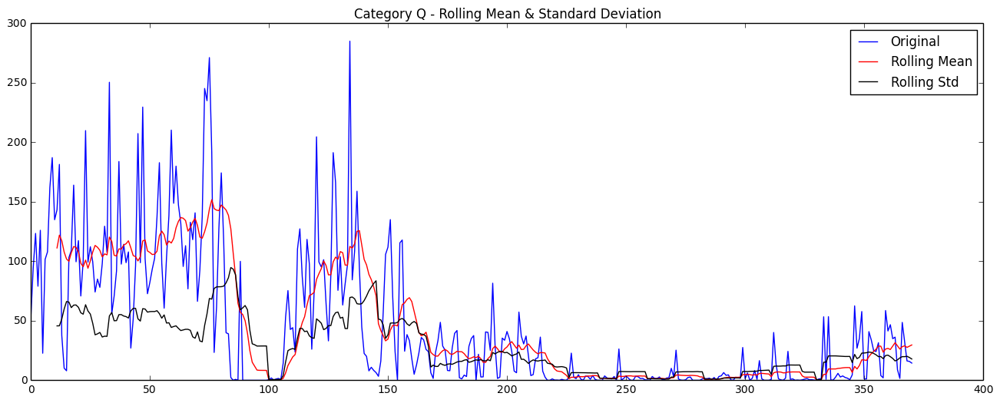

Results of Dickey-Fuller Test:
Test Statistic                  -2.230331
p-value                          0.195422
#Lags Used                      17.000000
Number of Observations Used    353.000000
Critical Value (5%)             -2.869763
Critical Value (1%)             -3.449011
Critical Value (10%)            -2.571151
dtype: float64


In [75]:
_ = map(test_stationarity, splitted_data, temp_list)

In [273]:
observed_test_stat = map(test_statistic, splitted_data)
observed_test_five = map(test_statistic_five, splitted_data)
count=0
for test, five in zip(observed_test_stat, observed_test_five):
    print temp_list[count], '|', 'Test:', test, '| 5%:', five, '| Difference: ', test-five
    count = count + 1

A | Test: -2.29546265075 | 5%: -2.8696931157 | Difference:  0.574230464956
B | Test: -2.42862879583 | 5%: -2.8696931157 | Difference:  0.441064319879
C | Test: -2.46667219356 | 5%: -2.86971618162 | Difference:  0.403043988058
D | Test: -2.25530578781 | 5%: -2.86955740795 | Difference:  0.61425162014
E | Test: -2.0237016129 | 5%: -2.86971618162 | Difference:  0.846014568724
F | Test: -2.25197164423 | 5%: -2.8696931157 | Difference:  0.617721471474
G | Test: -2.36113906615 | 5%: -2.8696931157 | Difference:  0.508554049559
H | Test: -2.17311203904 | 5%: -2.8696931157 | Difference:  0.696581076662
I | Test: -2.15551158517 | 5%: -2.8696931157 | Difference:  0.714181530536
K | Test: -2.1326926148 | 5%: -2.86971618162 | Difference:  0.737023566819
L | Test: -2.16497619618 | 5%: -2.86960213906 | Difference:  0.704625942877
M | Test: -2.71703308813 | 5%: -2.8696931157 | Difference:  0.152660027577
N | Test: -2.40883779852 | 5%: -2.8696931157 | Difference:  0.460855317187
O | Test: -2.4939388708

### We can see most categories have test statistics are larger than critical value (10%)
### So most categories are not stationary...let's make it stationary!
#### 1) Inversed(obs)
#### 2) Diff(obs)
#### 3) Diff(Inversed())
#### 4) Seasonal(obs)
#### 5) Seasonal(Inversed())
#### 6) Seasonal(Diff())
#### 7) Seasonal(Diff(Inversed()))

In [77]:
# We will use this function repeatedly to make plots for -> Transformed Data vs. Original Data

def plot_data(original, trans_2, item, title, label_1, label_2):
#     original.plot(label='{}'.format(label_1))
    trans_2.plot(label='{}'.format(label_2))
    plt.legend(loc='best')
    plt.title('Category {} - {}'.format(item, title))
    plt.show(block=False)

# 3.1) Inverse sine it

In [78]:
def log_data(timeseries, item):
    return np.arcsinh(timeseries)

splitted_data_log = map(log_data, splitted_data, temp_list)
print splitted_data[0].head(), '\n', splitted_data_log[0].head()

2015-09-26     66.52
2015-09-27     98.92
2015-09-28    405.99
2015-09-29    480.46
2015-09-30    443.97
Freq: D, Name: sales, dtype: float64 
2015-09-26    4.890706
2015-09-27    5.287484
2015-09-28    6.699477
2015-09-29    6.867892
2015-09-30    6.788905
Freq: D, Name: sales, dtype: float64


In [79]:
# Check for both zero values and NA values.

for i, category in enumerate(temp_list):
    print category, 'zero:', splitted_data_log[i][splitted_data_log[i]==0].shape, \
    'NA:', splitted_data_log[i].isnull().values.sum()

A zero: (26,) NA: 0
B zero: (26,) NA: 0
C zero: (26,) NA: 0
D zero: (52,) NA: 0
E zero: (32,) NA: 0
F zero: (26,) NA: 0
G zero: (26,) NA: 0
H zero: (26,) NA: 0
I zero: (41,) NA: 0
K zero: (28,) NA: 0
L zero: (177,) NA: 0
M zero: (26,) NA: 0
N zero: (26,) NA: 0
O zero: (25,) NA: 0
P zero: (71,) NA: 0
Q zero: (43,) NA: 0


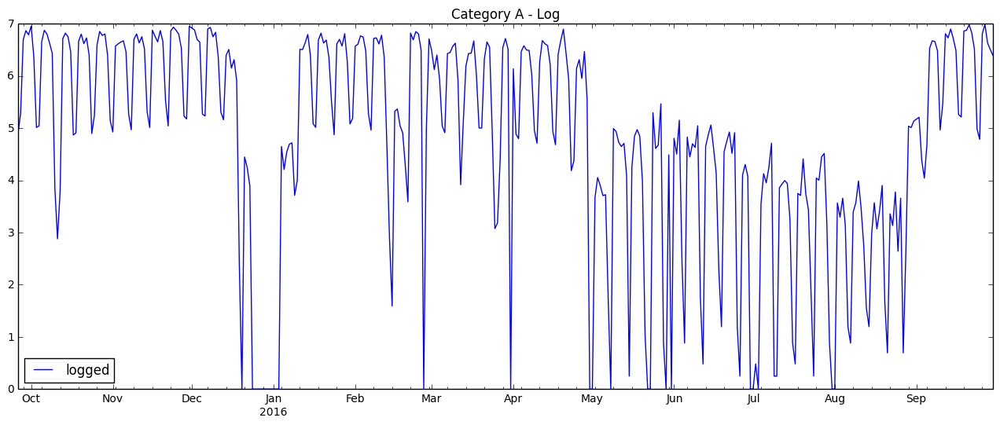

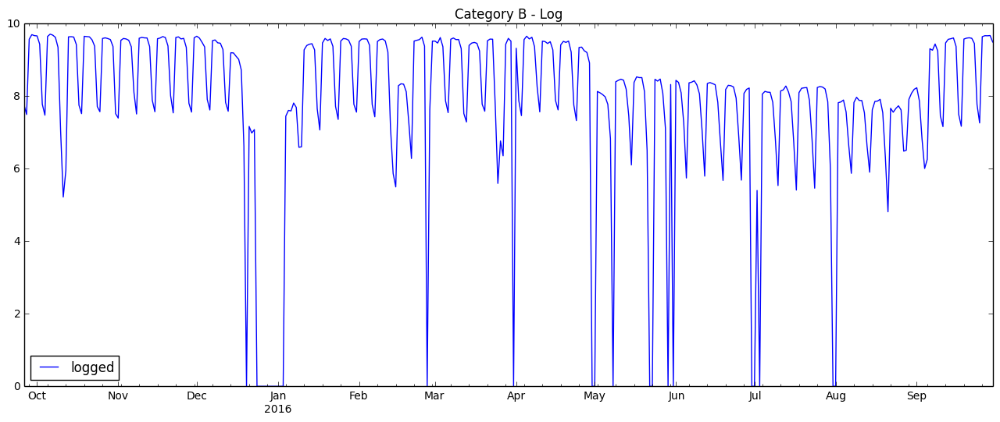

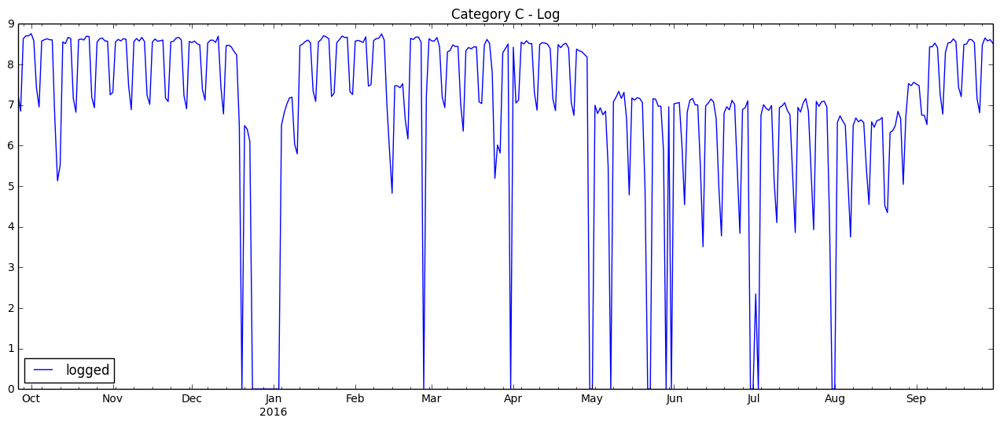

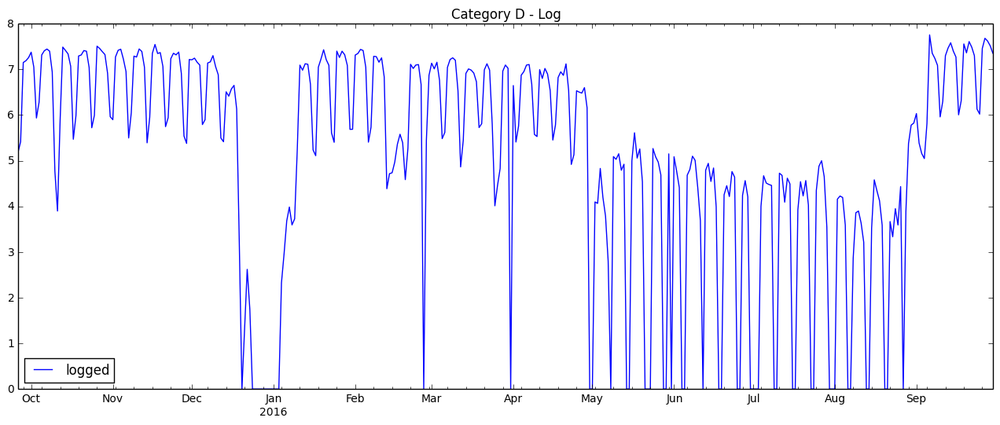

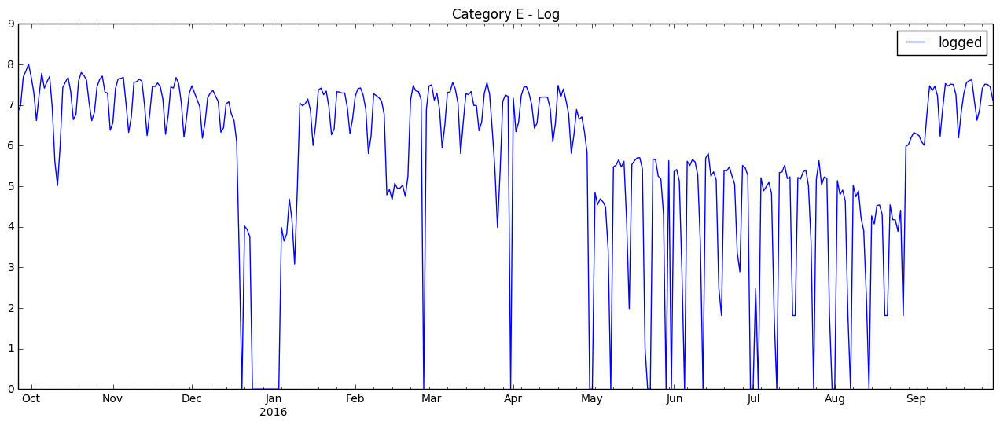

...

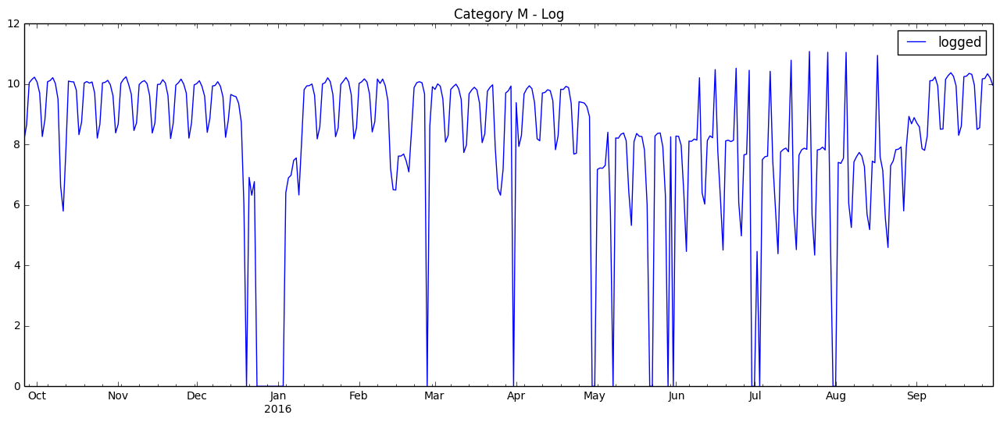

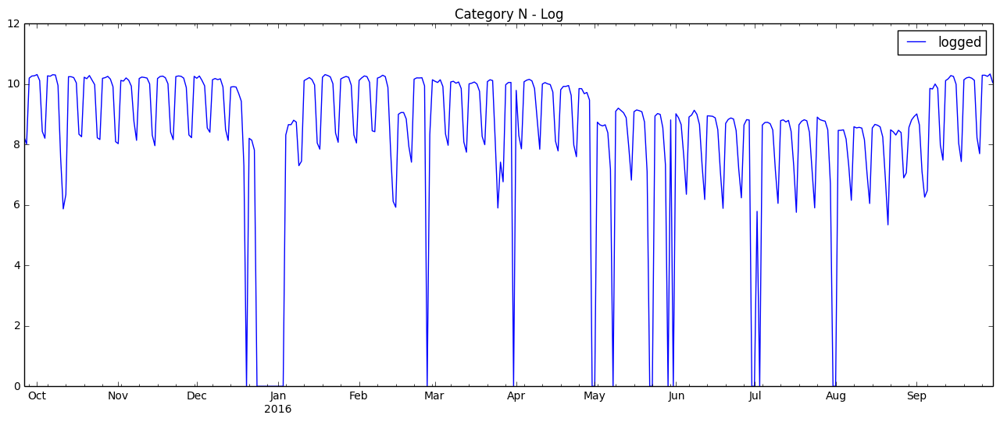

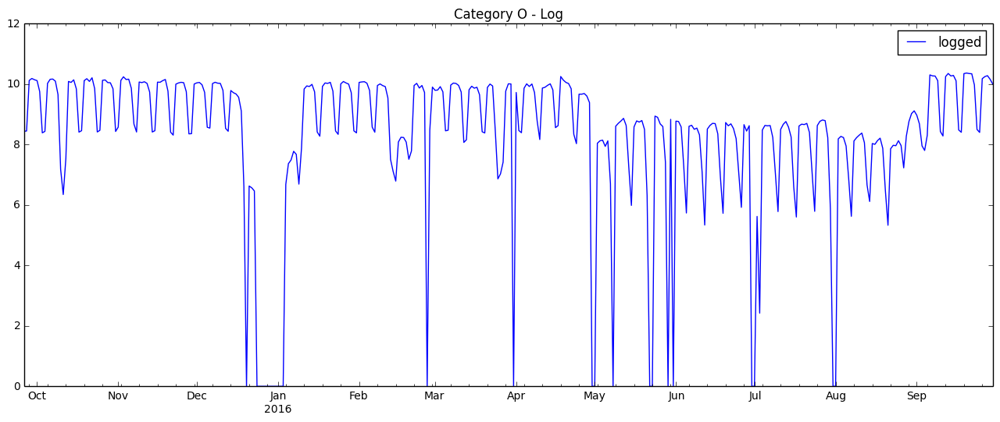

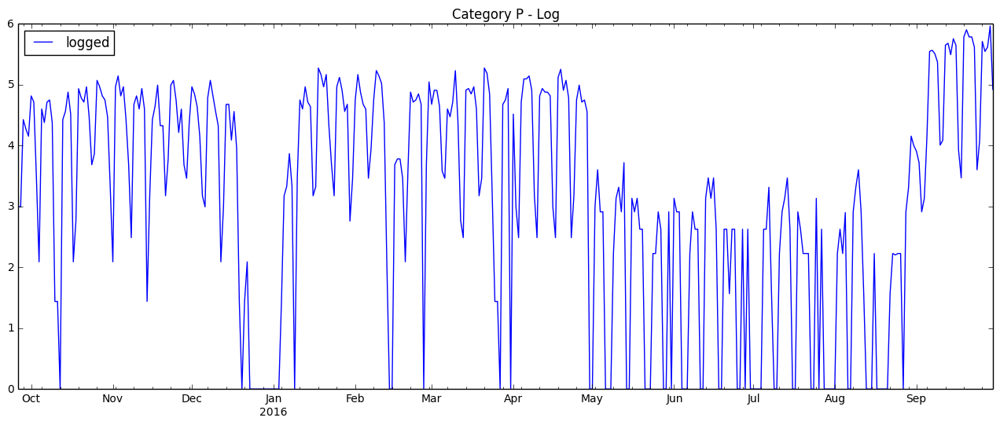

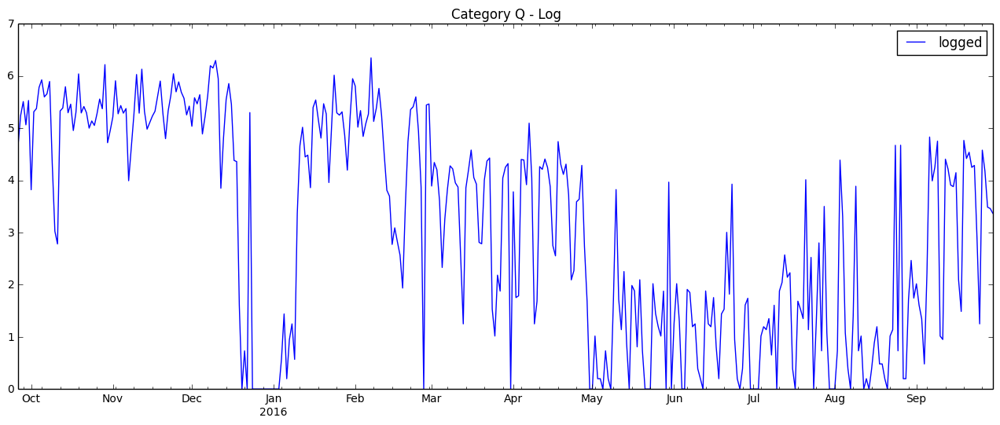

In [80]:
# Let's see the inverse sine plot.

_ = map(plot_data, splitted_data, splitted_data_log, temp_list, \
        ['Log']*len(temp_list), ['original']*len(temp_list), ['logged']*len(temp_list))

# Looks like we've made the variance quite even.

/Library/Python/2.7/site-packages/ipykernel/__main__.py:7: FutureWarning: pd.rolling_mean is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).mean()
/Library/Python/2.7/site-packages/ipykernel/__main__.py:8: FutureWarning: pd.rolling_std is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).std()


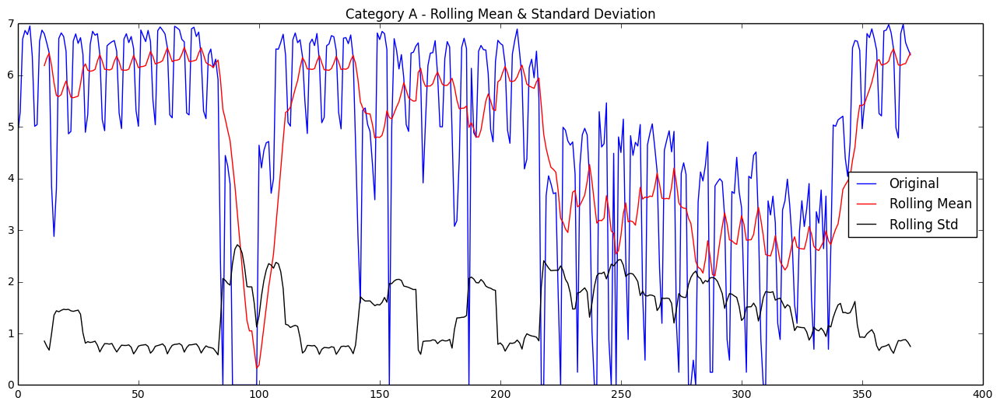

Results of Dickey-Fuller Test:
Test Statistic                  -2.771131
p-value                          0.062517
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


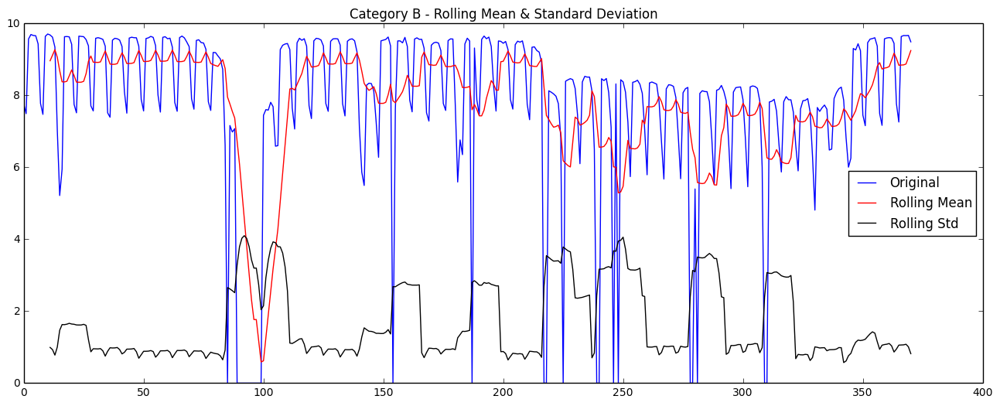

Results of Dickey-Fuller Test:
Test Statistic                  -4.161254
p-value                          0.000766
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


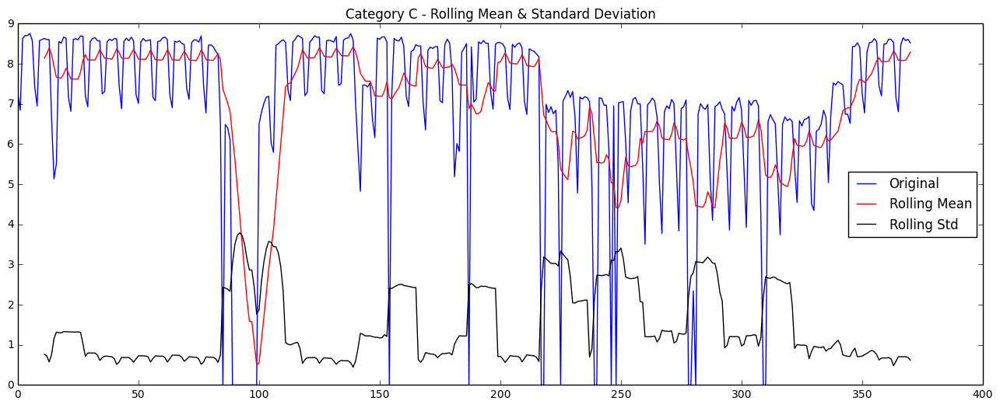

Results of Dickey-Fuller Test:
Test Statistic                  -3.810797
p-value                          0.002799
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


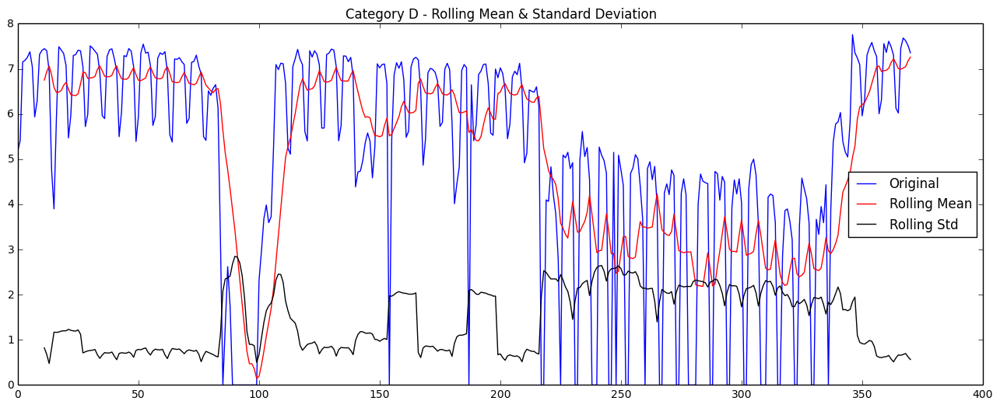

Results of Dickey-Fuller Test:
Test Statistic                  -3.140575
p-value                          0.023693
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


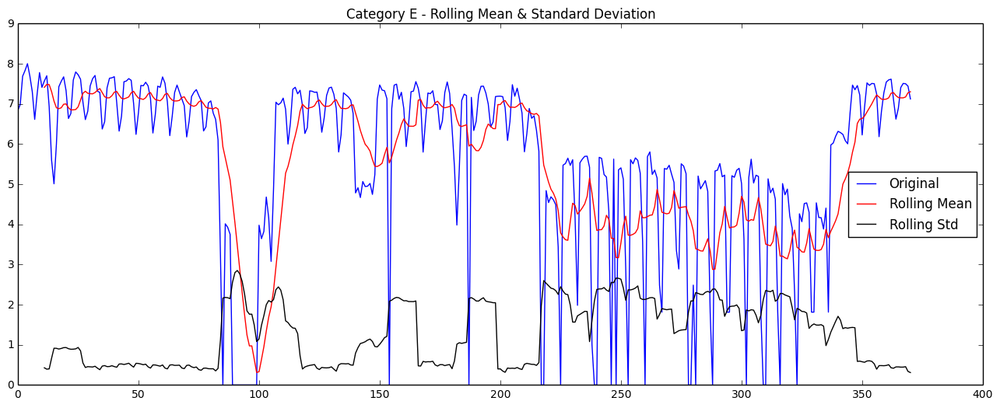

Results of Dickey-Fuller Test:
Test Statistic                  -3.258717
p-value                          0.016828
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


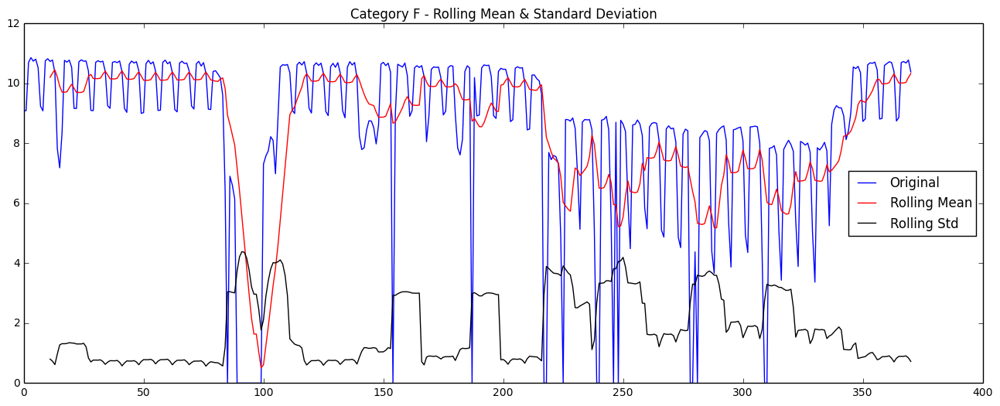

Results of Dickey-Fuller Test:
Test Statistic                  -3.676535
p-value                          0.004456
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


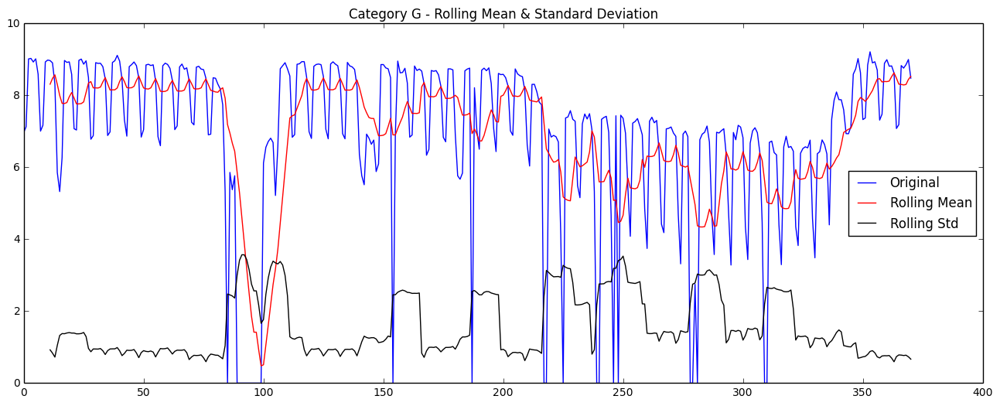

Results of Dickey-Fuller Test:
Test Statistic                  -3.783822
p-value                          0.003077
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


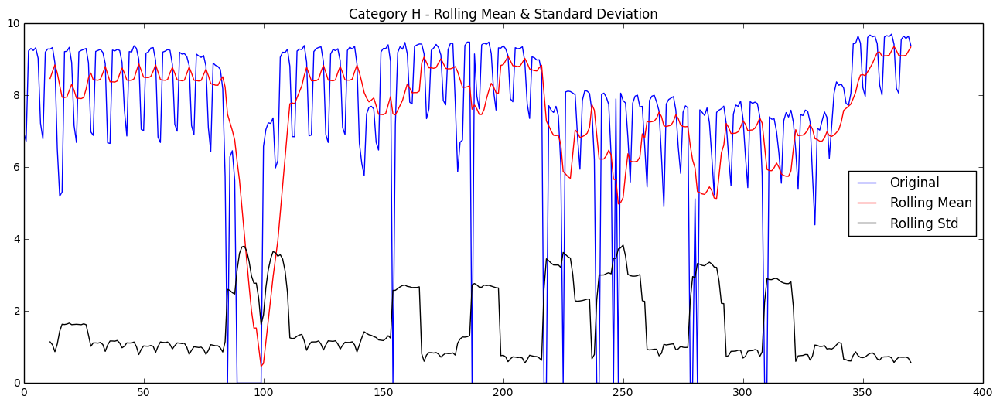

Results of Dickey-Fuller Test:
Test Statistic                  -3.997738
p-value                          0.001422
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


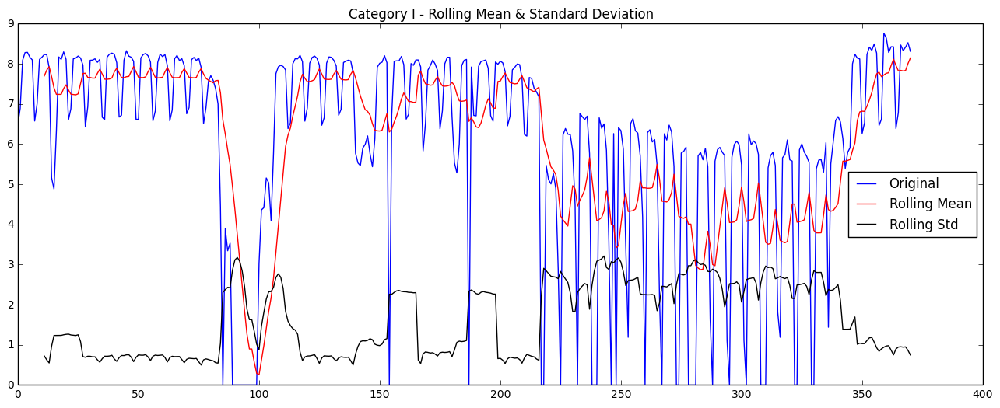

Results of Dickey-Fuller Test:
Test Statistic                  -3.064660
p-value                          0.029281
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


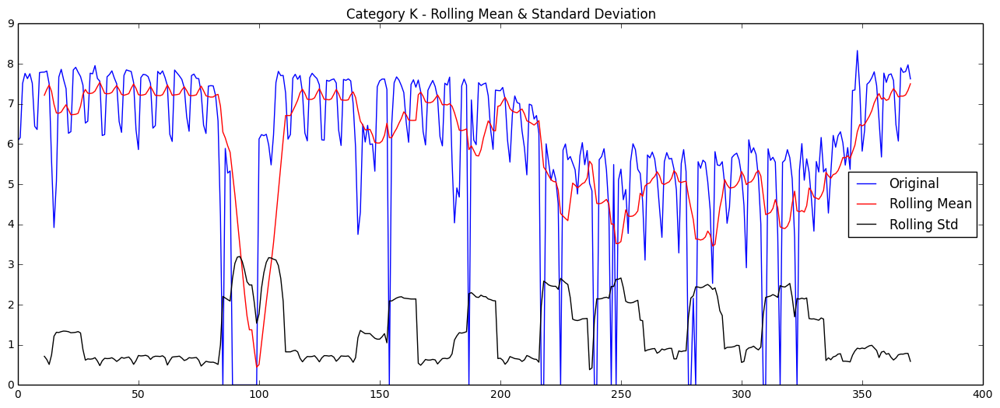

Results of Dickey-Fuller Test:
Test Statistic                  -3.384047
p-value                          0.011515
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


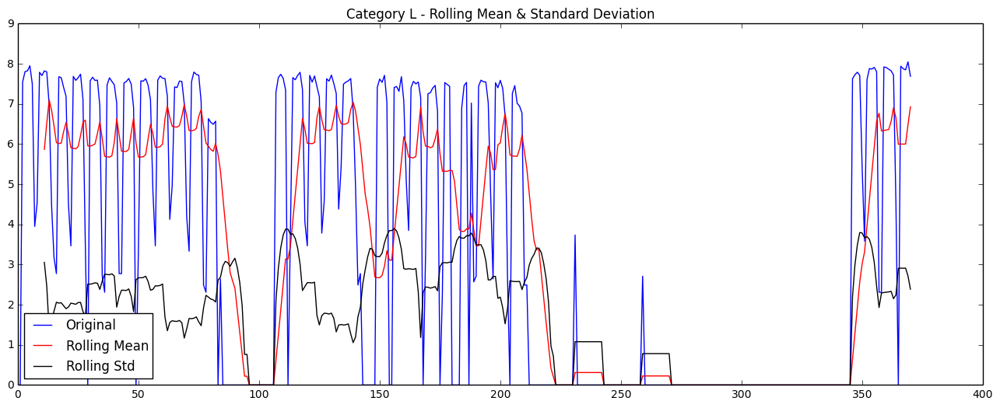

Results of Dickey-Fuller Test:
Test Statistic                  -2.427033
p-value                          0.134251
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


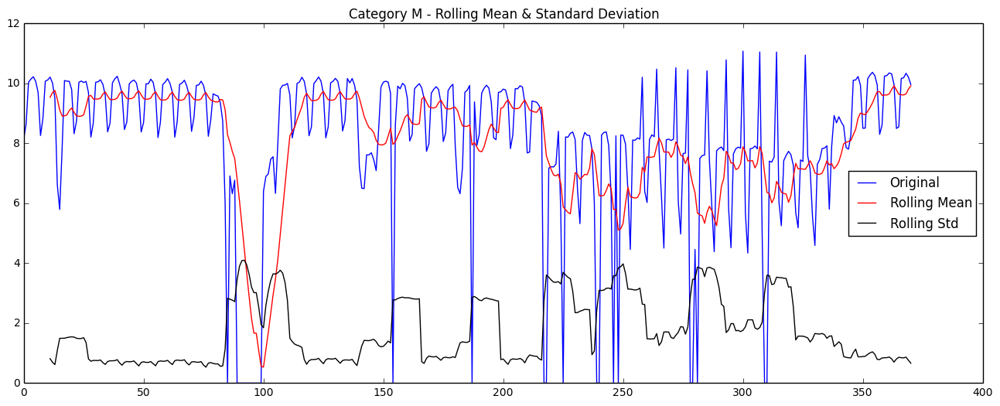

Results of Dickey-Fuller Test:
Test Statistic                  -4.093044
p-value                          0.000994
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


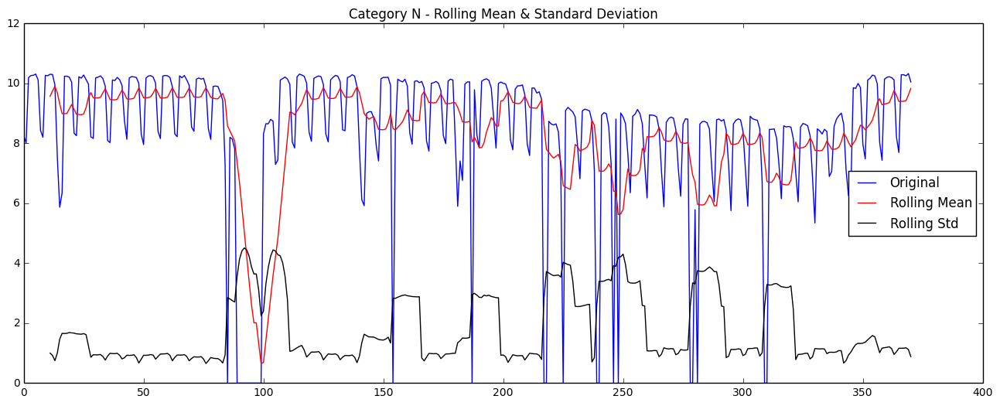

Results of Dickey-Fuller Test:
Test Statistic                  -4.206765
p-value                          0.000642
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


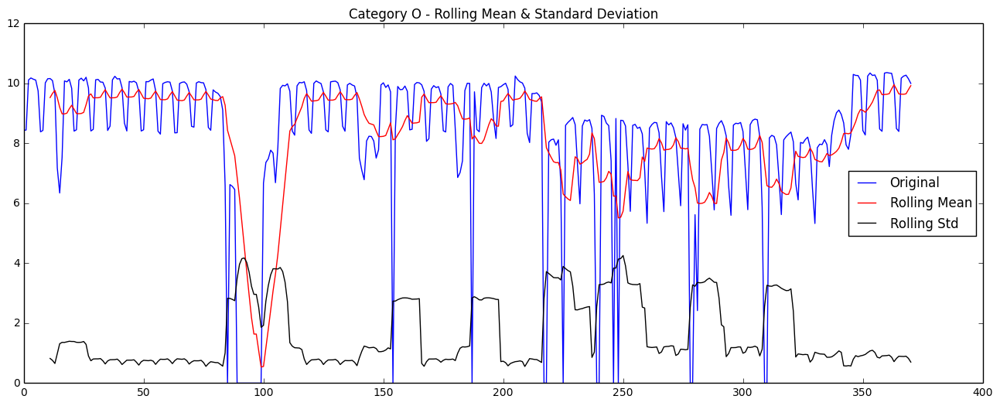

Results of Dickey-Fuller Test:
Test Statistic                  -4.097383
p-value                          0.000978
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


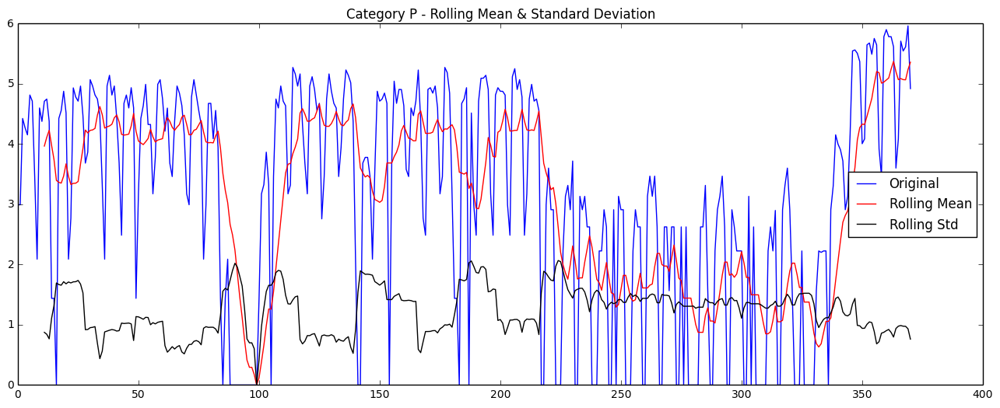

Results of Dickey-Fuller Test:
Test Statistic                  -2.585925
p-value                          0.095941
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


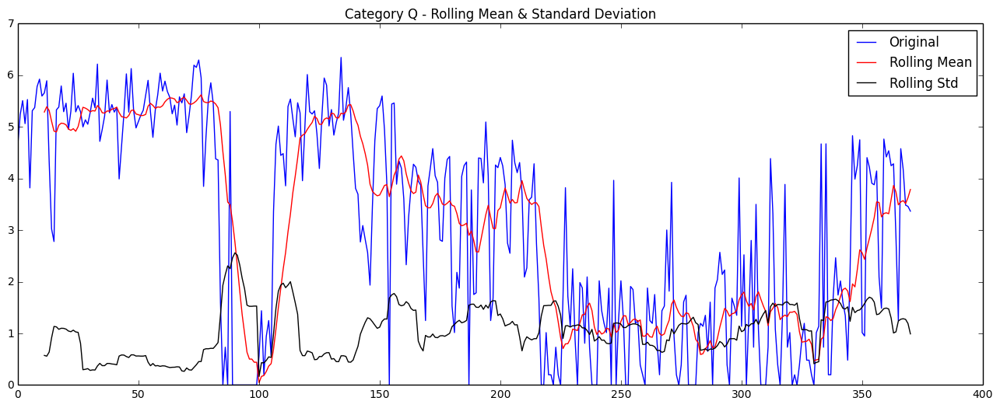

Results of Dickey-Fuller Test:
Test Statistic                  -2.330947
p-value                          0.162181
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


In [81]:
_ = map(test_stationarity, splitted_data_log, temp_list)

In [91]:
# See if inverse sine improved test statistics, or made it worse.
def stat_diff(transformed_series, items):
    observed_stat = map(test_statistic, splitted_data)
    logged_stat = map(test_statistic, transformed_series)
    stat_diff = map(lambda x, y: x - y, observed_stat, logged_stat)
    for i, cat in enumerate(items):
        print cat, ':', stat_diff[i]
    print 'Mean test stats improvement (higher is better): ', np.mean(stat_diff)

stat_diff(splitted_data_log, temp_list)

A : 0.47566803371
B : 1.73262513372
C : 1.34412480629
D : 0.885269548929
E : 1.23501497951
F : 1.42456372237
G : 1.42268323112
H : 1.82462574317
I : 0.909148460448
K : 1.25135398627
L : 0.262056677766
M : 1.37601122304
N : 1.79792670833
O : 1.60344429134
P : 0.183799227971
Q : 0.100616081367
Mean test stats improvement (higher is better):  1.11430824096


In [83]:
# Inverse sine definitely improved the test statistics, and made things more stationary.

# 3.2) Diff it to detrend. Necessary?

In [93]:
# Differencing to deal with the trend.

def diff_data(timeseries, item):
    timeseries_diff = timeseries - timeseries.shift()
    return timeseries_diff


splitted_data_diff = map(diff_data, splitted_data, temp_list)
print splitted_data_diff[0].head()

2015-09-26       NaN
2015-09-27     32.40
2015-09-28    307.07
2015-09-29     74.47
2015-09-30    -36.49
Freq: D, Name: sales, dtype: float64


/Library/Python/2.7/site-packages/ipykernel/__main__.py:7: FutureWarning: pd.rolling_mean is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).mean()
/Library/Python/2.7/site-packages/ipykernel/__main__.py:8: FutureWarning: pd.rolling_std is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).std()


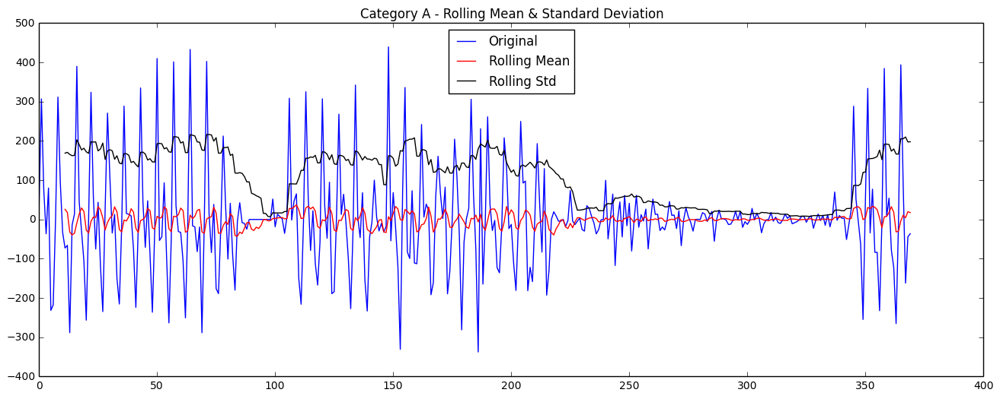

Results of Dickey-Fuller Test:
Test Statistic                -5.766030e+00
p-value                        5.530172e-07
#Lags Used                     1.300000e+01
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


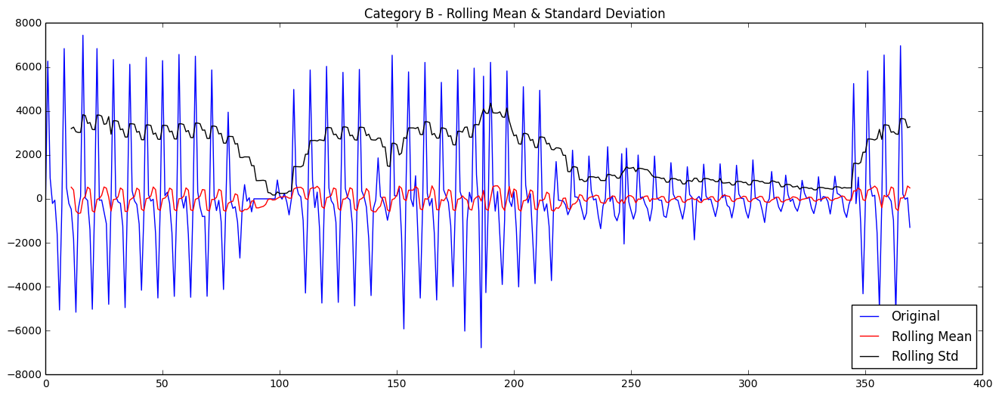

Results of Dickey-Fuller Test:
Test Statistic                -5.719281e+00
p-value                        7.002186e-07
#Lags Used                     1.300000e+01
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


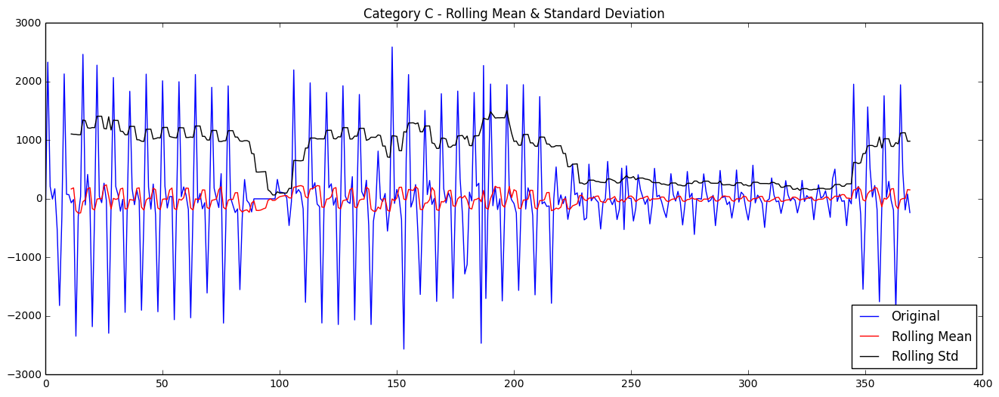

Results of Dickey-Fuller Test:
Test Statistic                -5.943075e+00
p-value                        2.237055e-07
#Lags Used                     1.300000e+01
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


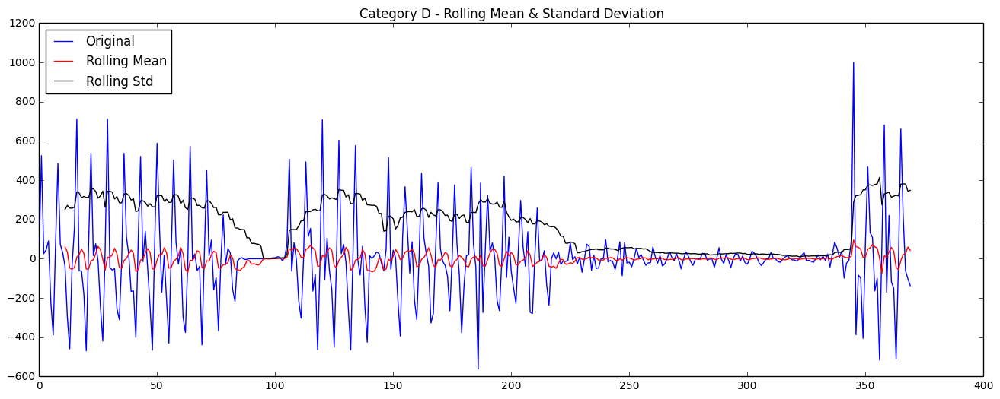

Results of Dickey-Fuller Test:
Test Statistic                -6.716752e+00
p-value                        3.566001e-09
#Lags Used                     7.000000e+00
Number of Observations Used    3.620000e+02
Critical Value (5%)           -2.869557e+00
Critical Value (1%)           -3.448544e+00
Critical Value (10%)          -2.571041e+00
dtype: float64


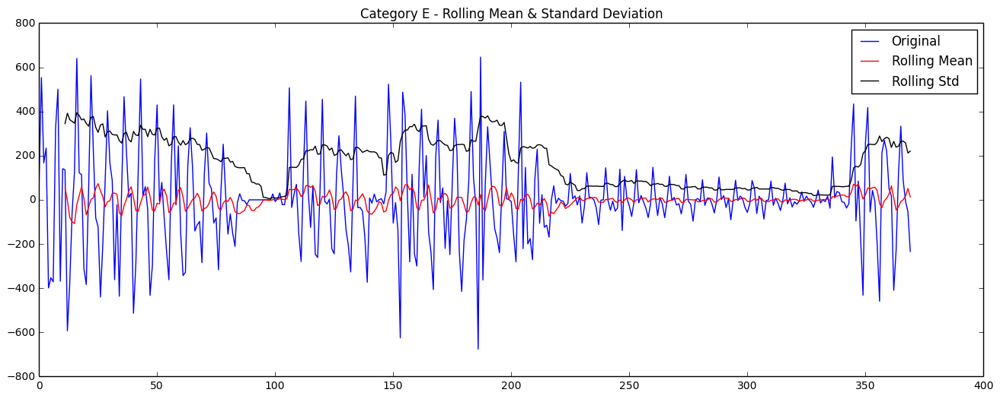

Results of Dickey-Fuller Test:
Test Statistic                  -5.517582
p-value                          0.000002
#Lags Used                      14.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


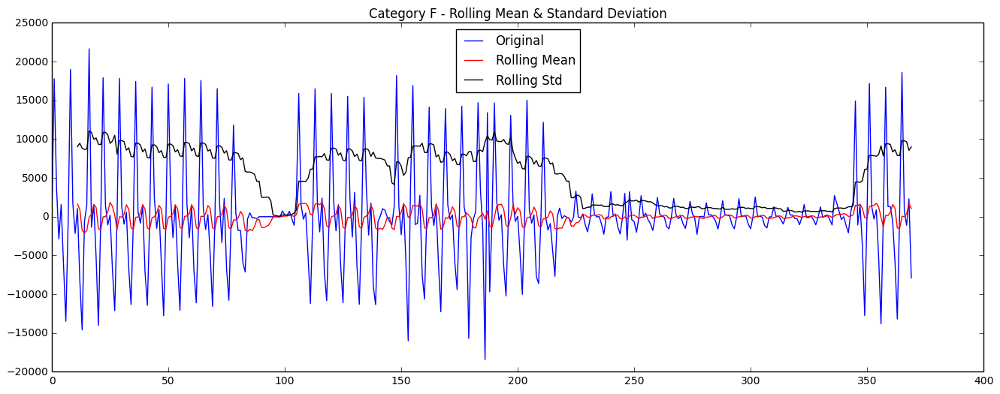

Results of Dickey-Fuller Test:
Test Statistic                -5.825841e+00
p-value                        4.081366e-07
#Lags Used                     1.300000e+01
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


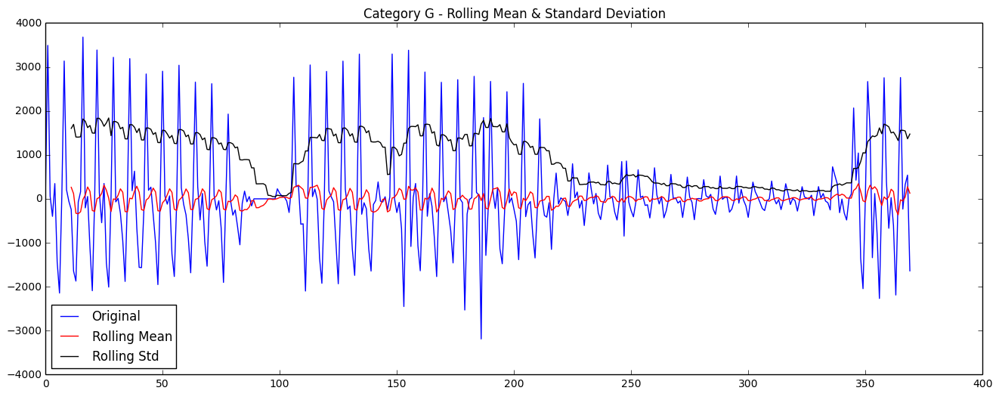

Results of Dickey-Fuller Test:
Test Statistic                -5.924021e+00
p-value                        2.467971e-07
#Lags Used                     1.300000e+01
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


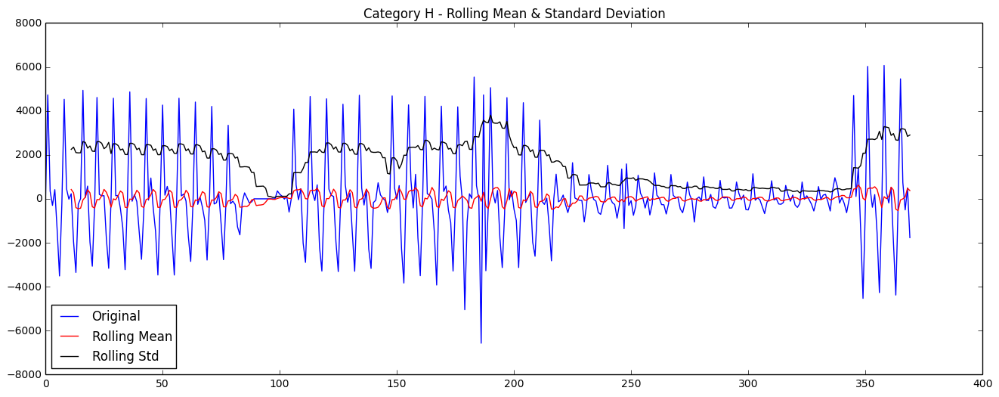

Results of Dickey-Fuller Test:
Test Statistic                -5.678165e+00
p-value                        8.608323e-07
#Lags Used                     1.300000e+01
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


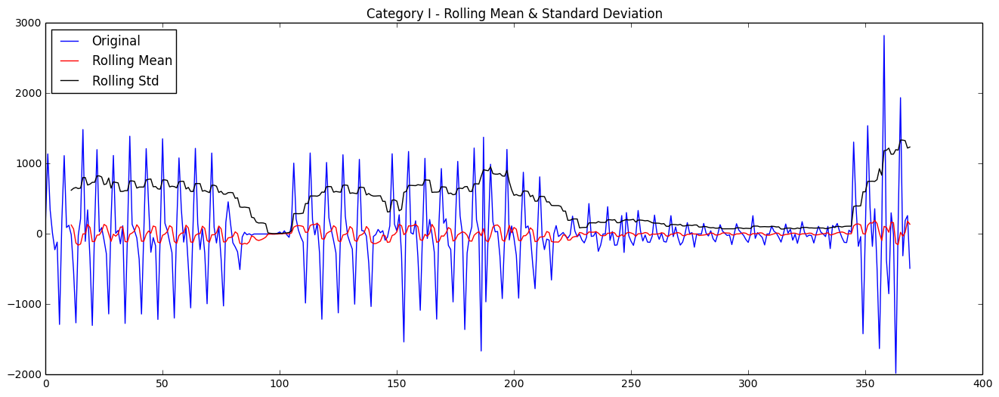

Results of Dickey-Fuller Test:
Test Statistic                  -5.533433
p-value                          0.000002
#Lags Used                      13.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


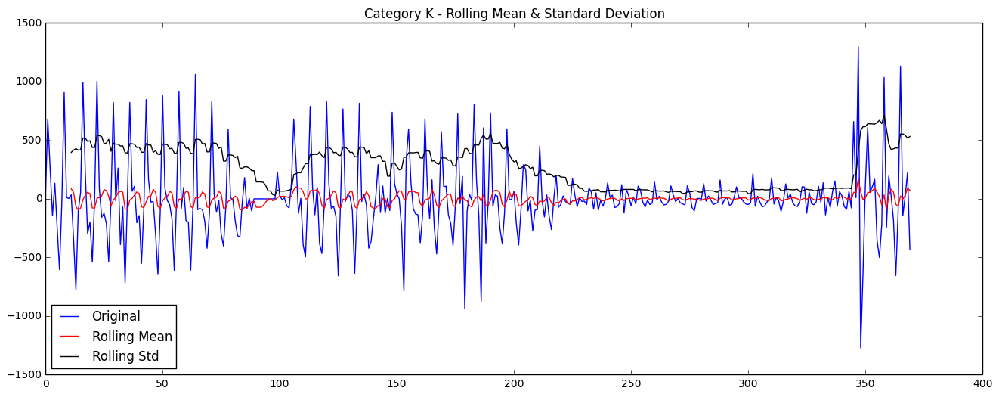

Results of Dickey-Fuller Test:
Test Statistic                  -5.143490
p-value                          0.000011
#Lags Used                      14.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


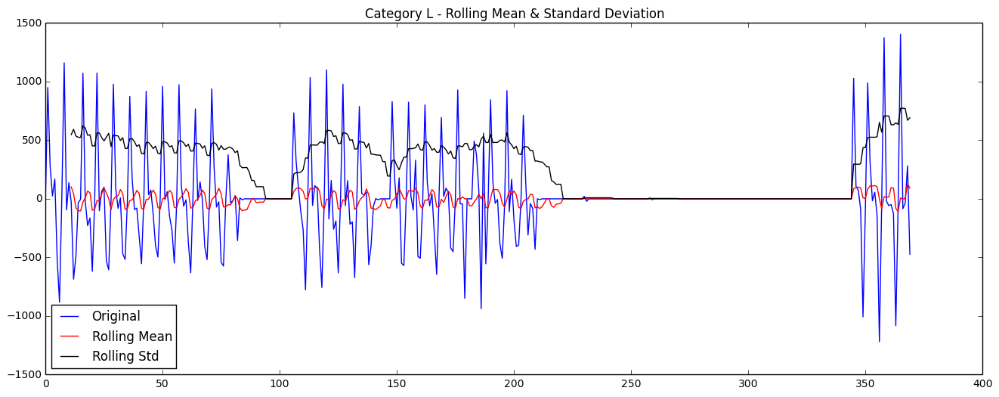

Results of Dickey-Fuller Test:
Test Statistic                -7.863862e+00
p-value                        5.197269e-12
#Lags Used                     9.000000e+00
Number of Observations Used    3.600000e+02
Critical Value (5%)           -2.869602e+00
Critical Value (1%)           -3.448646e+00
Critical Value (10%)          -2.571065e+00
dtype: float64


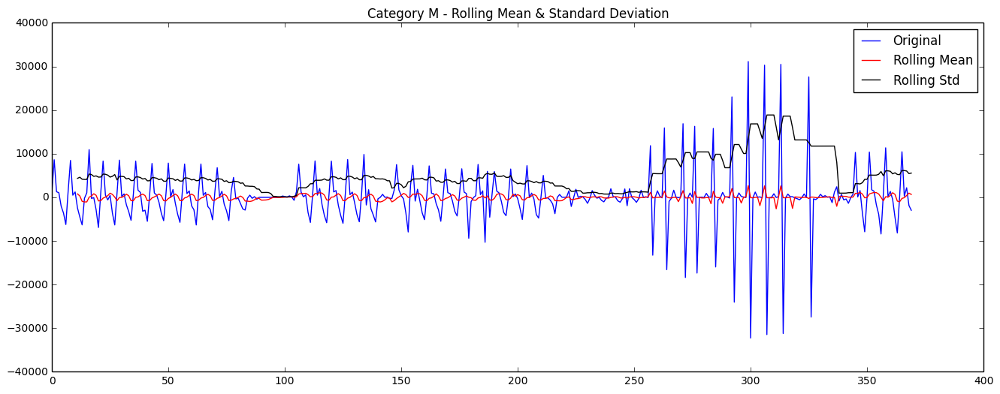

Results of Dickey-Fuller Test:
Test Statistic                -6.434880e+00
p-value                        1.662333e-08
#Lags Used                     1.300000e+01
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


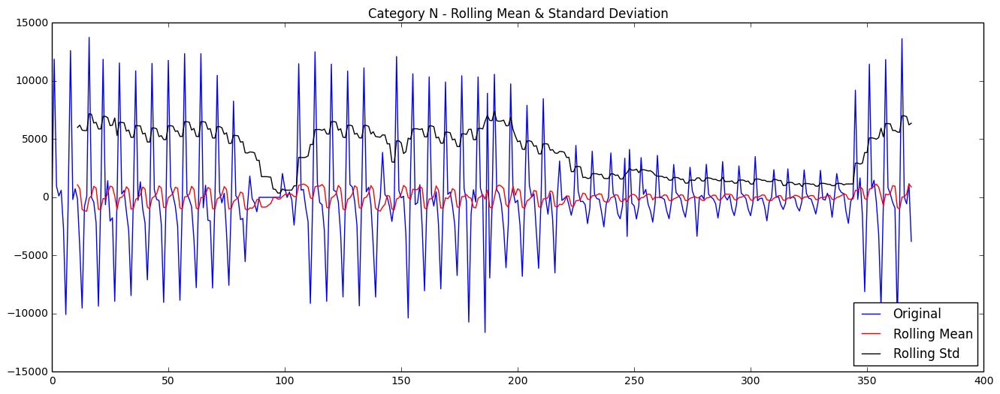

Results of Dickey-Fuller Test:
Test Statistic                -5.913104e+00
p-value                        2.610638e-07
#Lags Used                     1.300000e+01
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


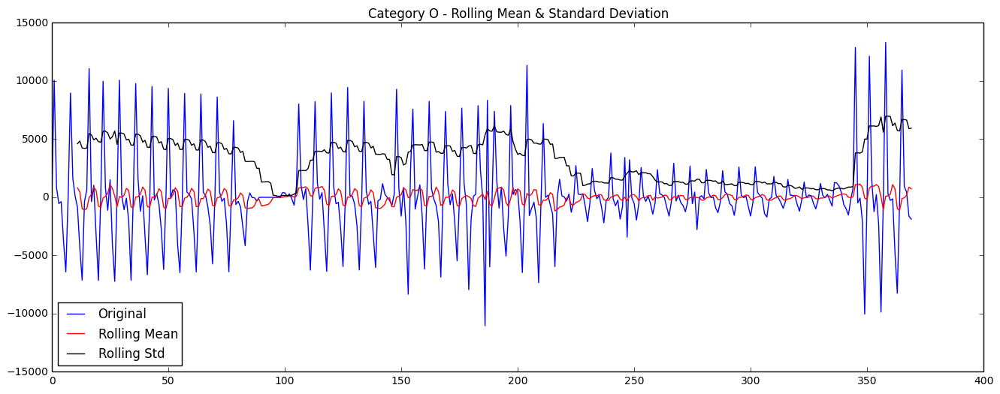

Results of Dickey-Fuller Test:
Test Statistic                  -5.640991
p-value                          0.000001
#Lags Used                      13.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


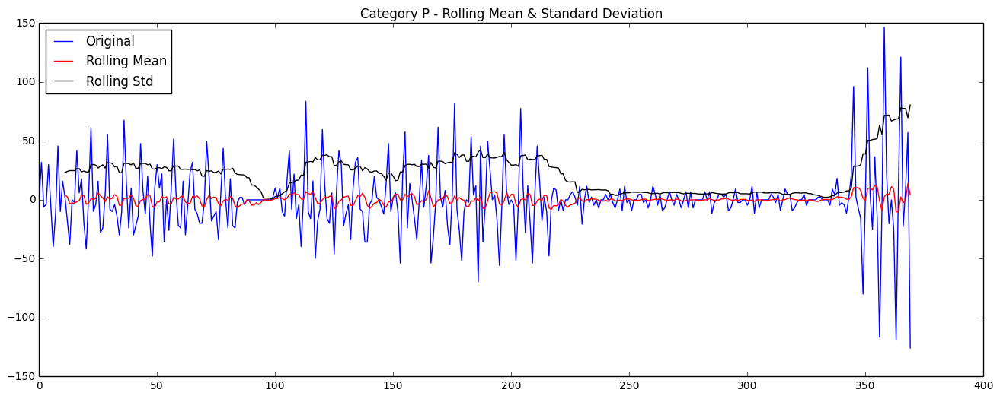

Results of Dickey-Fuller Test:
Test Statistic                -7.282411e+00
p-value                        1.488507e-10
#Lags Used                     7.000000e+00
Number of Observations Used    3.620000e+02
Critical Value (5%)           -2.869557e+00
Critical Value (1%)           -3.448544e+00
Critical Value (10%)          -2.571041e+00
dtype: float64


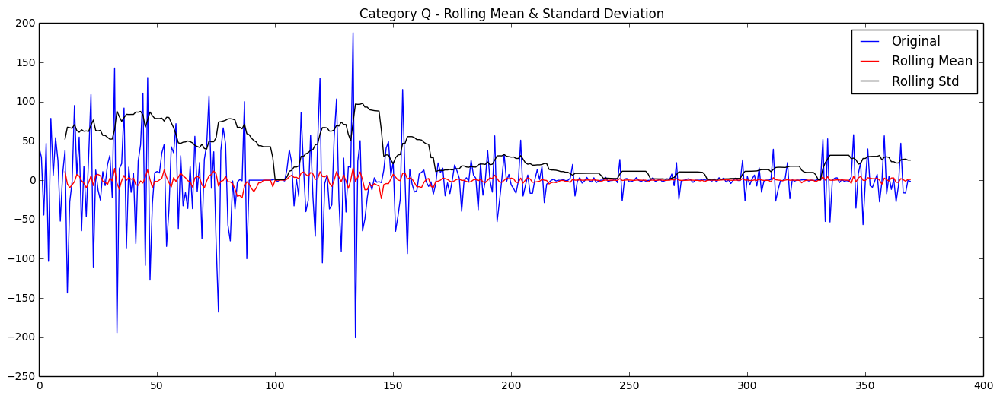

Results of Dickey-Fuller Test:
Test Statistic                  -4.749606
p-value                          0.000068
#Lags Used                      16.000000
Number of Observations Used    353.000000
Critical Value (5%)             -2.869763
Critical Value (1%)             -3.449011
Critical Value (10%)            -2.571151
dtype: float64


In [87]:
# Because we've taken a shift in the time series, the first day becomes NaN.
# We must drop the NaN for Dickey-Fuller Test to work.

_ = map(lambda x: x.dropna(inplace=True), splitted_data_diff)
_ = map(test_stationarity, splitted_data_diff, temp_list)

In [92]:
# See if detrending improved test statistics, or made it worse.
## Detrending seems better than inverse sine?

stat_diff(splitted_data_diff, temp_list)

A : 3.47056726686
B : 3.29065255224
C : 3.47640260267
D : 4.46144626699
E : 3.49388002265
F : 3.57386932676
G : 3.56288239437
H : 3.50505323409
I : 3.37792147784
K : 3.01079707551
L : 5.69888612033
M : 3.71784690451
N : 3.50426645917
O : 3.14705163928
P : 4.88028499317
Q : 2.51927494344
Mean test stats improvement (higher is better):  3.66819270499


# 3.3) Detrend(Inversed())

2015-09-26         NaN
2015-09-27    0.396778
2015-09-28    1.411993
2015-09-29    0.168415
2015-09-30   -0.078987
Freq: D, Name: sales, dtype: float64


/Library/Python/2.7/site-packages/ipykernel/__main__.py:7: FutureWarning: pd.rolling_mean is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).mean()
/Library/Python/2.7/site-packages/ipykernel/__main__.py:8: FutureWarning: pd.rolling_std is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).std()


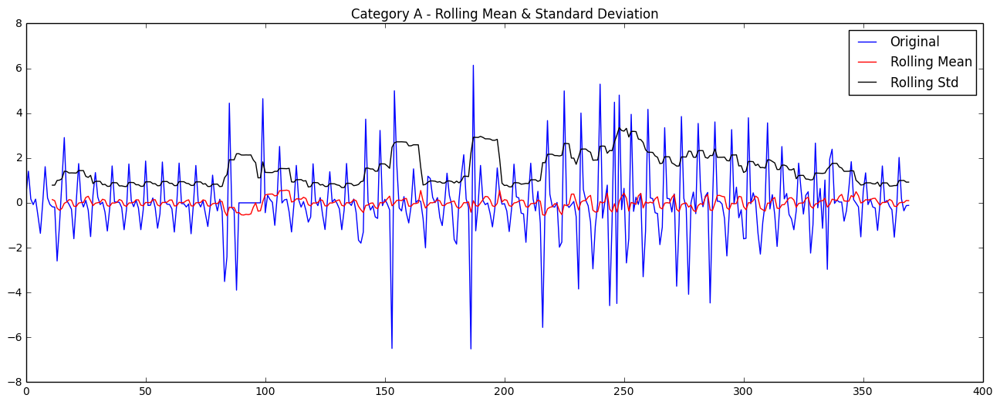

Results of Dickey-Fuller Test:
Test Statistic                -5.946686e+00
p-value                        2.195736e-07
#Lags Used                     1.300000e+01
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


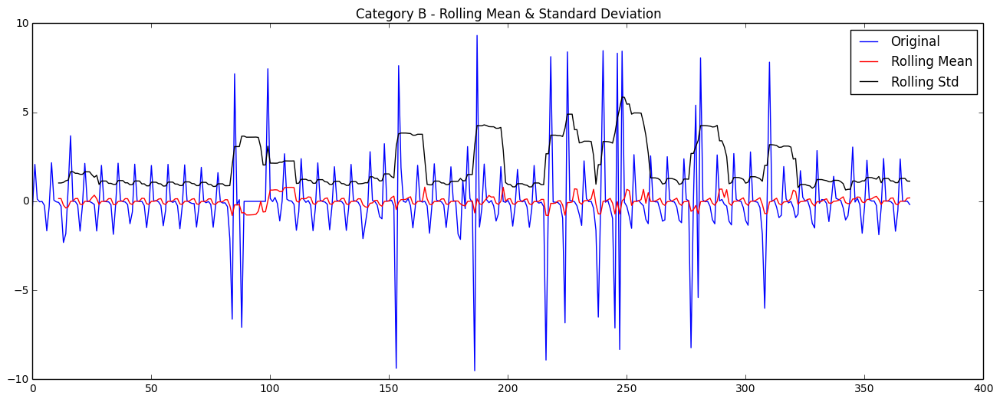

Results of Dickey-Fuller Test:
Test Statistic                -6.422115e+00
p-value                        1.780940e-08
#Lags Used                     1.300000e+01
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


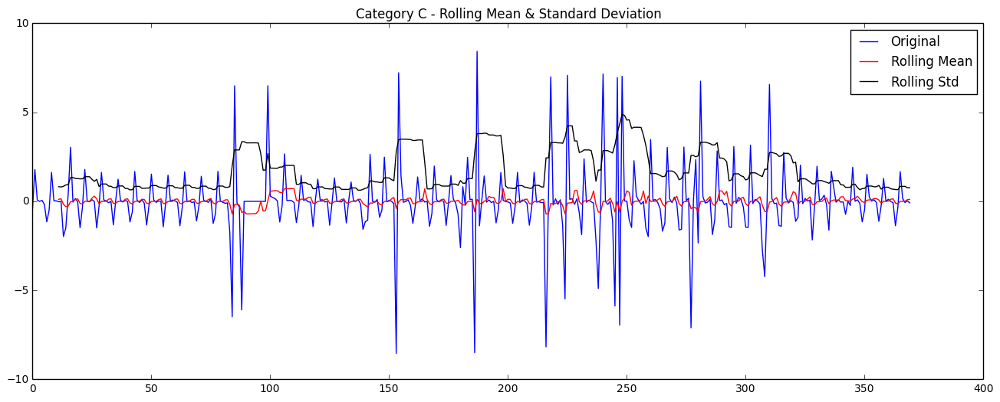

Results of Dickey-Fuller Test:
Test Statistic                -6.325405e+00
p-value                        2.994958e-08
#Lags Used                     1.300000e+01
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


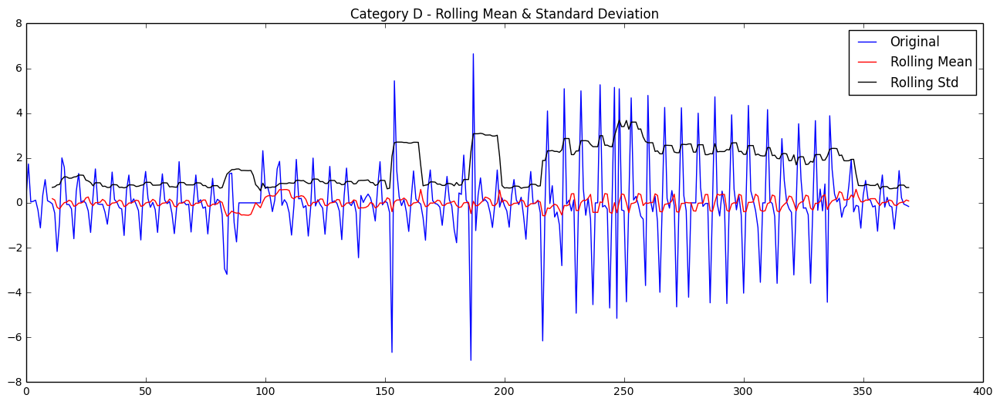

Results of Dickey-Fuller Test:
Test Statistic                  -4.469984
p-value                          0.000223
#Lags Used                      14.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


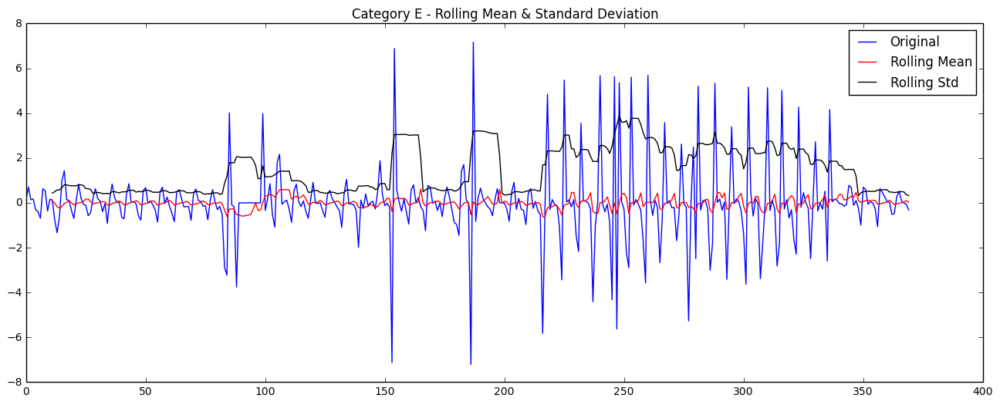

Results of Dickey-Fuller Test:
Test Statistic                  -5.504829
p-value                          0.000002
#Lags Used                      13.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


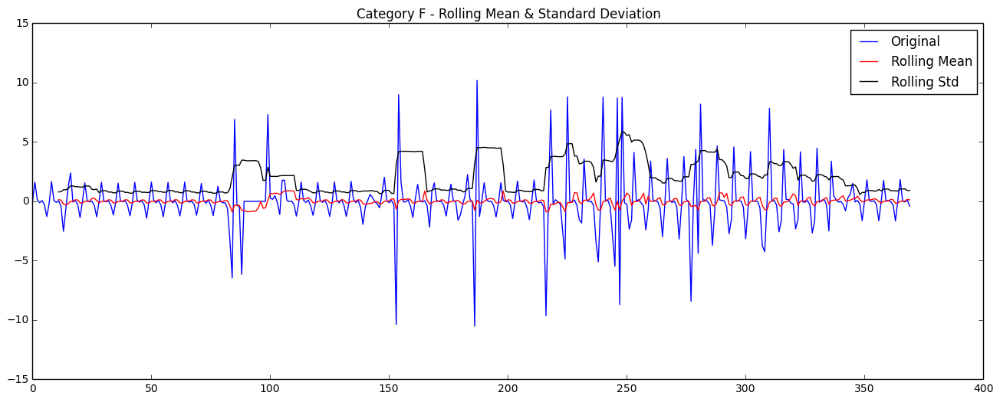

Results of Dickey-Fuller Test:
Test Statistic                -6.030199e+00
p-value                        1.424016e-07
#Lags Used                     1.300000e+01
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


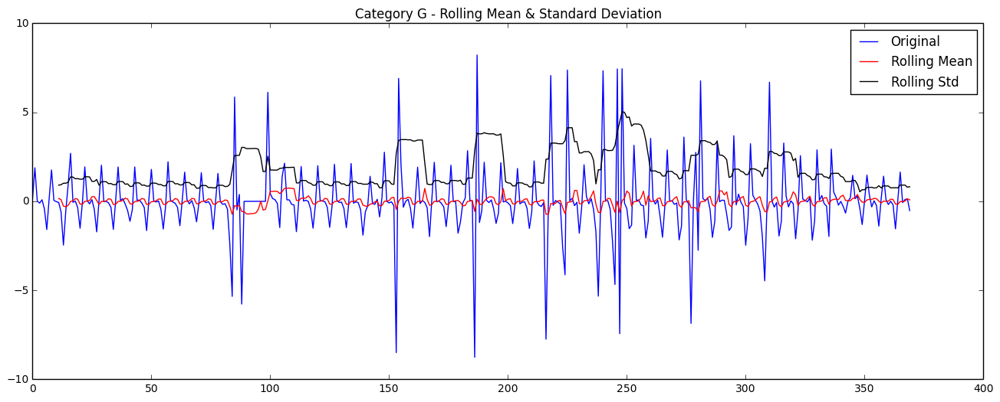

Results of Dickey-Fuller Test:
Test Statistic                -6.189736e+00
p-value                        6.164363e-08
#Lags Used                     1.300000e+01
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


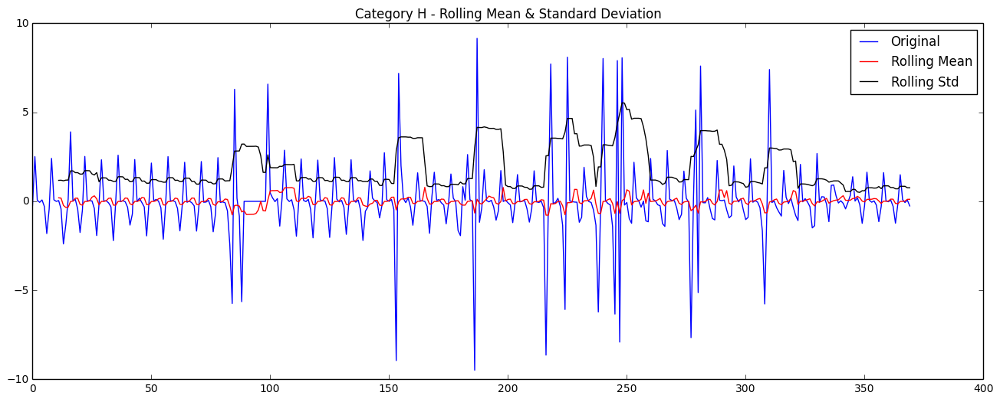

Results of Dickey-Fuller Test:
Test Statistic                -6.293961e+00
p-value                        3.543120e-08
#Lags Used                     1.300000e+01
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


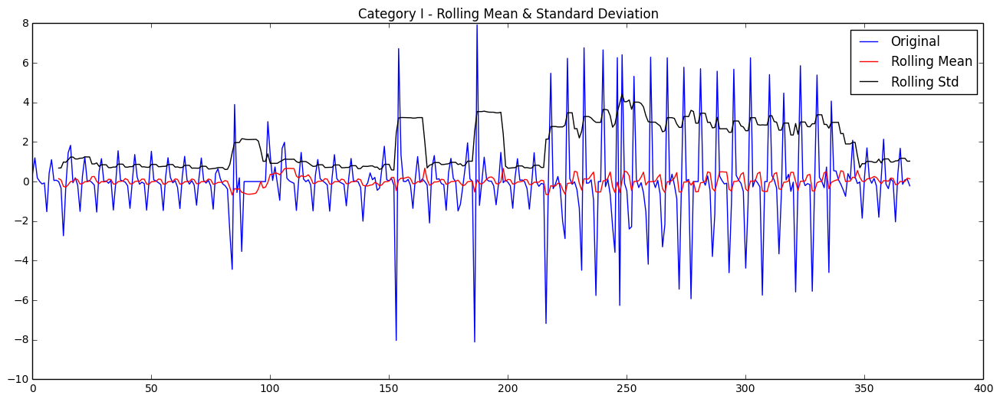

Results of Dickey-Fuller Test:
Test Statistic                  -5.538518
p-value                          0.000002
#Lags Used                      13.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


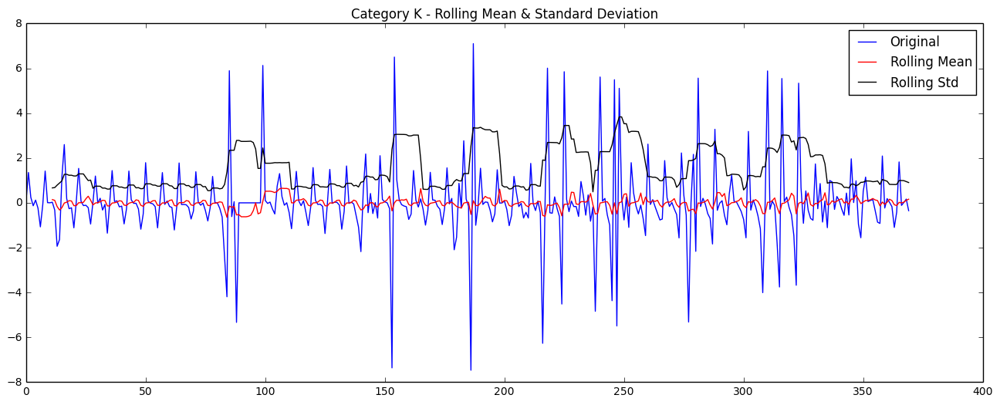

Results of Dickey-Fuller Test:
Test Statistic                -6.066609e+00
p-value                        1.177666e-07
#Lags Used                     1.300000e+01
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


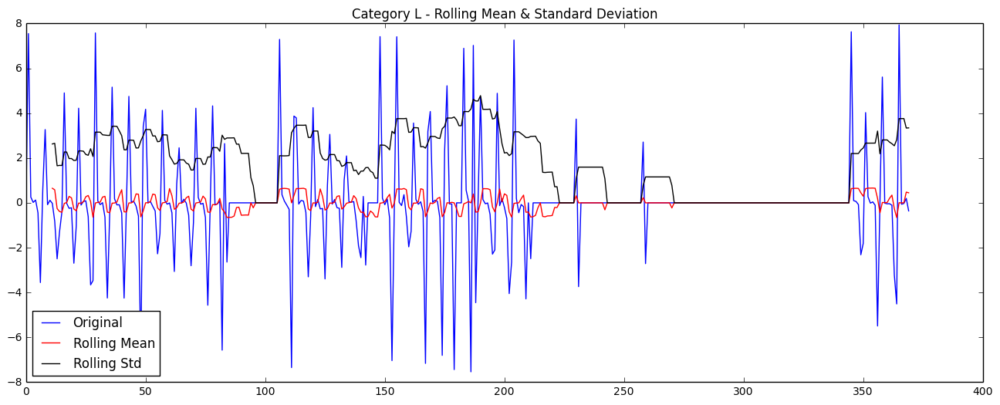

Results of Dickey-Fuller Test:
Test Statistic                -5.711645e+00
p-value                        7.276513e-07
#Lags Used                     1.300000e+01
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


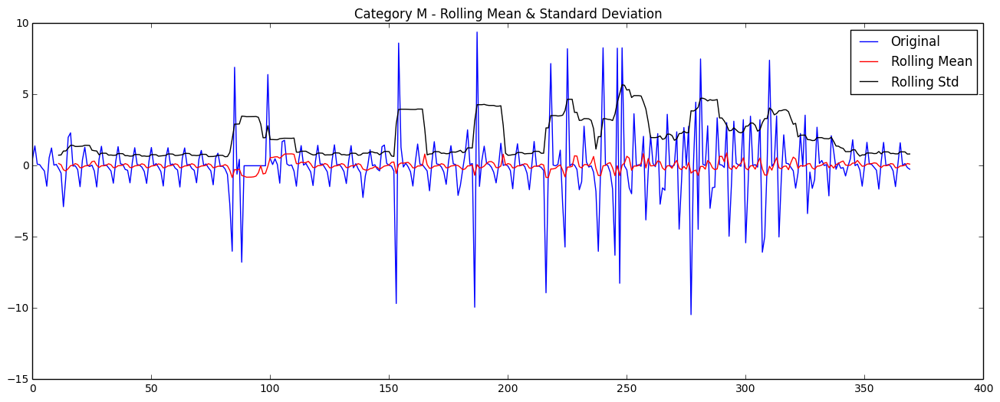

Results of Dickey-Fuller Test:
Test Statistic                -5.945349e+00
p-value                        2.210950e-07
#Lags Used                     1.300000e+01
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


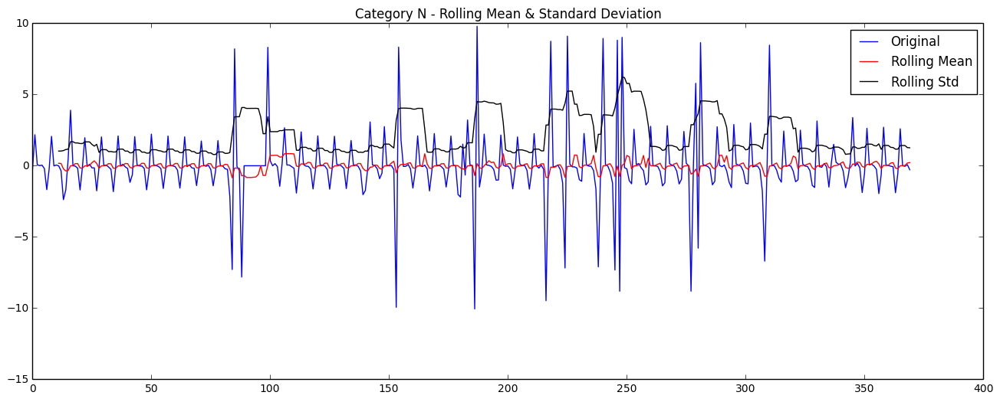

Results of Dickey-Fuller Test:
Test Statistic                -6.556851e+00
p-value                        8.573844e-09
#Lags Used                     1.300000e+01
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


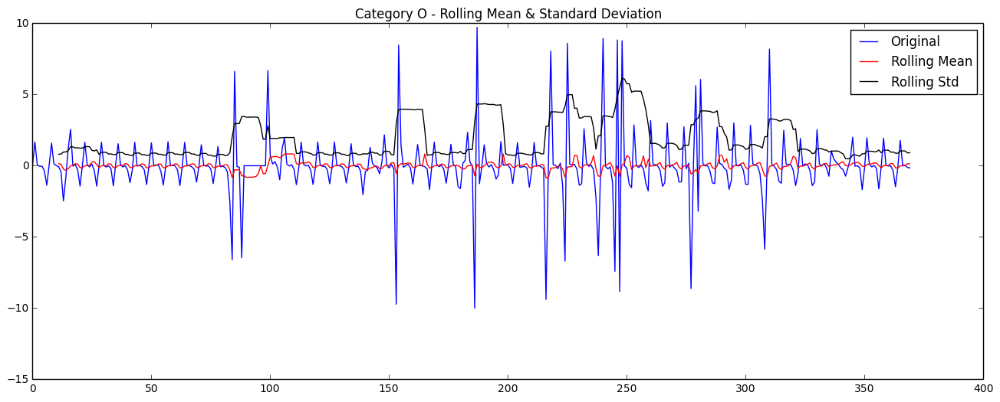

Results of Dickey-Fuller Test:
Test Statistic                -6.165259e+00
p-value                        7.015171e-08
#Lags Used                     1.300000e+01
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


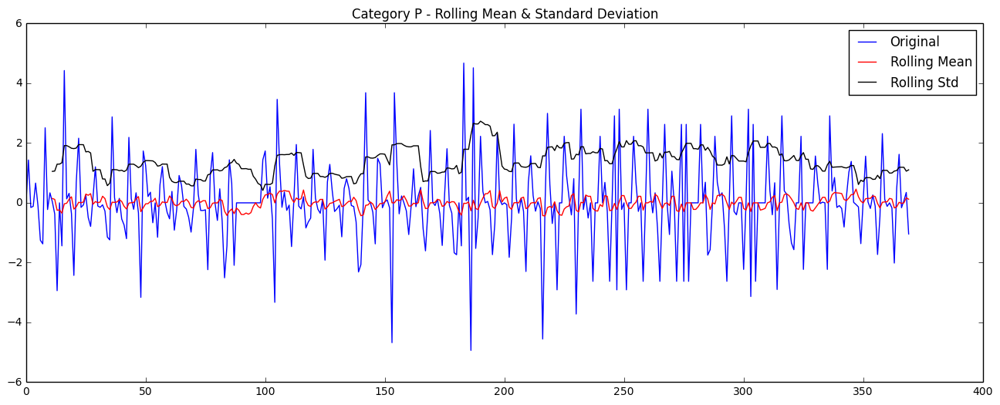

Results of Dickey-Fuller Test:
Test Statistic                -6.423179e+00
p-value                        1.770746e-08
#Lags Used                     1.300000e+01
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


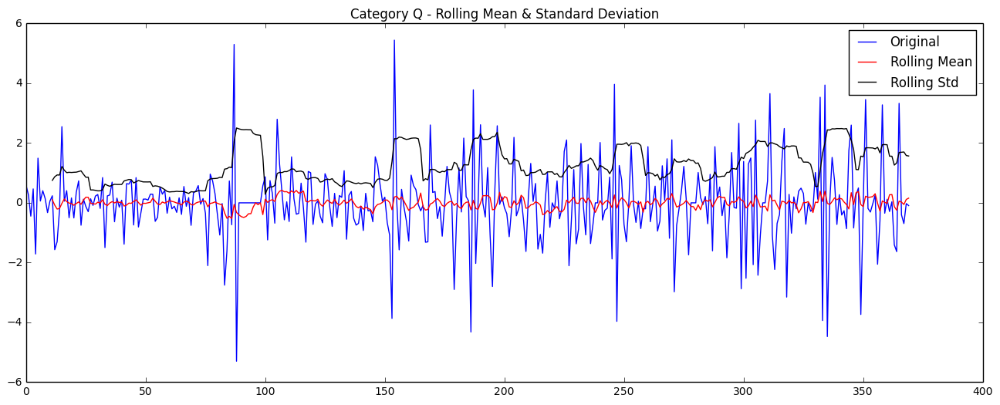

Results of Dickey-Fuller Test:
Test Statistic                  -5.330052
p-value                          0.000005
#Lags Used                      14.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64
A : 3.6512237311
B : 3.99348639616
C : 3.85873238605
D : 2.21467816351
E : 3.48112721036
F : 3.77822714946
G : 3.82859690826
H : 4.12084904146
I : 3.383006674
K : 3.93391656399
L : 3.54666882358
M : 3.22831573947
N : 4.14801286491
O : 3.67132015946
P : 4.02105332392
Q : 3.09972092382
Mean test stats improvement (higher is better):  3.62243350372


In [98]:
# Differencing to deal with the trend.
# Inversed first difference

splitted_data_diff_log = map(diff_data, splitted_data_log, temp_list)
print splitted_data_diff_log[0].head()

_ = map(lambda x: x.dropna(inplace=True), splitted_data_diff_log)
_ = map(test_stationarity, splitted_data_diff_log, temp_list)

stat_diff(splitted_data_diff_log, temp_list)

# 3.4) Seasonal(obs)

/Library/Python/2.7/site-packages/ipykernel/__main__.py:7: FutureWarning: pd.rolling_mean is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).mean()
/Library/Python/2.7/site-packages/ipykernel/__main__.py:8: FutureWarning: pd.rolling_std is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).std()


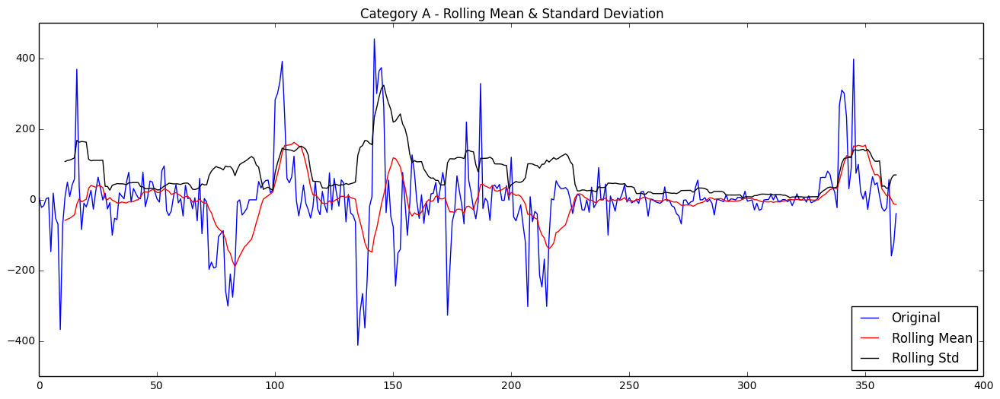

Results of Dickey-Fuller Test:
Test Statistic                  -4.420175
p-value                          0.000273
#Lags Used                      17.000000
Number of Observations Used    346.000000
Critical Value (5%)             -2.869930
Critical Value (1%)             -3.449392
Critical Value (10%)            -2.571240
dtype: float64


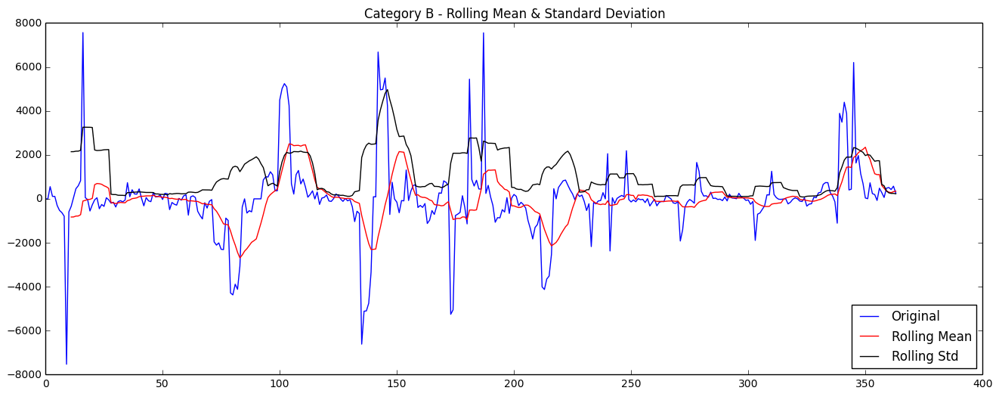

Results of Dickey-Fuller Test:
Test Statistic                -5.682397e+00
p-value                        8.427691e-07
#Lags Used                     7.000000e+00
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


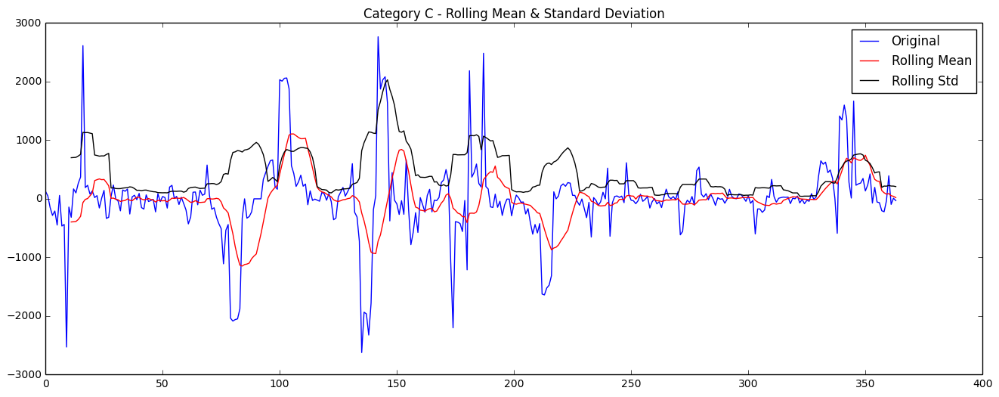

Results of Dickey-Fuller Test:
Test Statistic                  -4.284587
p-value                          0.000472
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64


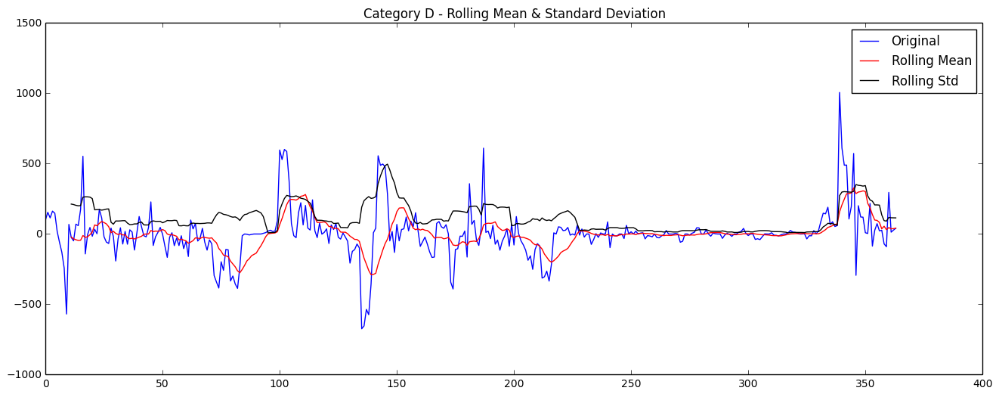

Results of Dickey-Fuller Test:
Test Statistic                  -3.963666
p-value                          0.001613
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64


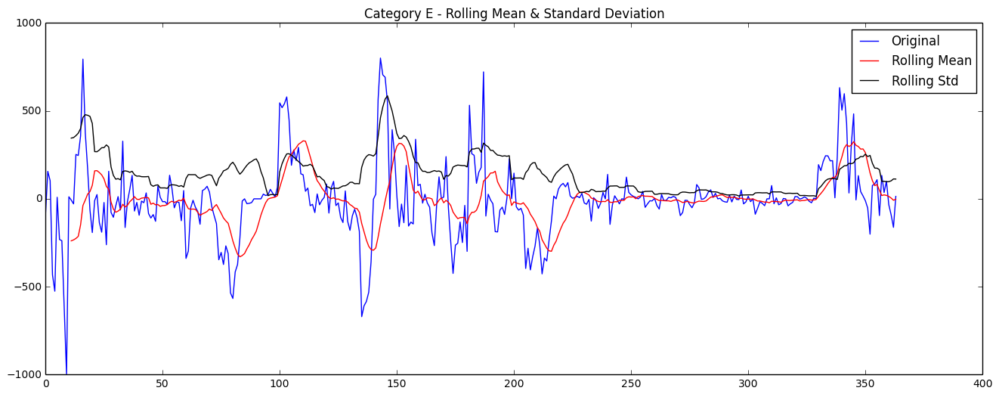

Results of Dickey-Fuller Test:
Test Statistic                  -4.264224
p-value                          0.000512
#Lags Used                      17.000000
Number of Observations Used    346.000000
Critical Value (5%)             -2.869930
Critical Value (1%)             -3.449392
Critical Value (10%)            -2.571240
dtype: float64


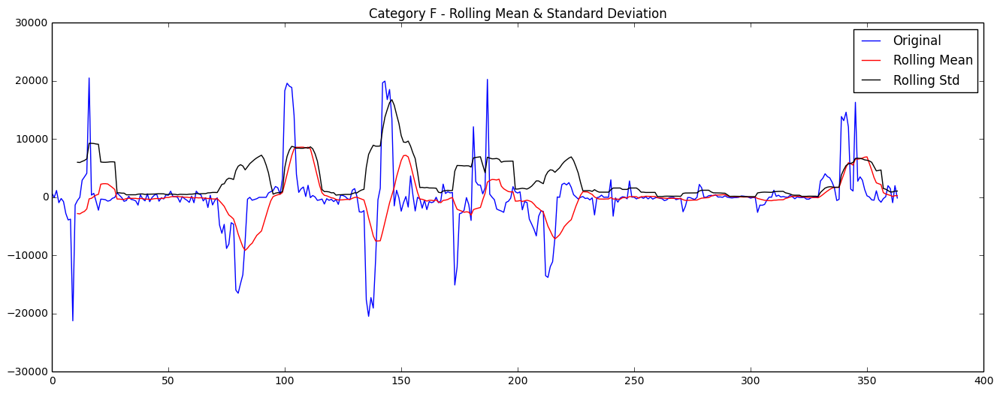

Results of Dickey-Fuller Test:
Test Statistic                -5.669486e+00
p-value                        8.990731e-07
#Lags Used                     7.000000e+00
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


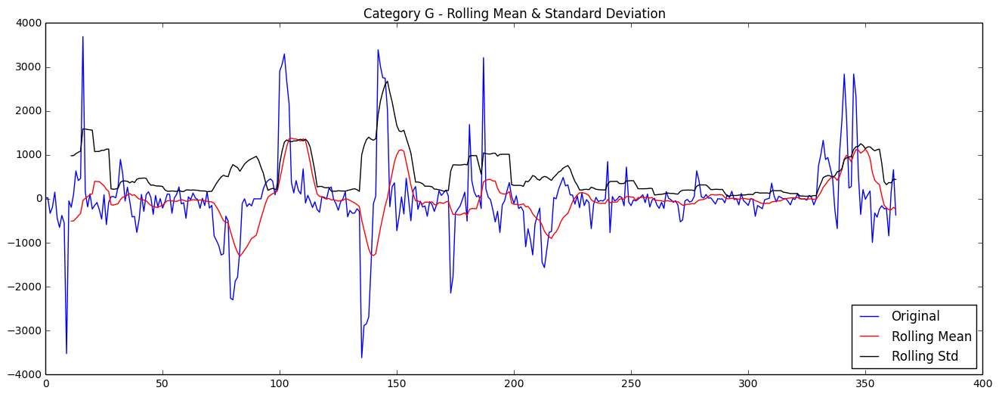

Results of Dickey-Fuller Test:
Test Statistic                -5.883337e+00
p-value                        3.041946e-07
#Lags Used                     7.000000e+00
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


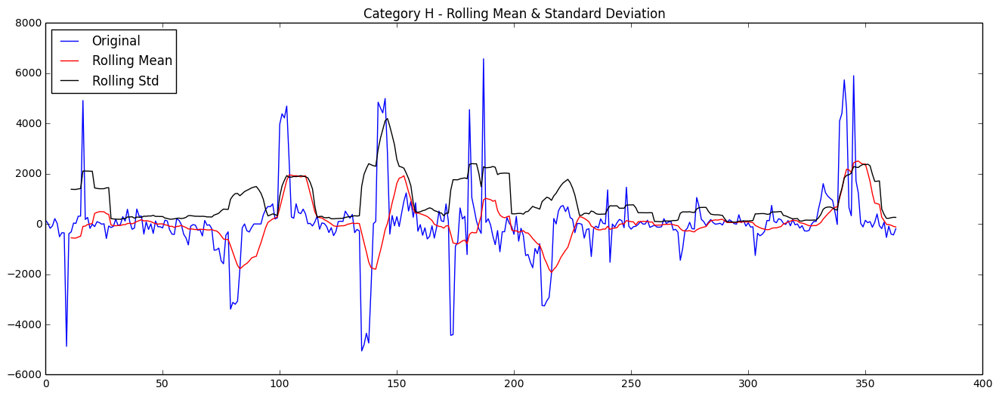

Results of Dickey-Fuller Test:
Test Statistic                -5.648971e+00
p-value                        9.961674e-07
#Lags Used                     7.000000e+00
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


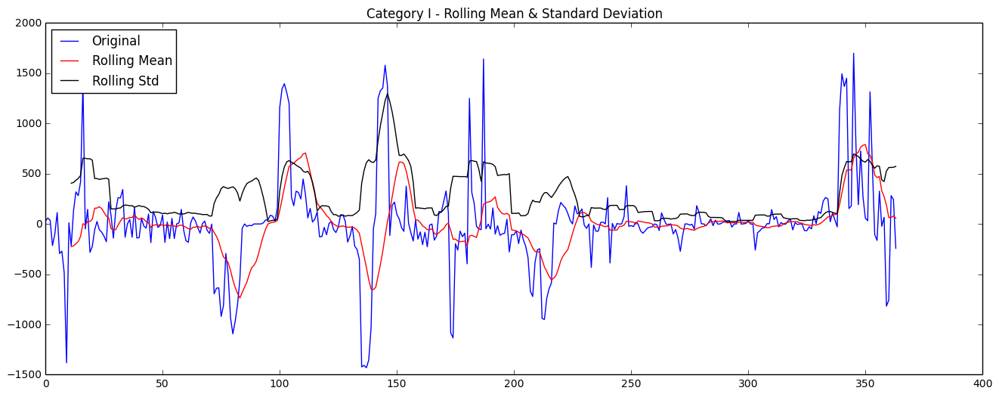

Results of Dickey-Fuller Test:
Test Statistic                  -4.139147
p-value                          0.000834
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64


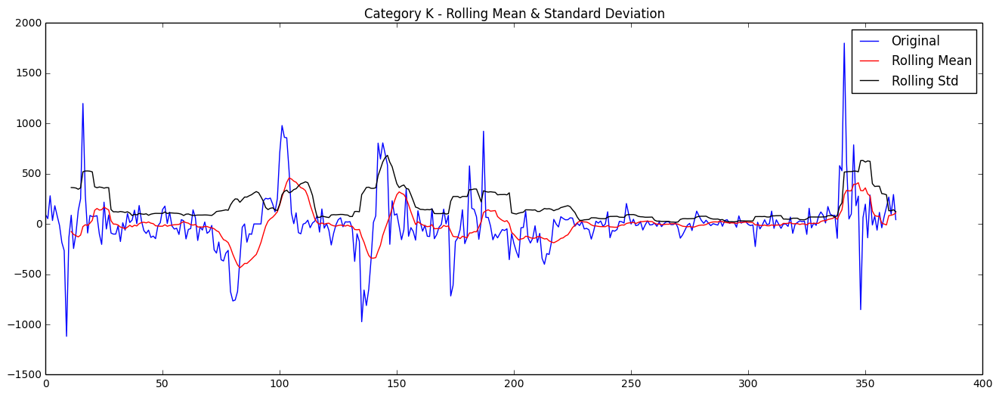

Results of Dickey-Fuller Test:
Test Statistic                  -4.267255
p-value                          0.000506
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64


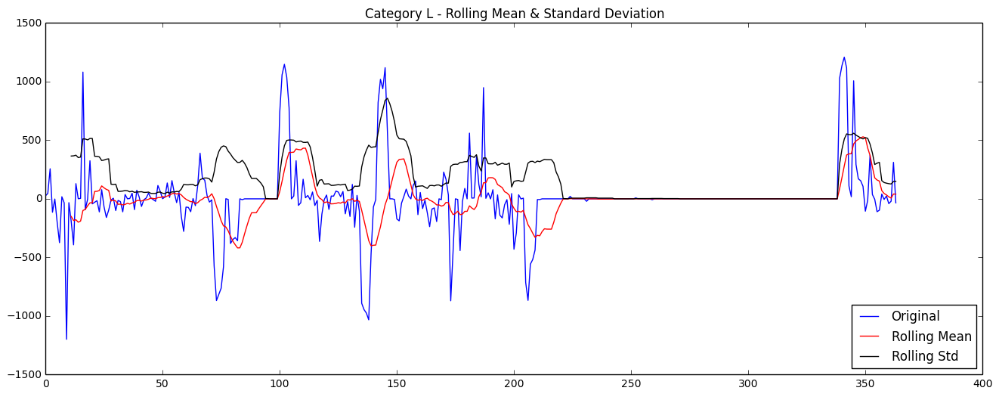

Results of Dickey-Fuller Test:
Test Statistic                -7.416560e+00
p-value                        6.910804e-11
#Lags Used                     6.000000e+00
Number of Observations Used    3.570000e+02
Critical Value (5%)           -2.869670e+00
Critical Value (1%)           -3.448801e+00
Critical Value (10%)          -2.571101e+00
dtype: float64


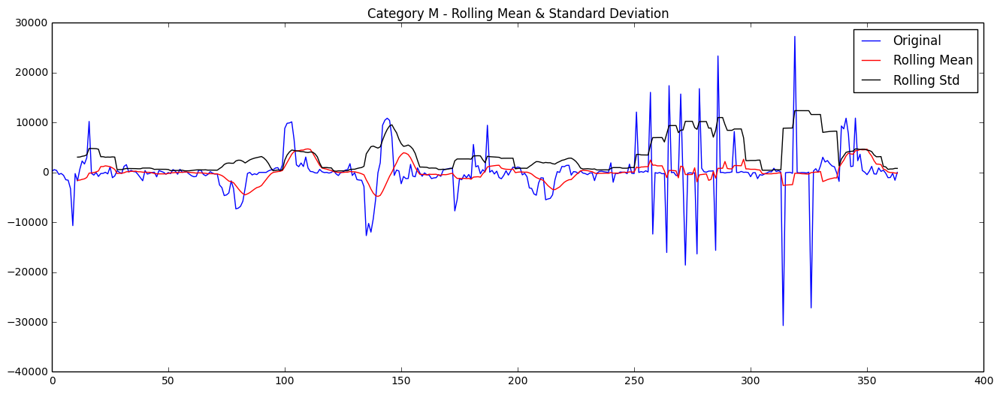

Results of Dickey-Fuller Test:
Test Statistic                  -5.337926
p-value                          0.000005
#Lags Used                      13.000000
Number of Observations Used    350.000000
Critical Value (5%)             -2.869833
Critical Value (1%)             -3.449173
Critical Value (10%)            -2.571188
dtype: float64


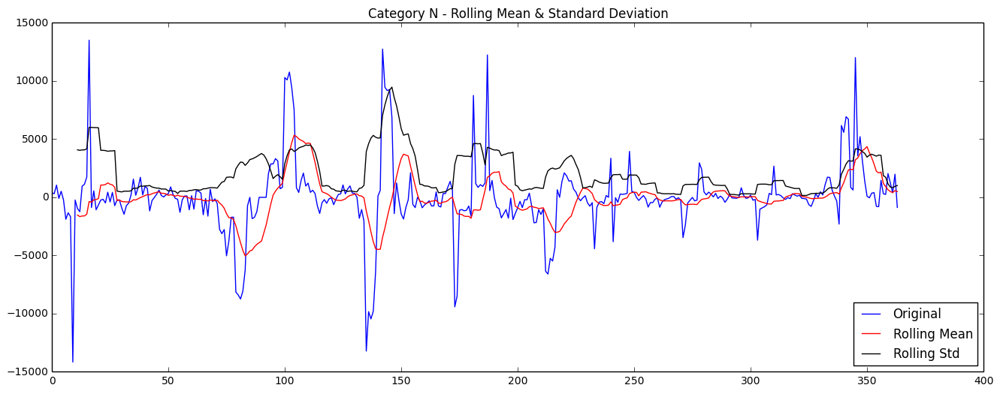

Results of Dickey-Fuller Test:
Test Statistic                -5.863138e+00
p-value                        3.373563e-07
#Lags Used                     7.000000e+00
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


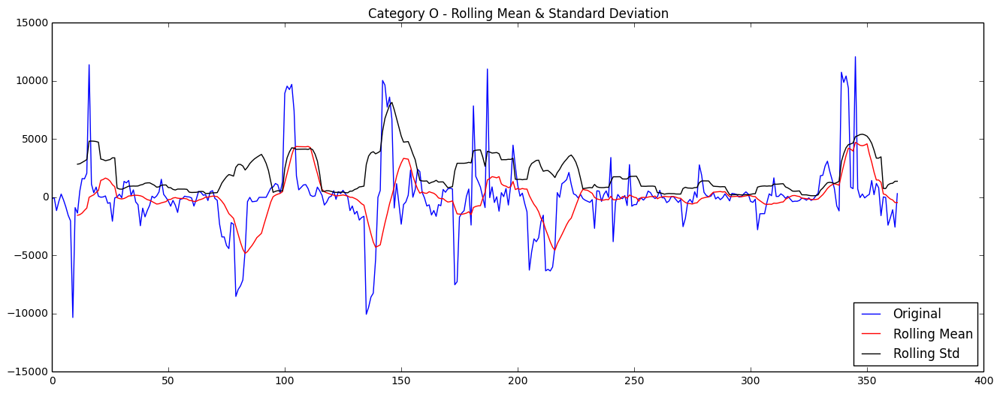

Results of Dickey-Fuller Test:
Test Statistic                  -4.327350
p-value                          0.000398
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64


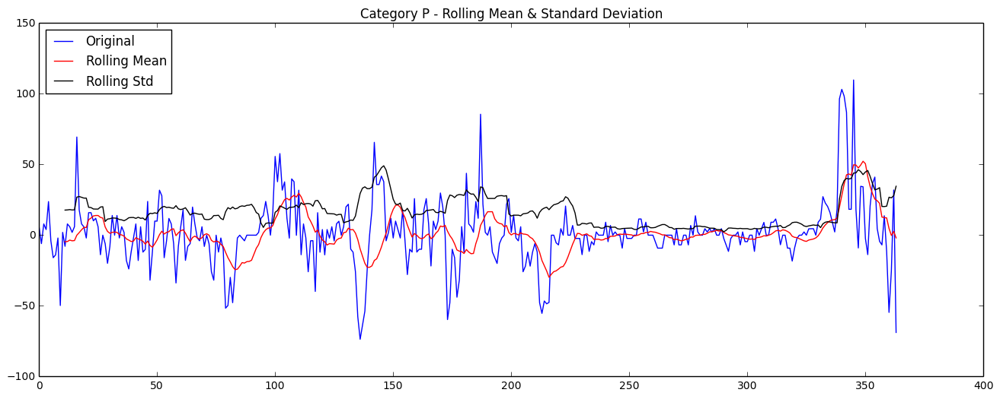

Results of Dickey-Fuller Test:
Test Statistic                  -5.005011
p-value                          0.000022
#Lags Used                       7.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


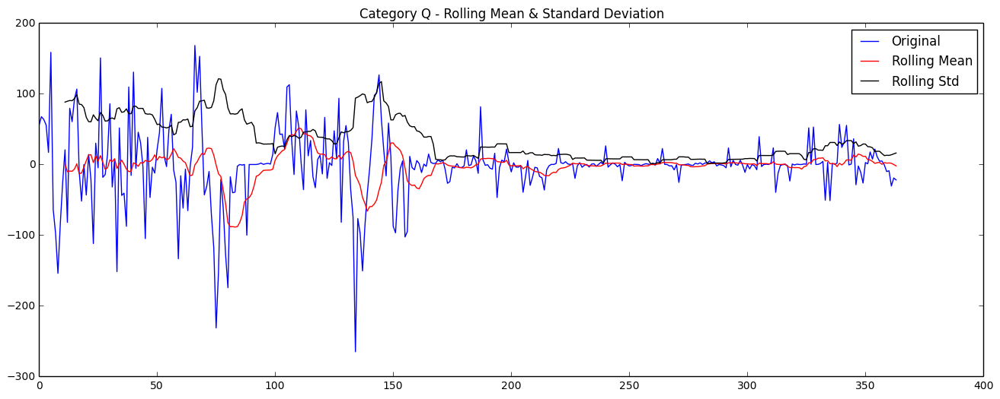

Results of Dickey-Fuller Test:
Test Statistic                  -5.040388
p-value                          0.000018
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64
A : 2.12471251541
B : 3.25376800544
C : 1.81791452803
D : 1.70836054829
E : 2.24052249989
F : 3.41751413298
G : 3.5221974883
H : 3.4758594215
I : 1.98363588554
K : 2.13456229344
L : 5.25158357475
M : 2.62089316113
N : 3.45430011597
O : 1.83341089184
P : 2.60288532609
Q : 2.81005700546
Mean test stats improvement (higher is better):  2.76576108713


In [100]:
splitted_data_season = map(lambda x: x - x.shift(7), splitted_data)
_ = map(lambda x: x.dropna(inplace=True), splitted_data_season)
_ = map(test_stationarity, splitted_data_season, temp_list)
stat_diff(splitted_data_season, temp_list)

# 3.5) Now seasonal(Inversed())

/Library/Python/2.7/site-packages/ipykernel/__main__.py:7: FutureWarning: pd.rolling_mean is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).mean()
/Library/Python/2.7/site-packages/ipykernel/__main__.py:8: FutureWarning: pd.rolling_std is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).std()


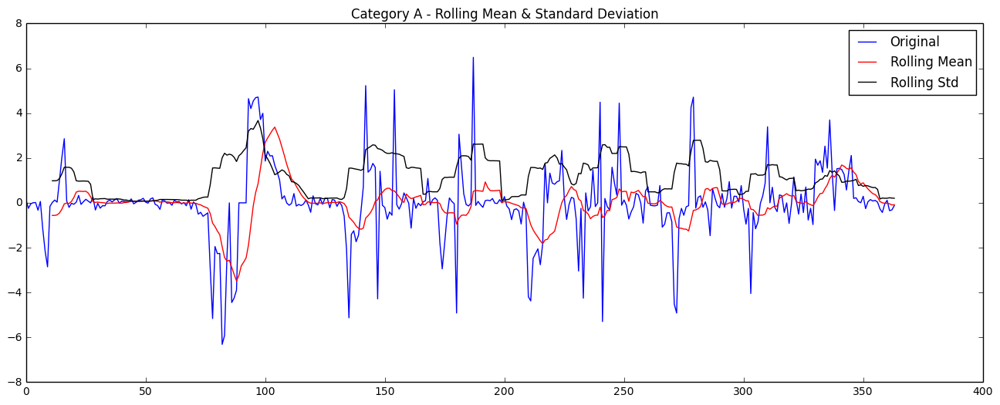

Results of Dickey-Fuller Test:
Test Statistic                  -4.710066
p-value                          0.000081
#Lags Used                      16.000000
Number of Observations Used    347.000000
Critical Value (5%)             -2.869906
Critical Value (1%)             -3.449337
Critical Value (10%)            -2.571227
dtype: float64


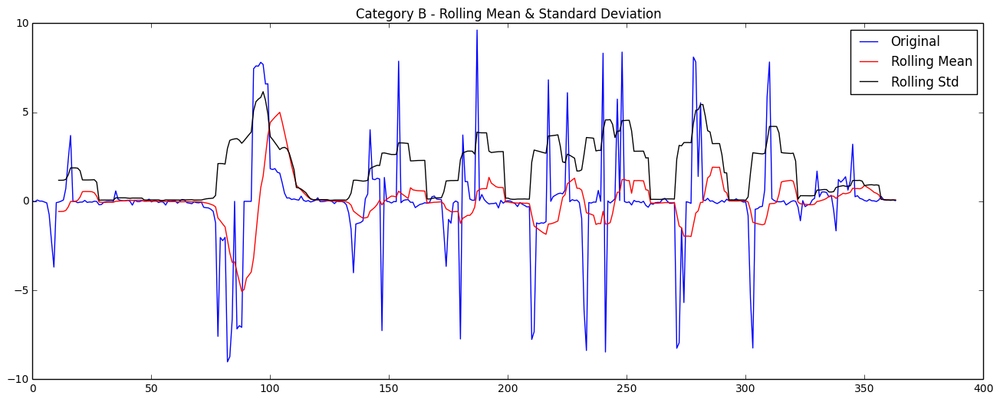

Results of Dickey-Fuller Test:
Test Statistic                -5.969552e+00
p-value                        1.950958e-07
#Lags Used                     1.400000e+01
Number of Observations Used    3.490000e+02
Critical Value (5%)           -2.869857e+00
Critical Value (1%)           -3.449227e+00
Critical Value (10%)          -2.571201e+00
dtype: float64


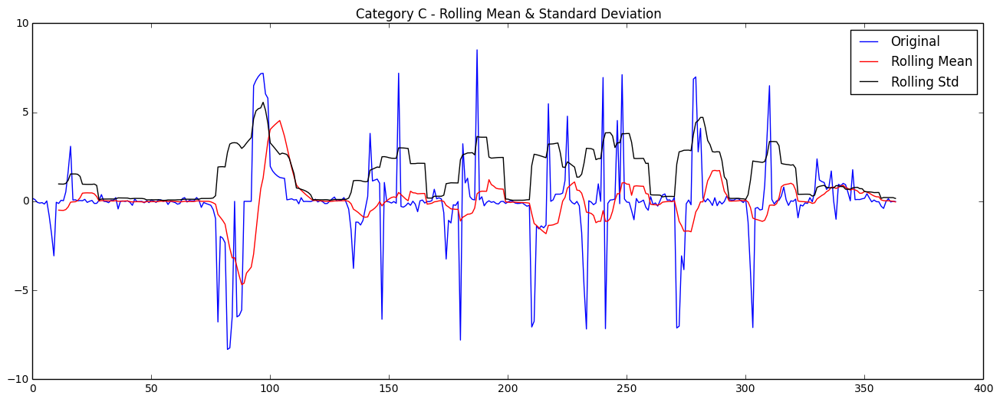

Results of Dickey-Fuller Test:
Test Statistic                -5.853271e+00
p-value                        3.548179e-07
#Lags Used                     1.400000e+01
Number of Observations Used    3.490000e+02
Critical Value (5%)           -2.869857e+00
Critical Value (1%)           -3.449227e+00
Critical Value (10%)          -2.571201e+00
dtype: float64


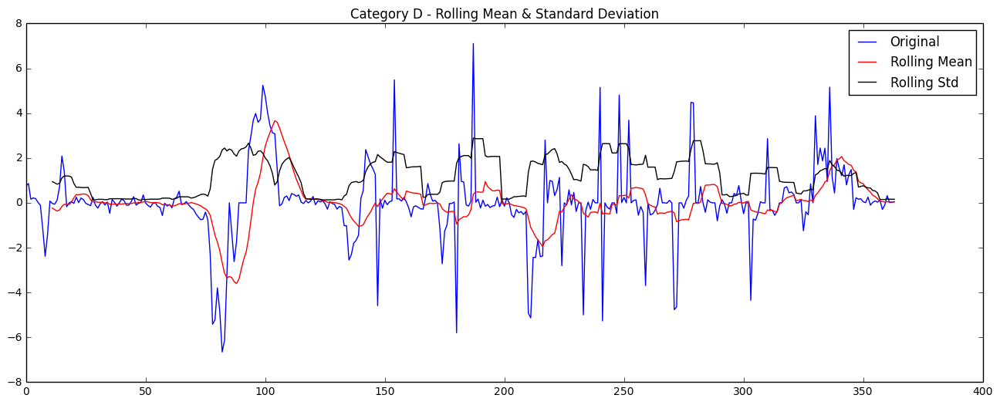

Results of Dickey-Fuller Test:
Test Statistic                  -5.076142
p-value                          0.000016
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64


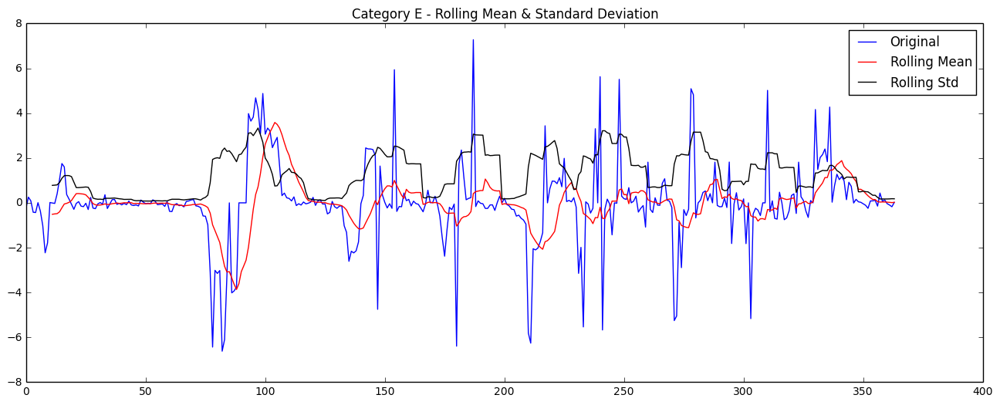

Results of Dickey-Fuller Test:
Test Statistic                  -5.350477
p-value                          0.000004
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64


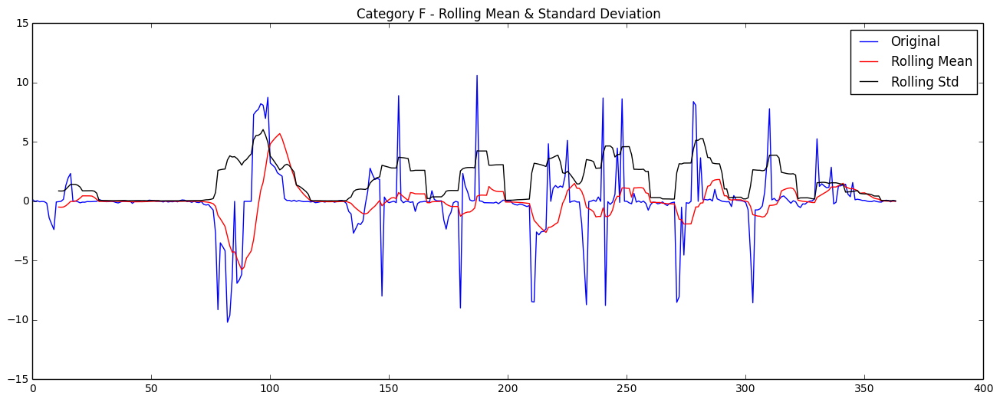

Results of Dickey-Fuller Test:
Test Statistic                -5.864949e+00
p-value                        3.342437e-07
#Lags Used                     1.400000e+01
Number of Observations Used    3.490000e+02
Critical Value (5%)           -2.869857e+00
Critical Value (1%)           -3.449227e+00
Critical Value (10%)          -2.571201e+00
dtype: float64


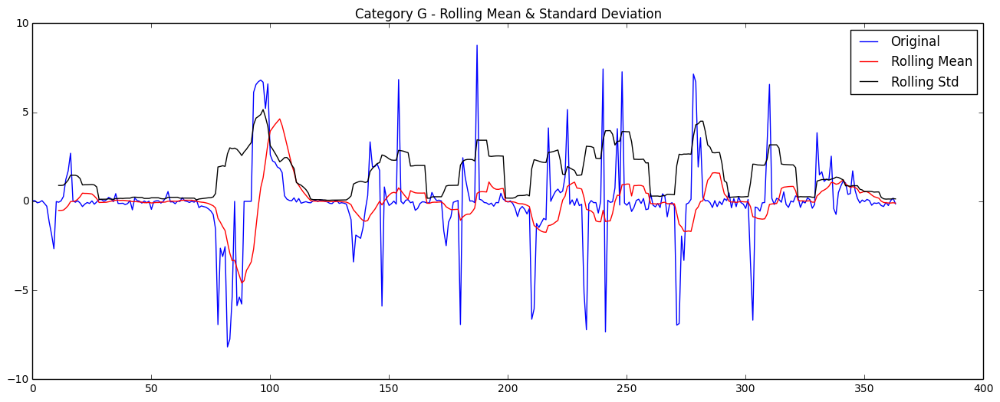

Results of Dickey-Fuller Test:
Test Statistic                -5.855756e+00
p-value                        3.503372e-07
#Lags Used                     1.400000e+01
Number of Observations Used    3.490000e+02
Critical Value (5%)           -2.869857e+00
Critical Value (1%)           -3.449227e+00
Critical Value (10%)          -2.571201e+00
dtype: float64


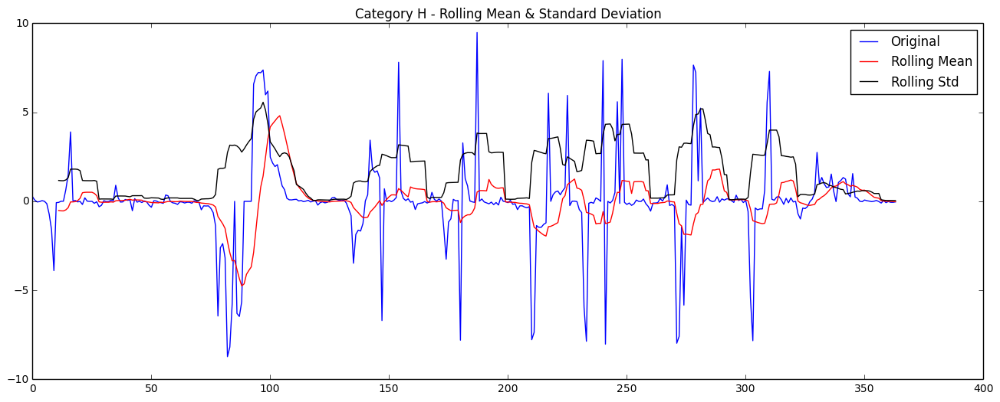

Results of Dickey-Fuller Test:
Test Statistic                -5.952925e+00
p-value                        2.126118e-07
#Lags Used                     1.400000e+01
Number of Observations Used    3.490000e+02
Critical Value (5%)           -2.869857e+00
Critical Value (1%)           -3.449227e+00
Critical Value (10%)          -2.571201e+00
dtype: float64


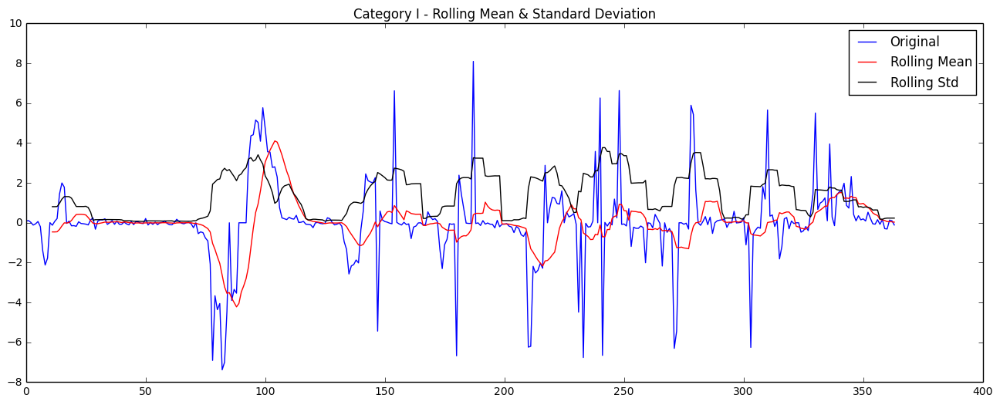

Results of Dickey-Fuller Test:
Test Statistic                  -5.415239
p-value                          0.000003
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64


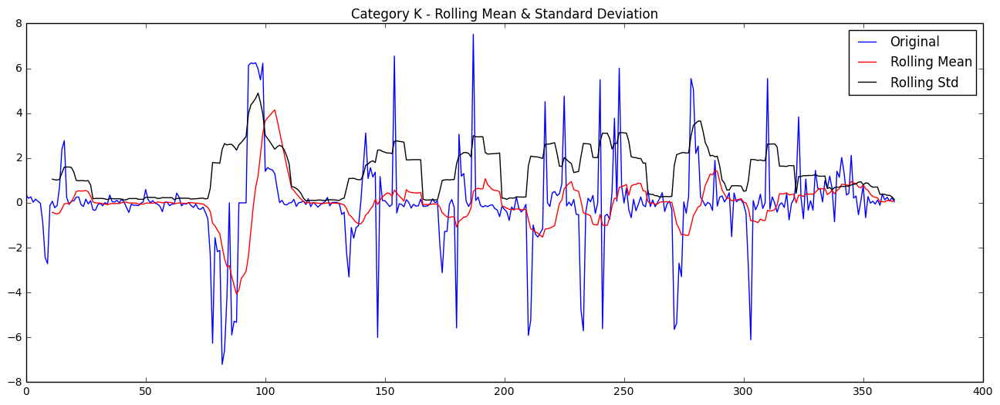

Results of Dickey-Fuller Test:
Test Statistic                -7.323809e+00
p-value                        1.175260e-10
#Lags Used                     1.300000e+01
Number of Observations Used    3.500000e+02
Critical Value (5%)           -2.869833e+00
Critical Value (1%)           -3.449173e+00
Critical Value (10%)          -2.571188e+00
dtype: float64


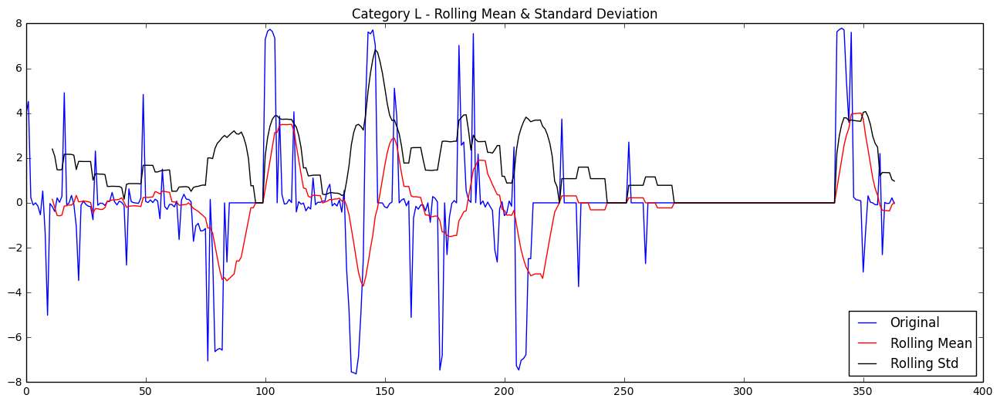

Results of Dickey-Fuller Test:
Test Statistic                  -5.002248
p-value                          0.000022
#Lags Used                      17.000000
Number of Observations Used    346.000000
Critical Value (5%)             -2.869930
Critical Value (1%)             -3.449392
Critical Value (10%)            -2.571240
dtype: float64


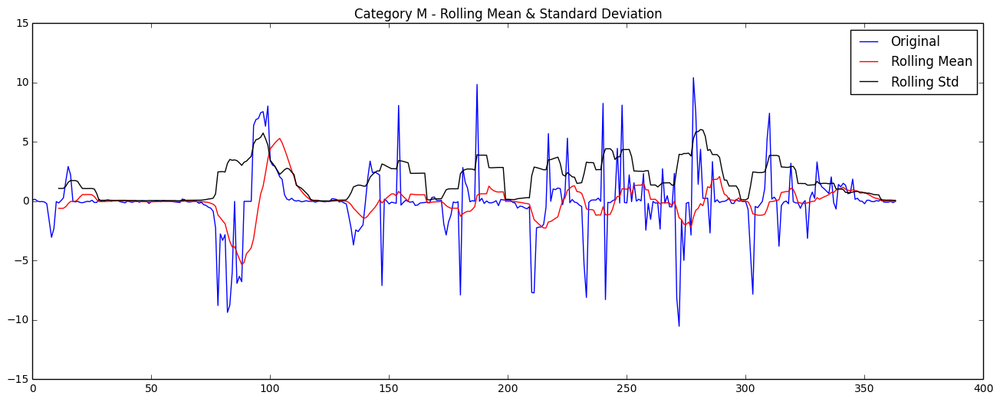

Results of Dickey-Fuller Test:
Test Statistic                  -5.272156
p-value                          0.000006
#Lags Used                      16.000000
Number of Observations Used    347.000000
Critical Value (5%)             -2.869906
Critical Value (1%)             -3.449337
Critical Value (10%)            -2.571227
dtype: float64


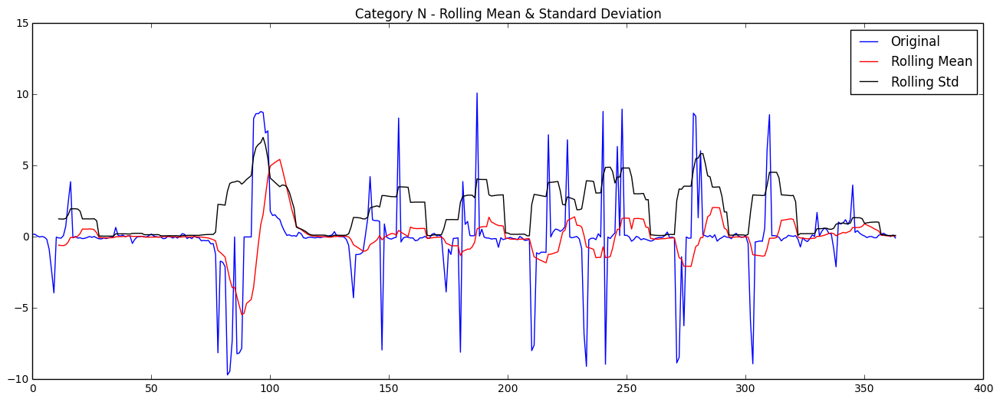

Results of Dickey-Fuller Test:
Test Statistic                -6.061468e+00
p-value                        1.209732e-07
#Lags Used                     1.400000e+01
Number of Observations Used    3.490000e+02
Critical Value (5%)           -2.869857e+00
Critical Value (1%)           -3.449227e+00
Critical Value (10%)          -2.571201e+00
dtype: float64


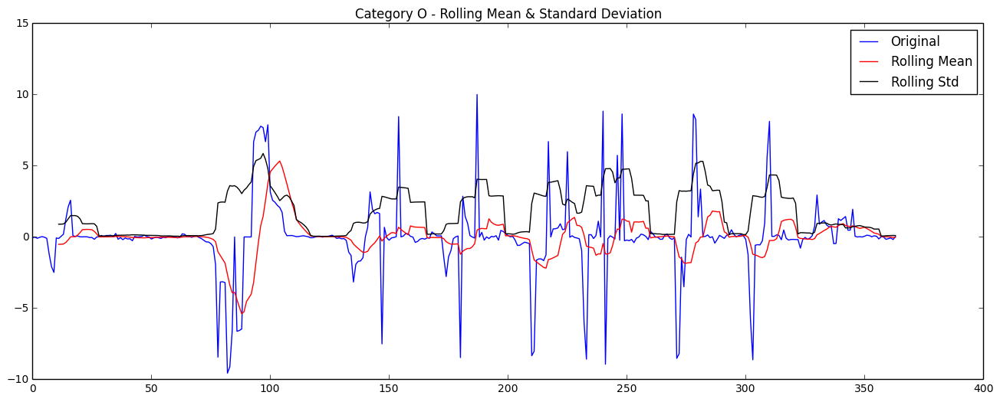

Results of Dickey-Fuller Test:
Test Statistic                -5.820806e+00
p-value                        4.187424e-07
#Lags Used                     1.400000e+01
Number of Observations Used    3.490000e+02
Critical Value (5%)           -2.869857e+00
Critical Value (1%)           -3.449227e+00
Critical Value (10%)          -2.571201e+00
dtype: float64


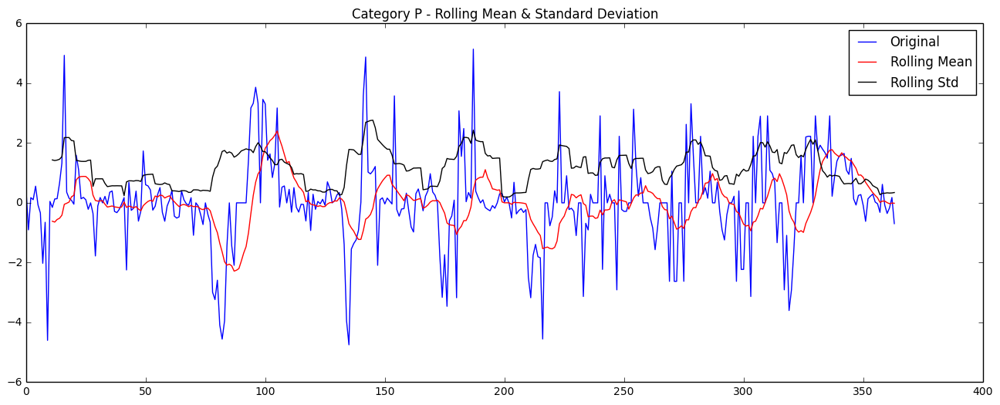

Results of Dickey-Fuller Test:
Test Statistic                  -4.759243
p-value                          0.000065
#Lags Used                      15.000000
Number of Observations Used    348.000000
Critical Value (5%)             -2.869881
Critical Value (1%)             -3.449282
Critical Value (10%)            -2.571214
dtype: float64


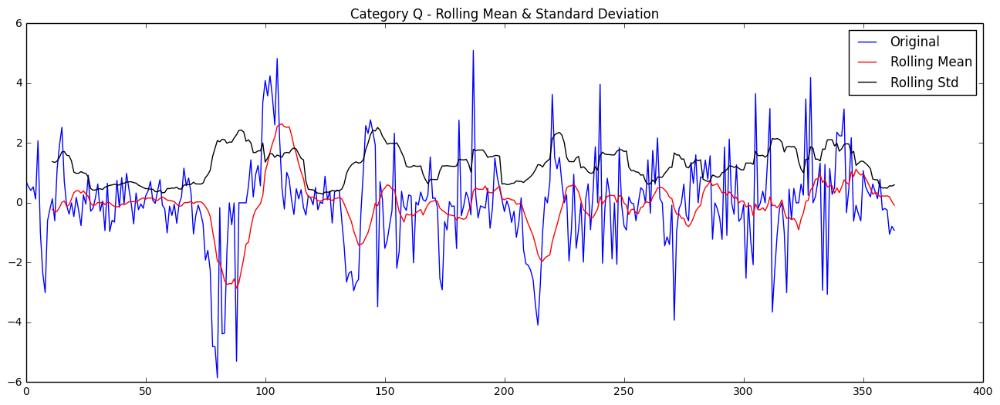

Results of Dickey-Fuller Test:
Test Statistic                  -4.781905
p-value                          0.000059
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64
A : 2.41460301898
B : 3.54092341496
C : 3.38659838052
D : 2.82083651726
E : 3.3267753291
F : 3.61297750004
G : 3.49461736129
H : 3.77981278778
I : 3.25972726054
K : 5.19111656374
L : 2.83727164881
M : 2.55512243071
N : 3.65262975827
O : 3.32686669995
P : 2.35711764336
Q : 2.55157395916
Mean test stats improvement (higher is better):  3.25678564215


In [101]:
# Differencing to deal with seasonality...
# Log seasonal

splitted_data_season_log = map(lambda x: x - x.shift(7), splitted_data_log)
_ = map(lambda x: x.dropna(inplace=True), splitted_data_season_log)
_ = map(test_stationarity, splitted_data_season_log, temp_list)
stat_diff(splitted_data_season_log, temp_list)

# 3.6) Seasonal(Diff())

/Library/Python/2.7/site-packages/ipykernel/__main__.py:7: FutureWarning: pd.rolling_mean is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).mean()
/Library/Python/2.7/site-packages/ipykernel/__main__.py:8: FutureWarning: pd.rolling_std is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).std()


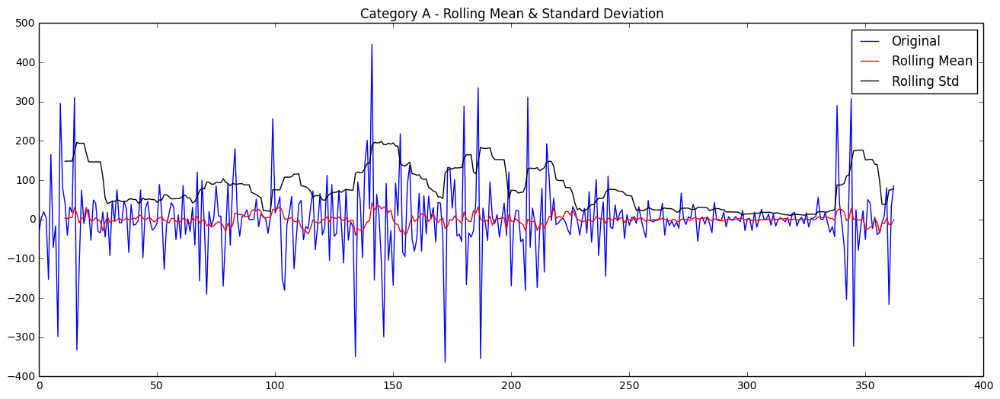

Results of Dickey-Fuller Test:
Test Statistic                -7.837677e+00
p-value                        6.053579e-12
#Lags Used                     1.300000e+01
Number of Observations Used    3.490000e+02
Critical Value (5%)           -2.869857e+00
Critical Value (1%)           -3.449227e+00
Critical Value (10%)          -2.571201e+00
dtype: float64


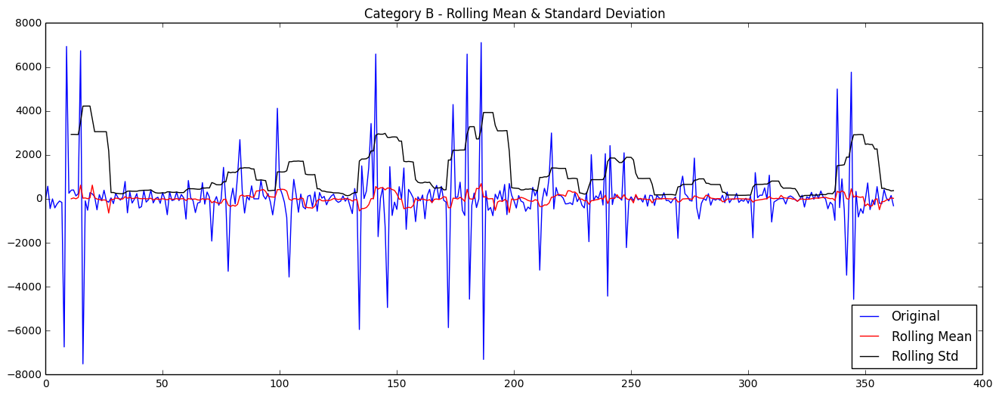

Results of Dickey-Fuller Test:
Test Statistic                -7.972722e+00
p-value                        2.753666e-12
#Lags Used                     1.300000e+01
Number of Observations Used    3.490000e+02
Critical Value (5%)           -2.869857e+00
Critical Value (1%)           -3.449227e+00
Critical Value (10%)          -2.571201e+00
dtype: float64


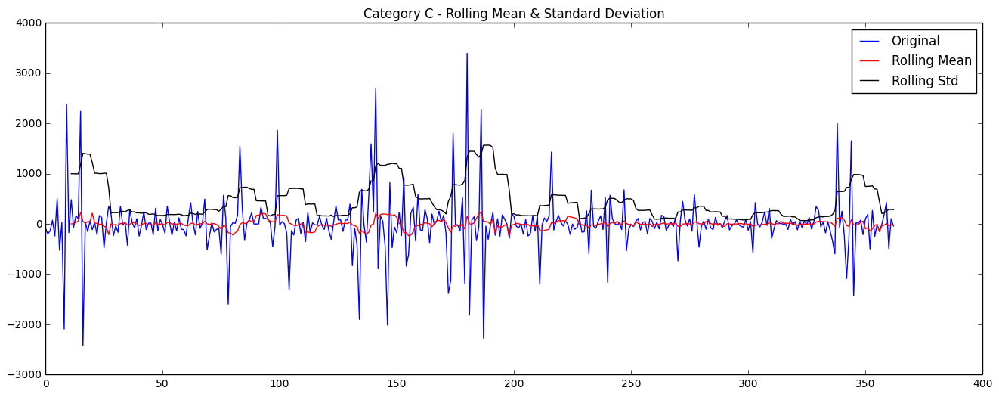

Results of Dickey-Fuller Test:
Test Statistic                -8.417531e+00
p-value                        2.024665e-13
#Lags Used                     1.300000e+01
Number of Observations Used    3.490000e+02
Critical Value (5%)           -2.869857e+00
Critical Value (1%)           -3.449227e+00
Critical Value (10%)          -2.571201e+00
dtype: float64


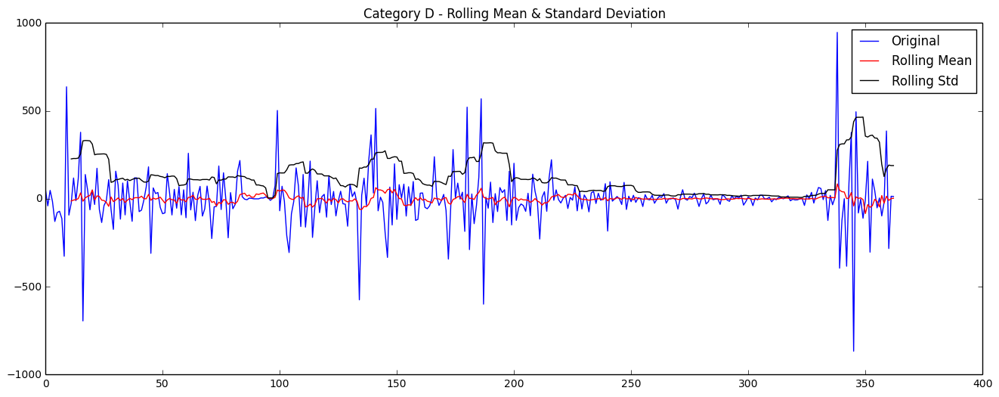

Results of Dickey-Fuller Test:
Test Statistic                -7.649065e+00
p-value                        1.809622e-11
#Lags Used                     1.300000e+01
Number of Observations Used    3.490000e+02
Critical Value (5%)           -2.869857e+00
Critical Value (1%)           -3.449227e+00
Critical Value (10%)          -2.571201e+00
dtype: float64


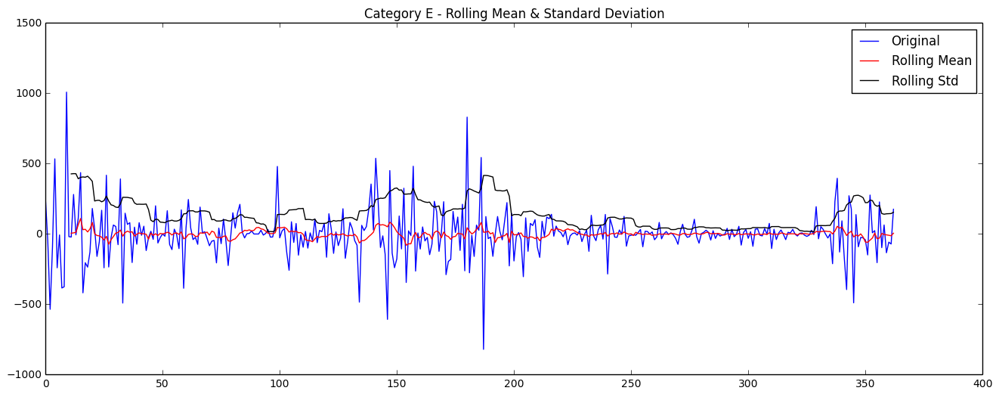

Results of Dickey-Fuller Test:
Test Statistic                -8.440054e+00
p-value                        1.773216e-13
#Lags Used                     1.300000e+01
Number of Observations Used    3.490000e+02
Critical Value (5%)           -2.869857e+00
Critical Value (1%)           -3.449227e+00
Critical Value (10%)          -2.571201e+00
dtype: float64


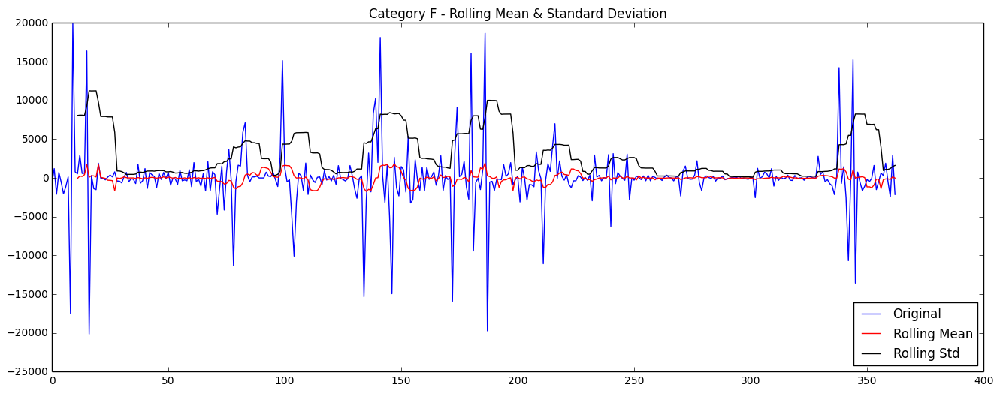

Results of Dickey-Fuller Test:
Test Statistic                -8.148104e+00
p-value                        9.863005e-13
#Lags Used                     1.300000e+01
Number of Observations Used    3.490000e+02
Critical Value (5%)           -2.869857e+00
Critical Value (1%)           -3.449227e+00
Critical Value (10%)          -2.571201e+00
dtype: float64


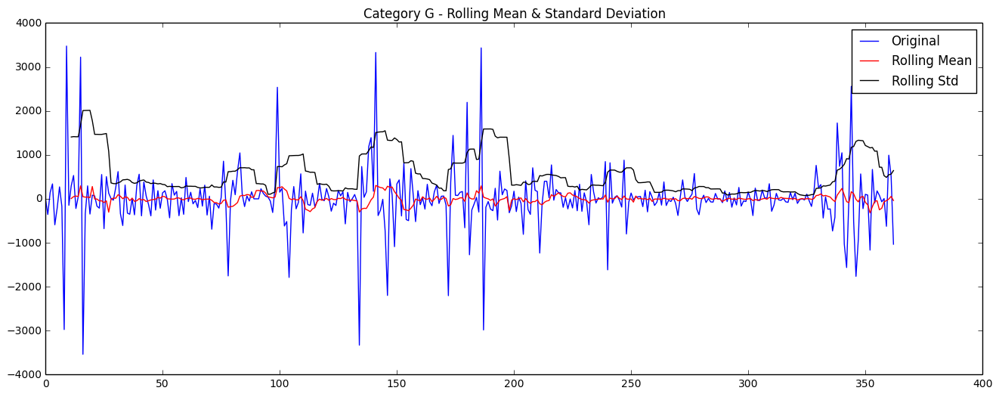

Results of Dickey-Fuller Test:
Test Statistic                -8.224513e+00
p-value                        6.298921e-13
#Lags Used                     1.300000e+01
Number of Observations Used    3.490000e+02
Critical Value (5%)           -2.869857e+00
Critical Value (1%)           -3.449227e+00
Critical Value (10%)          -2.571201e+00
dtype: float64


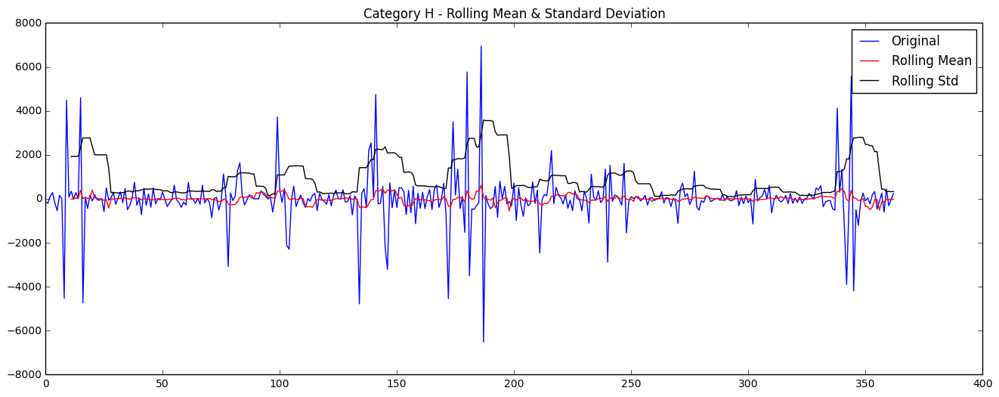

Results of Dickey-Fuller Test:
Test Statistic                -1.055028e+01
p-value                        8.209844e-19
#Lags Used                     8.000000e+00
Number of Observations Used    3.540000e+02
Critical Value (5%)           -2.869739e+00
Critical Value (1%)           -3.448958e+00
Critical Value (10%)          -2.571138e+00
dtype: float64


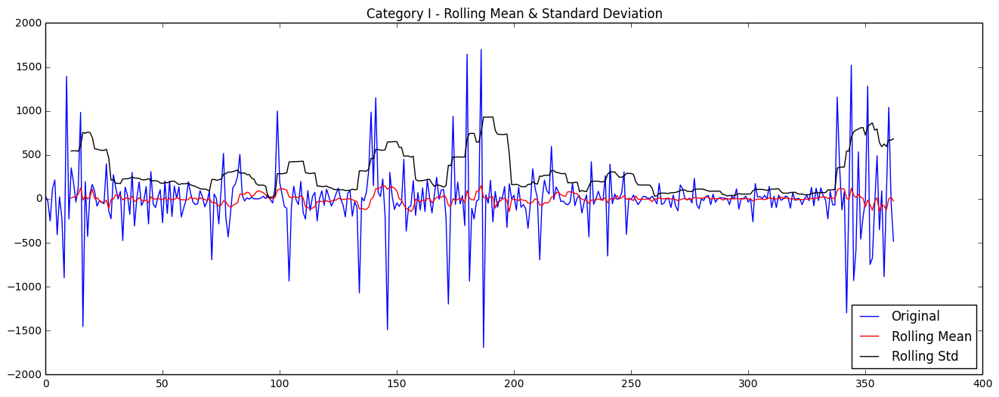

Results of Dickey-Fuller Test:
Test Statistic                -7.727004e+00
p-value                        1.151893e-11
#Lags Used                     1.300000e+01
Number of Observations Used    3.490000e+02
Critical Value (5%)           -2.869857e+00
Critical Value (1%)           -3.449227e+00
Critical Value (10%)          -2.571201e+00
dtype: float64


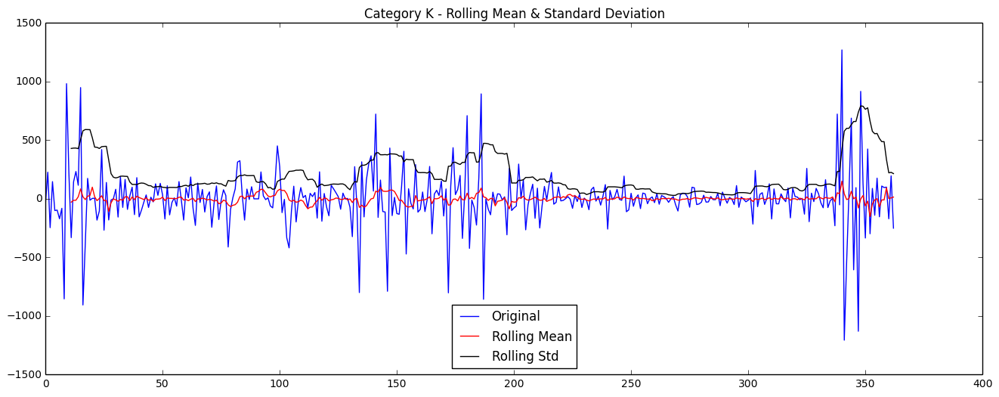

Results of Dickey-Fuller Test:
Test Statistic                -8.049578e+00
p-value                        1.756753e-12
#Lags Used                     1.300000e+01
Number of Observations Used    3.490000e+02
Critical Value (5%)           -2.869857e+00
Critical Value (1%)           -3.449227e+00
Critical Value (10%)          -2.571201e+00
dtype: float64


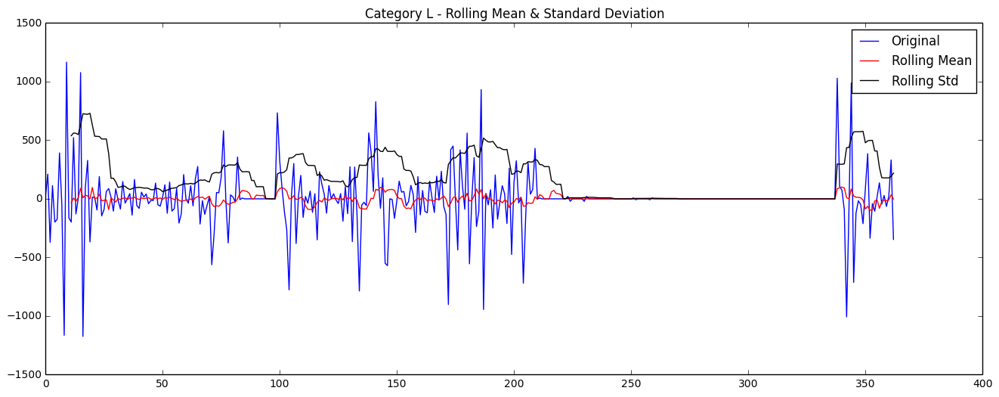

Results of Dickey-Fuller Test:
Test Statistic                -6.535916e+00
p-value                        9.610001e-09
#Lags Used                     1.600000e+01
Number of Observations Used    3.460000e+02
Critical Value (5%)           -2.869930e+00
Critical Value (1%)           -3.449392e+00
Critical Value (10%)          -2.571240e+00
dtype: float64


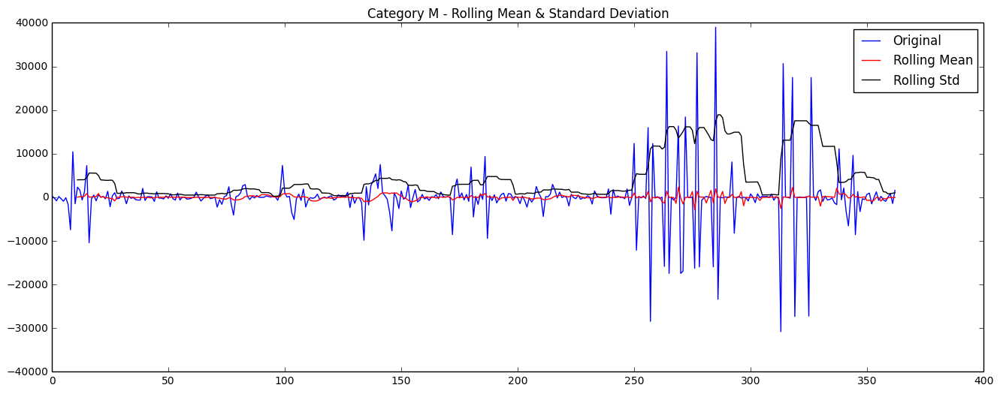

Results of Dickey-Fuller Test:
Test Statistic                -7.663448e+00
p-value                        1.665036e-11
#Lags Used                     1.500000e+01
Number of Observations Used    3.470000e+02
Critical Value (5%)           -2.869906e+00
Critical Value (1%)           -3.449337e+00
Critical Value (10%)          -2.571227e+00
dtype: float64


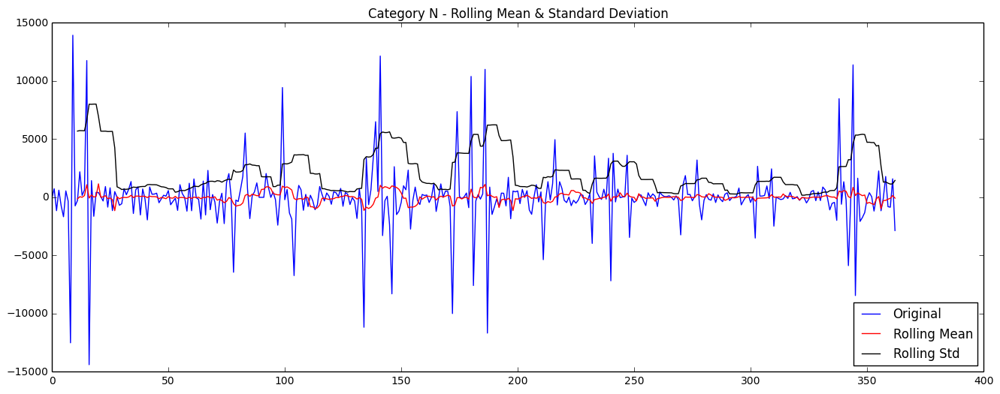

Results of Dickey-Fuller Test:
Test Statistic                -8.159820e+00
p-value                        9.207992e-13
#Lags Used                     1.300000e+01
Number of Observations Used    3.490000e+02
Critical Value (5%)           -2.869857e+00
Critical Value (1%)           -3.449227e+00
Critical Value (10%)          -2.571201e+00
dtype: float64


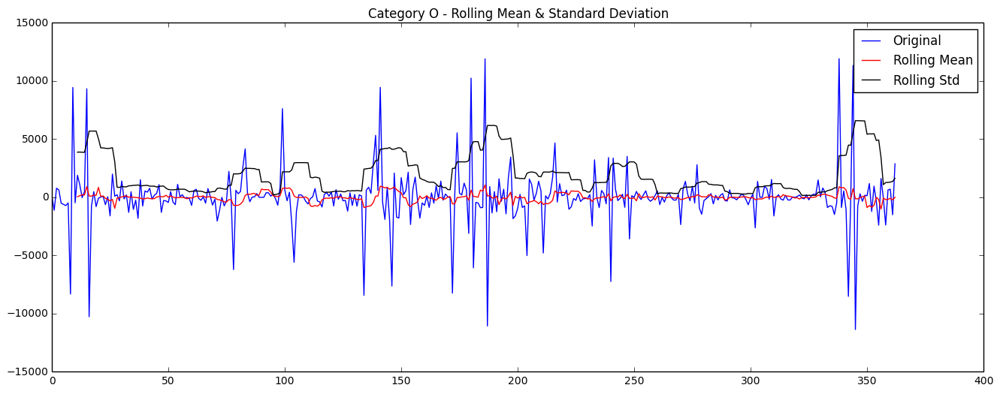

Results of Dickey-Fuller Test:
Test Statistic                -7.774427e+00
p-value                        8.745933e-12
#Lags Used                     1.300000e+01
Number of Observations Used    3.490000e+02
Critical Value (5%)           -2.869857e+00
Critical Value (1%)           -3.449227e+00
Critical Value (10%)          -2.571201e+00
dtype: float64


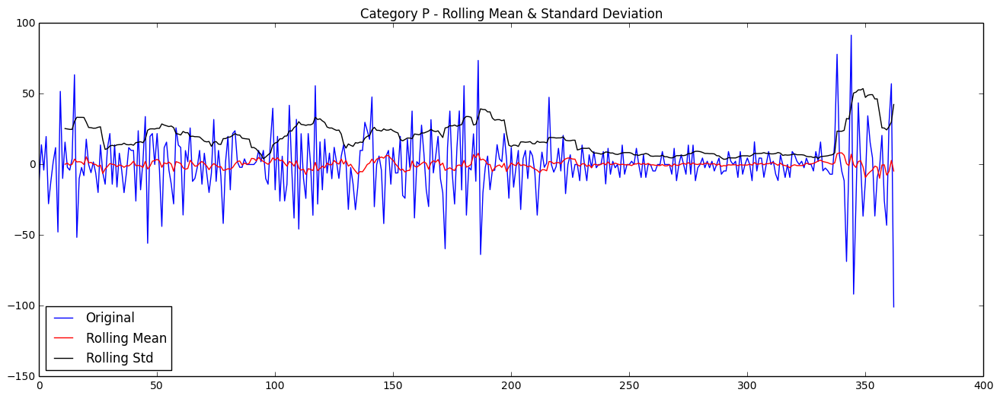

Results of Dickey-Fuller Test:
Test Statistic                -6.258469e+00
p-value                        4.280938e-08
#Lags Used                     1.600000e+01
Number of Observations Used    3.460000e+02
Critical Value (5%)           -2.869930e+00
Critical Value (1%)           -3.449392e+00
Critical Value (10%)          -2.571240e+00
dtype: float64


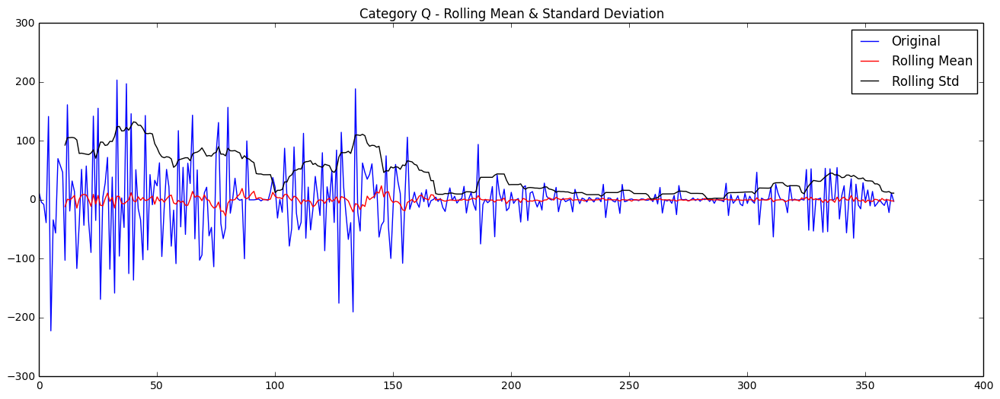

Results of Dickey-Fuller Test:
Test Statistic                -8.102478e+00
p-value                        1.288743e-12
#Lags Used                     1.400000e+01
Number of Observations Used    3.480000e+02
Critical Value (5%)           -2.869881e+00
Critical Value (1%)           -3.449282e+00
Critical Value (10%)          -2.571214e+00
dtype: float64
A : 5.54221475756
B : 5.54409344225
C : 5.95085853991
D : 5.39375939976
E : 6.4163526123
F : 5.89613196917
G : 5.86337434758
H : 8.3771713006
I : 5.57149249843
K : 5.91688572389
L : 4.37093970882
M : 4.94641509247
N : 5.750982179
O : 5.28048764518
P : 3.85634297748
Q : 5.87214688373
Mean test stats improvement (higher is better):  5.65935306738


In [102]:
# Differencing to deal with seasonality...
# Log seasonal

splitted_data_season_diff = map(lambda x: x - x.shift(7), splitted_data_diff)
_ = map(lambda x: x.dropna(inplace=True), splitted_data_season_diff)
_ = map(test_stationarity, splitted_data_season_diff, temp_list)
stat_diff(splitted_data_season_diff, temp_list)

# 3.7) Seasonal(Diff(Log()))

/Library/Python/2.7/site-packages/ipykernel/__main__.py:7: FutureWarning: pd.rolling_mean is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).mean()
/Library/Python/2.7/site-packages/ipykernel/__main__.py:8: FutureWarning: pd.rolling_std is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).std()


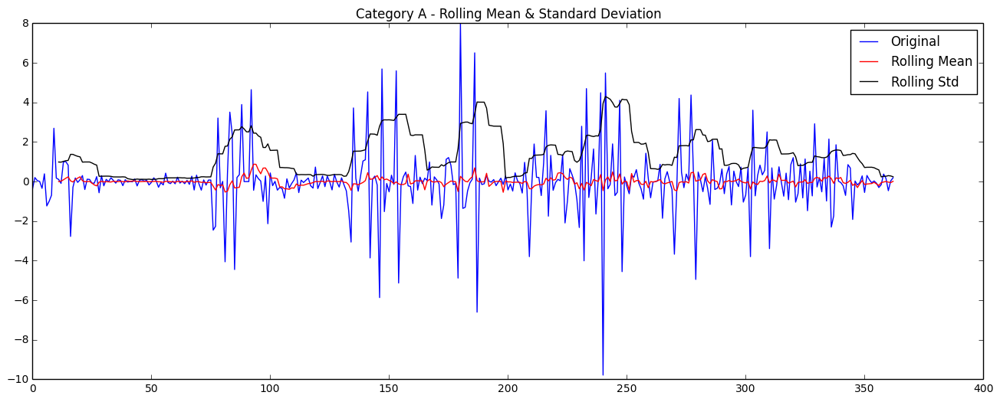

Results of Dickey-Fuller Test:
Test Statistic                -7.472544e+00
p-value                        5.010600e-11
#Lags Used                     1.500000e+01
Number of Observations Used    3.470000e+02
Critical Value (5%)           -2.869906e+00
Critical Value (1%)           -3.449337e+00
Critical Value (10%)          -2.571227e+00
dtype: float64


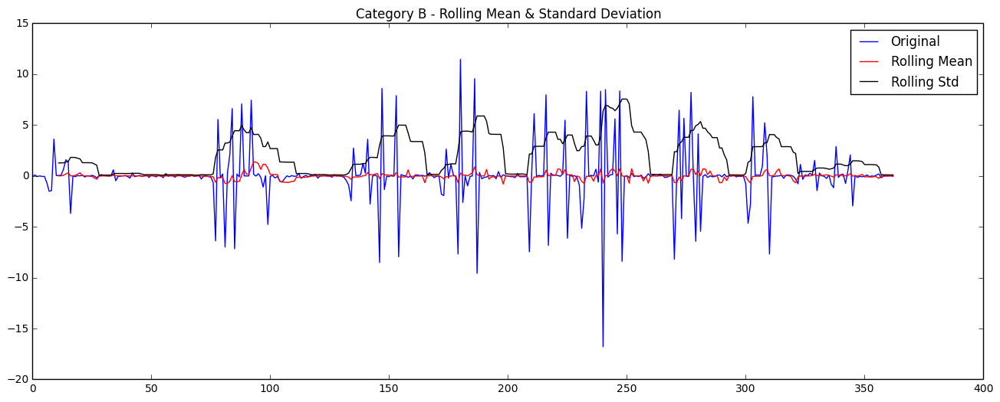

Results of Dickey-Fuller Test:
Test Statistic                -7.891232e+00
p-value                        4.430872e-12
#Lags Used                     1.600000e+01
Number of Observations Used    3.460000e+02
Critical Value (5%)           -2.869930e+00
Critical Value (1%)           -3.449392e+00
Critical Value (10%)          -2.571240e+00
dtype: float64


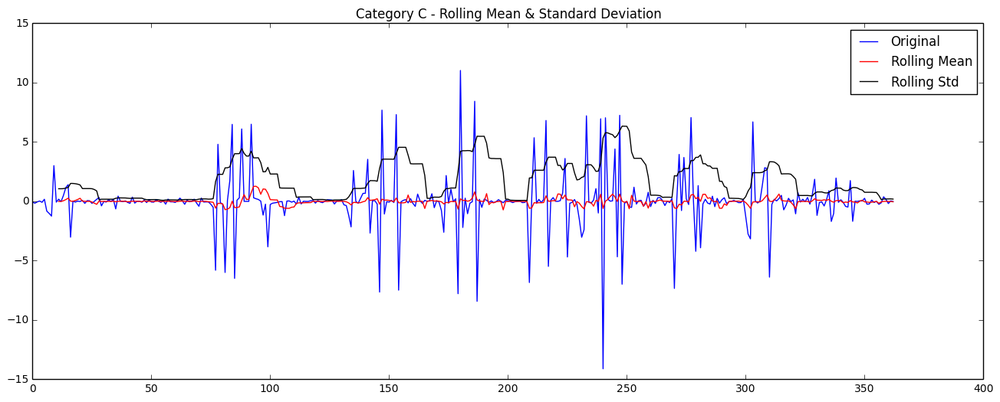

Results of Dickey-Fuller Test:
Test Statistic                -7.973763e+00
p-value                        2.736978e-12
#Lags Used                     1.600000e+01
Number of Observations Used    3.460000e+02
Critical Value (5%)           -2.869930e+00
Critical Value (1%)           -3.449392e+00
Critical Value (10%)          -2.571240e+00
dtype: float64


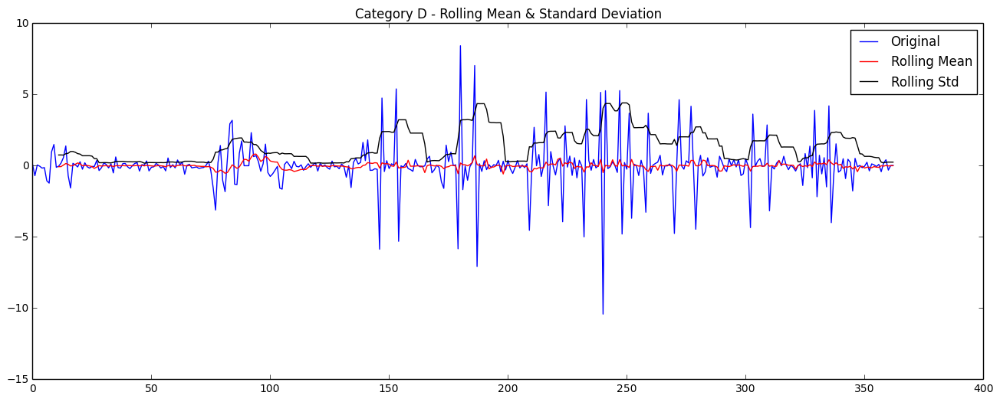

Results of Dickey-Fuller Test:
Test Statistic                -6.638846e+00
p-value                        5.474688e-09
#Lags Used                     1.500000e+01
Number of Observations Used    3.470000e+02
Critical Value (5%)           -2.869906e+00
Critical Value (1%)           -3.449337e+00
Critical Value (10%)          -2.571227e+00
dtype: float64


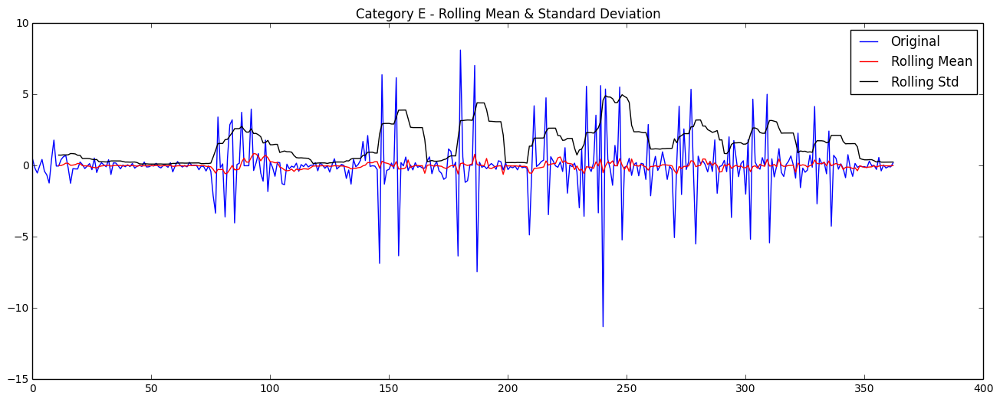

Results of Dickey-Fuller Test:
Test Statistic                -7.029596e+00
p-value                        6.234931e-10
#Lags Used                     1.600000e+01
Number of Observations Used    3.460000e+02
Critical Value (5%)           -2.869930e+00
Critical Value (1%)           -3.449392e+00
Critical Value (10%)          -2.571240e+00
dtype: float64


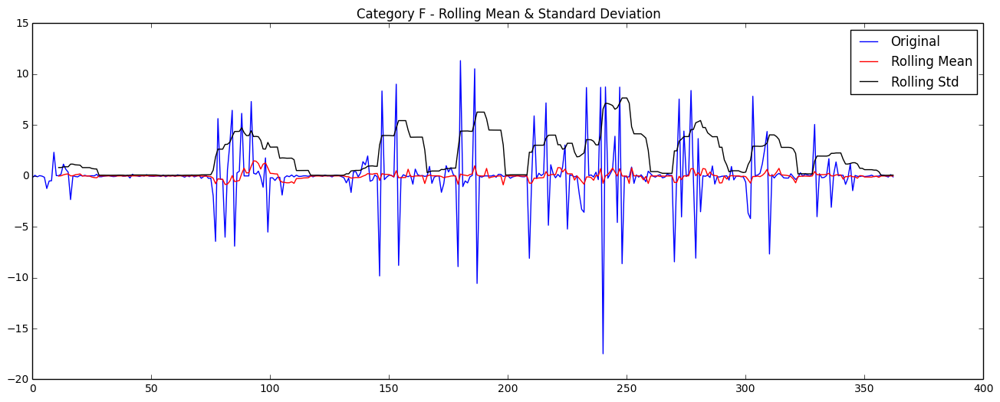

Results of Dickey-Fuller Test:
Test Statistic                -7.752541e+00
p-value                        9.931789e-12
#Lags Used                     1.500000e+01
Number of Observations Used    3.470000e+02
Critical Value (5%)           -2.869906e+00
Critical Value (1%)           -3.449337e+00
Critical Value (10%)          -2.571227e+00
dtype: float64


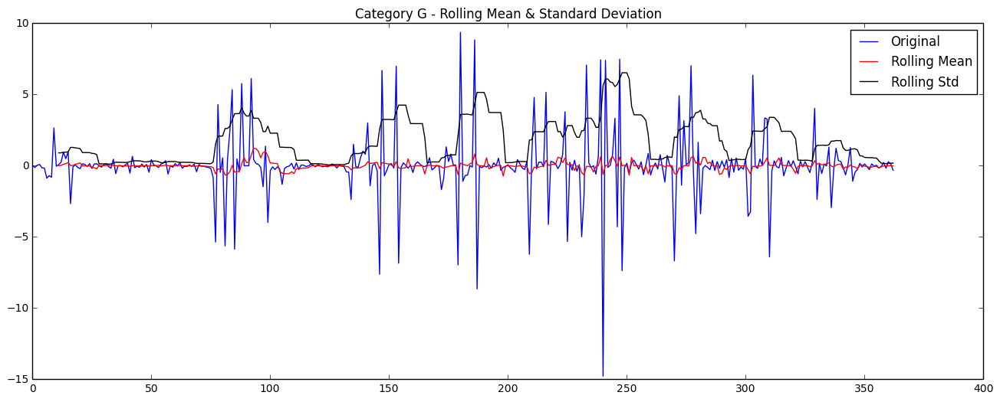

Results of Dickey-Fuller Test:
Test Statistic                -7.701478e+00
p-value                        1.335724e-11
#Lags Used                     1.500000e+01
Number of Observations Used    3.470000e+02
Critical Value (5%)           -2.869906e+00
Critical Value (1%)           -3.449337e+00
Critical Value (10%)          -2.571227e+00
dtype: float64


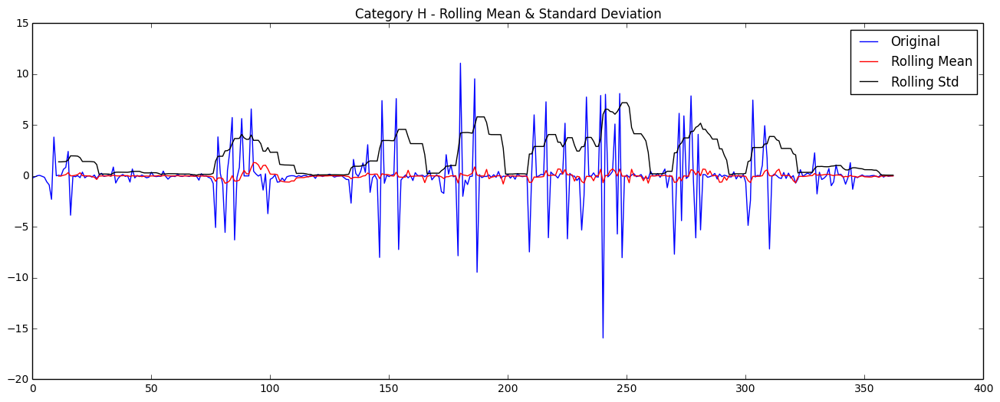

Results of Dickey-Fuller Test:
Test Statistic                -7.915306e+00
p-value                        3.850397e-12
#Lags Used                     1.600000e+01
Number of Observations Used    3.460000e+02
Critical Value (5%)           -2.869930e+00
Critical Value (1%)           -3.449392e+00
Critical Value (10%)          -2.571240e+00
dtype: float64


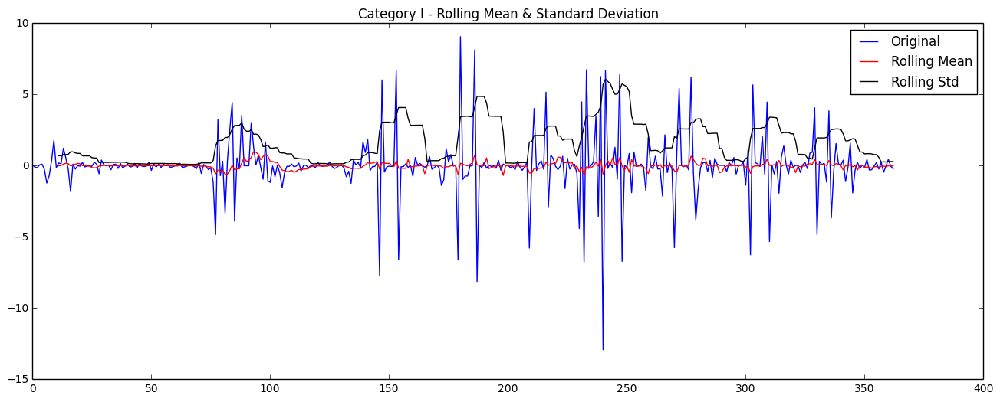

Results of Dickey-Fuller Test:
Test Statistic                -7.144448e+00
p-value                        3.260171e-10
#Lags Used                     1.500000e+01
Number of Observations Used    3.470000e+02
Critical Value (5%)           -2.869906e+00
Critical Value (1%)           -3.449337e+00
Critical Value (10%)          -2.571227e+00
dtype: float64


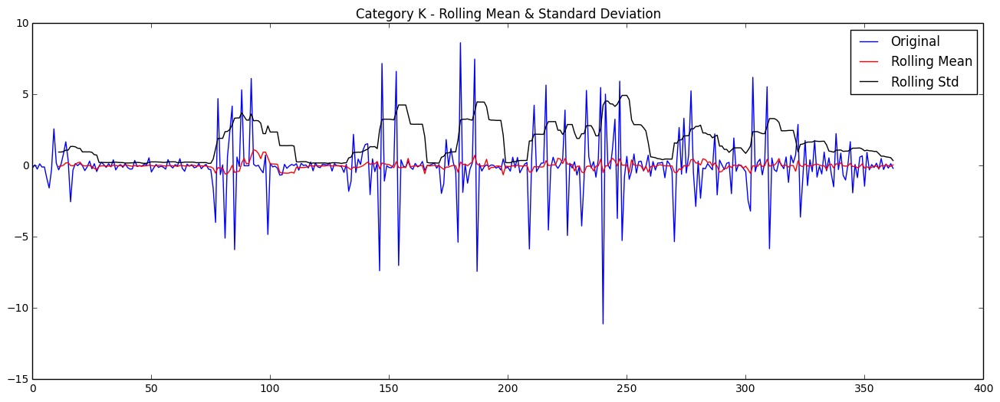

Results of Dickey-Fuller Test:
Test Statistic                -8.018293e+00
p-value                        2.109648e-12
#Lags Used                     1.600000e+01
Number of Observations Used    3.460000e+02
Critical Value (5%)           -2.869930e+00
Critical Value (1%)           -3.449392e+00
Critical Value (10%)          -2.571240e+00
dtype: float64


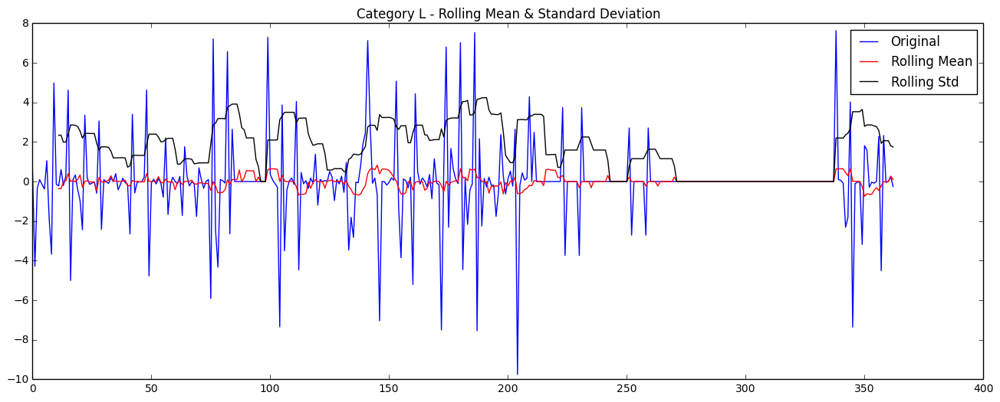

Results of Dickey-Fuller Test:
Test Statistic                -5.981186e+00
p-value                        1.836893e-07
#Lags Used                     1.600000e+01
Number of Observations Used    3.460000e+02
Critical Value (5%)           -2.869930e+00
Critical Value (1%)           -3.449392e+00
Critical Value (10%)          -2.571240e+00
dtype: float64


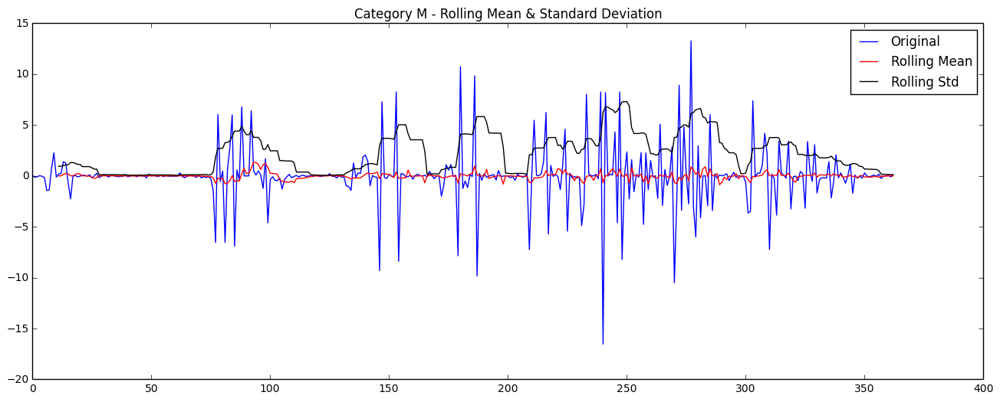

Results of Dickey-Fuller Test:
Test Statistic                -7.715774e+00
p-value                        1.229444e-11
#Lags Used                     1.600000e+01
Number of Observations Used    3.460000e+02
Critical Value (5%)           -2.869930e+00
Critical Value (1%)           -3.449392e+00
Critical Value (10%)          -2.571240e+00
dtype: float64


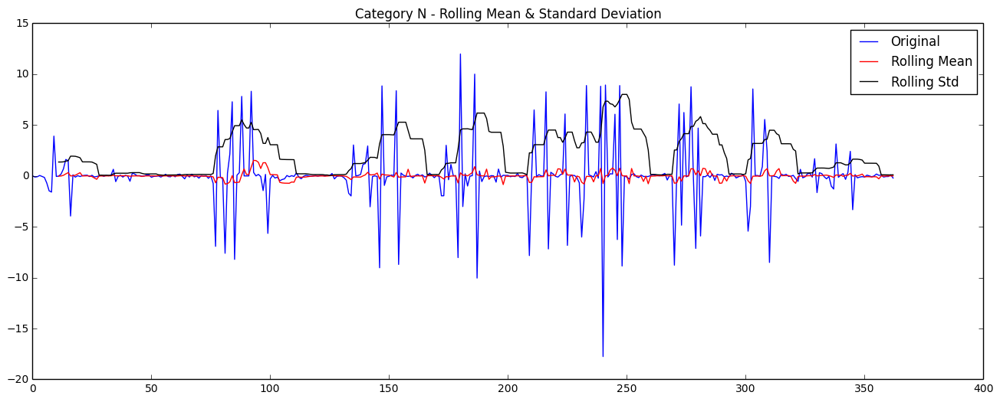

Results of Dickey-Fuller Test:
Test Statistic                -8.005726e+00
p-value                        2.270544e-12
#Lags Used                     1.600000e+01
Number of Observations Used    3.460000e+02
Critical Value (5%)           -2.869930e+00
Critical Value (1%)           -3.449392e+00
Critical Value (10%)          -2.571240e+00
dtype: float64


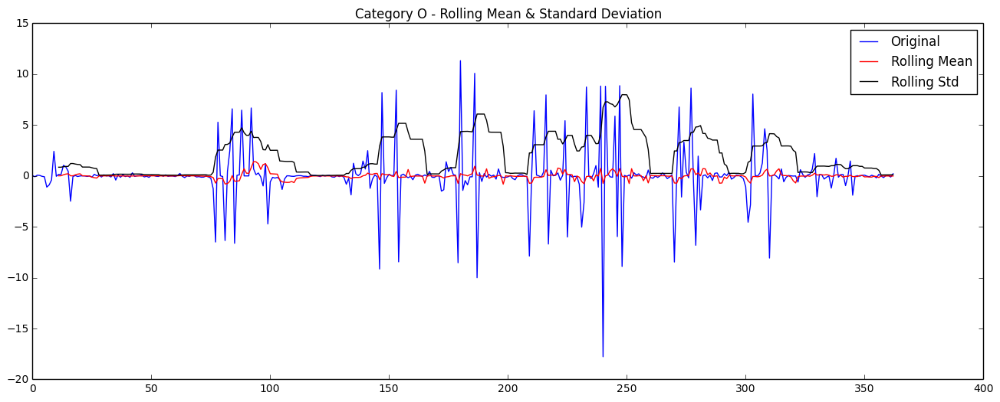

Results of Dickey-Fuller Test:
Test Statistic                -7.727606e+00
p-value                        1.147878e-11
#Lags Used                     1.600000e+01
Number of Observations Used    3.460000e+02
Critical Value (5%)           -2.869930e+00
Critical Value (1%)           -3.449392e+00
Critical Value (10%)          -2.571240e+00
dtype: float64


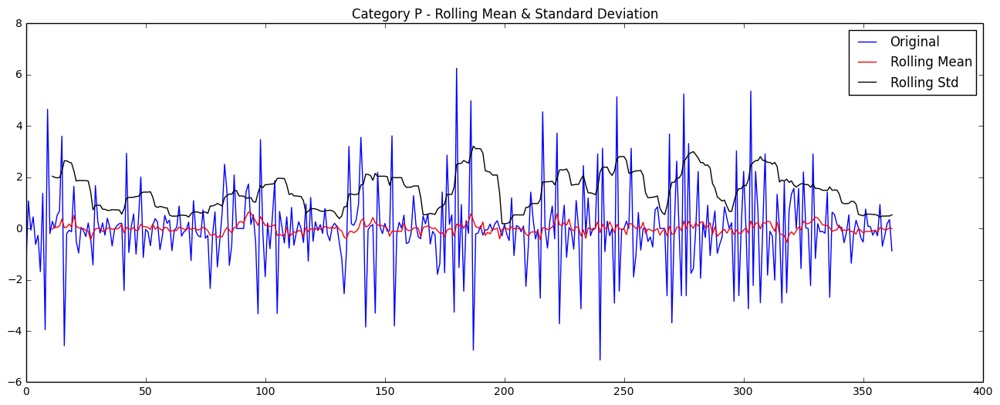

Results of Dickey-Fuller Test:
Test Statistic                -8.044687e+00
p-value                        1.807773e-12
#Lags Used                     1.500000e+01
Number of Observations Used    3.470000e+02
Critical Value (5%)           -2.869906e+00
Critical Value (1%)           -3.449337e+00
Critical Value (10%)          -2.571227e+00
dtype: float64


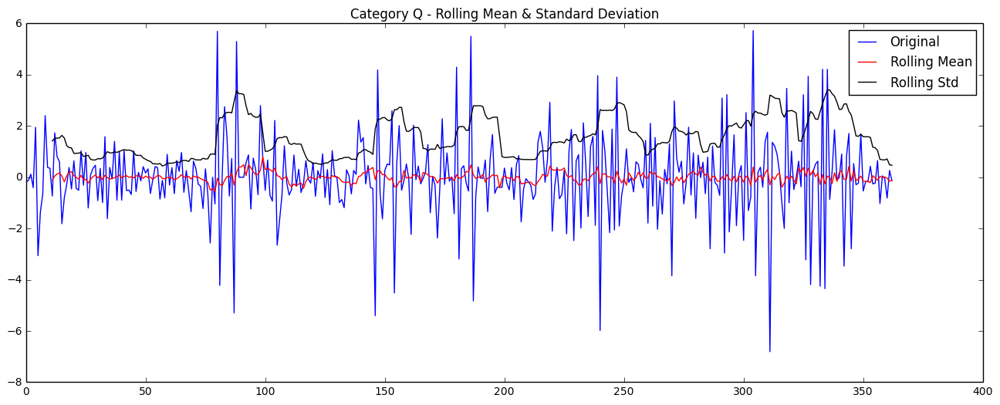

Results of Dickey-Fuller Test:
Test Statistic                -7.660434e+00
p-value                        1.694349e-11
#Lags Used                     1.400000e+01
Number of Observations Used    3.480000e+02
Critical Value (5%)           -2.869881e+00
Critical Value (1%)           -3.449282e+00
Critical Value (10%)          -2.571214e+00
dtype: float64
A : 5.17708125197
B : 5.46260365331
C : 5.5070904223
D : 4.3835400634
E : 5.00589413546
F : 5.50056891008
G : 5.3403394309
H : 5.74219445942
I : 4.98893670388
K : 5.8856006115
L : 3.81620994251
M : 4.9987412567
N : 5.59688799954
O : 5.23366678623
P : 5.64256141845
Q : 5.43010334474
Mean test stats improvement (higher is better):  5.2320012744


In [103]:
# Seasonal(Diff(Log()))

splitted_data_season_diff_log = map(lambda x: x - x.shift(7), splitted_data_diff_log)
_ = map(lambda x: x.dropna(inplace=True), splitted_data_season_diff_log)
_ = map(test_stationarity, splitted_data_season_diff_log, temp_list)
stat_diff(splitted_data_season_diff_log, temp_list)

##### Inversed(obs): 1.11430824096
##### Detrend(obs): 3.66819270499
##### Detrend(Inversed()): 3.62243350372
##### Seasonal(obs): 2.76576108713
##### Seasonal(Inversed()): 3.25678564215
##### Seasonal(Diff()): 5.65935306738
##### Seasonal(Diff(Inversed())): 5.2320012744

### All the test statistics look really good.
### Next step is to visualize the ACF/PACF plots to determine we will use MA, AR, or ARIMA model.

# Step 4) ACF/PACF Plots for
## - Seasonal(obs)
## - Seasonal(Inversed())
## - Seasonal(Diff())
## - Seasonal(Diff(Inversed()))

In [104]:
def acf_pacf_plot(timeseries, title, item, lags=30):
    fig = plt.figure(figsize=(12,8))
    ax1 = fig.add_subplot(211)
    fig = sm.graphics.tsa.plot_acf(timeseries, lags=lags, ax=ax1)
    ax2 = fig.add_subplot(212)
    fig = sm.graphics.tsa.plot_pacf(timeseries, lags=lags, ax=ax2)
    fig.suptitle('Category {} - {} ACF/PACF Plot'.format(item, title), fontsize=20)

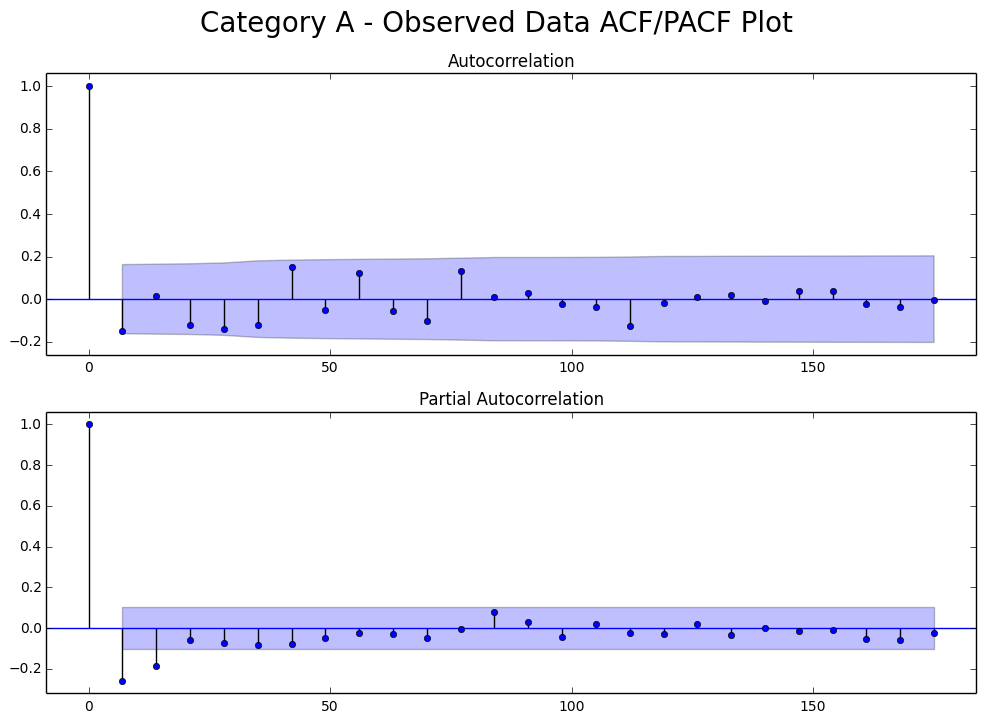

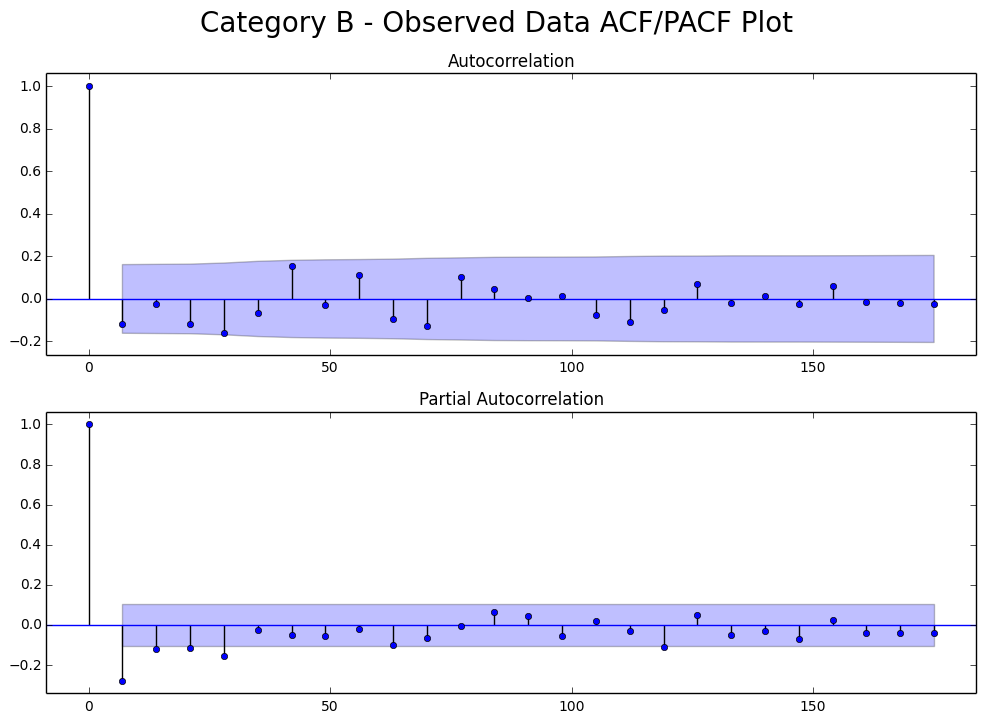

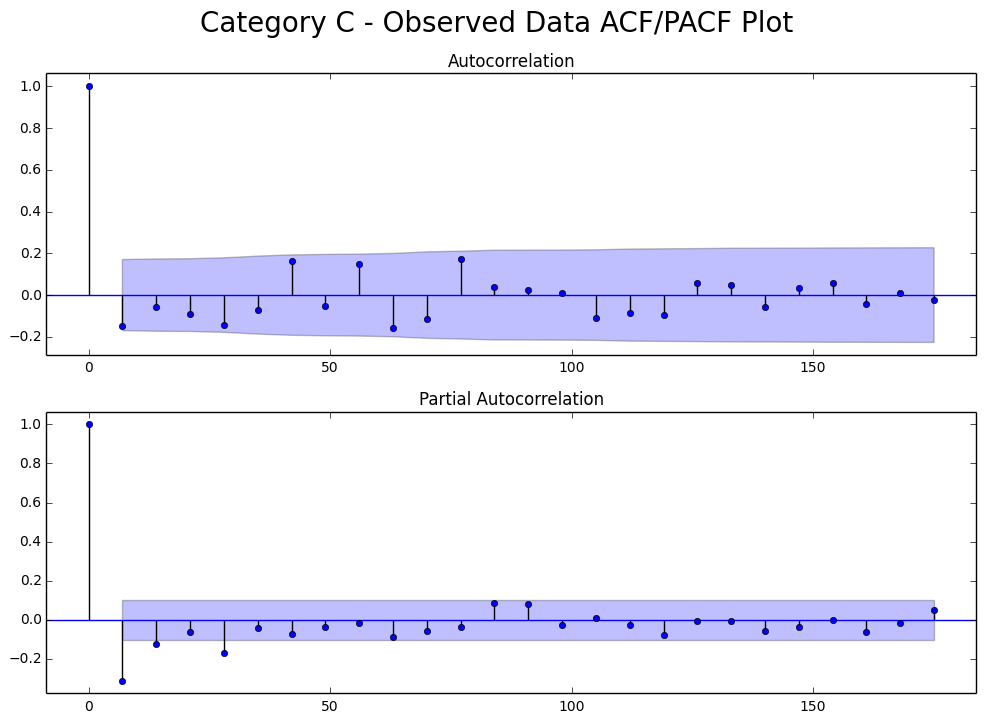

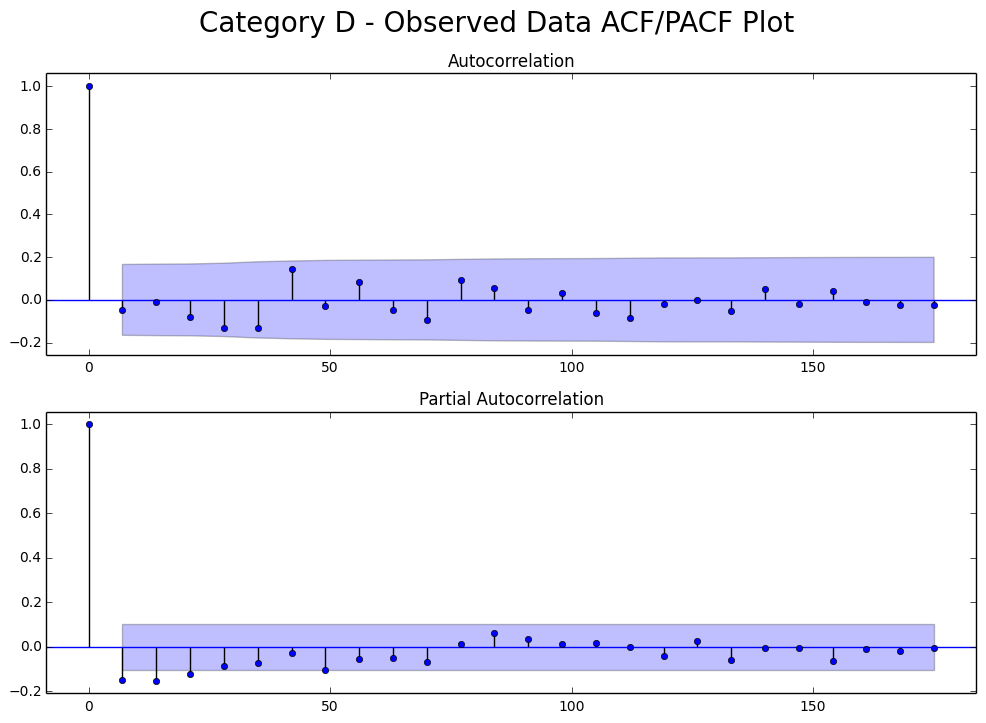

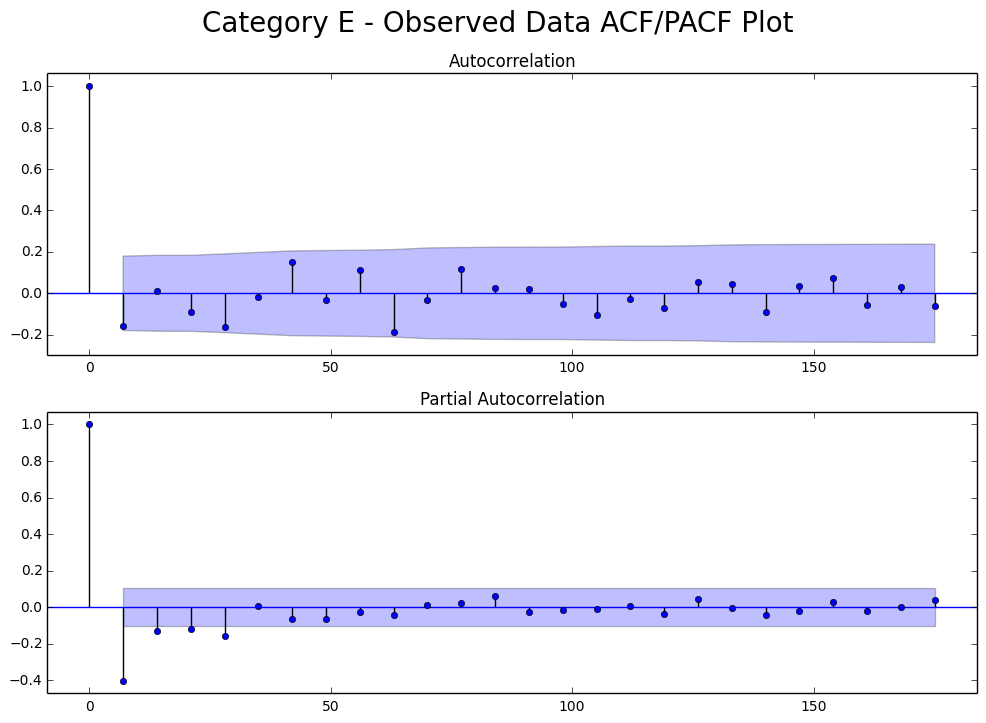

...

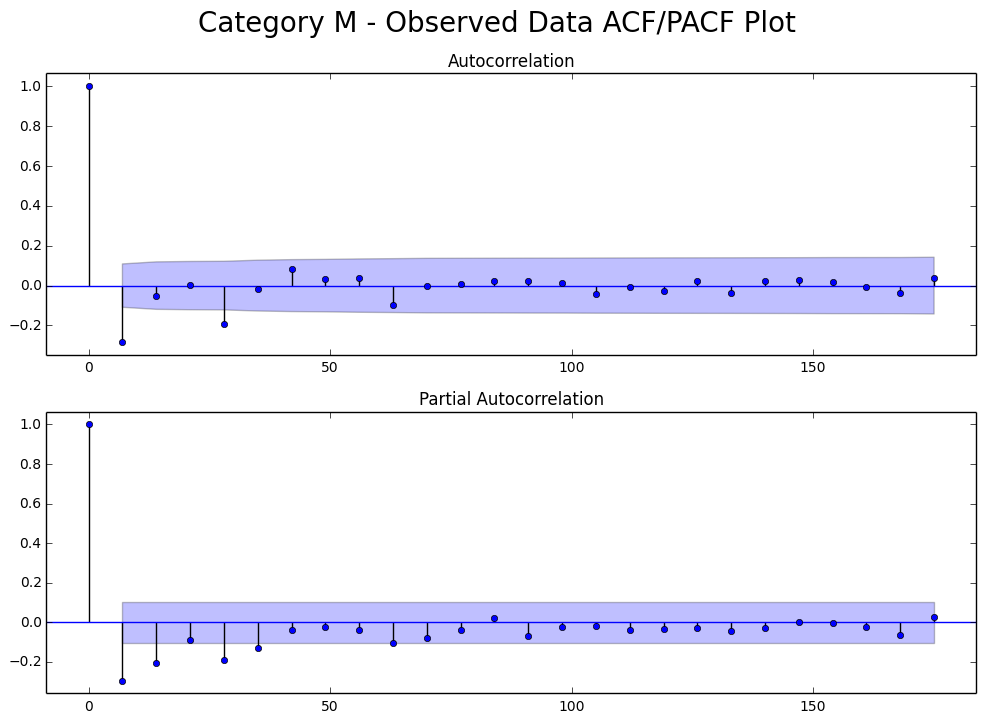

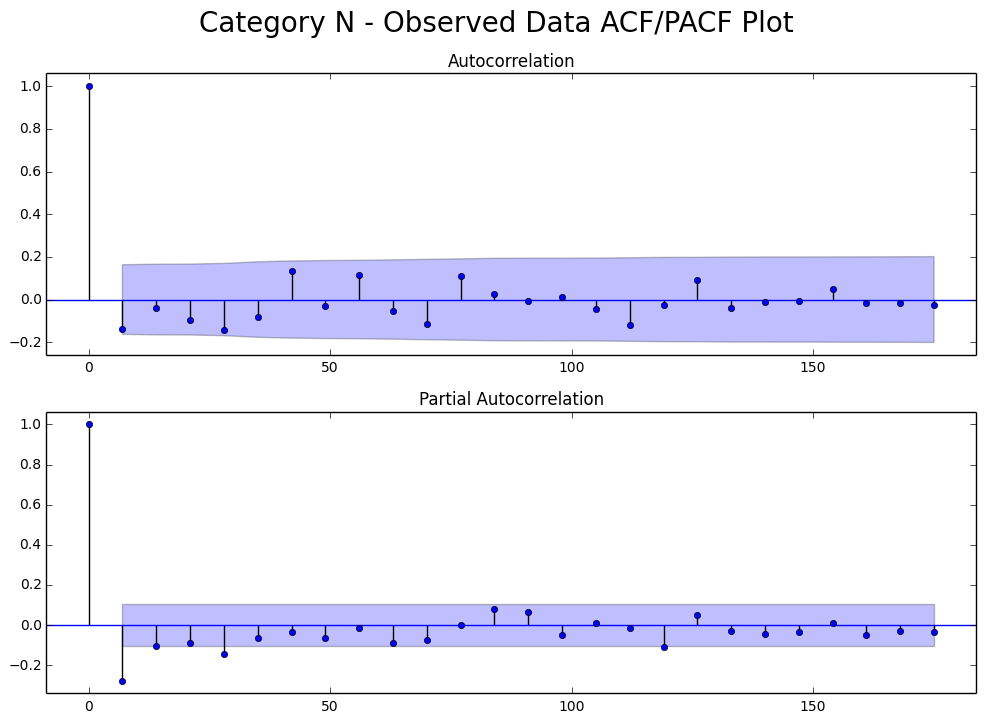

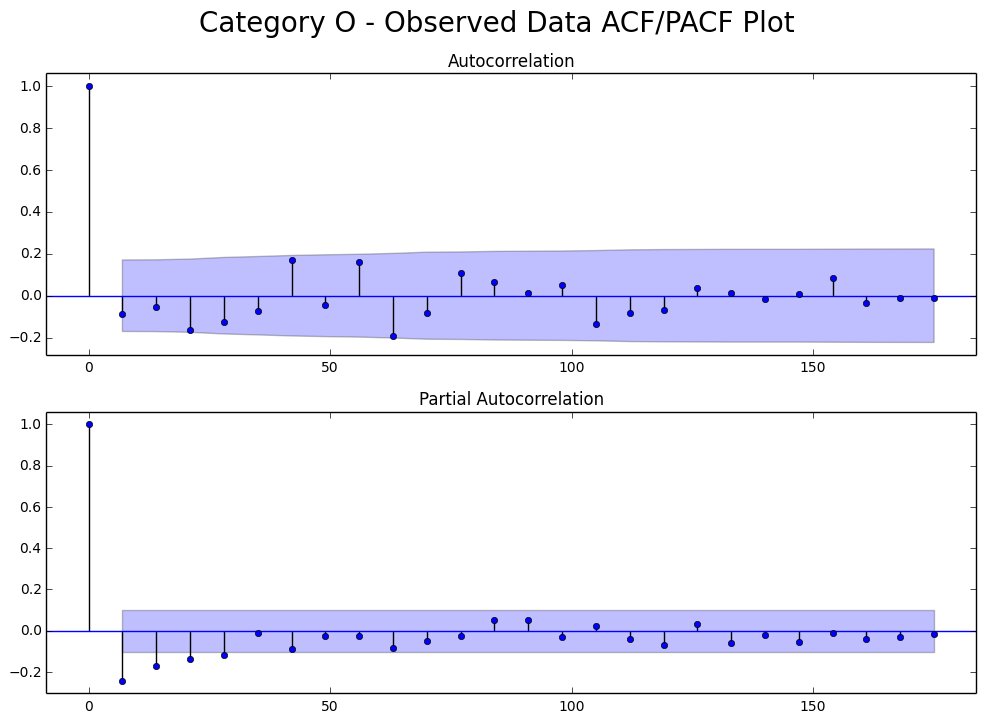

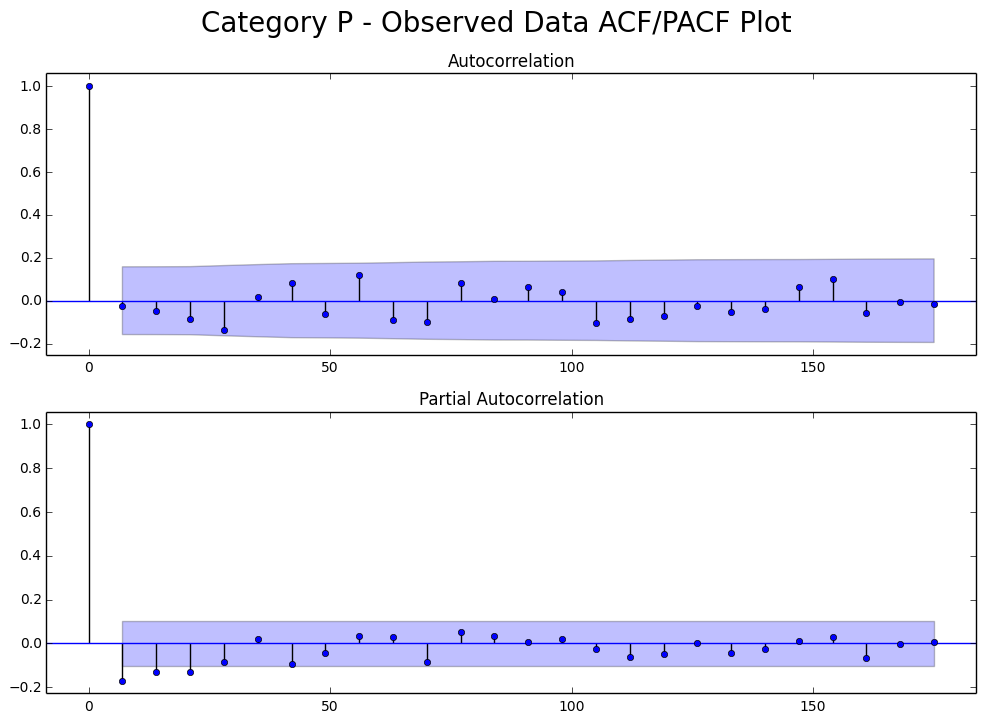

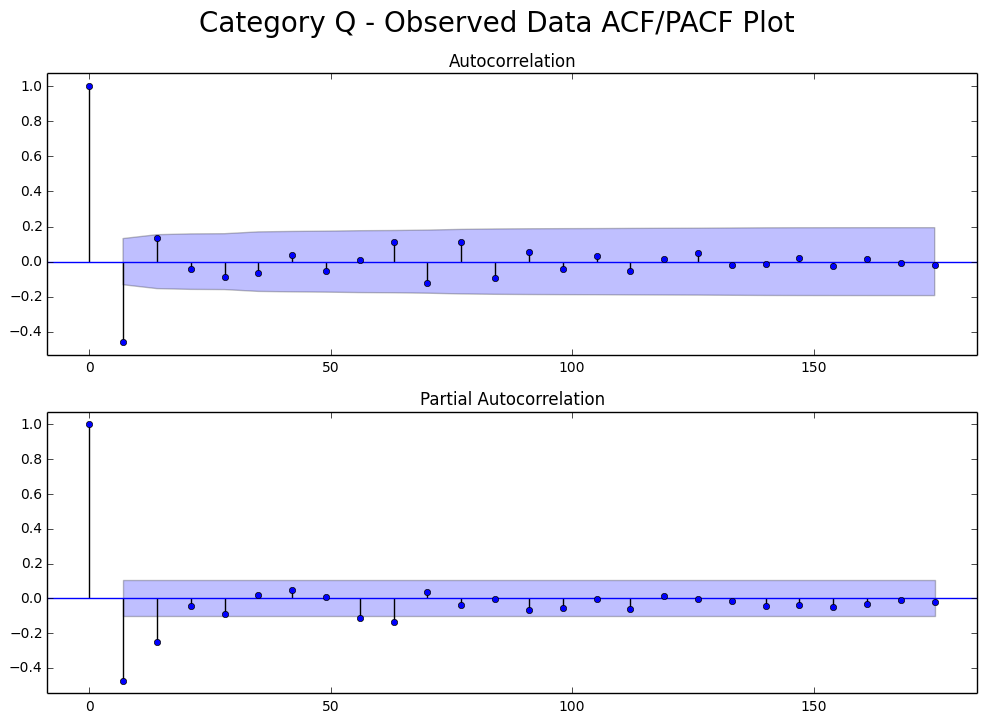

In [107]:
# Seasonal observed data ACF/PACF plot.

_ = map(acf_pacf_plot, splitted_data_season, ['Seasonal Observed']*len(temp_list), temp_list, [range(0, 182, 7)]*len(temp_list))

## We observe the following:
### - Mostly both tails off.

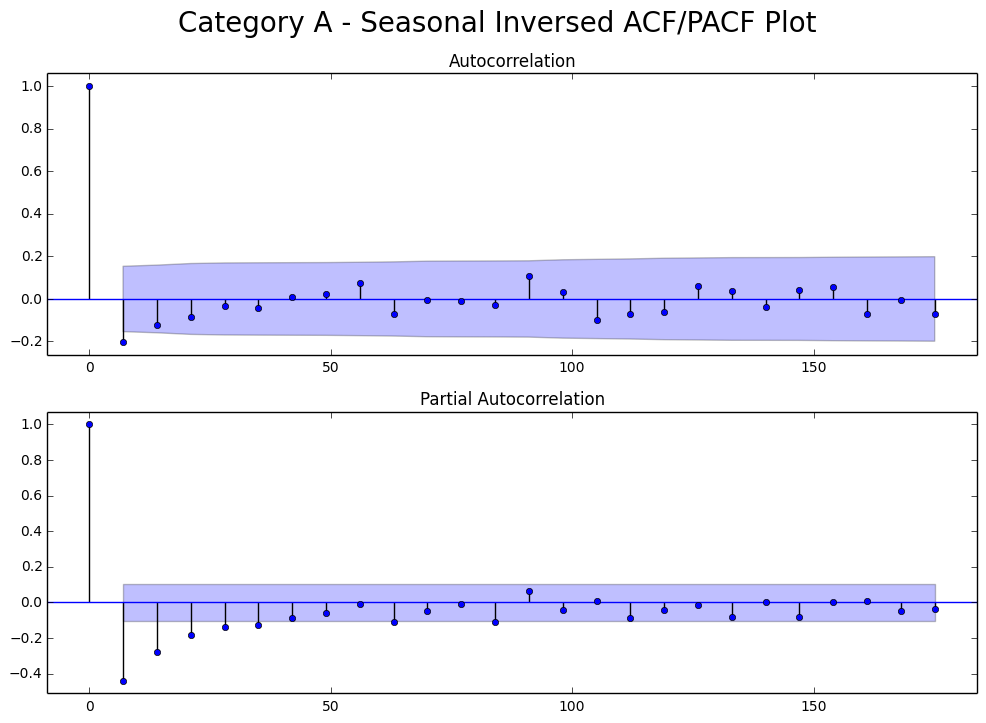

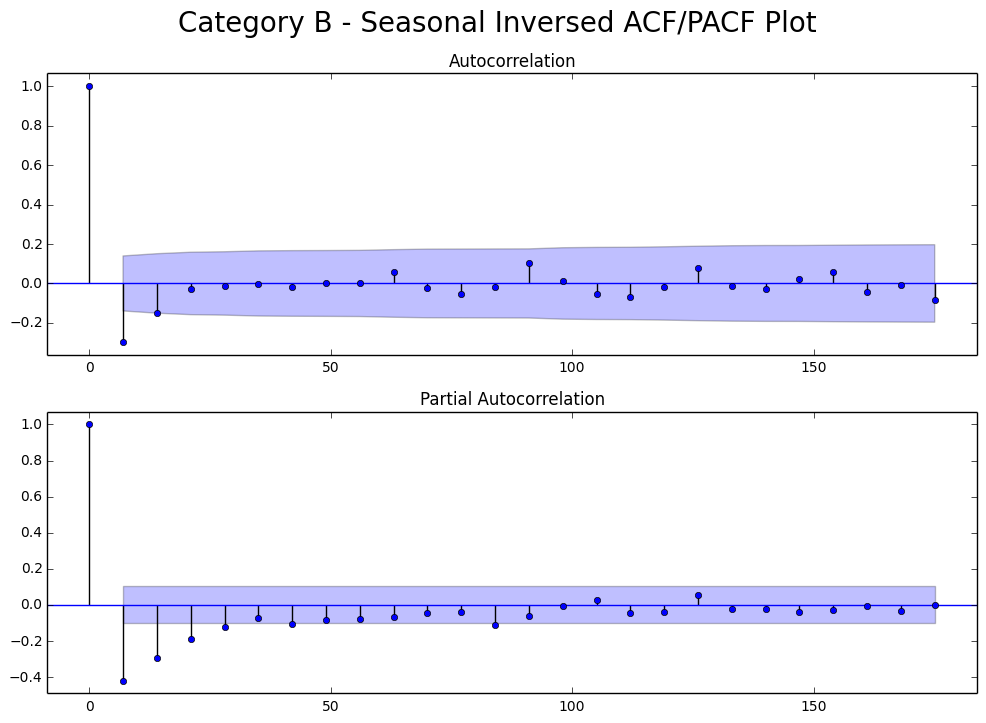

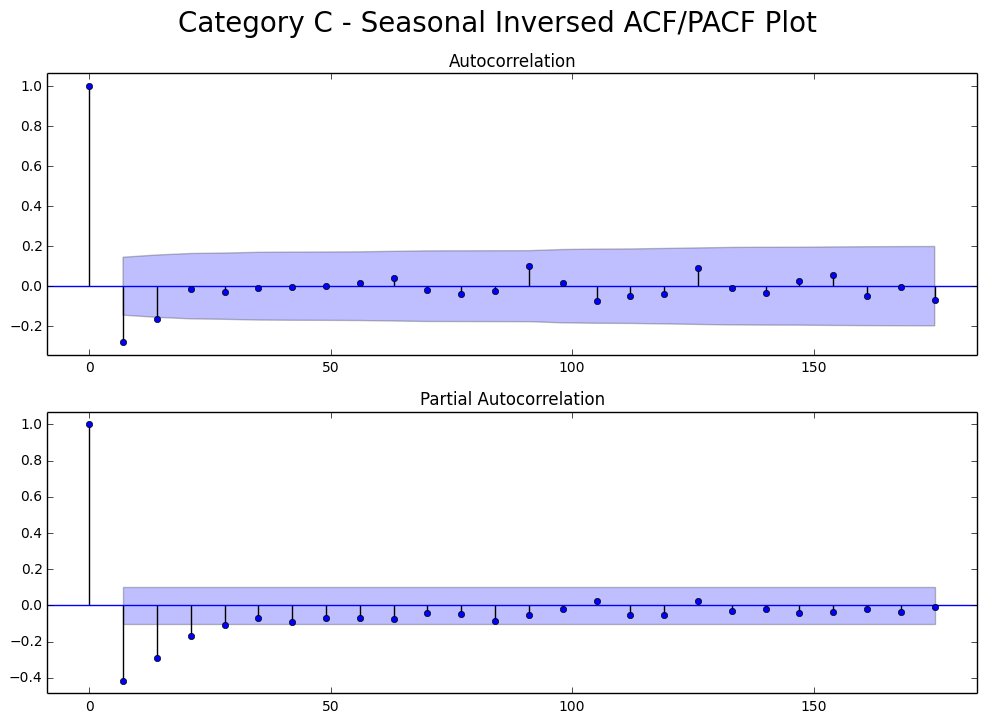

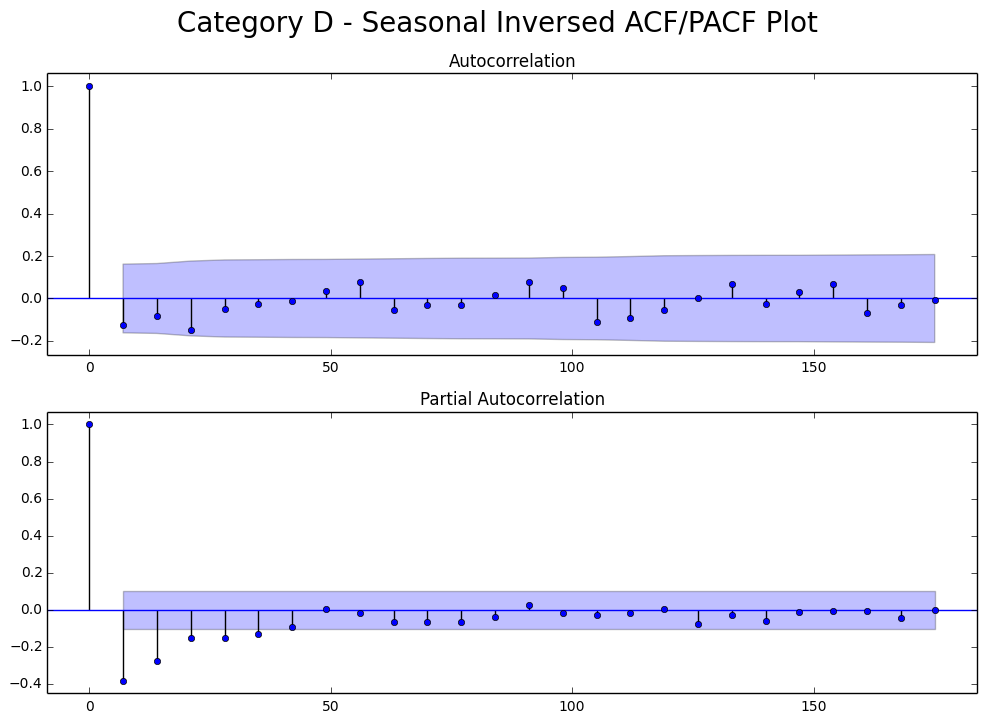

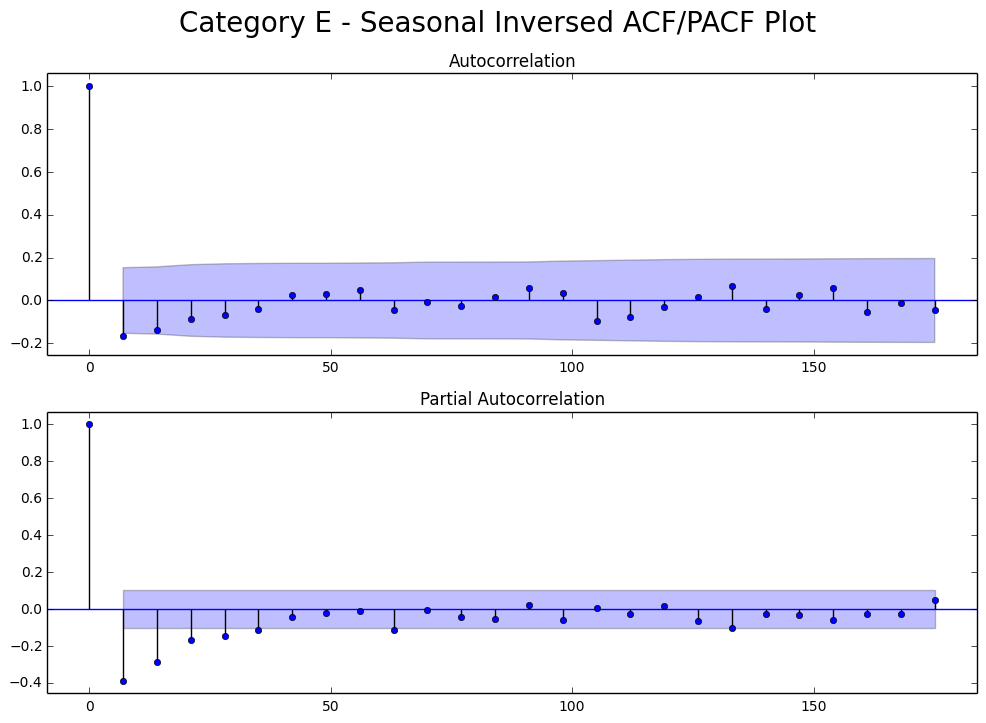

...

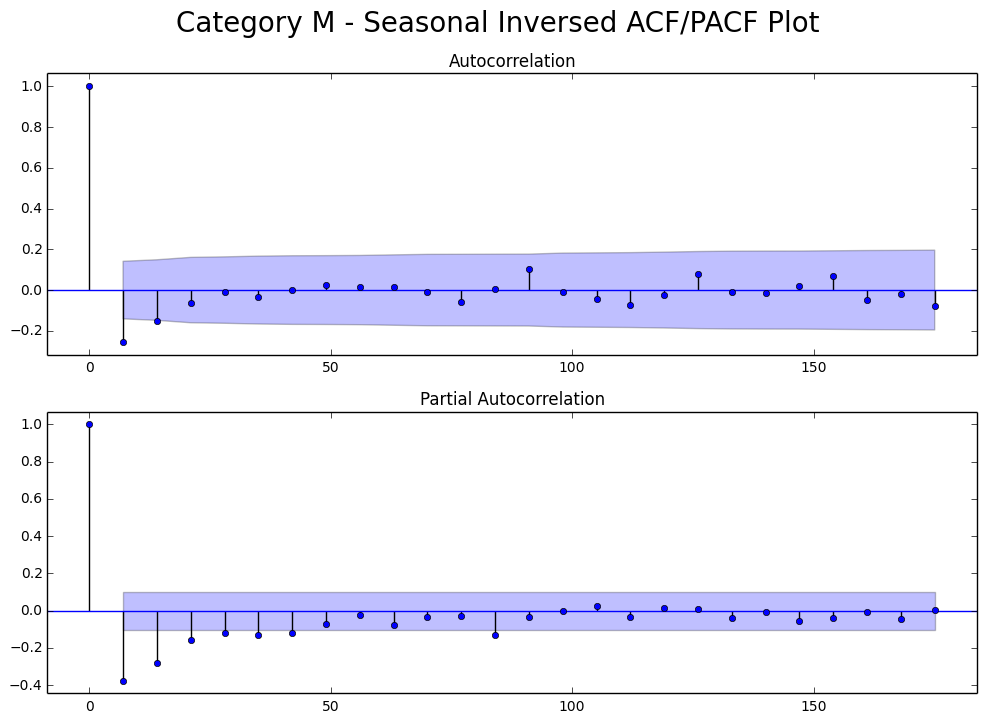

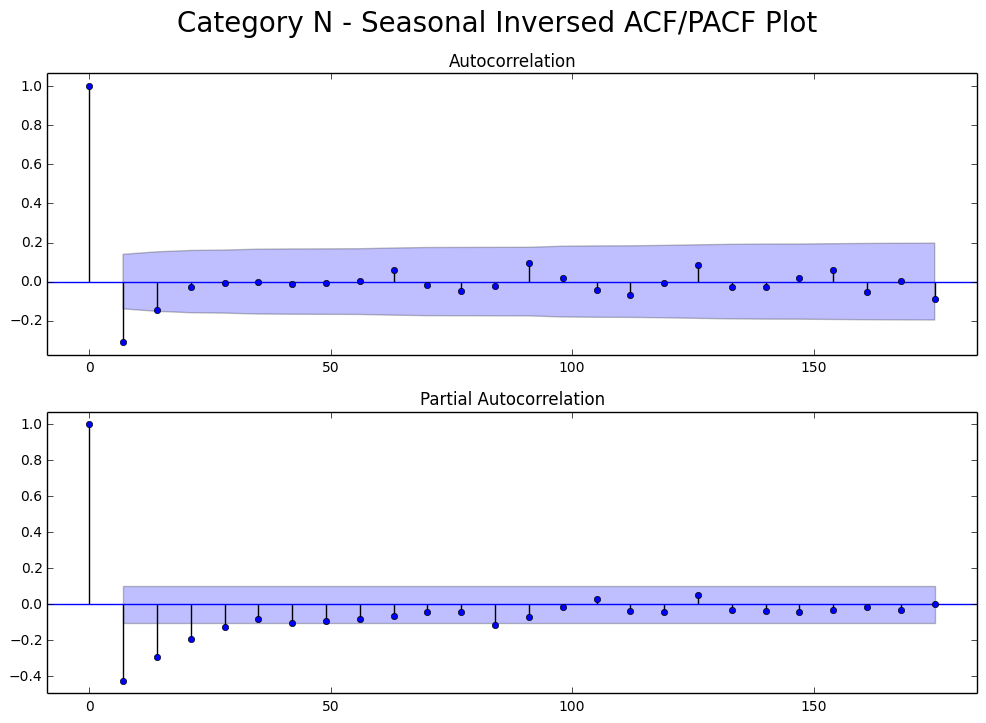

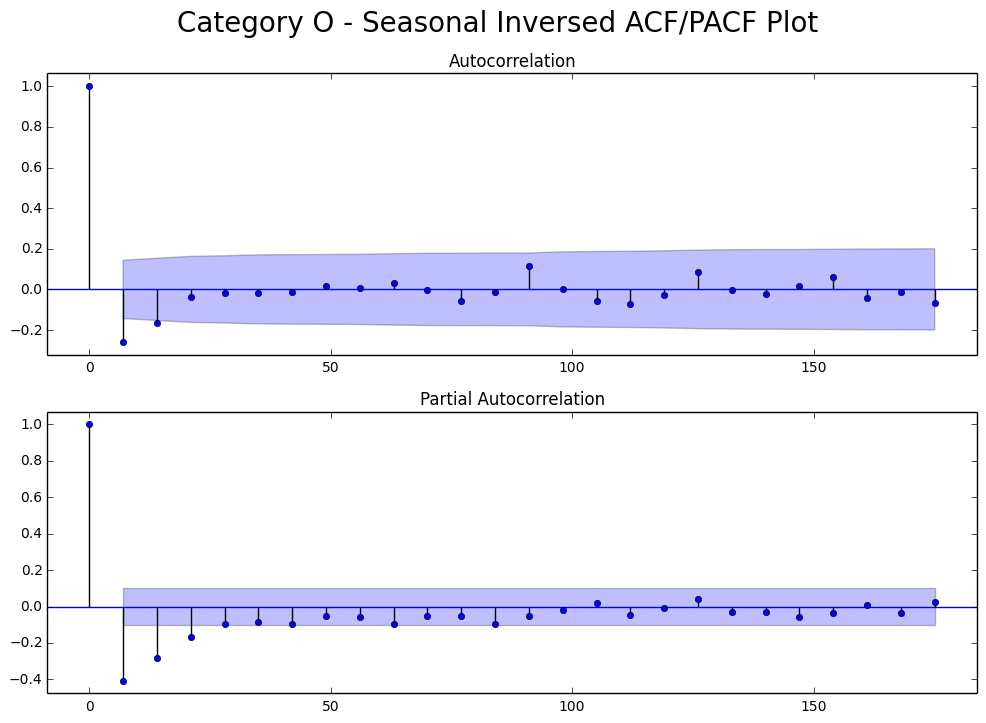

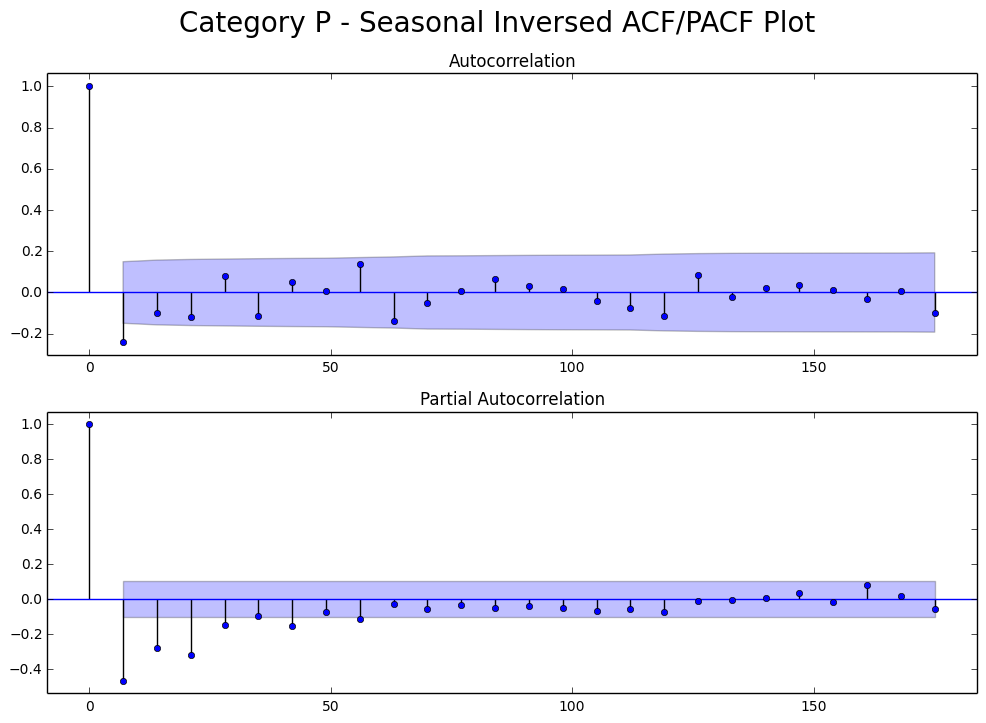

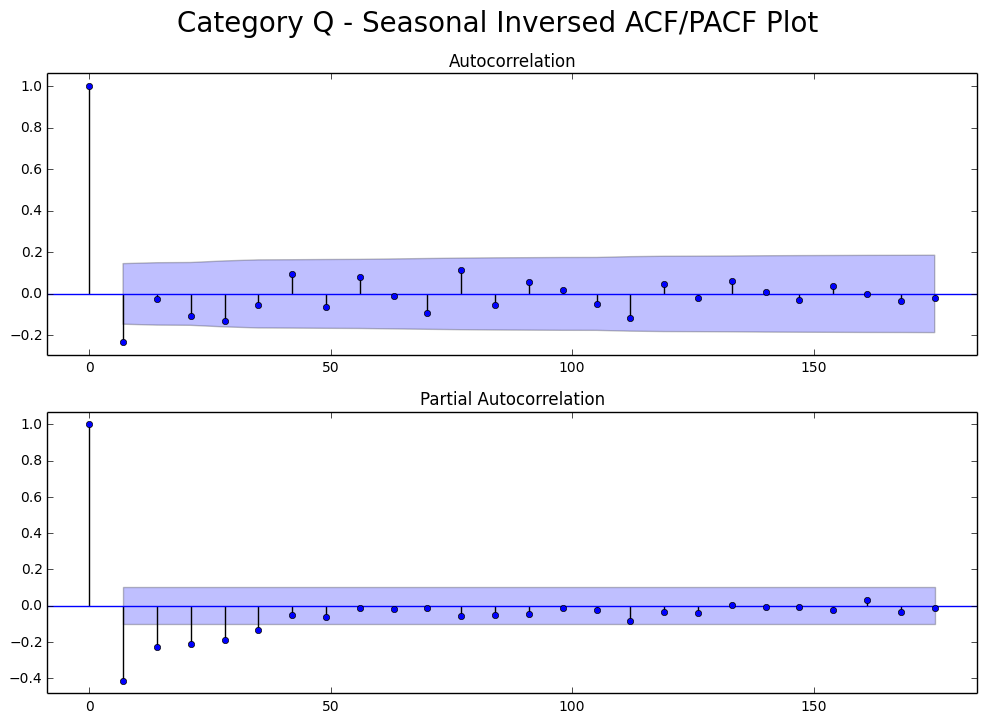

In [108]:
# Let's see the Seasonal diff ACF/PACF plot.

_ = map(acf_pacf_plot, splitted_data_season_log, ['Seasonal Inversed']*len(temp_list), temp_list, [range(0, 182, 7)]*len(temp_list))

## We observe these:
### A), D), E), F), G), H), I), L), P) both tail
### B), C), K), M), N), O), Q) PACF cut 1
### Some cut offs are not clear...possibly AR(1)?

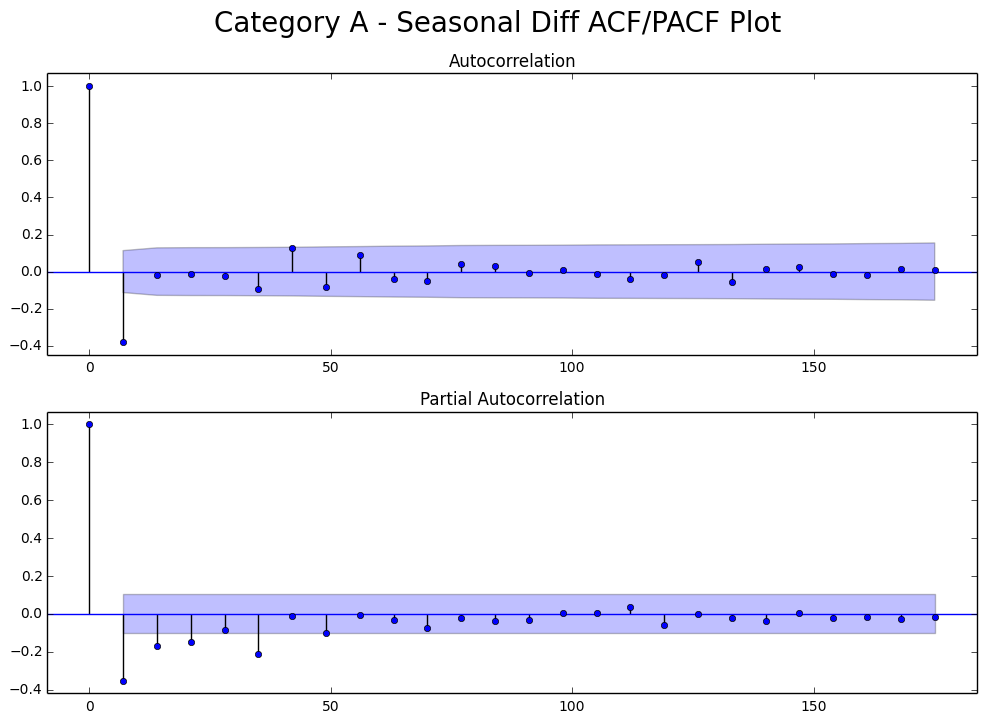

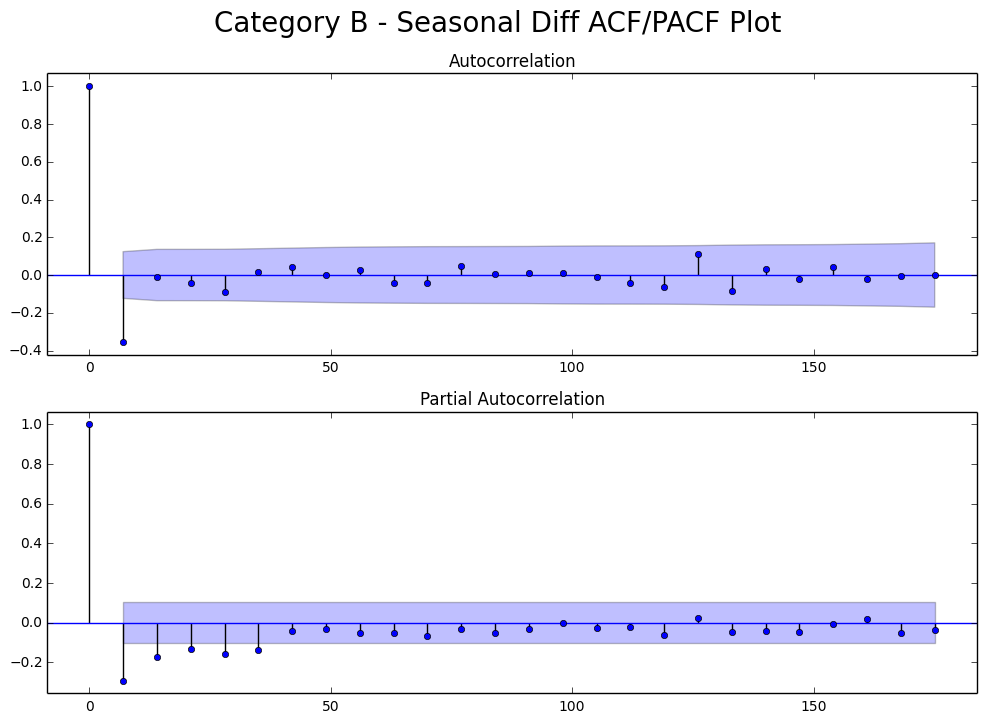

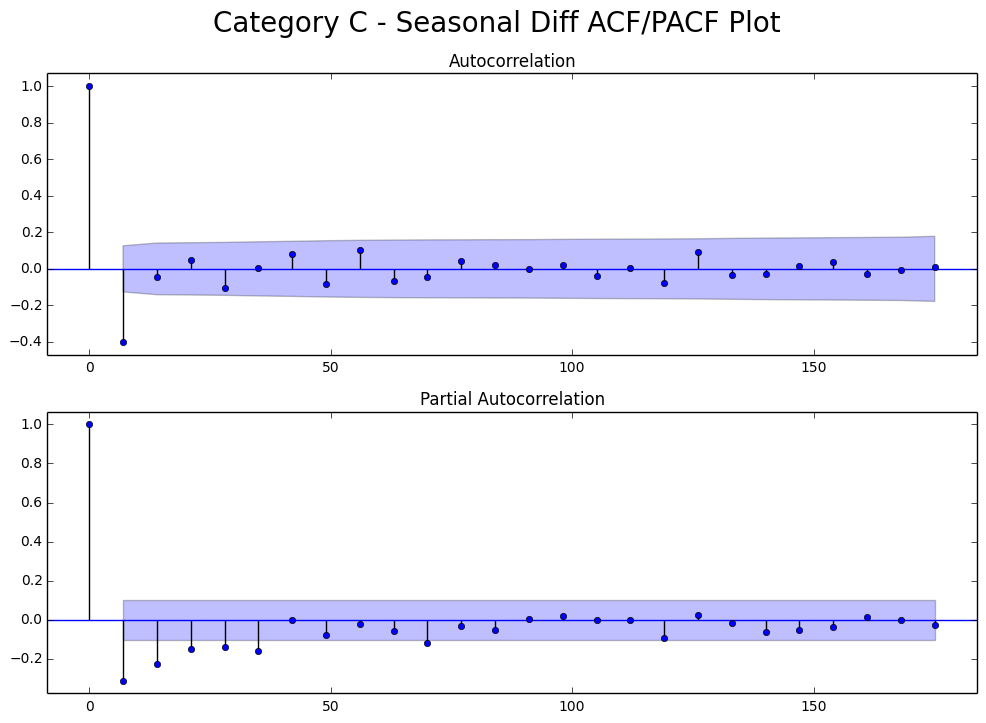

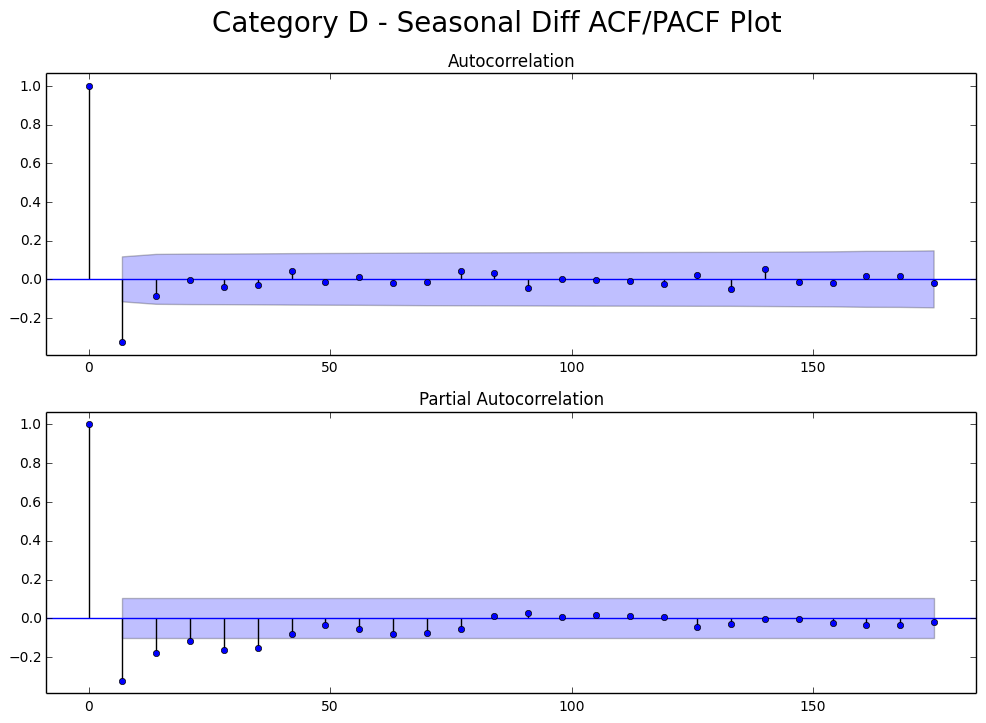

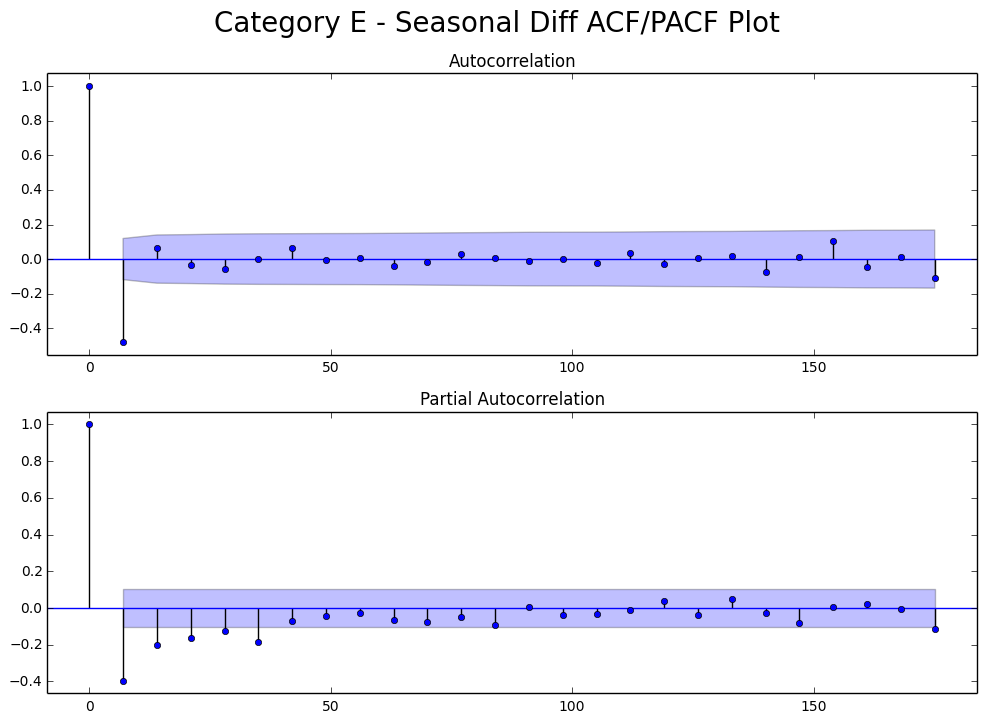

...

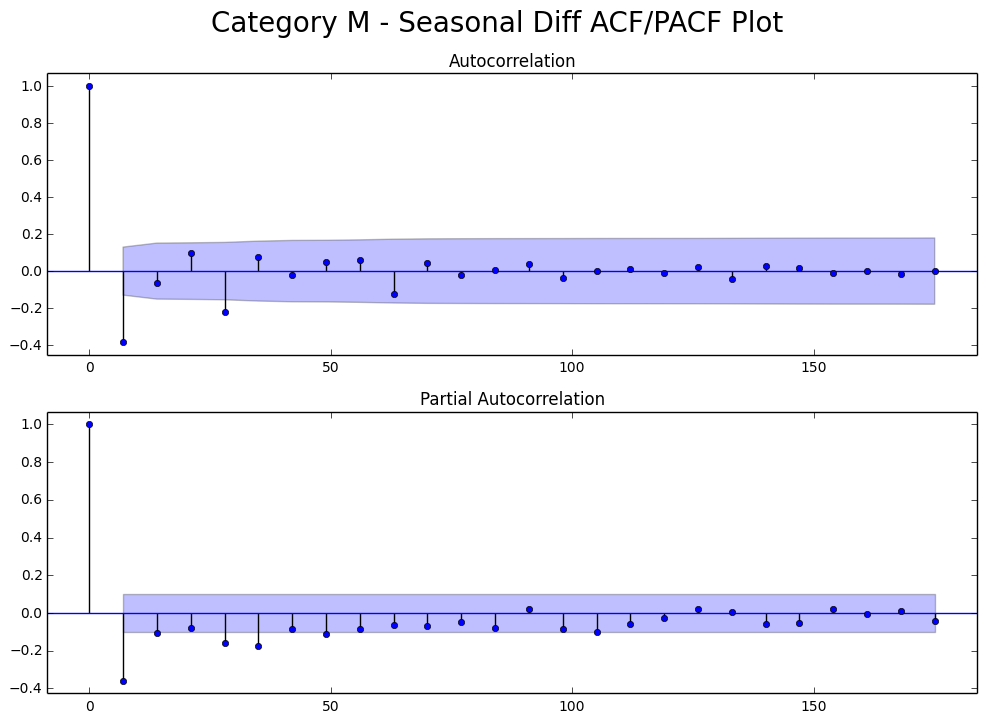

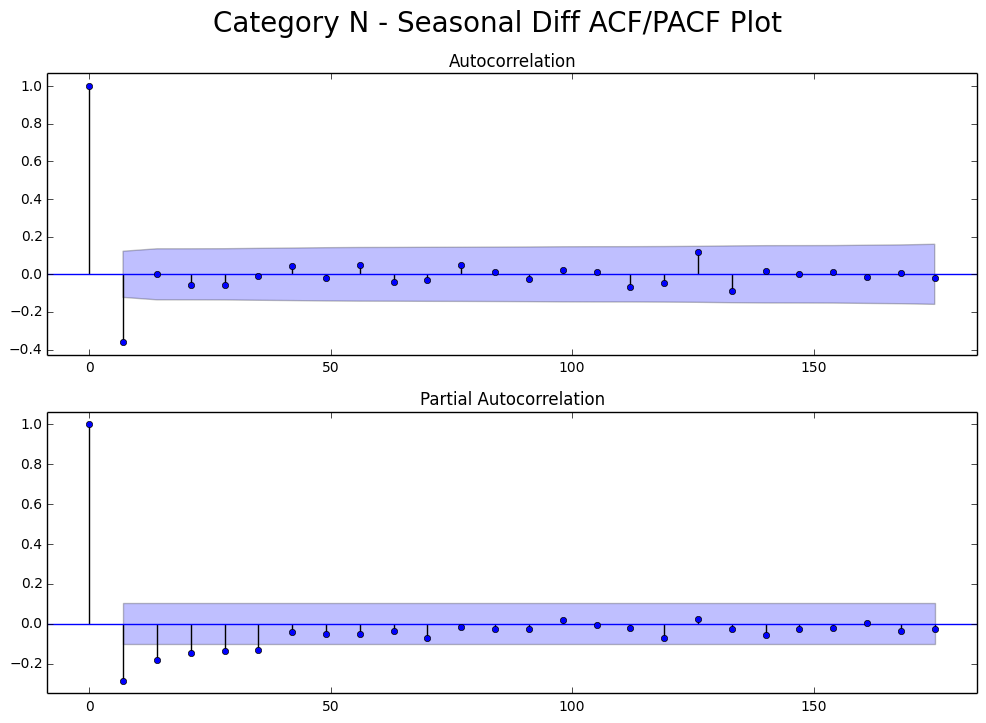

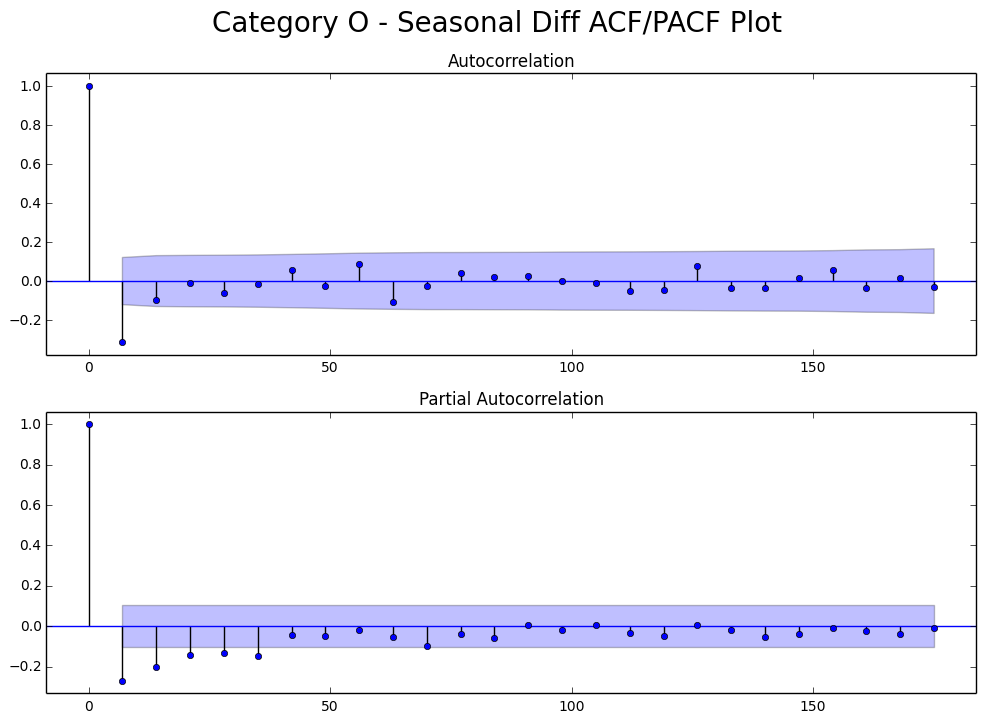

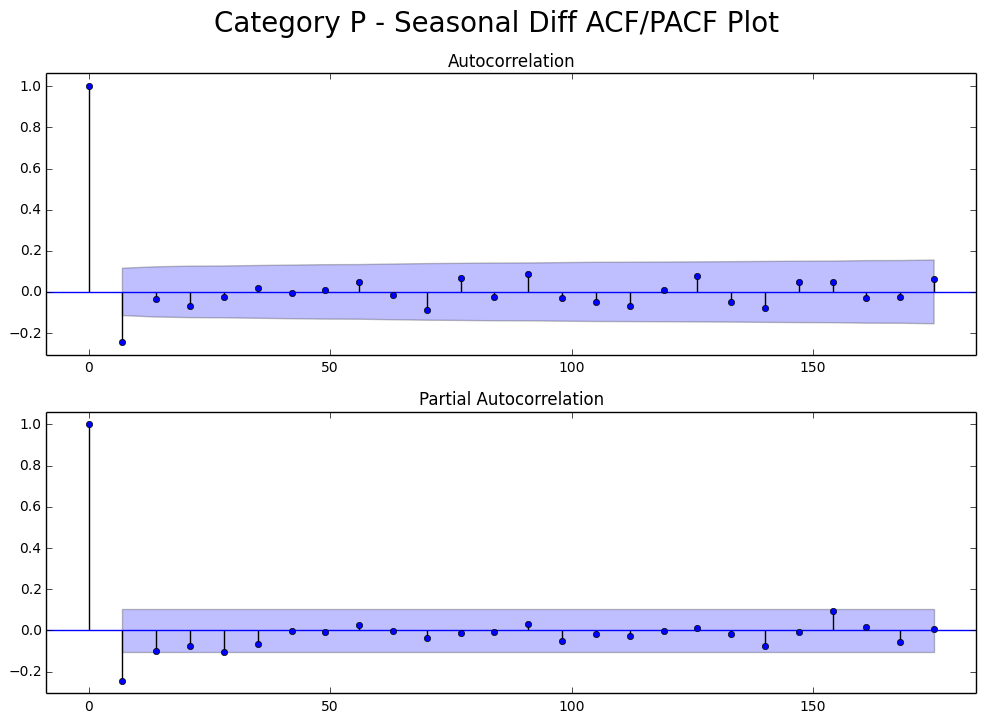

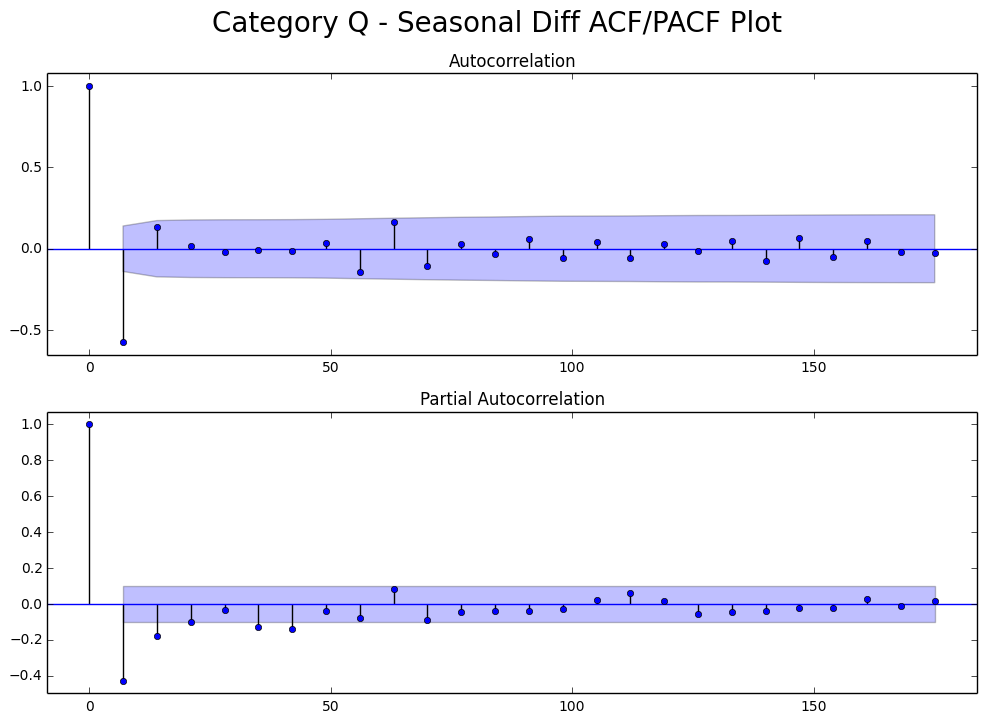

In [109]:
# Let's see the Season Diff ACF/PACF plot.

_ = map(acf_pacf_plot, splitted_data_season_diff, ['Seasonal Diff']*len(temp_list), temp_list, [range(0, 182, 7)]*len(temp_list))

### We observed:
### All - ACF cut 1...SMA(1)? -> SARIMA(0, 1, 1)?
### Some are rather not clear
### No worries, we will use grid search to help us find the optimized model!

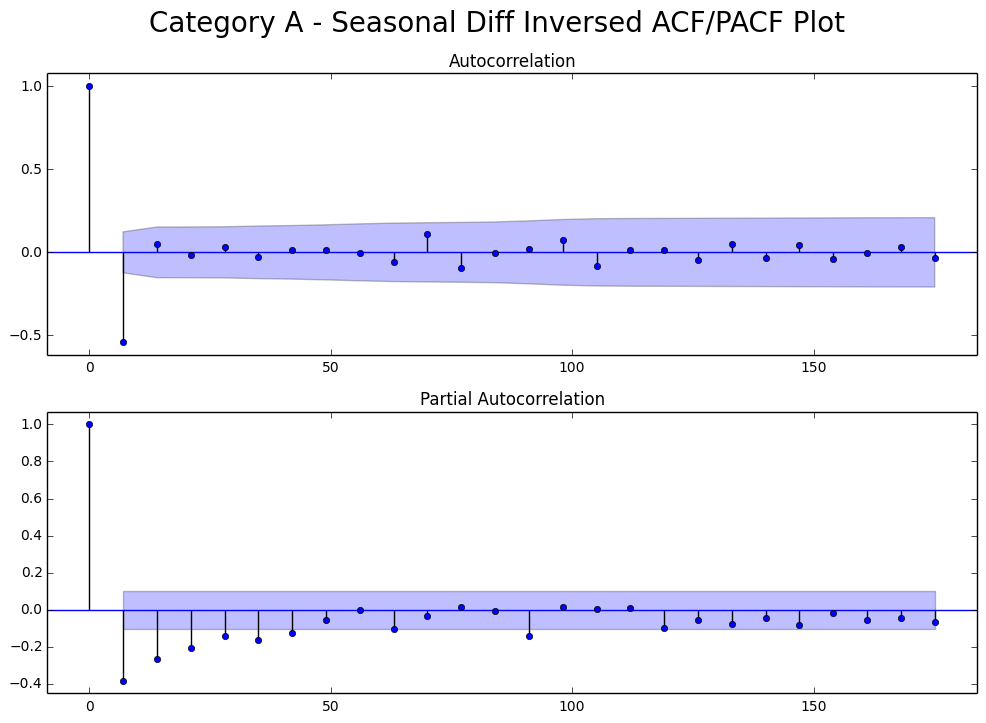

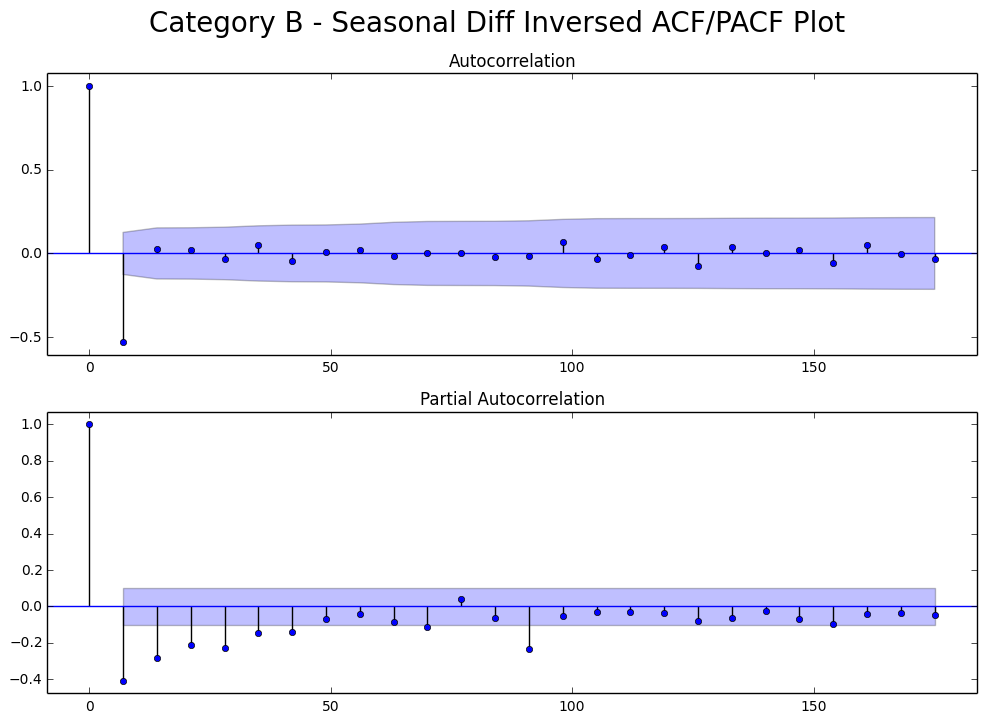

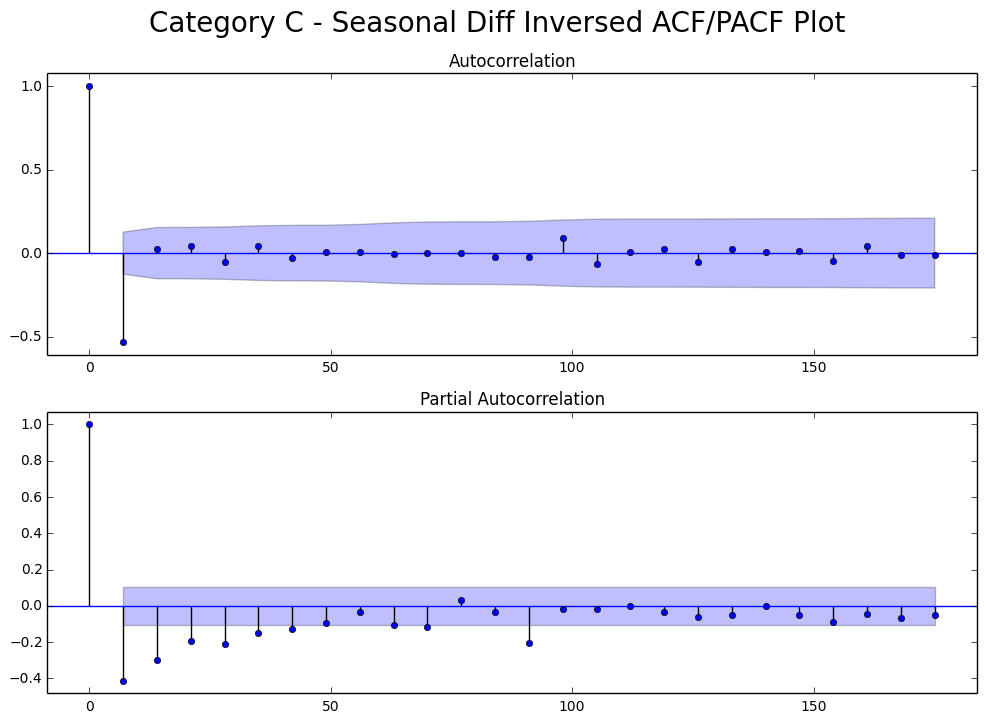

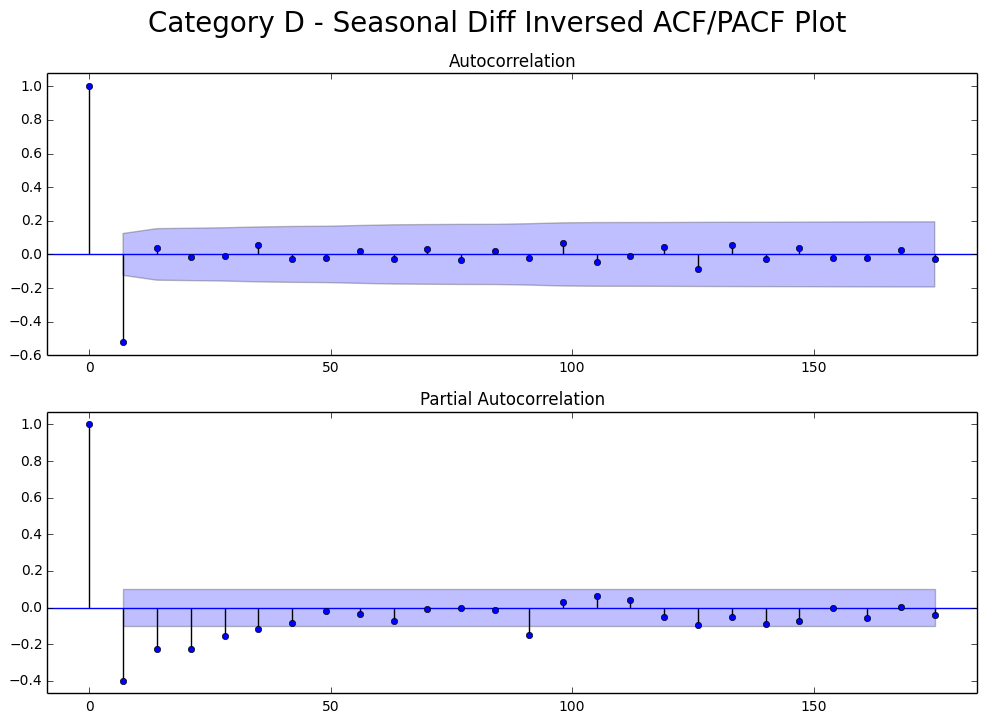

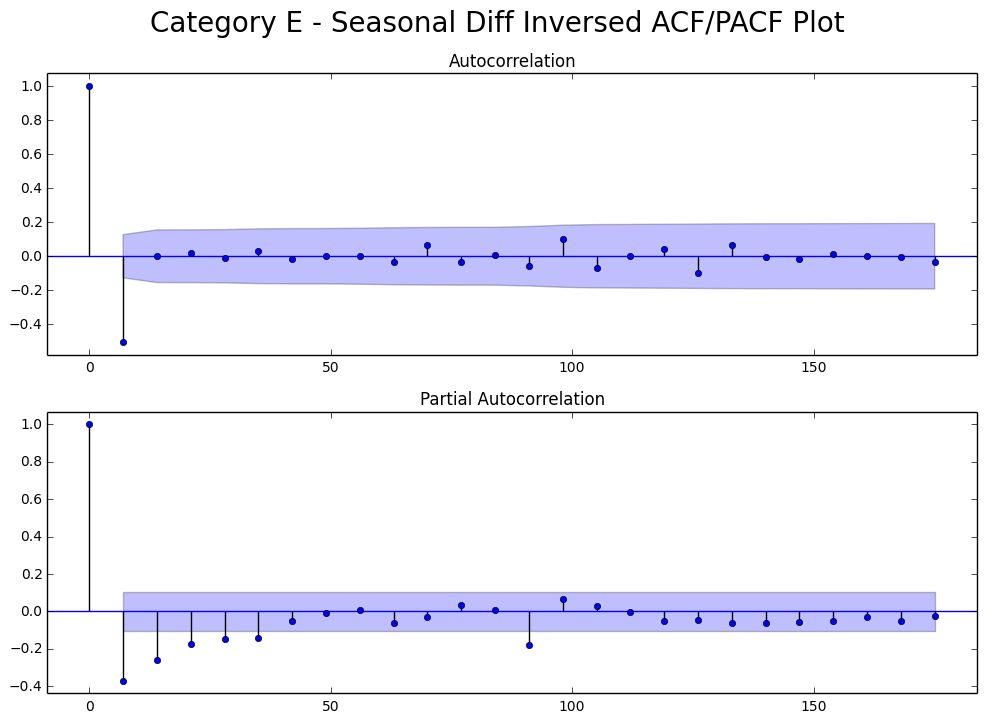

...

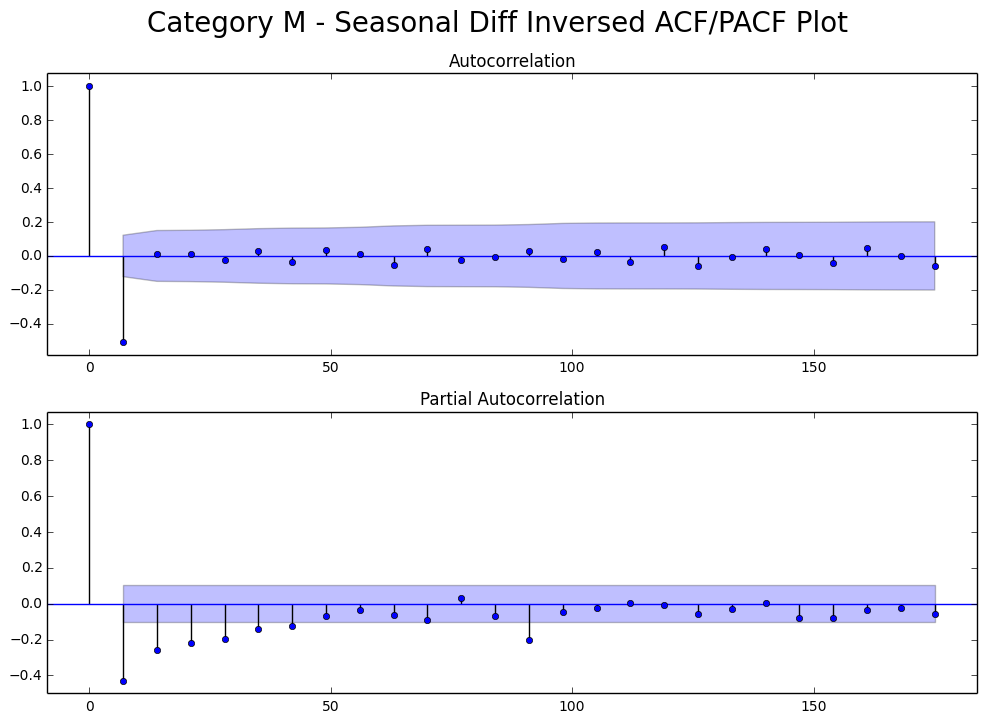

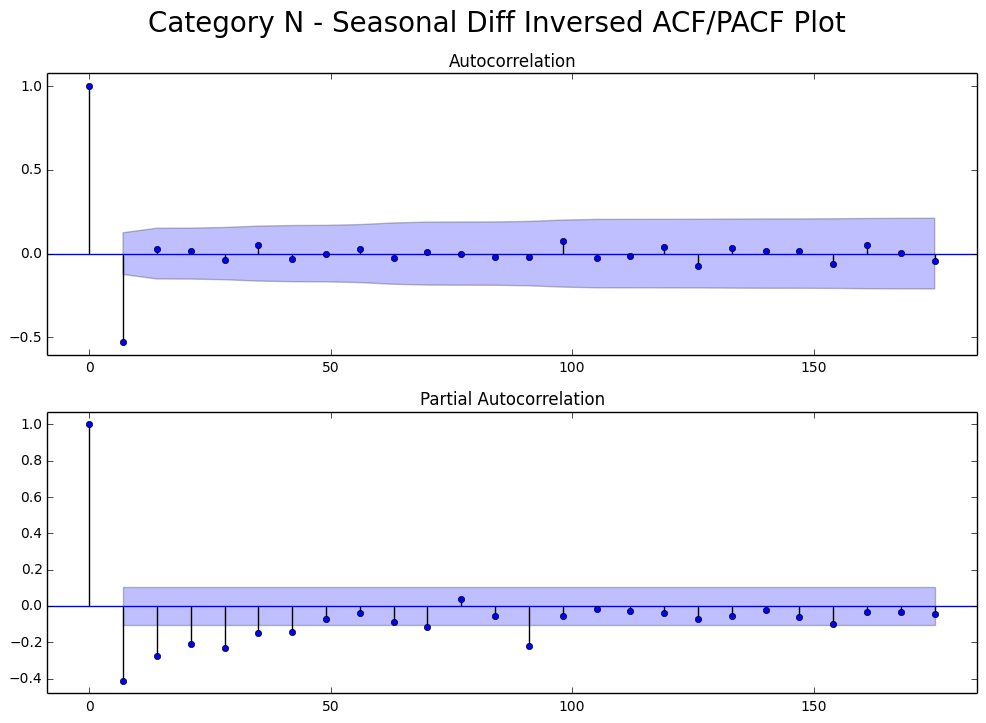

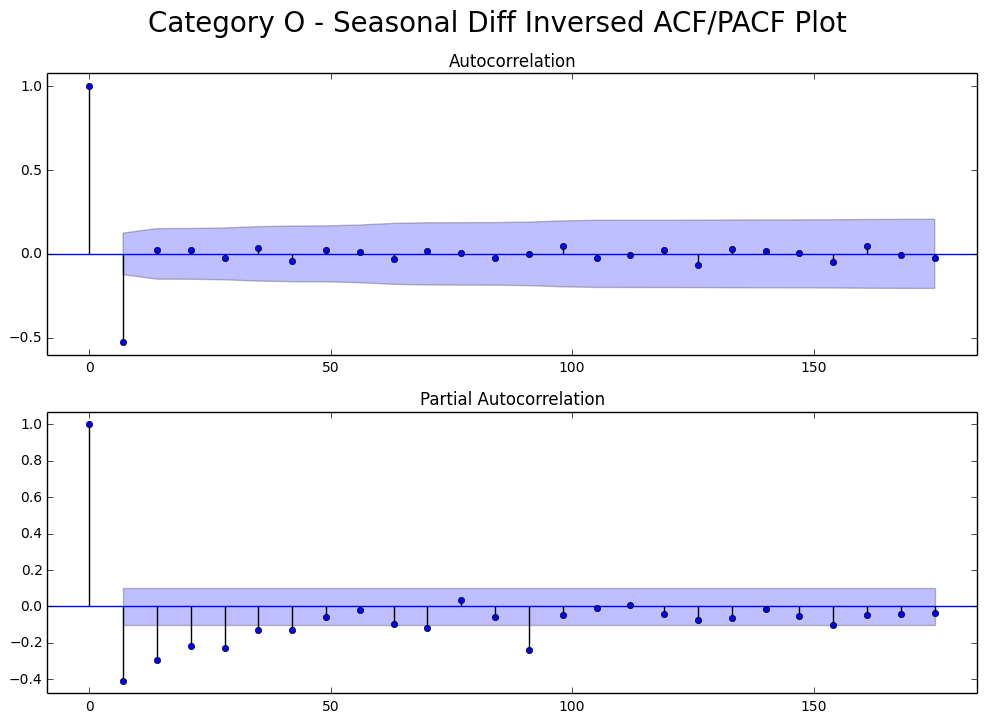

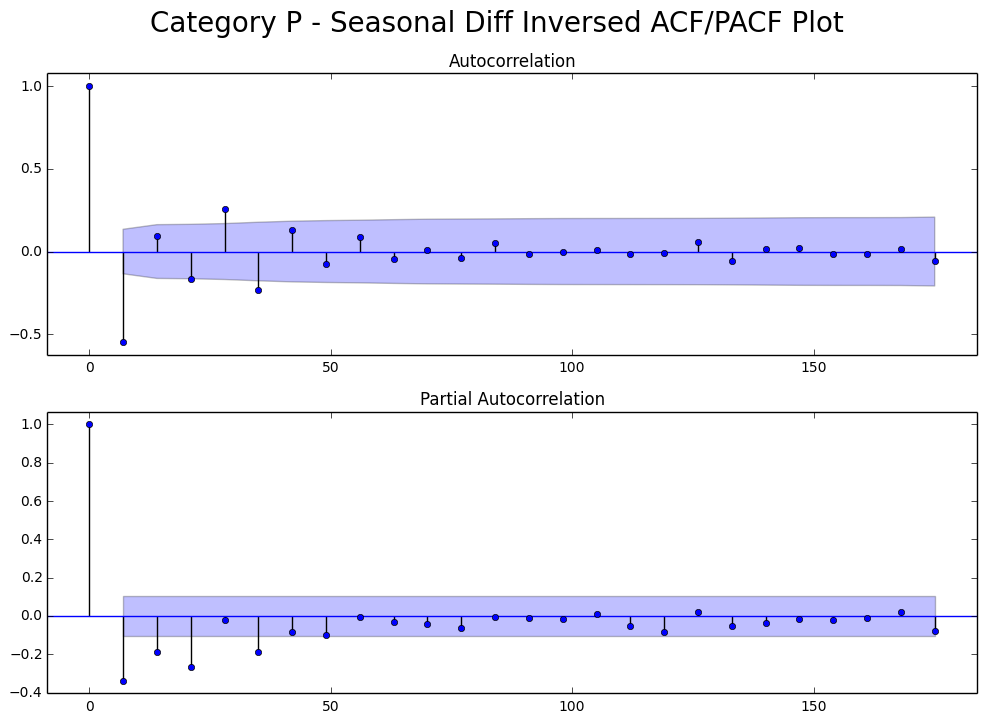

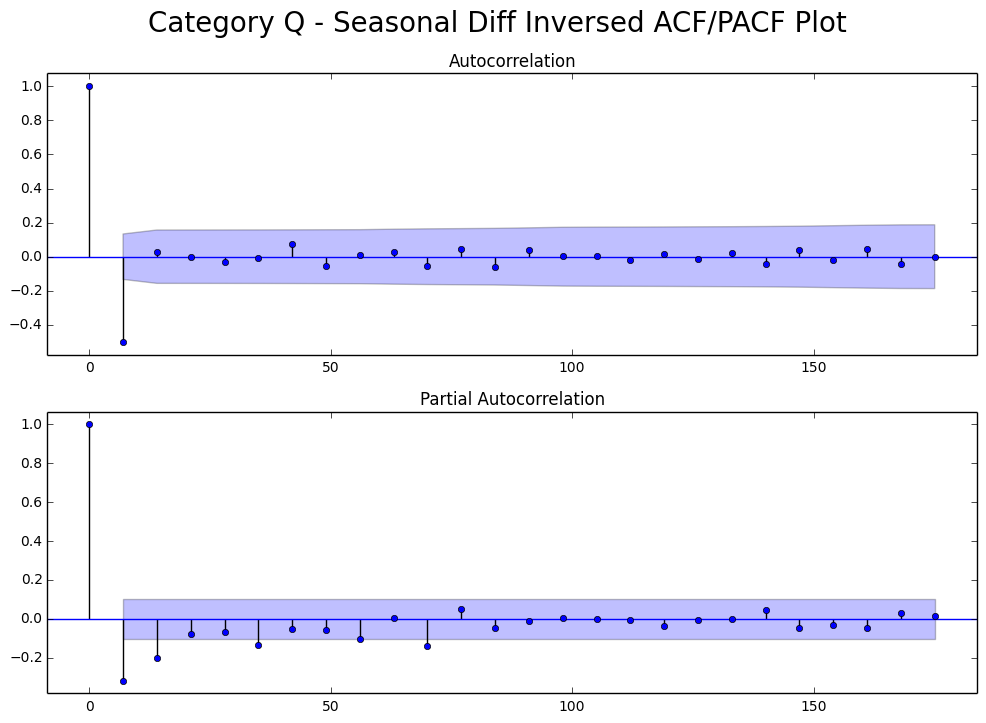

In [110]:
# Finally, let's see the Season Diff Inversed transformed ACF/PACF plot.

_ = map(acf_pacf_plot, splitted_data_season_diff_log, ['Seasonal Diff Inversed']*len(temp_list), temp_list, [range(0, 182, 7)]*len(temp_list))

# Step 5) Model Building
### - At this point we are sure we need MA and SMA models.
### - The AR and SAR models are uncertain.
### - The difference is 1 in both normal and seasonal lag.
### - We will use grid search to find out the AR & SAR order.

In [208]:
# We will use this function to help us search the best p & q values, and seasonal P & Q values.
# Four for loops is a lot, but we will be using it mostly for 1 or 2 values in each p, q, P & Q values.
# Because we already have a good idea these values won't be more than 2.

def evaluate_models(dataset, p_values, q_values, P_values, Q_values, trend):
    best_score, best_cfg, best_season = float("inf"), None, None
    for p in p_values:
        for q in q_values:
            for P in P_values:
                for Q in Q_values:
                    order = (p, trend, q)
                    season_order = (P, 1, Q, 7)
                    try:
                        mod = sm.tsa.statespace.SARIMAX(dataset, trend='n', order=order, \
                                                           seasonal_order=season_order)
                        result = mod.fit()
                        aic = result.aic
                        if aic < best_score:
                            best_score, best_cfg, best_season = aic, order, season_order
#                         print('SARIMA%s %s AIC=%.3f' % (order, season_order, aic))
                    except Exception as e:
                        print e
                        continue

#     print('Best SARIMA%s %s AIC=%.3f' % (best_cfg, best_season, best_score))
    return [best_cfg, best_season]

In [211]:
def model_building_zero(timeseries, item, p=range(0, 3), q=range(0, 3), P=range(0, 3), Q=range(0, 3), trend=0):
    orders = evaluate_models(timeseries, p, q, P, Q, trend)
    mod = sm.tsa.statespace.SARIMAX(timeseries, trend='n', order=orders[0], seasonal_order=orders[1])
    results = mod.fit()
    
    print 'Category {}: '.format(item), results.summary()
    return results

In [212]:
def model_building_one(timeseries, item, p=range(0, 3), q=range(0, 3), P=range(0, 3), Q=range(0, 3), trend=1):
    orders = evaluate_models(timeseries, p, q, P, Q, trend)
    mod = sm.tsa.statespace.SARIMAX(timeseries, trend='n', order=orders[0], seasonal_order=orders[1])
    results = mod.fit()
    
    print 'Category {}: '.format(item), results.summary()
    return results

In [113]:
results_obs = map(model_building_zero, splitted_data, temp_list)

could not broadcast input array from shape (0,0) into shape (7,7)
SARIMA(0, 0, 0) (0, 1, 1, 7) AIC=4429.707
SARIMA(0, 0, 0) (0, 1, 2, 7) AIC=4430.532
SARIMA(0, 0, 0) (1, 1, 0, 7) AIC=4430.119
SARIMA(0, 0, 0) (1, 1, 1, 7) AIC=4412.702
SARIMA(0, 0, 0) (1, 1, 2, 7) AIC=4414.476
SARIMA(0, 0, 0) (2, 1, 0, 7) AIC=4432.078
SARIMA(0, 0, 0) (2, 1, 1, 7) AIC=4414.288
SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=4413.000
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=4317.529
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=4287.159
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=4284.734
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=4292.768
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=4274.338
SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=4274.896
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=4292.239
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=4273.020
SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=4273.527
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=4286.520
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=4246.614
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=4242.273
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=4256.536
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=4233.874
SARIMA(0, 

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=4234.084
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=4256.676
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=4194.152
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=4189.314
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=4213.770
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=4184.313
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=4185.020
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=4205.996
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=4182.587
SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=4184.594
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=4255.474
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=4194.697
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=4190.038
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=4212.978
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=4184.803
SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=4185.436
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=4206.074
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=4182.920
SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=4184.901
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=4257.287
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=4191.749
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=4187.857
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=4213.846
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=4

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=4185.246
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=4257.386
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=4191.821
SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=4186.454
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=4213.887
SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=4181.509
SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=4182.386
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=4205.830
SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=4182.621


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=4182.038
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=4257.192
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=4192.176
SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=4187.107
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=4215.833


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=4184.091


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=4185.407
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=4207.514


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=4183.564


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=4184.597
Best SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=4181.466
Category A:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 2)x(2, 1, 1, 7)   Log Likelihood               -2083.733
Date:                           Wed, 01 Mar 2017   AIC                           4181.466
Time:                                   12:05:29   BIC                           4208.880
Sample:                               09-26-2015   HQIC                          4192.354
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.872

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (1, 1, 2, 7) AIC=6407.311
SARIMA(0, 0, 0) (2, 1, 0, 7) AIC=6435.777
SARIMA(0, 0, 0) (2, 1, 1, 7) AIC=6407.293
SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=6412.200
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=6338.915
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=6314.608
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=6310.325
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=6319.553
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=6288.527
SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=6290.387
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=6317.827
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=6288.348


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=6305.079
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=6308.765
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=6284.439
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=6273.499
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=6290.979
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=6254.456


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=6256.117
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=6288.405


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=6253.463


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=6267.965
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=6281.527
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=6238.154
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=6229.487
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=6251.754
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=6215.289
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=6216.101
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=6247.783
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=6212.885


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=6223.611
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=6277.990
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=6236.759
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=6227.780
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=6250.801
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=6212.359
SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=6213.701
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=6245.628
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=6210.794


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=6221.330
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=6278.455
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=6236.538
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=6227.432
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=6252.886
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=6213.945


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=6215.212
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=6245.405


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=6211.963


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=6222.981
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=6277.352
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=6237.381
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=6228.411
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=6250.955
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=6213.135
SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=6214.208
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=6245.885
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=6211.370


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=6221.394
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=6279.339
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=6235.321
SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=6223.471
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=6252.759


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=6214.174


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=6217.691
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=6246.898


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=6216.896


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=6220.748
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=nan


/Library/Python/2.7/site-packages/statsmodels/tsa/statespace/tools.py:405: RuntimeWarning: invalid value encountered in sqrt
  x = r / ((1 - r**2)**0.5)


SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=nan
Best SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=6210.794
Category B:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 1)x(2, 1, 1, 7)   Log Likelihood               -3099.397
Date:                           Wed, 01 Mar 2017   AIC                           6210.794
Time:                                   12:06:51   BIC                           6234.291
Sample:                               09-26-2015   HQIC                          6220.126
                                    - 09-30-2016                                         
Covariance Typ

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=5743.669
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=5660.635
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=5625.832
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=5619.113
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=5636.355
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=5610.600
SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=5611.403
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=5630.543
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=5609.802


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=5627.208
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=nan
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=5583.434
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=5505.064
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=5499.010
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=5536.925
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=5496.460
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=5497.542
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=5519.486
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=5496.300


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=5498.155
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=5576.598
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=5499.962
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=5493.227
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=5530.866
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=5490.332
SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=5491.420
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=5514.175
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=5490.276


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=5495.667
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=5573.146
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=5501.017
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=5494.892
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=5532.068
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=5492.255
SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=5493.362
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=5516.151
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=5492.220


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=5504.423
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=5574.104
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=5500.813
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=5493.884
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=5530.360
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=5490.794
SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=5491.861
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=5514.316
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=5490.715


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=5498.915
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=5575.674
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=5499.493
SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=5493.117
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=5532.360


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=5491.253


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=5495.274
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=5516.154


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=5498.504


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=5501.595
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=nan
Best SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=5490.276
Category C:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 1)x(2, 1, 1, 7)   Log Likelihood               -2739.138
Date:                           Wed, 01 Mar 2017   AIC                           5490.276
Time:                                   12:07:56   BIC                           5513.773
Sample:                               09-26-2015   HQIC                          5499.608
                         

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=4785.001
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=4686.491
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=4676.210
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=4675.044
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=4678.085
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=4661.208
SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=4663.100
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=4678.325
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=4661.753
SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=4663.722
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=4652.313
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=4635.831
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=4632.214
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=4640.062
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=4622.010
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=4623.443
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=4637.593


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=4621.366
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=4623.371
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=4621.747
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=4581.041
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=4571.764
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=4595.962
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=4566.153
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=4567.427
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=4586.433
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=4567.194
SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=4568.622
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=4614.593
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=4574.973
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=4567.032
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=4588.309
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=4560.885
SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=4561.996
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=4579.769
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=4561.042
SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=4562.779
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=4613.805
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=4576.894
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=4568.719
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=4

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=4564.683
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=4613.380
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=4575.376
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=4567.438
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=4588.184
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=4561.276
SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=4562.396
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=4579.760
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=4561.446
SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=4563.201
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=4615.382
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=4574.497
SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=4563.610
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=4590.037
SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=4557.840


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=4561.483
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=4581.647


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=4558.867


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=4564.561
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=4613.636


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=4576.275


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=4565.585


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=4592.268


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=4562.875


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=4561.120
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=4583.601
SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=4565.353


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=4564.141
Best SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=4557.840
Category D:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(2, 0, 1)x(1, 1, 1, 7)   Log Likelihood               -2272.920
Date:                           Wed, 01 Mar 2017   AIC                           4557.840
Time:                                   12:09:18   BIC                           4581.337
Sample:                               09-26-2015   HQIC                          4567.172
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.468

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=4771.080
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=nan
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=4723.862
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=4612.139
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=4613.794
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=4643.439
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=4613.640


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=4615.008
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=4632.159
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=4609.657
SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=4611.549
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=4719.395
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=4609.687
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=4611.303
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=4638.945
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=4611.128


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=4612.450
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=4628.174
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=4607.134
SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=4609.026
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=4720.644
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=4608.766
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=4610.577
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=4640.561
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=4610.499


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=4612.120
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=4628.233
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=4607.087
SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=4608.904
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=4718.873
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=4610.532
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=4612.108
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=4639.663
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=4611.912


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=4613.191
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=4629.371
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=4611.033
SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=4609.739
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=4720.868
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=4607.691


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=4609.233
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=4640.585


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=4609.767


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=4611.277
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=4628.713


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=4611.171


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=4613.052
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=nan
Best SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=4607.087
Category E:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 2)x(2, 1, 1, 7)   Log Likelihood               -2296.543
Date:                           Wed, 01 Mar 2017   AIC                           4607.087
Time:                                   12:10:22   BIC                           4634.500
Sample:                               09-26-2015   HQIC                          4617.974
                         

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (1, 1, 2, 7) AIC=7246.751
SARIMA(0, 0, 0) (2, 1, 0, 7) AIC=7270.898
SARIMA(0, 0, 0) (2, 1, 1, 7) AIC=7246.733
SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=7251.250
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=7120.623
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=7093.104
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=7101.592
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=7109.259
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=7070.338
SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=7072.169
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=7107.357
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=7070.151


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=7094.171
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=nan
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=7030.829
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=6991.928
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=6983.855
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=7004.671
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=6969.992
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=6970.694
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=6998.009
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=6968.023


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=6976.382
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=7032.512
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=6994.056
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=6986.013
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=7006.707
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=6976.818


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=6972.695
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=7000.119


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=6970.033


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=6978.633
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=7033.206
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=6995.422
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=6987.397
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=7008.744
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=6978.734


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=6977.315
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=7002.043
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=6978.434


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=6980.508
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=7032.514
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=6993.892
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=6985.795
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=7006.607
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=6976.530
SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=6972.692
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=6999.977
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=6976.278


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=6978.346
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=7034.445
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=6995.508
SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=6987.382
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=7008.667
SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=6978.499


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=6979.594
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=7001.847


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=6972.034


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=6980.304


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=7026.020
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=6996.594
SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=6988.472
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=7009.631
SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=6980.610


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=6980.076
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=7003.885


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=6979.373


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=6982.453
Best SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=6968.023
Category F:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 0)x(2, 1, 1, 7)   Log Likelihood               -3479.011
Date:                           Wed, 01 Mar 2017   AIC                           6968.023
Time:                                   12:11:35   BIC                           6987.604
Sample:                               09-26-2015   HQIC                          6975.800
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.741

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=5778.321
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=nan
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=5742.616
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=5695.085
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=5682.265
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=5715.115
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=5676.306
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=5677.746
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=5702.008
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=5678.470


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=5685.877
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=5743.761
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=5696.466
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=5683.693
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=5716.302
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=5677.666
SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=5679.101
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=5703.109
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=5678.704


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=5687.938
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=5745.696
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=5695.157
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=5683.729
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=5717.771
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=5678.478


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=5679.851
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=5704.147
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=5679.333


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=5689.655
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=5743.735
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=5696.601
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=5683.792
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=5716.405
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=5677.759
SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=5679.199
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=5703.242
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=5678.805


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=5686.891
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=5745.742
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=5695.168


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=5681.578
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=5718.116


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=5678.982


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=5682.484
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=5704.278


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=5679.112


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=5684.481
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=5744.158
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=5695.757


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=5683.089


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=5719.505


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=5681.040


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=5688.365


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=5707.508


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=5688.127


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=5690.253
Best SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=5676.306
Category G:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 0)x(1, 1, 1, 7)   Log Likelihood               -2834.153
Date:                           Wed, 01 Mar 2017   AIC                           5676.306
Time:                                   12:12:51   BIC                           5691.970
Sample:                               09-26-2015   HQIC                          5682.527
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.710

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=6289.670
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=6195.896
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=6174.677
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=6174.195
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=6177.578
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=6152.946
SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=6154.904
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=6177.955
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=6152.873


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=6167.995
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=nan
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=6128.538
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=6089.599
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=6084.824
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=6100.107
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=6067.096
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=6068.957
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=6096.488
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=6064.998


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=6075.306
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=6127.678
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=6089.989
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=6084.871
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=6101.610
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=6066.912
SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=6068.782
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=6096.592
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=6065.183


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=6075.716
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=6128.355
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=6090.889
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=6085.988
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=6103.724


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=6068.814


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=6070.659
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=6098.358


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=6066.571


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=6077.696
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=6127.272
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=6090.190
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=6085.077
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=6101.517
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=6067.026
SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=6068.900
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=6096.738
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=6065.359


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=6075.404
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=6129.186
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=6089.073
SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=6081.950
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=6102.138


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=6070.049


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=6067.257
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=6097.603


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=6068.556


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=6074.639
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=nan
Best SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=6064.998
Category H:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 0)x(2, 1, 1, 7)   Log Likelihood               -3027.499
Date:                           Wed, 01 Mar 2017   AIC                           6064.998
Time:                                   12:14:01   BIC                           6084.579
Sample:                               09-26-2015   HQIC                          6072.775
                         

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=5450.959
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=5324.330
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=5313.749
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=5312.960
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=5315.418
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=5294.914
SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=5296.882
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=5316.370
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=5296.132
SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=5298.088
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=nan
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=5250.449
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=5223.880
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=5216.982
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=5231.531
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=5201.921
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=5203

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=5204.725
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=5250.251
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=5224.466
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=5216.551
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=5232.230
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=5201.661
SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=5203.615
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=5227.627
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=5202.789


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=5204.740
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=5252.156
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=5219.055
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=5212.499
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=5230.258


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=5199.716
SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=5201.535
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=5225.300
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=5199.237


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=5207.721
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=5250.465
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=5224.984
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=5217.339
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=5232.628
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=5202.287
SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=5204.242
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=5228.231
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=5203.401
SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=5205.372
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=5252.197
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=5222.909
SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=5214.316
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=5232.506


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=5202.986


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=5202.383
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=5227.504


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=5204.599


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=5206.018


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=5253.469
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=5221.052
SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=5214.390
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=5232.184


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=5202.562


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=5209.813
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=5227.246


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=5201.204


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=5209.528
Best SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=5199.237
Category I:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 2)x(2, 1, 1, 7)   Log Likelihood               -2592.618
Date:                           Wed, 01 Mar 2017   AIC                           5199.237
Time:                                   12:15:16   BIC                           5226.650
Sample:                               09-26-2015   HQIC                          5210.125
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.877

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=5084.454
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=5008.299
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=4983.672
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=4975.815
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=4991.812
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=4970.965
SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=4972.383
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=4985.489
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=4971.931
SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=4973.929
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=4974.939
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=4937.206
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=4930.556
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=4950.180
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=4927.222


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=4928.471
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=4941.799


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=4927.958
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=4929.873
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=4957.496
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=4897.685
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=4888.850
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=4923.872
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=4887.082
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=4888.779
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=4907.452
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=4888.781
SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=4890.785
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=4953.509
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=4890.611
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=4882.456
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=4917.602
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=4880.649
SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=4882.333
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=4901.726
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=4882.314


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=4884.316
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=4955.210
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=4889.678
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=4881.506
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=4919.558
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=4880.041
SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=4881.812
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=4903.155
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=4881.817


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=4883.872
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=4953.132
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=4892.012
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=4883.844
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=4917.852
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=4881.962
SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=4883.618
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=4902.428
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=4883.588


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=4885.558
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=4955.126
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=4887.440
SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=4878.492
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=4919.420


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=4876.966


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=4879.311
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=4902.230


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=4878.824


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=4880.946
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=4954.597


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=4889.445


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=4881.042
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=4920.679


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=4879.291


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=4884.322


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=4905.545


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=4880.911


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=4883.092
Best SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=4876.966


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Category K:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(2, 0, 1)x(1, 1, 1, 7)   Log Likelihood               -2432.483
Date:                           Wed, 01 Mar 2017   AIC                           4876.966
Time:                                   12:16:34   BIC                           4900.463
Sample:                               09-26-2015   HQIC                          4886.298
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.3662      0.120     11.416      0.000       1.132       1.601
ar.L2         -0.3998      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=5160.032
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=5032.883
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=5008.993
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=5006.211
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=5013.782
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=4997.845
SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=4998.864
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=5011.794
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=4995.612


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=4997.614
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=nan
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=4987.165
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=4952.999
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=4947.814
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=4961.585
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=4941.108
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=4942.082
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=4956.767
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=4939.324


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=4942.106
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=4987.731
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=4954.620
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=4949.450
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=4962.962
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=4942.756
SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=4943.738
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=4958.291
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=4941.052


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=4945.360
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=4989.443
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=4950.361
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=4945.359
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=4961.068
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=4939.436
SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=4940.198
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=4955.439
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=4937.118


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=4944.179
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=4987.979
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=4954.749
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=4949.567
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=4963.153
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=4942.865
SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=4943.847
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=4958.441
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=4941.142


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=4945.534
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=4985.902
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=4948.671
S

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=4935.495


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=4943.105
Best SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=4935.495


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Category L:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(2, 0, 2)x(2, 1, 1, 7)   Log Likelihood               -2459.748
Date:                           Wed, 01 Mar 2017   AIC                           4935.495
Time:                                   12:17:28   BIC                           4966.825
Sample:                               09-26-2015   HQIC                          4947.939
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3723      0.237      1.568      0.117      -0.093       0.838
ar.L2          0.3144      0.1

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=7131.336
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=7172.041
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=7129.380


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=7144.715
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=7206.646
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=7162.561
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=7147.055
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=7177.881
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=7137.034


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=7125.042
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=7169.486
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=7138.223


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=7140.216
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=7209.331
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=7160.725
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=7147.254
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=7177.521
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=7125.649


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=7127.050
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=7168.350
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=7125.155


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=7140.108
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=7203.056
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=7148.178
S

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=7130.471
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=7159.894
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=7129.508


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=7131.535
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=7204.119
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=7155.950
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=7140.042
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=7173.367
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=7118.546


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=7119.951
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=7163.912
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=7132.083


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=7134.081
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=7203.913
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=7147.435
SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=7134.338
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=7170.283


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=7114.572


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=7129.068
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=7159.254
SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=7128.362


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=7130.377
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=nan
Best SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=7114.572


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Category M:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(2, 0, 1)x(1, 1, 1, 7)   Log Likelihood               -3551.205
Date:                           Wed, 01 Mar 2017   AIC                           7114.410
Time:                                   12:18:22   BIC                           7137.907
Sample:                               09-26-2015   HQIC                          7123.742
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9807      0.127      7.695      0.000       0.731       1.230
ar.L2         -0.0545      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=6749.269
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=6751.908
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=6723.701
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=6718.378
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=6731.897


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=6696.352
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=6708.697
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=6728.123


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=6704.287


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=6709.006
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=6723.040
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=6677.872
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=6670.085
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=6692.427
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=6654.554
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=6655.069
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=6685.669
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=6651.896


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=6662.546
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=6719.781
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=6677.200
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=6664.833
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=6691.038
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=6652.219


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=6653.535
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=6684.310


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=6650.718


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=6660.946
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=6718.413
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=6678.734
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=6670.442
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=6692.772
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=6654.219


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=6657.958
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=6686.218
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=6660.696


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=6662.746
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=6718.742
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=6677.093
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=6668.700
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=6690.788
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=6652.334


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=6653.661
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=6684.136


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=6650.886


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=6660.578
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=6720.629
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=6677.013
SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=6666.771
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=6692.898
SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=6654.219


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=6659.874
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=6686.225


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=6658.938


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=6661.102
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=nan
Best SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=6650.718


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Category N:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 1)x(2, 1, 1, 7)   Log Likelihood               -3319.359
Date:                           Wed, 01 Mar 2017   AIC                           6650.718
Time:                                   12:19:37   BIC                           6674.216
Sample:                               09-26-2015   HQIC                          6660.051
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.7437      0.041     17.922      0.000       0.662       0.825
ma.L1         -0.1392      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=6826.365
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=6728.718
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=6714.706
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=6707.562
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=6719.446
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=6674.374
SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=6676.370
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=6714.819
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=6676.202


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=6697.443
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=nan
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=6654.073
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=6613.675
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=6595.596
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=6630.441
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=6580.605


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=6582.568
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=6617.938
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=6581.803


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=6593.372
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=6652.797
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=6612.061
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=6596.396
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=6629.954
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=6580.583


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=6582.553
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=6618.088


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=6581.873


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=6593.317
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=6653.071
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=6612.394
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=6597.042
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=6632.039
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=6582.354


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=6584.308
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=6620.002


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=6583.482


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=6595.325
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=6652.421
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=6614.169
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=6596.561
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=6629.946
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=6580.753


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=6582.726
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=6618.077
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=6582.058


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=6593.111
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=6654.392
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=6611.488


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=6592.182
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=6631.951


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=6585.272


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=6590.969
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=6620.016


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=6588.920


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=6592.873
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=6650.140
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=6615.306
SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=6599.402
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=6633.667


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=6591.381
SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=6592.851
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=6621.697


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=6592.691


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=6594.794
Best SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=6580.583
Category O:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 7)   Log Likelihood               -3285.291
Date:                           Wed, 01 Mar 2017   AIC                           6580.583
Time:                                   12:21:00   BIC                           6600.164
Sample:                               09-26-2015   HQIC                          6588.360
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.766

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=3307.988
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=3215.002
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=3208.241
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=3207.495
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=3209.561
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=3190.793


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=3192.789
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=3210.288
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=3192.784
SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=3194.335
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=3199.765
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=3189.661
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=3188.848
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=3191.510
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=3171.969


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=3173.968
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=3192.319
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=3173.804
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=3174.906
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=3176.343
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=3159.516
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=3156.243
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=3163.695
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=3139.683


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=3141.680
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=3162.748
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=3141.432
SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=3142.687
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=3173.150
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=3155.868
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=3151.725
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=3160.559
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=3135.680


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=3137.692
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=3158.561
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=3137.536
SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=3139.109
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=3173.061
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=3148.381
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=3143.379
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=3155.943
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=3127.318


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=3129.413
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=3153.196


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=3128.659
SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=3130.130
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=3175.220
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=3158.920
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=3155.181
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=3163.173
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=3138.749


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=3140.754
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=3161.771
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=3140.609


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=3142.051
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=3174.104
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=3149.743
S

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=3129.196


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=3131.615
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=3154.385


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=3130.487
SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=3131.984
Best SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=3127.318
Category P:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 2)x(1, 1, 1, 7)   Log Likelihood               -1557.659
Date:                           Wed, 01 Mar 2017   AIC                           3127.318
Time:                                   12:22:03   BIC                           3150.815
Sample:                               09-26-2015   HQIC                          3136.650
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=3653.374
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=3806.123
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=3654.638
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=3655.418
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=3676.936
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=3653.455
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=3654.107
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=3658.234
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=3641.689


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=3642.917
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=3797.952
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=3636.430
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=3635.388
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=3665.555
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=3633.320
SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=3634.875
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=3639.710
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=3623.379


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=3624.661
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=3793.702
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=3637.639


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=3636.512
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=3666.595
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=3633.920


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=3635.246
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=3640.677


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=3622.064


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=3625.096
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=3792.809
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=3639.722
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=3639.885
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=3668.407
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=3638.546
SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=3640.085
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=3643.972
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=3629.621


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=3630.698
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=3767.170
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=3637.825


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=3636.234
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=3664.172
SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=3639.681
SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=3641.031
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=3644.593
SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=3628.454


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=3629.984
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Best SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=3622.064


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Category Q:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 2)x(2, 1, 1, 7)   Log Likelihood               -1804.032
Date:                           Wed, 01 Mar 2017   AIC                           3622.064
Time:                                   12:23:06   BIC                           3649.477
Sample:                               09-26-2015   HQIC                          3632.951
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9210      0.039     23.441      0.000       0.844       0.998
ma.L1         -0.4944      0.0

In [152]:
results_log = map(model_building_zero, splitted_data_log, temp_list)

could not broadcast input array from shape (0,0) into shape (7,7)


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Category A:                                   Statespace Model Results                                
Dep. Variable:          

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Category B:                                   Statespace Model Results                                
Dep. Variable:          

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Category C:                                   Statespace Model Results                                
Dep. Variable:          

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category D:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 2)x(0, 1, 1, 7)   Log Likelihood                -564.506
Date:                           Wed, 01 Mar 2017   AIC                           1139.012
Time:                                   12:45:16   BIC                           1158.593
Sample:                               09-26-2015   HQIC                          1146.789
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9503      0.024     39.232      0.000       0.903       0.998
ma.L1         -0.4363      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category E:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 1)x(2, 1, 1, 7)   Log Likelihood                -598.529
Date:                           Wed, 01 Mar 2017   AIC                           1209.059
Time:                                   12:46:17   BIC                           1232.556
Sample:                               09-26-2015   HQIC                          1218.391
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9255      0.027     34.616      0.000       0.873       0.978
ma.L1         -0.5129      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category F:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 7)   Log Likelihood                -723.689
Date:                           Wed, 01 Mar 2017   AIC                           1457.379
Time:                                   12:47:12   BIC                           1476.960
Sample:                               09-26-2015   HQIC                          1465.156
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9064      0.025     36.939      0.000       0.858       0.955
ma.L1         -0.4587      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category G:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 7)   Log Likelihood                -651.101
Date:                           Wed, 01 Mar 2017   AIC                           1312.203
Time:                                   12:48:22   BIC                           1331.784
Sample:                               09-26-2015   HQIC                          1319.980
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9057      0.025     35.966      0.000       0.856       0.955
ma.L1         -0.4637      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Category H:                                   Statespace Model Results                                
Dep. Variable:          

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category I:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 1)x(0, 1, 1, 7)   Log Likelihood                -634.862
Date:                           Wed, 01 Mar 2017   AIC                           1277.724
Time:                                   12:50:25   BIC                           1293.389
Sample:                               09-26-2015   HQIC                          1283.946
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9214      0.029     31.955      0.000       0.865       0.978
ma.L1         -0.4868      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category K:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 1)x(0, 1, 1, 7)   Log Likelihood                -608.131
Date:                           Wed, 01 Mar 2017   AIC                           1224.262
Time:                                   12:51:27   BIC                           1239.927
Sample:                               09-26-2015   HQIC                          1230.484
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9221      0.022     41.737      0.000       0.879       0.965
ma.L1         -0.4789      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category L:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 1)x(2, 1, 1, 7)   Log Likelihood                -691.806
Date:                           Wed, 01 Mar 2017   AIC                           1395.612
Time:                                   12:52:13   BIC                           1419.110
Sample:                               09-26-2015   HQIC                          1404.945
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.8444      0.037     22.964      0.000       0.772       0.916
ma.L1         -0.2050      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category M:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 7)   Log Likelihood                -728.012
Date:                           Wed, 01 Mar 2017   AIC                           1466.024
Time:                                   12:53:09   BIC                           1485.605
Sample:                               09-26-2015   HQIC                          1473.801
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.8957      0.029     30.538      0.000       0.838       0.953
ma.L1         -0.4893      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Category N:                                   Statespace Model Results                                
Dep. Variable:          

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category O:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 7)   Log Likelihood                -715.997
Date:                           Wed, 01 Mar 2017   AIC                           1441.995
Time:                                   12:55:21   BIC                           1461.576
Sample:                               09-26-2015   HQIC                          1449.772
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.8836      0.029     30.108      0.000       0.826       0.941
ma.L1         -0.4490      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category P:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 1)x(1, 1, 2, 7)   Log Likelihood                -492.634
Date:                           Wed, 01 Mar 2017   AIC                            997.267
Time:                                   12:56:27   BIC                           1020.764
Sample:                               09-26-2015   HQIC                          1006.599
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9612      0.019     50.125      0.000       0.924       0.999
ma.L1         -0.5191      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category Q:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 1)x(0, 1, 1, 7)   Log Likelihood                -537.853
Date:                           Wed, 01 Mar 2017   AIC                           1083.705
Time:                                   12:57:20   BIC                           1099.370
Sample:                               09-26-2015   HQIC                          1089.927
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9525      0.019     50.915      0.000       0.916       0.989
ma.L1         -0.5647      0.0

In [213]:
results_obs_one = map(model_building_one, splitted_data, temp_list)

could not broadcast input array from shape (0,0) into shape (8,8)


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Category A:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 1, 1)x(2, 1, 1, 7)   Log Likelihood               -2082.014
Date:                           Wed, 01 Mar 2017   AIC                           4176.027
Time:                                   14:08:27   BIC                           4199.524
Sample:                               09-26-2015   HQIC                          4185.360
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6368      0.048     13.392      0.000       0.544       0.730
ma.L1         -0.9383      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Category B:                                   Statespace Model Results                                
Dep. Variable:          

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Category C:                                   Statespace Model Results                                
Dep. Variable:          

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category D:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 7)   Log Likelihood               -2270.132
Date:                           Wed, 01 Mar 2017   AIC                           4550.263
Time:                                   14:11:48   BIC                           4569.844
Sample:                               09-26-2015   HQIC                          4558.040
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.5554      0.050     11.048      0.000       0.457       0.654
ma.L1         -0.8896      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Category E:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 1, 1)x(2, 1, 1, 7)   Log Likelihood               -2294.229
Date:                           Wed, 01 Mar 2017   AIC                           4600.457
Time:                                   14:13:13   BIC                           4623.955
Sample:                               09-26-2015   HQIC                          4609.790
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6476      0.056     11.508      0.000       0.537       0.758
ma.L1         -0.8801      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category F:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 7)   Log Likelihood               -3470.491
Date:                           Wed, 01 Mar 2017   AIC                           6950.982
Time:                                   14:14:30   BIC                           6970.563
Sample:                               09-26-2015   HQIC                          6958.758
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.7517      0.029     26.203      0.000       0.696       0.808
ma.L1         -0.9738      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category G:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 7)   Log Likelihood               -2826.724
Date:                           Wed, 01 Mar 2017   AIC                           5663.447
Time:                                   14:15:29   BIC                           5683.028
Sample:                               09-26-2015   HQIC                          5671.224
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6657      0.034     19.469      0.000       0.599       0.733
ma.L1         -0.9554      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Category H:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 1, 1)x(2, 1, 1, 7)   Log Likelihood               -3019.041
Date:                           Wed, 01 Mar 2017   AIC                           6050.083
Time:                                   14:16:29   BIC                           6073.580
Sample:                               09-26-2015   HQIC                          6059.415
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6249      0.043     14.424      0.000       0.540       0.710
ma.L1         -0.9318      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Singular matrix
Category I:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 7)   Log Likelihood               -2590.784
Date:                           Wed, 01 Mar 2017   AIC                           5191.568
Time:                                   14:18:44   BIC                           5211.149
Sample:                               09-26-2015   HQIC                          5199.345
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6336      0.041     15.629      0.000       0.554       0.713
ma.L1         

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Category K:                                   Statespace Model Results                                
Dep. Variable:          

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category L:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 7)   Log Likelihood               -2461.720
Date:                           Wed, 01 Mar 2017   AIC                           4933.440
Time:                                   14:21:13   BIC                           4953.021
Sample:                               09-26-2015   HQIC                          4941.216
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6416      0.033     19.547      0.000       0.577       0.706
ma.L1         -0.9614      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category M:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(2, 1, 1)x(1, 1, 1, 7)   Log Likelihood               -3548.413
Date:                           Wed, 01 Mar 2017   AIC                           7108.827
Time:                                   14:22:18   BIC                           7132.324
Sample:                               09-26-2015   HQIC                          7118.159
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1380      0.051      2.732      0.006       0.039       0.237
ar.L2          0.0991      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Category N:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 1, 1)x(2, 1, 1, 7)   Log Likelihood               -3311.969
Date:                           Wed, 01 Mar 2017   AIC                           6635.938
Time:                                   14:23:25   BIC                           6659.435
Sample:                               09-26-2015   HQIC                          6645.270
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6400      0.039     16.463      0.000       0.564       0.716
ma.L1         -0.9422      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category O:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 7)   Log Likelihood               -3277.009
Date:                           Wed, 01 Mar 2017   AIC                           6564.019
Time:                                   14:24:34   BIC                           6583.600
Sample:                               09-26-2015   HQIC                          6571.796
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6587      0.043     15.495      0.000       0.575       0.742
ma.L1         -0.9353      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category P:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(0, 1, 2)x(1, 1, 1, 7)   Log Likelihood               -1559.217
Date:                           Wed, 01 Mar 2017   AIC                           3128.435
Time:                                   14:25:50   BIC                           3148.016
Sample:                               09-26-2015   HQIC                          3136.212
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.3884      0.040     -9.640      0.000      -0.467      -0.309
ma.L2         -0.3147      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Category Q:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(2, 1, 2)x(2, 1, 1, 7)   Log Likelihood               -1800.003
Date:                           Wed, 01 Mar 2017   AIC                           3616.005
Time:                                   14:26:57   BIC                           3647.335
Sample:                               09-26-2015   HQIC                          3628.448
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.4879      0.098     -4.981      0.000      -0.680      -0.296
ar.L2          0.3882      0.0

In [222]:
results_log_one = map(model_building_one, splitted_data_log, temp_list)

could not broadcast input array from shape (0,0) into shape (8,8)


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Category A:                                   Statespace Model Results                                
Dep. Variable:          

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category B:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 1, 1)x(0, 1, 1, 7)   Log Likelihood                -711.976
Date:                           Wed, 01 Mar 2017   AIC                           1431.952
Time:                                   14:33:30   BIC                           1447.617
Sample:                               09-26-2015   HQIC                          1438.173
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1922      0.064      2.980      0.003       0.066       0.319
ma.L1         -0.7013      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Category C:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 1, 1)x(0, 1, 1, 7)   Log Likelihood                -663.466
Date:                           Wed, 01 Mar 2017   AIC                           1334.932
Time:                                   14:34:36   BIC                           1350.597
Sample:                               09-26-2015   HQIC                          1341.154
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.2248      0.072      3.115      0.002       0.083       0.366
ma.L1         -0.7004      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category D:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(0, 1, 2)x(0, 1, 1, 7)   Log Likelihood                -567.844
Date:                           Wed, 01 Mar 2017   AIC                           1143.688
Time:                                   14:35:22   BIC                           1159.353
Sample:                               09-26-2015   HQIC                          1149.910
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.4590      0.028    -16.410      0.000      -0.514      -0.404
ma.L2         -0.1003      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
Category E:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(0, 1, 

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Category F:                                   Statespace Model Results                                
Dep. Variable:          

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Category G:                                   Statespace Model Results                                
Dep. Variable:          

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autore

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
Category I:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(2, 1, 

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autore

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Category L:                                   Statespace Model Results                                
Dep. Variable:          

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Category M:                                   Statespace Model Results                                
Dep. Variable:          

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category N:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 1, 1)x(0, 1, 1, 7)   Log Likelihood                -738.868
Date:                           Wed, 01 Mar 2017   AIC                           1485.736
Time:                                   14:43:22   BIC                           1501.401
Sample:                               09-26-2015   HQIC                          1491.958
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.2085      0.065      3.209      0.001       0.081       0.336
ma.L1         -0.7107      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category O:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 1, 1)x(0, 1, 1, 7)   Log Likelihood                -721.681
Date:                           Wed, 01 Mar 2017   AIC                           1451.363
Time:                                   14:44:21   BIC                           1467.027
Sample:                               09-26-2015   HQIC                          1457.584
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.2151      0.066      3.236      0.001       0.085       0.345
ma.L1         -0.7032      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category P:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(0, 1, 1)x(1, 1, 2, 7)   Log Likelihood                -495.809
Date:                           Wed, 01 Mar 2017   AIC                           1001.618
Time:                                   14:45:40   BIC                           1021.199
Sample:                               09-26-2015   HQIC                          1009.395
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.5454      0.033    -16.379      0.000      -0.611      -0.480
ar.S.L7       -0.9988      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Category Q:                                   Statespace Model Results                                
Dep. Variable:          

In [153]:
def save_model(model, name='observed', category='default'):
    model.save('../models/{}_cat_{}.pickle'.format(name, category))

In [223]:
_ = map(save_model, results_obs, ['present_observed']*len(temp_list), temp_list)
_ = map(save_model, results_log, ['present_inversed']*len(temp_list), temp_list)
_ = map(save_model, results_obs_one, ['present_obs_one']*len(temp_list), temp_list)
_ = map(save_model, results_log_one, ['present_log_one']*len(temp_list), temp_list)

## Results
### Category E: (1, 1, 1)x(0, 1, 1, 7)
### Category M: (0, 1, 1)x(1, 1, 1, 7)
### All other categories: (1, 1, 1)x(1, 1, 1, 7)

In [156]:
# Next step: check the residual plots to see the models are good.

def get_residuals(timeseries_results):
    residuals = pd.DataFrame(timeseries_results.resid)
    
    return residuals


residuals_obs = map(get_residuals, results_obs)
residuals_log = map(get_residuals, results_log)

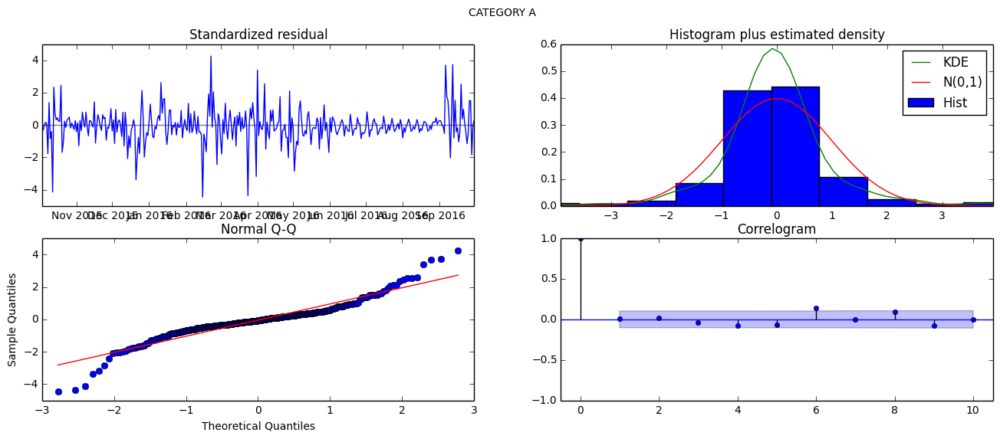

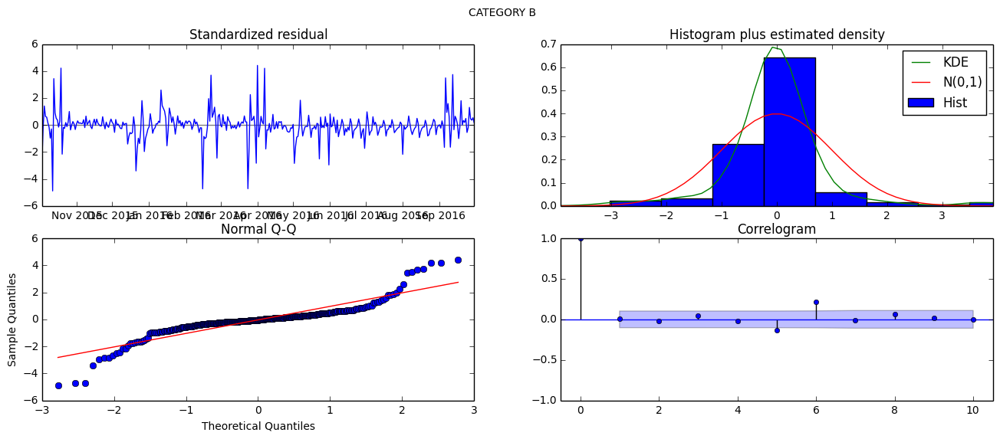

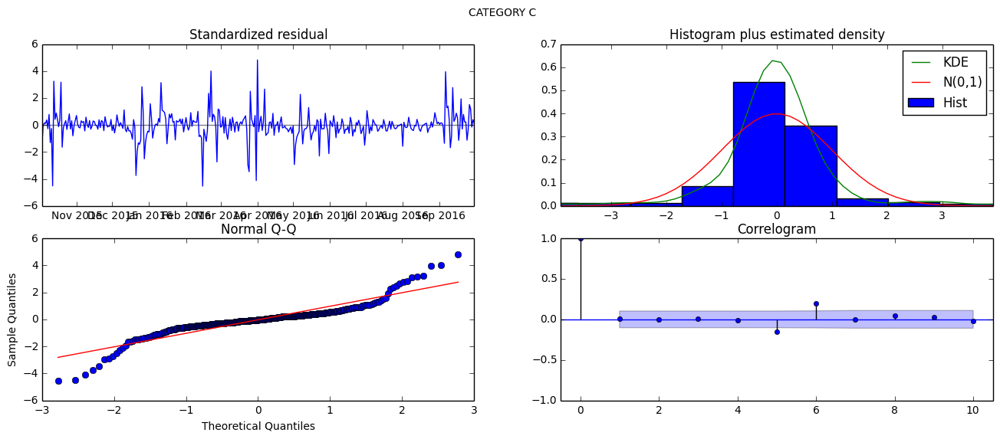

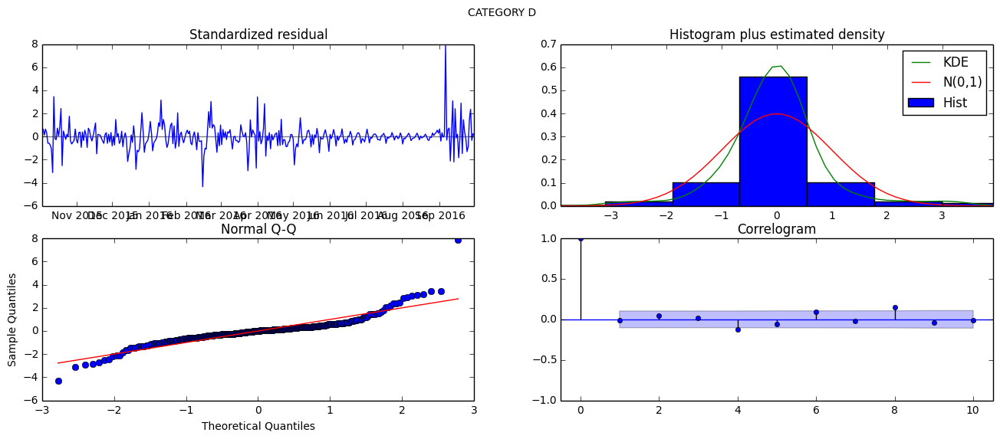

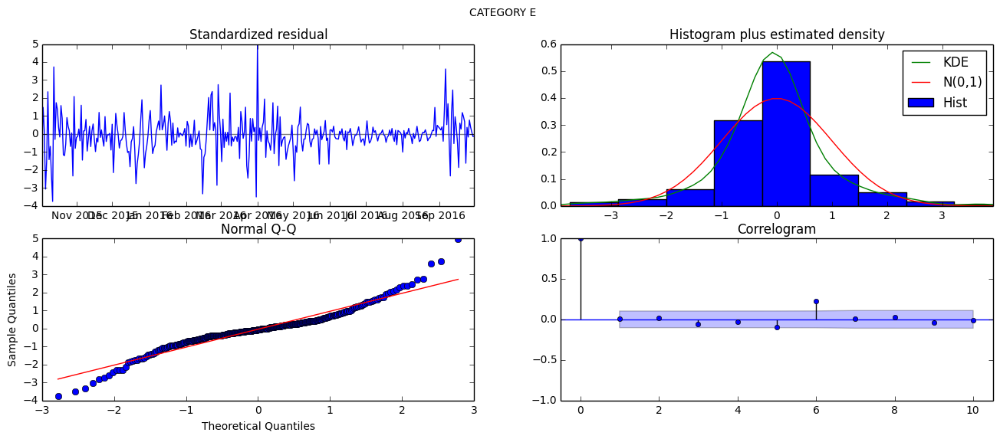

...

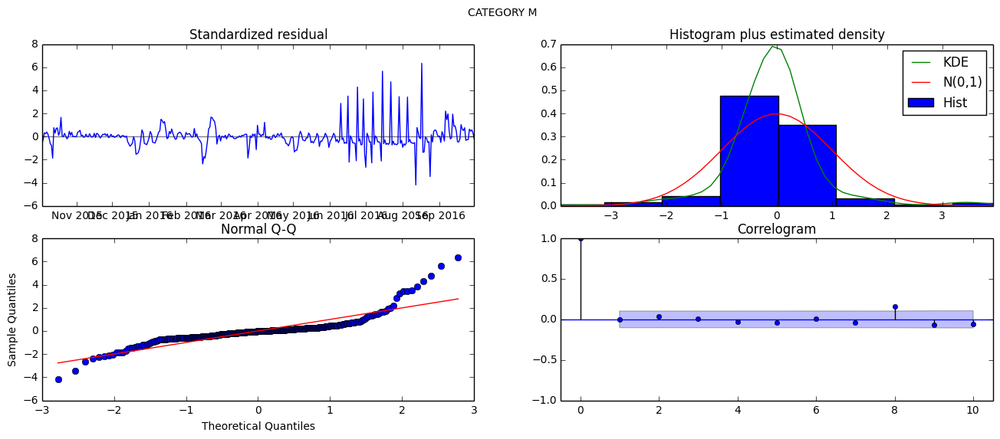

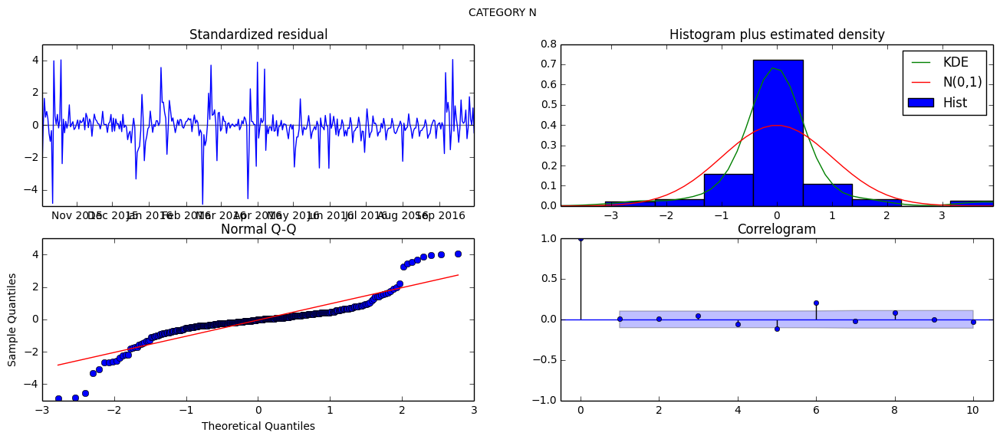

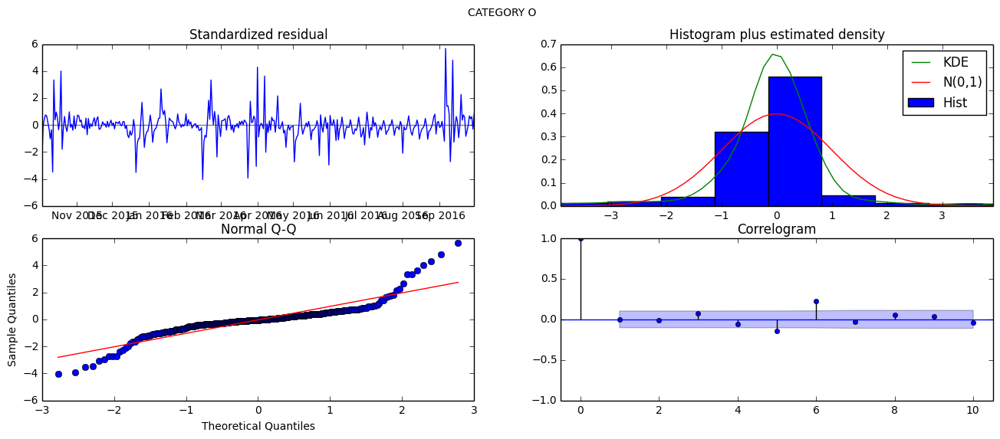

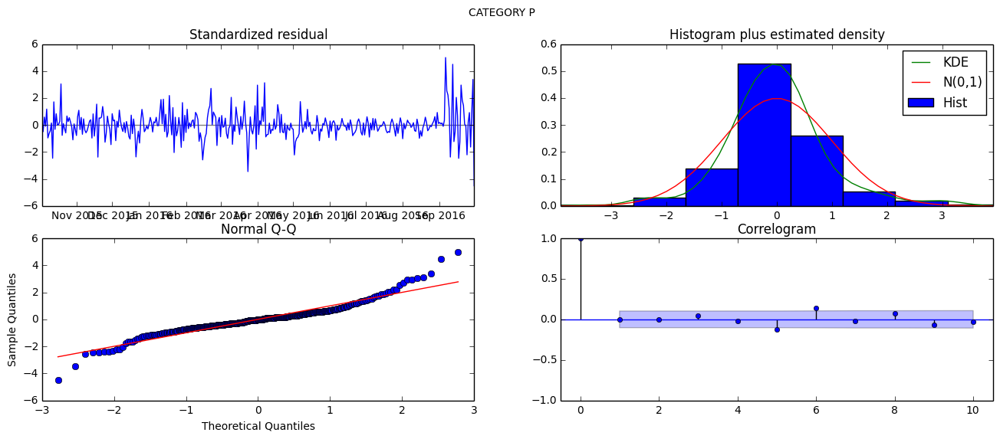

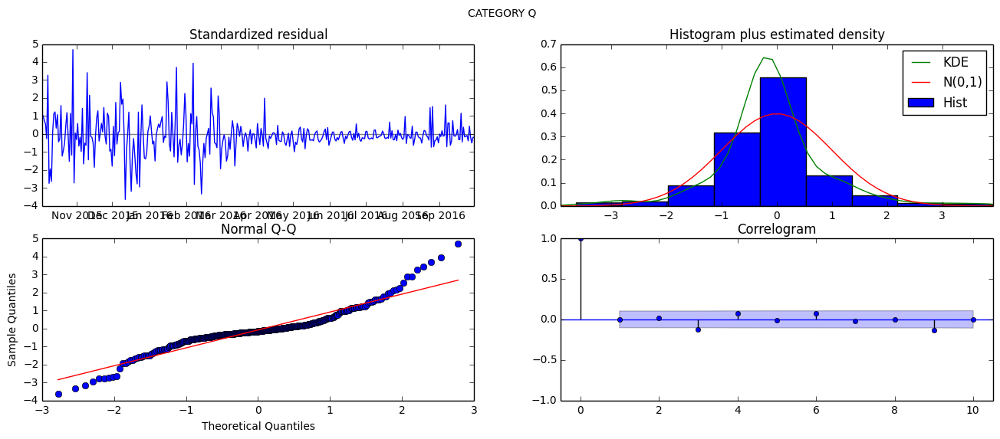

In [170]:
def diagnostic_plot(timeseries, item):
    timeseries.plot_diagnostics()
    plt.suptitle('CATEGORY {}'.format(item))

_ = map(diagnostic_plot, results_obs, temp_list)

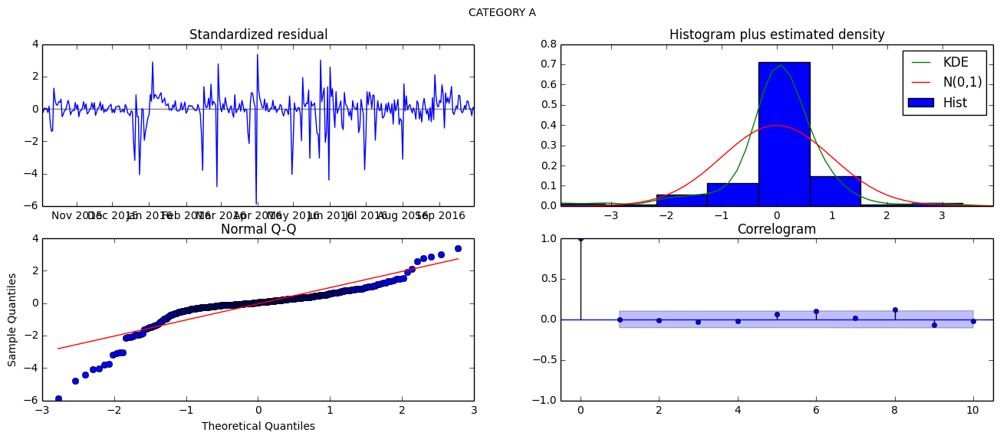

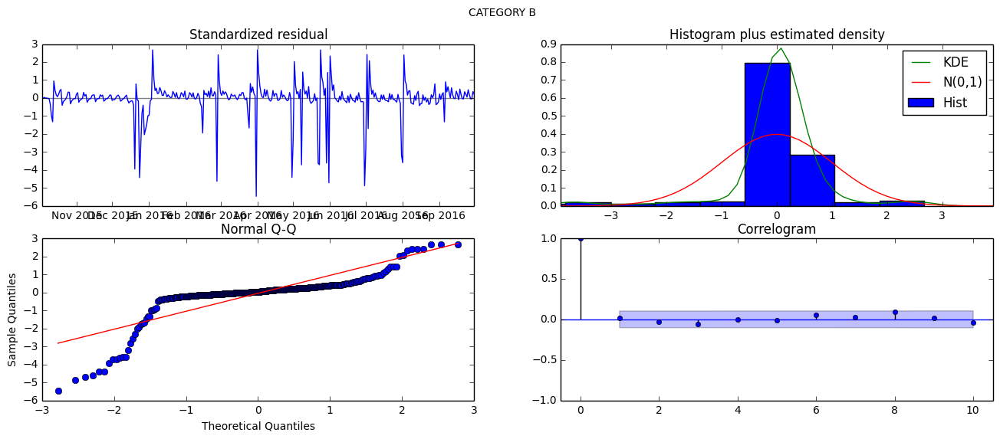

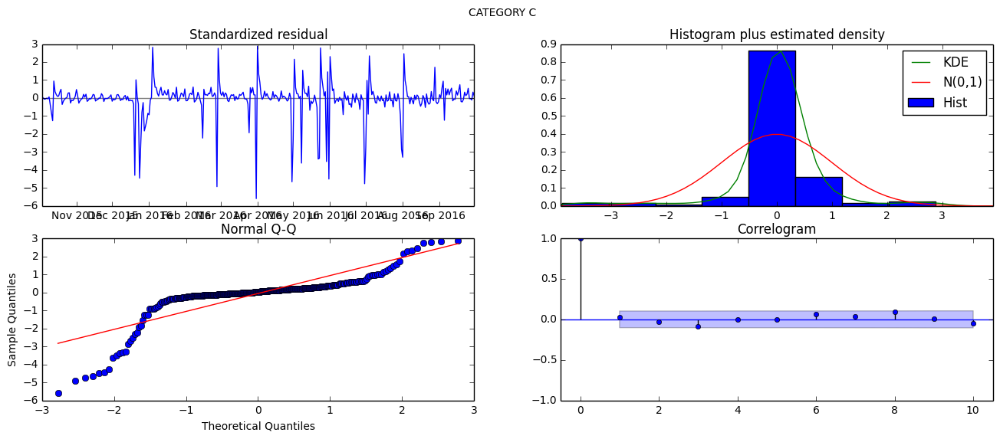

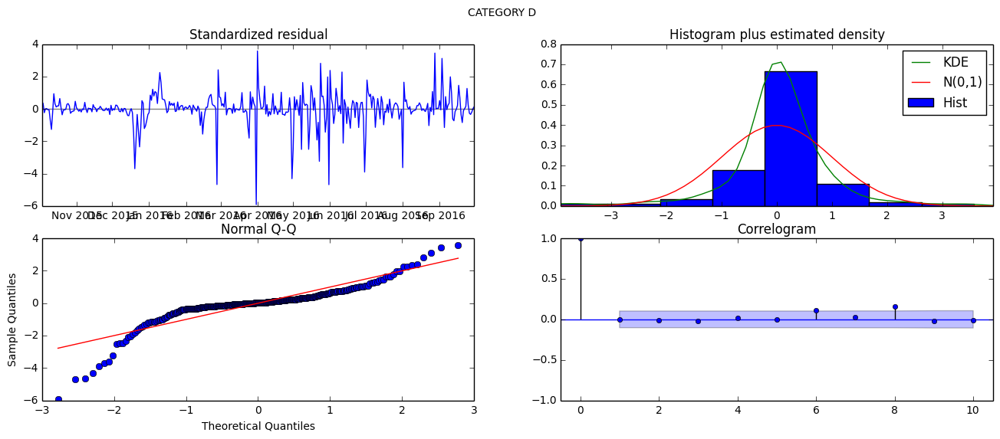

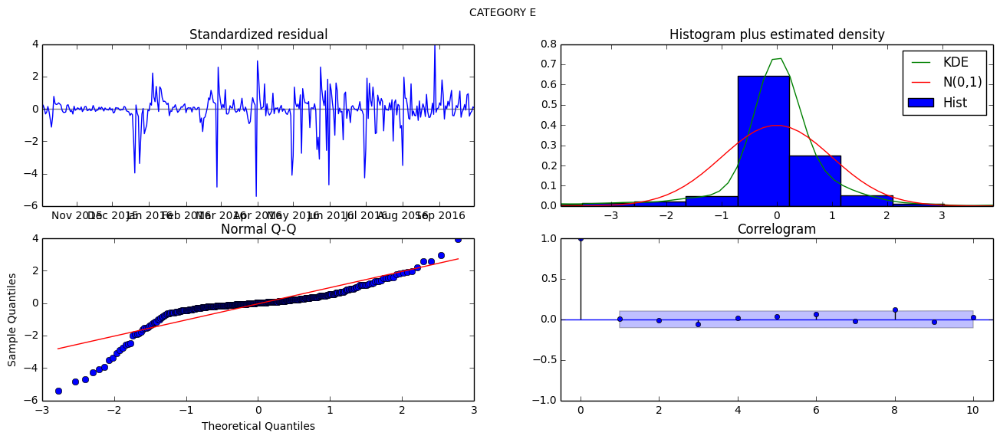

...

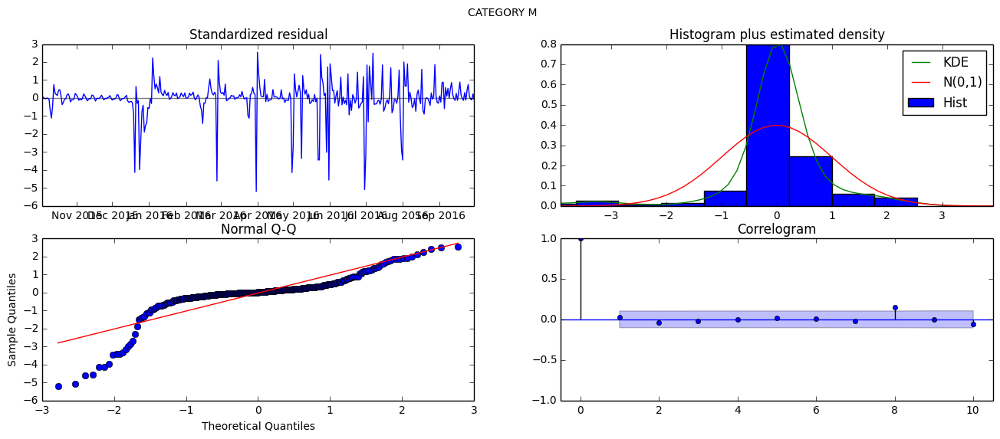

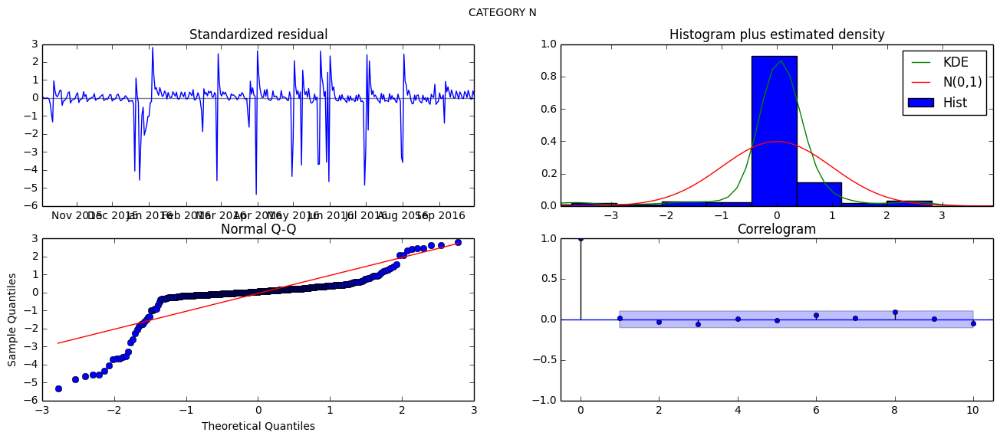

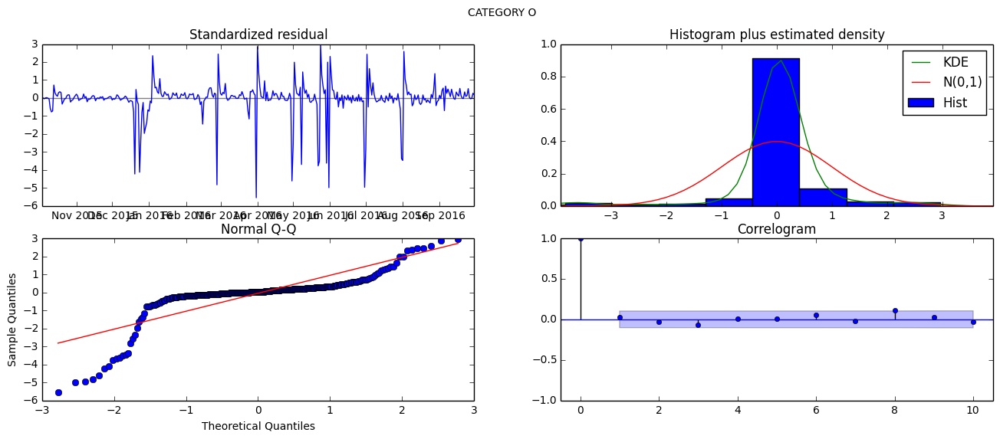

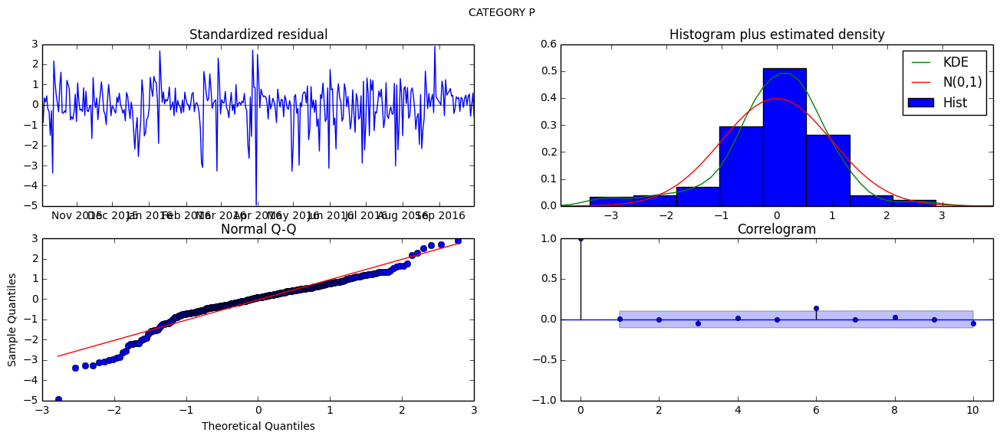

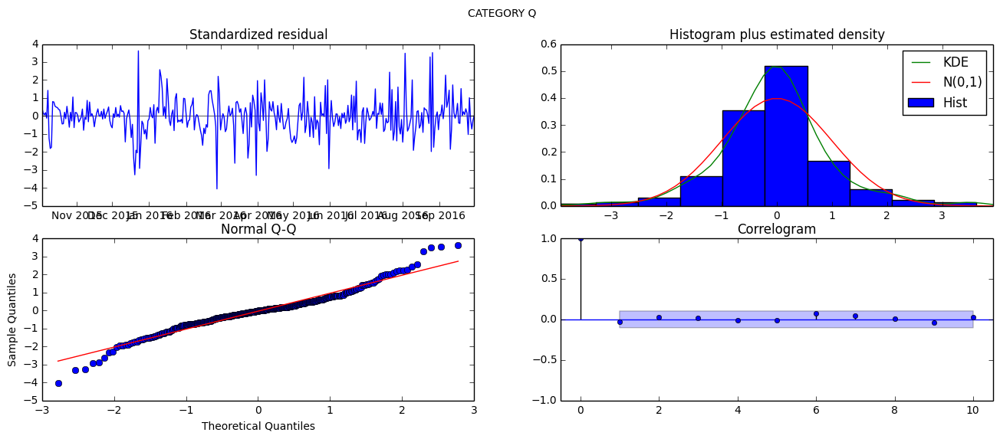

In [171]:
_ = map(diagnostic_plot, results_log, temp_list)

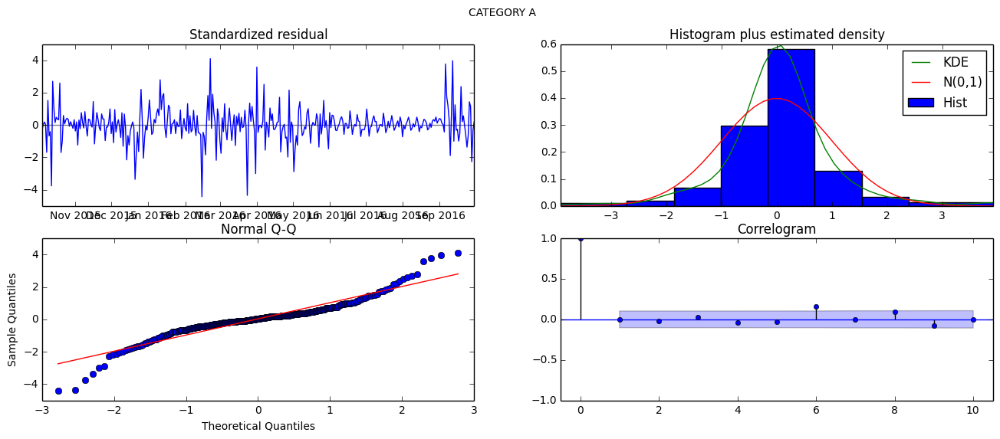

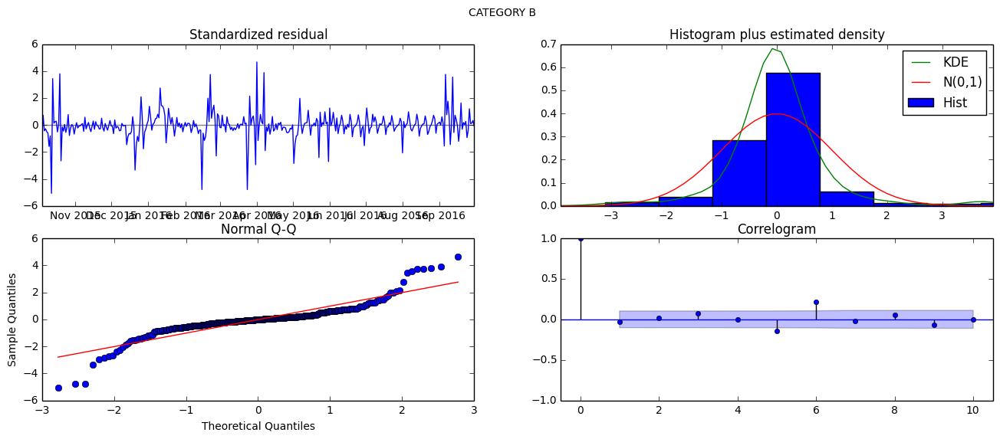

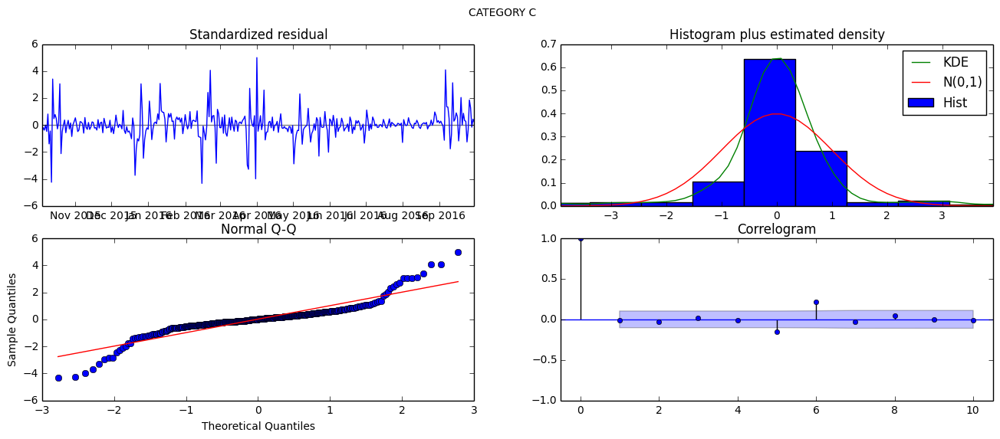

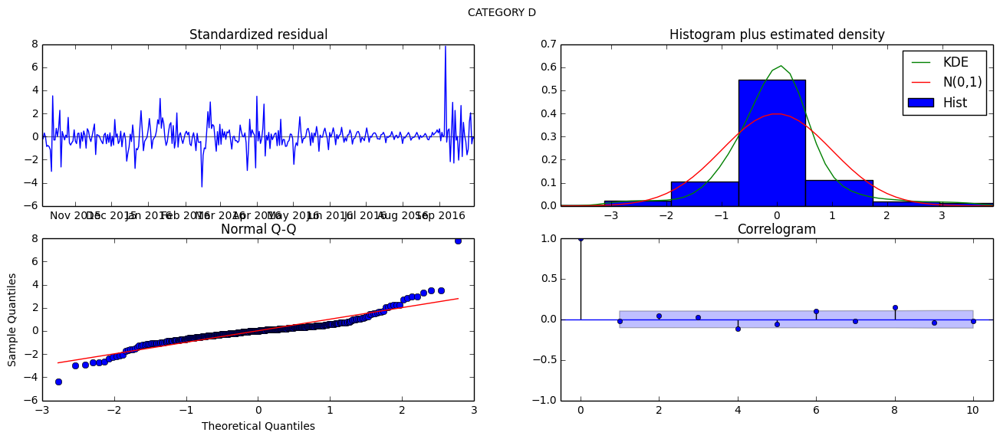

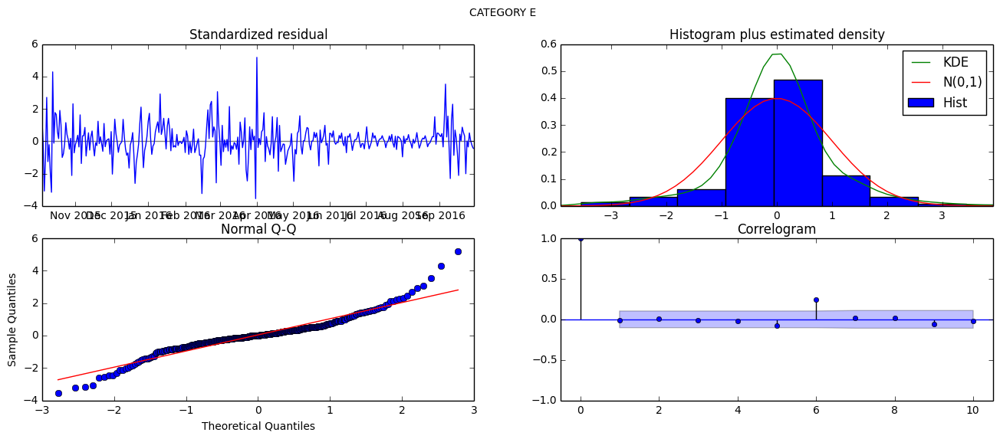

...

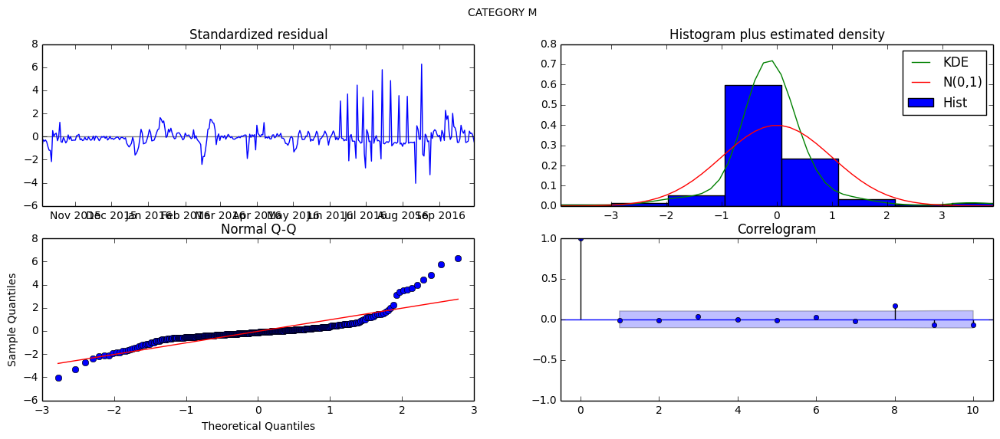

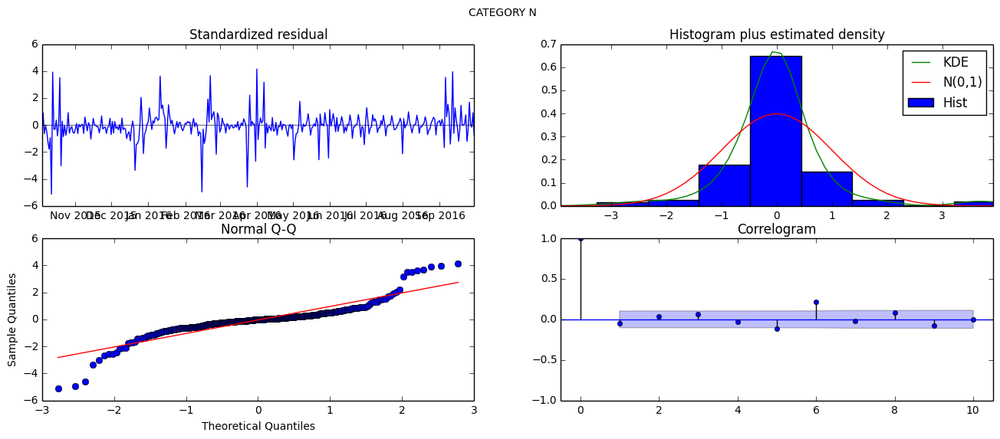

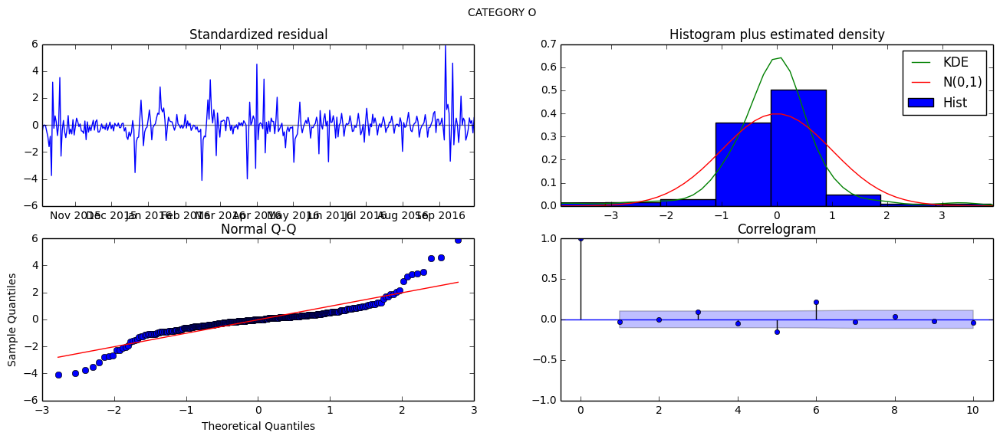

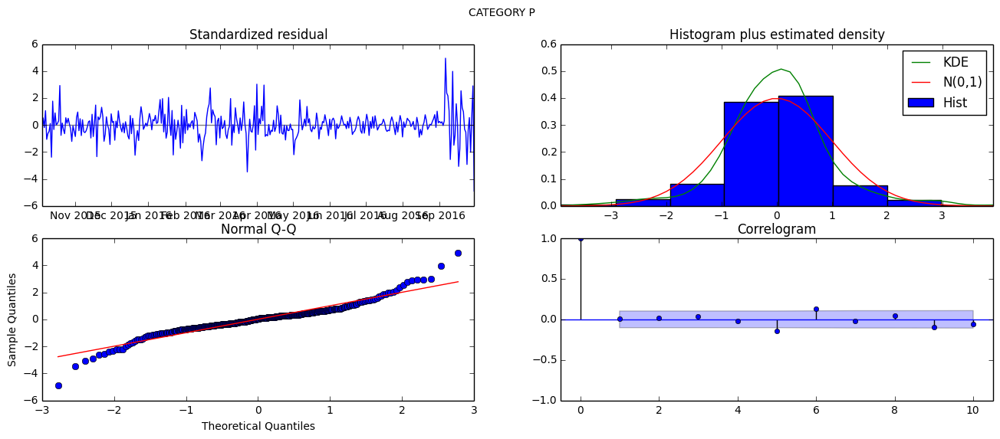

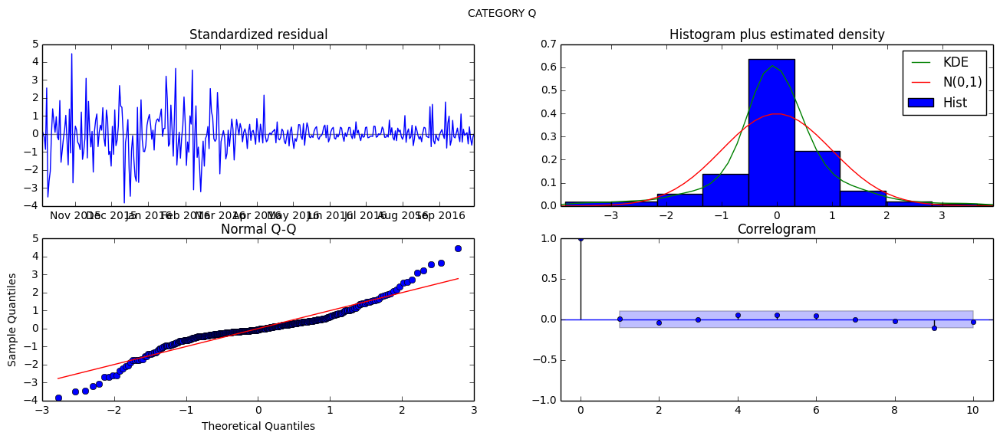

In [215]:
_ = map(diagnostic_plot, results_obs_one, temp_list)

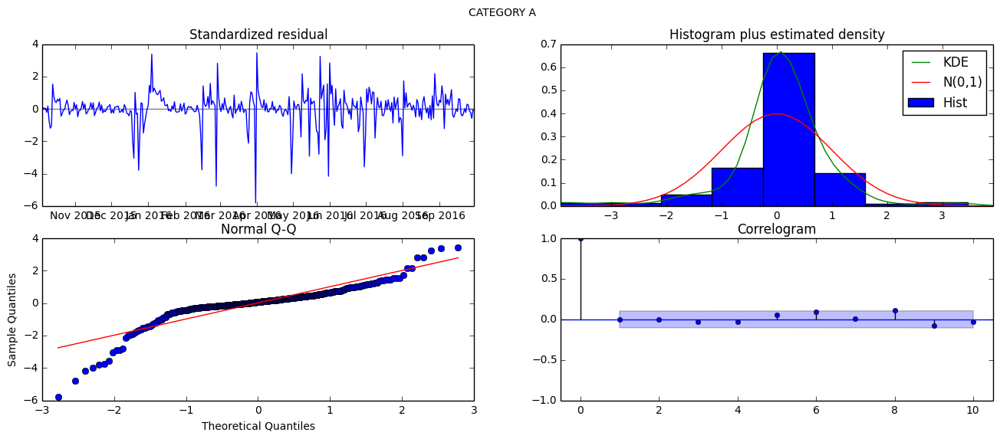

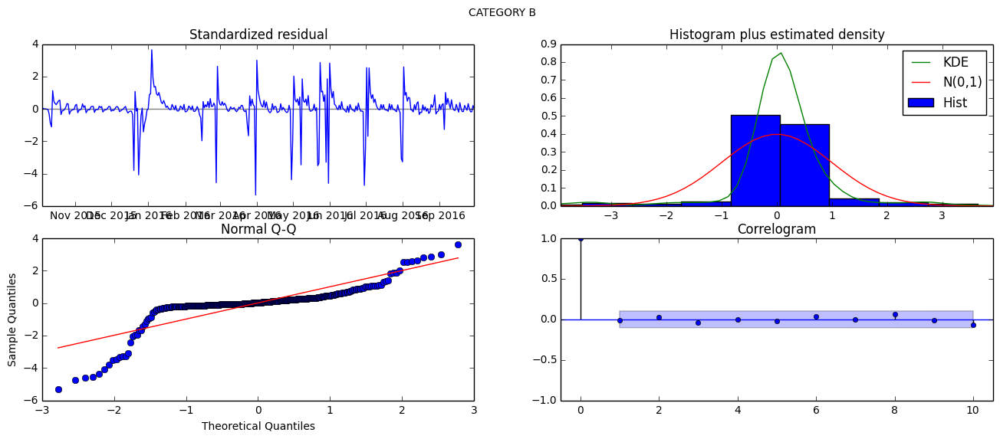

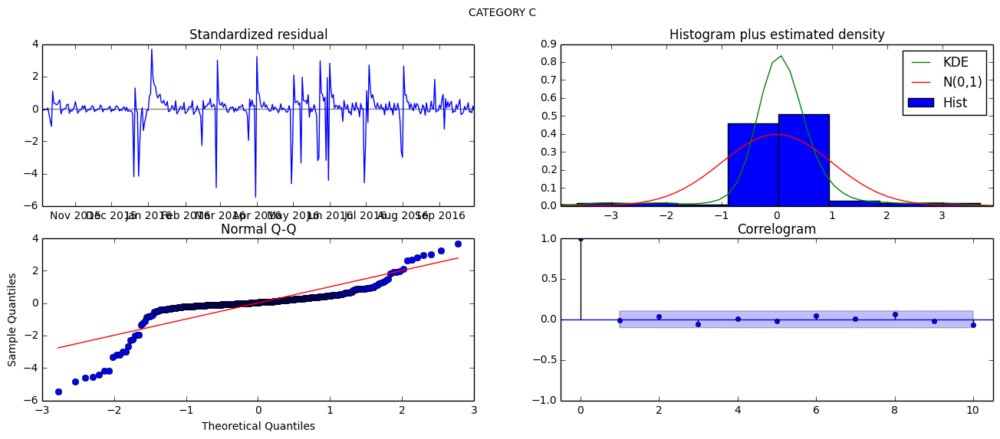

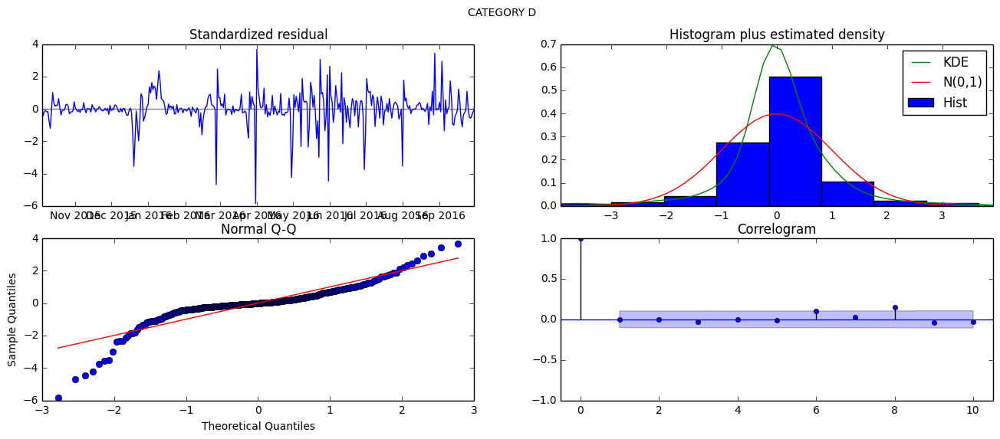

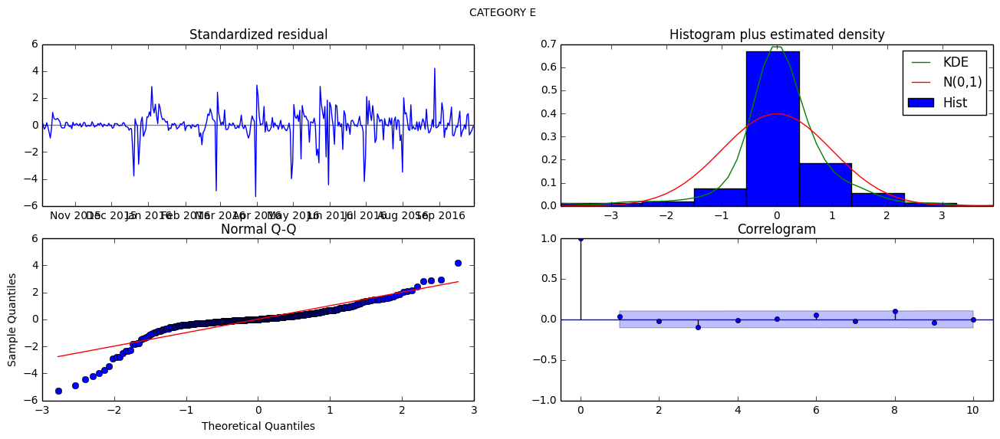

...

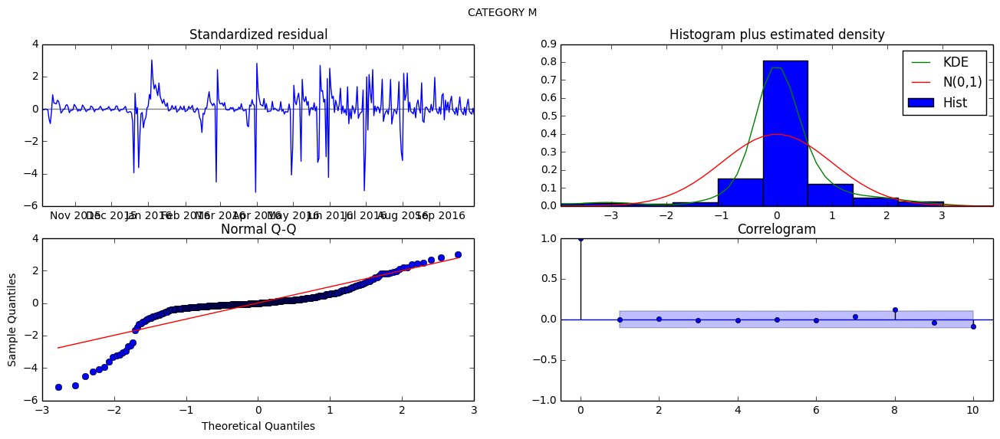

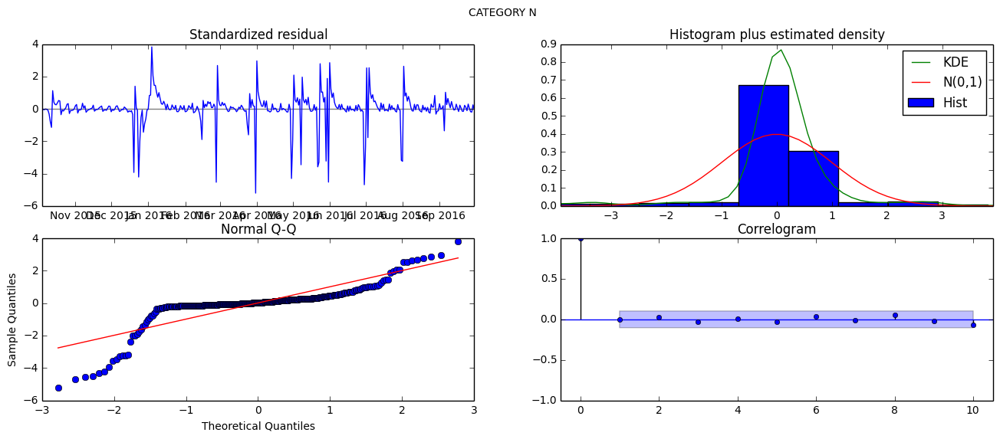

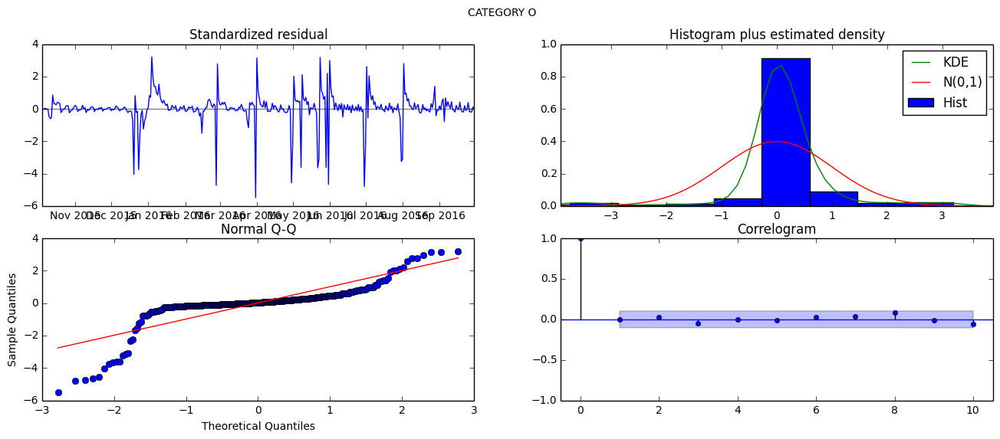

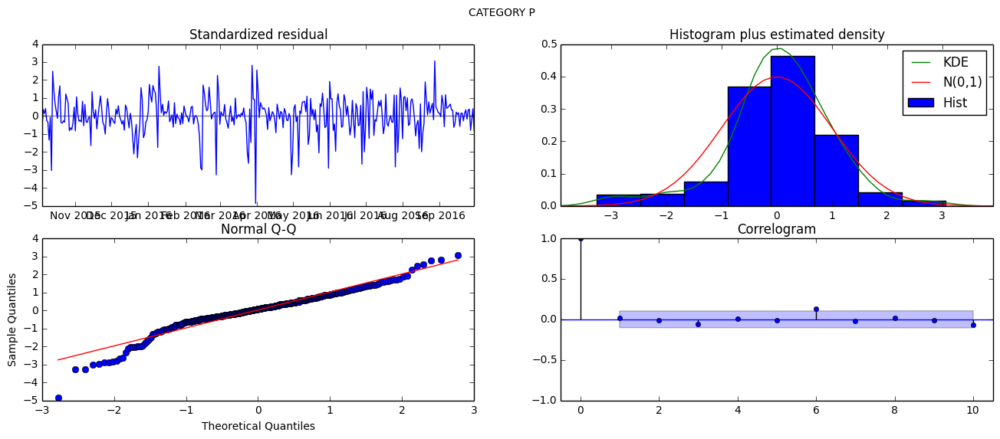

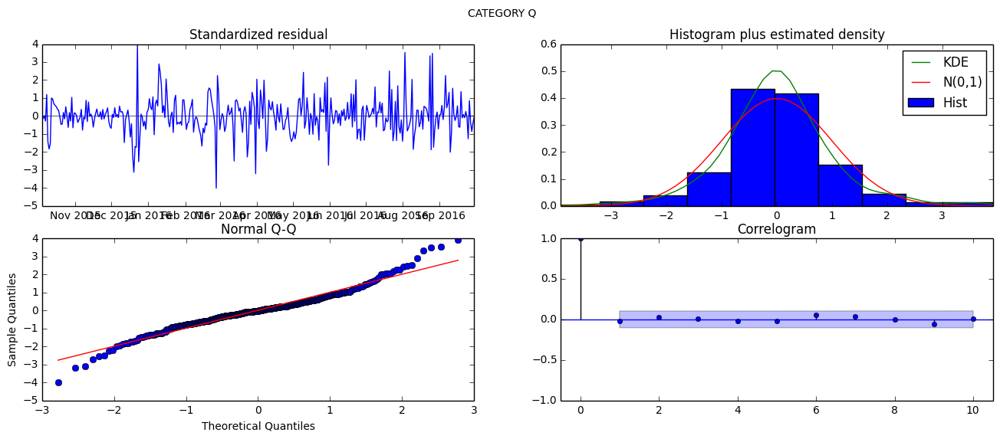

In [224]:
_ = map(diagnostic_plot, results_log_one, temp_list)

### The residuals plots mostly look good. Let's move on to forecasting.

# Step 6) Prediction In Sample, and 90 Days Ahead
### - We will plot the forecast for each category
### - Plot the relative contribution from each category
### - Add them up and plot the total forecast
### - Measure the RMSE
### - We will also build a separate model and forecast using top-down approach for comparison (what we did so far is bottom up)

In [274]:
def plot_forecast(results, timeseries, item, inv=True):
    if inv:
        pred = np.sinh(results.predict())
        forecast_90 = np.sinh(results.forecast(steps=90))
    else:    
        pred = results.predict()
        forecast_90 = results.forecast(steps=90)


#     pred.plot(label='predict')
    forecast_90.plot(label='forecast')
    timeseries.plot(label='original')
    plt.title(' Category {} Forecast '.format(item))
    plt.legend()
    plt.show(block=False)
    
    return pred

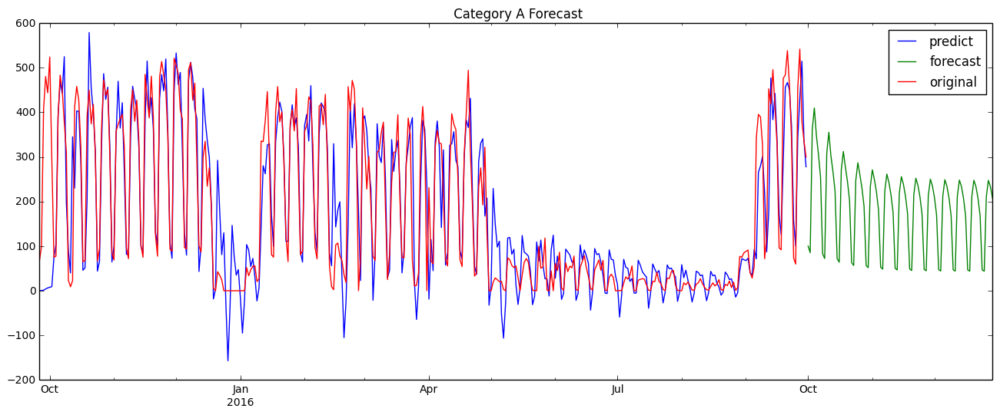

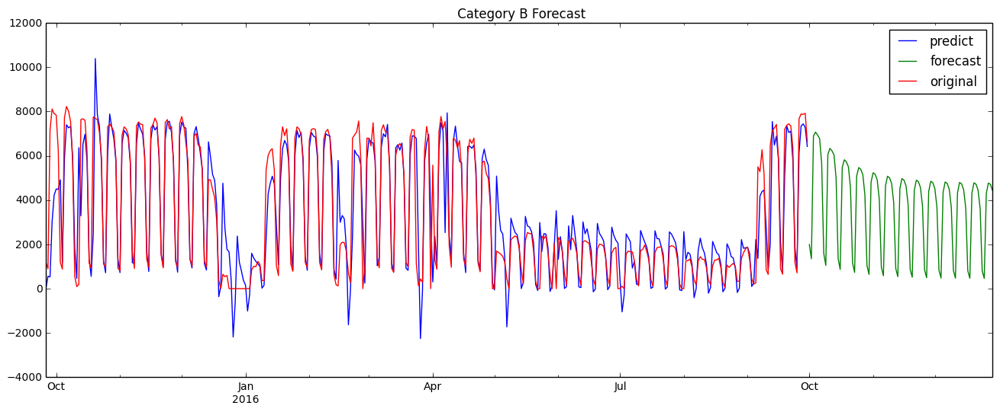

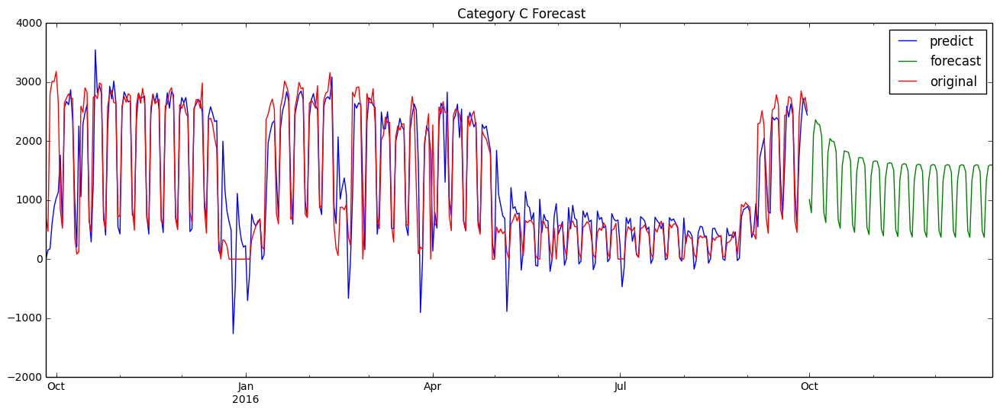

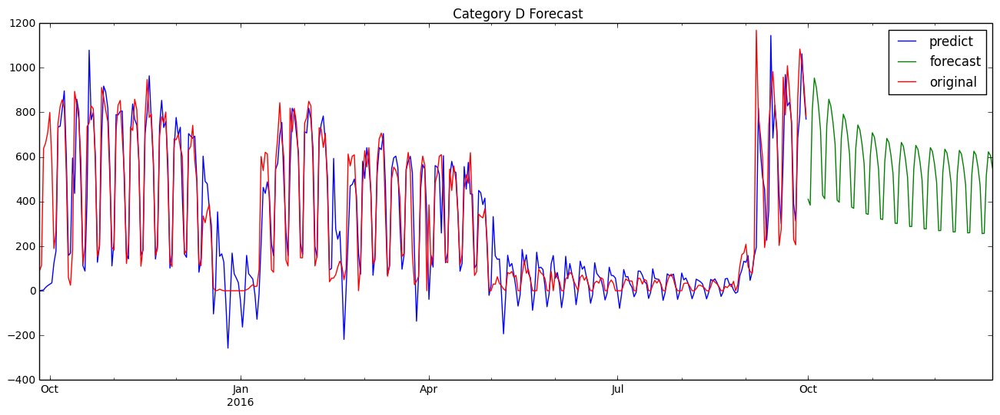

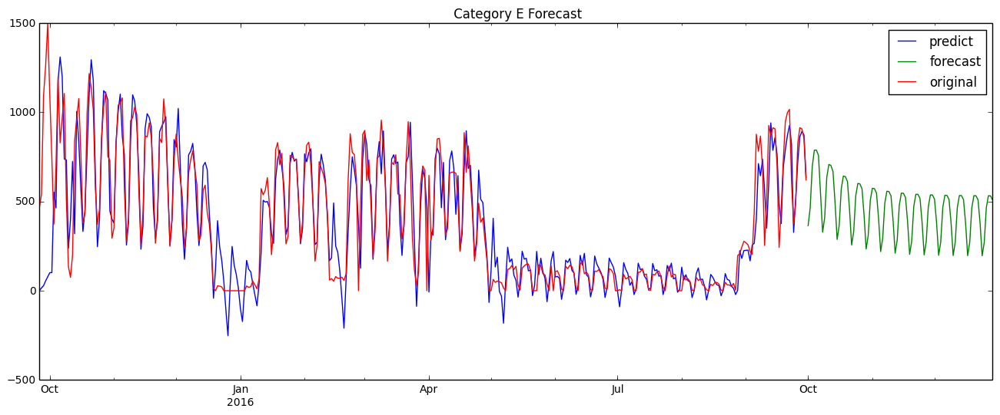

...

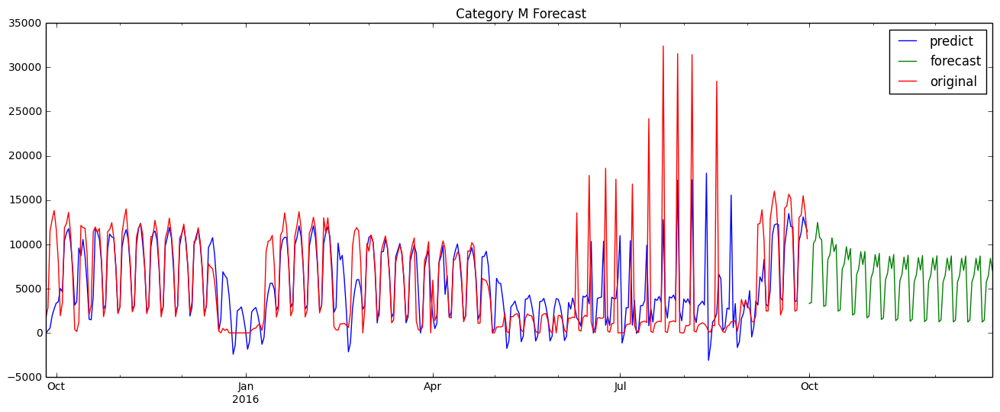

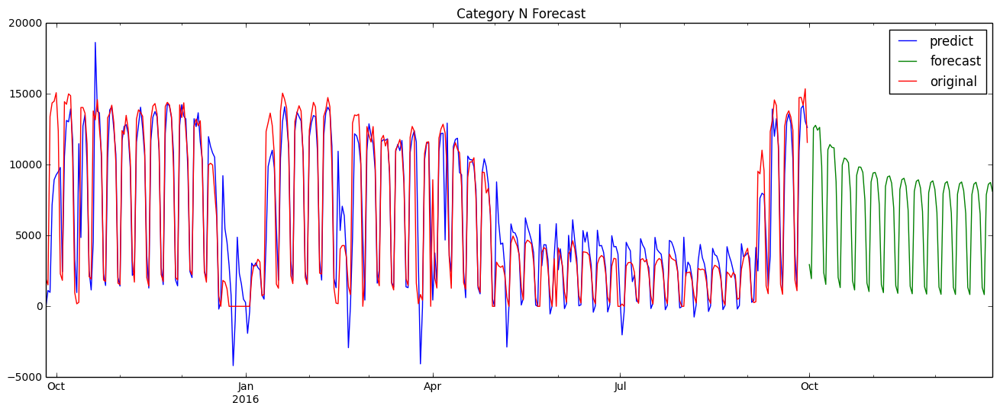

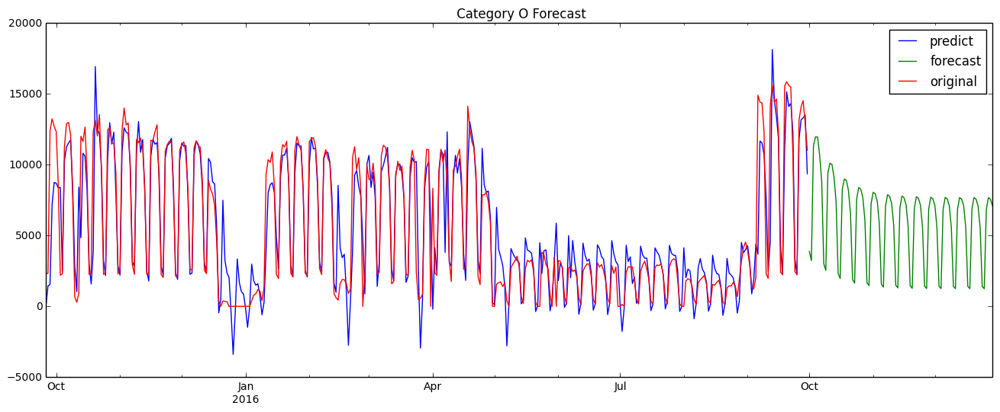

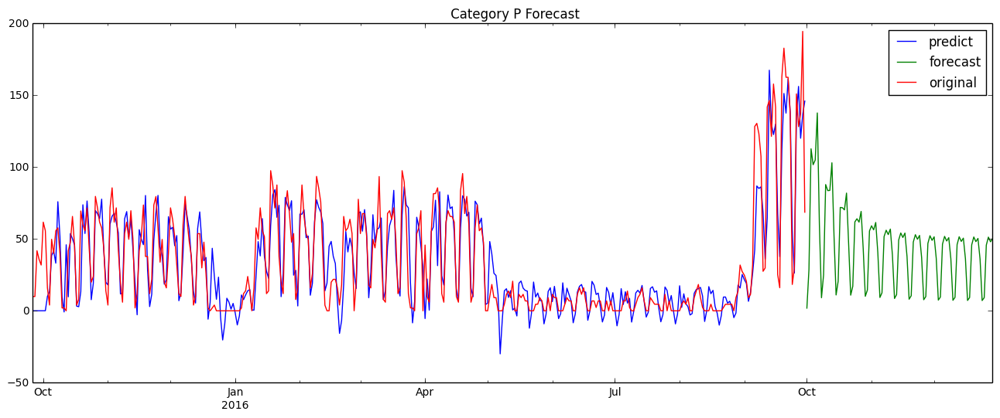

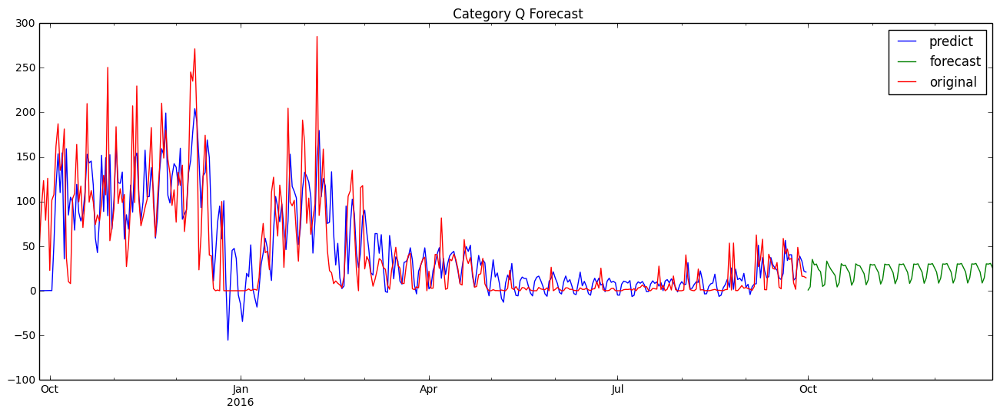

In [179]:
pred_obs = map(plot_forecast, results_obs, splitted_data, temp_list)

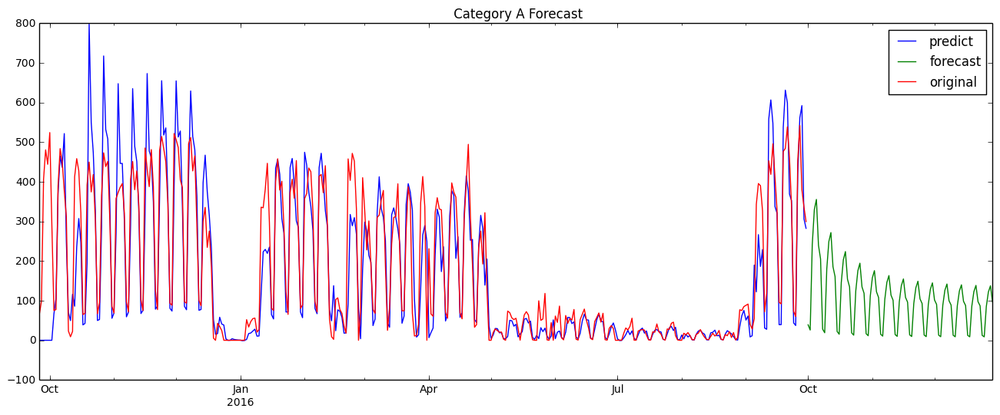

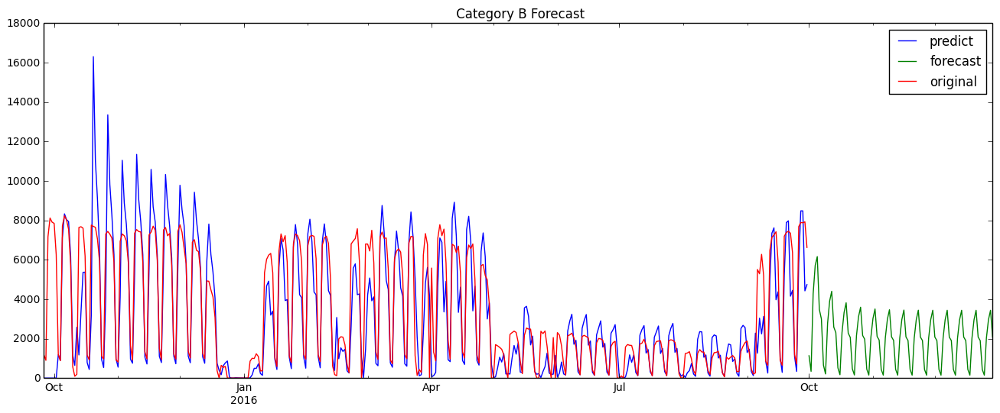

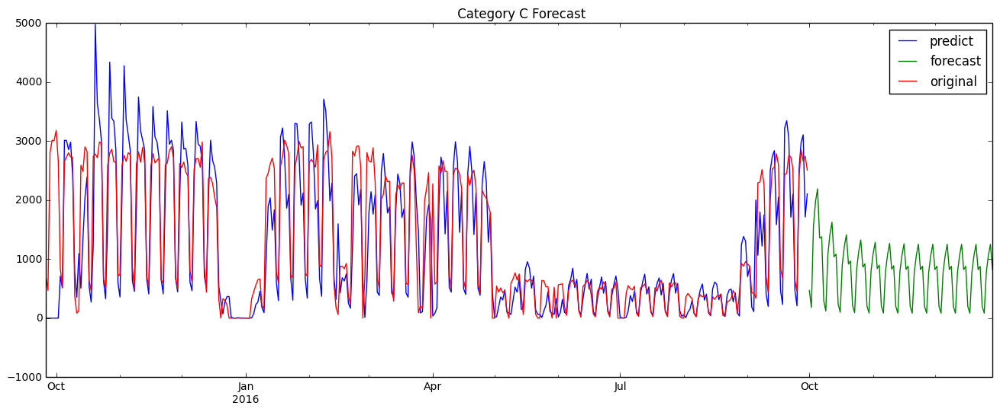

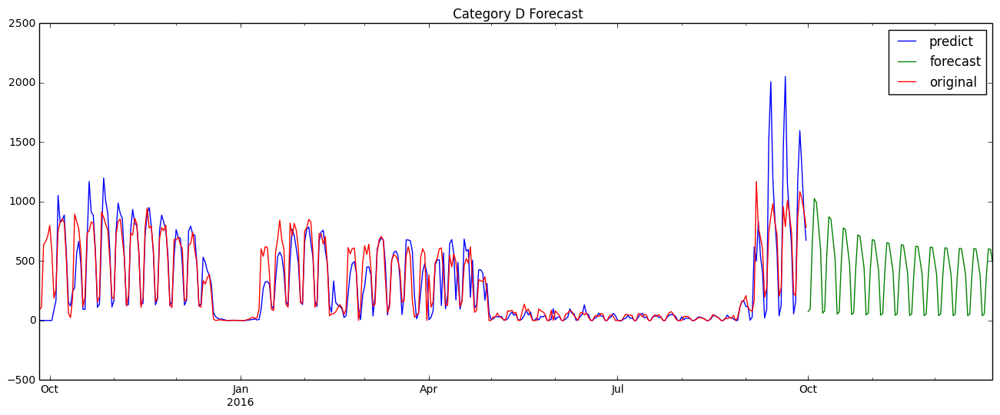

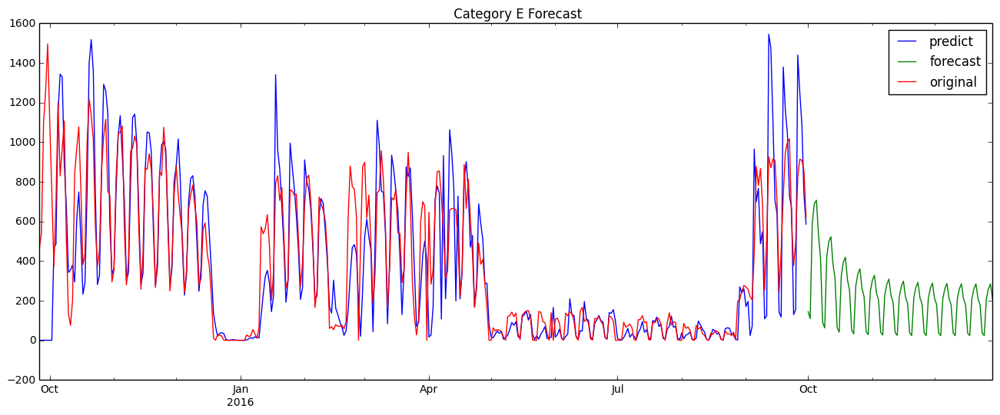

...

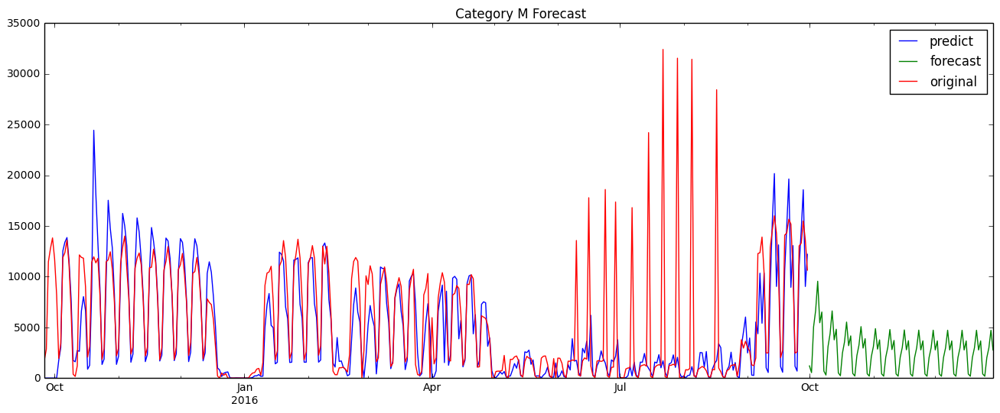

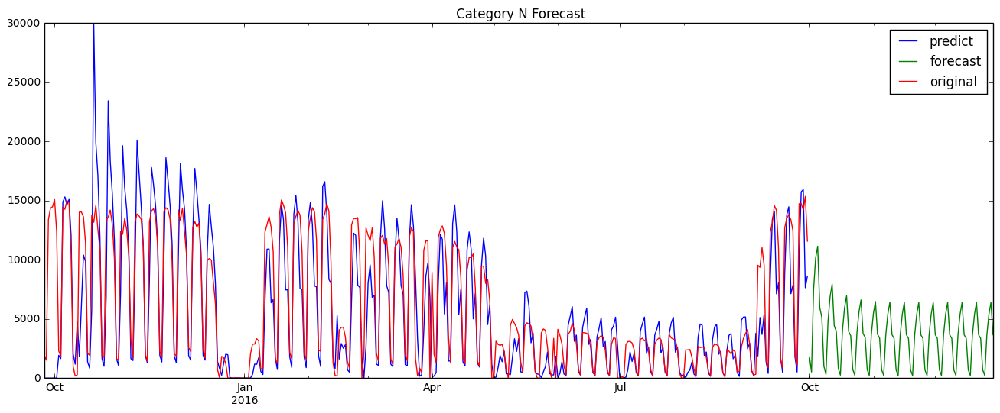

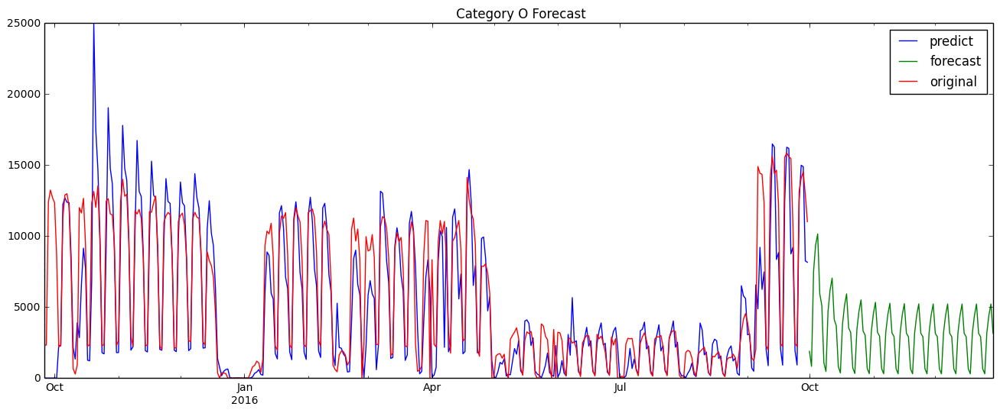

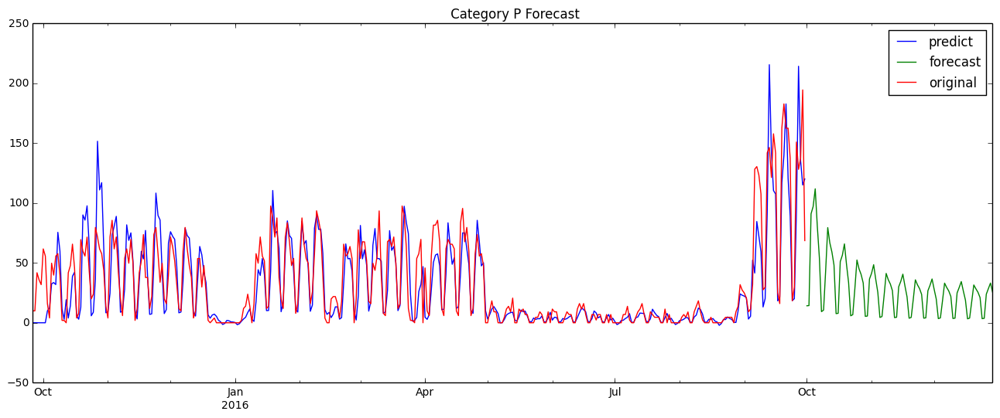

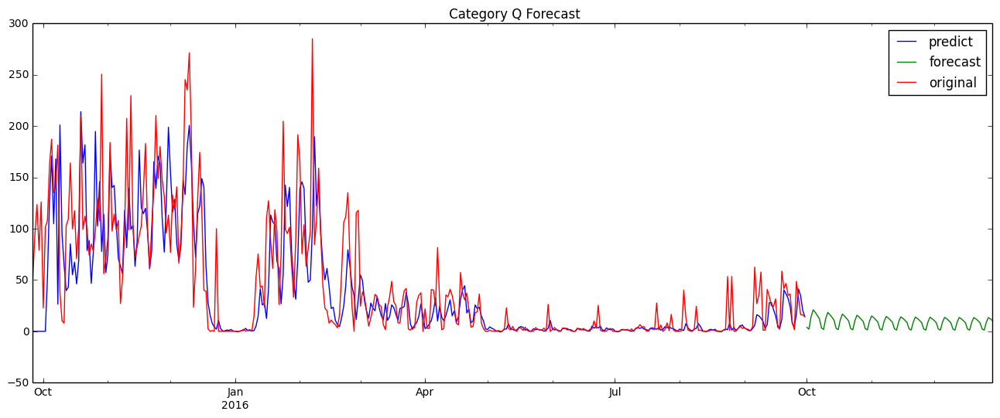

In [185]:
pred_log = map(plot_forecast, results_log, splitted_data, temp_list)

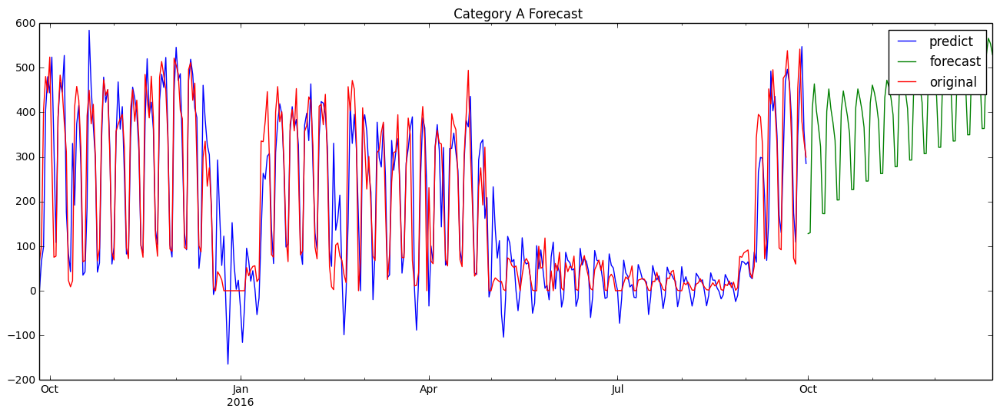

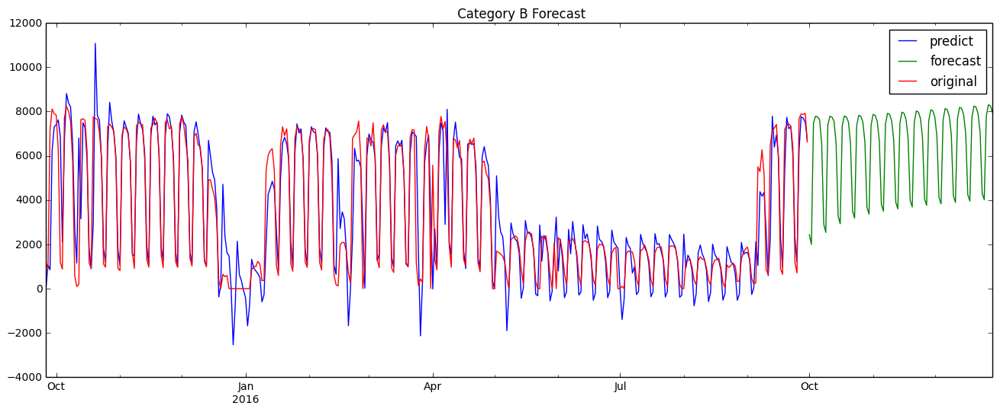

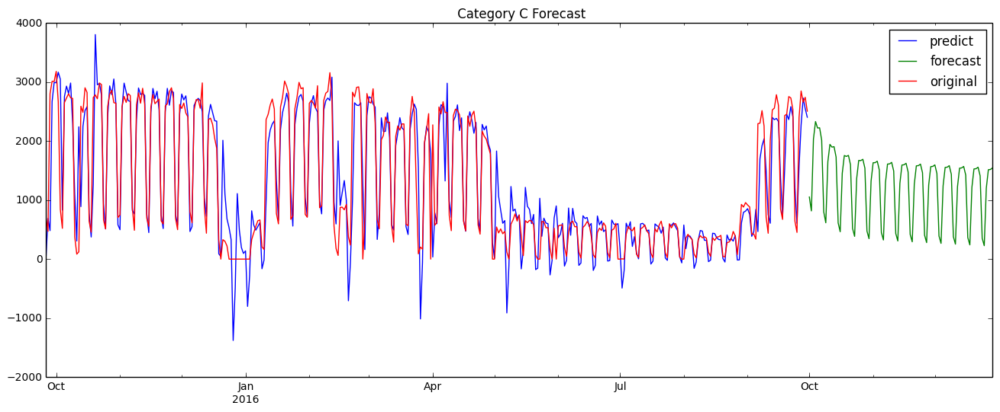

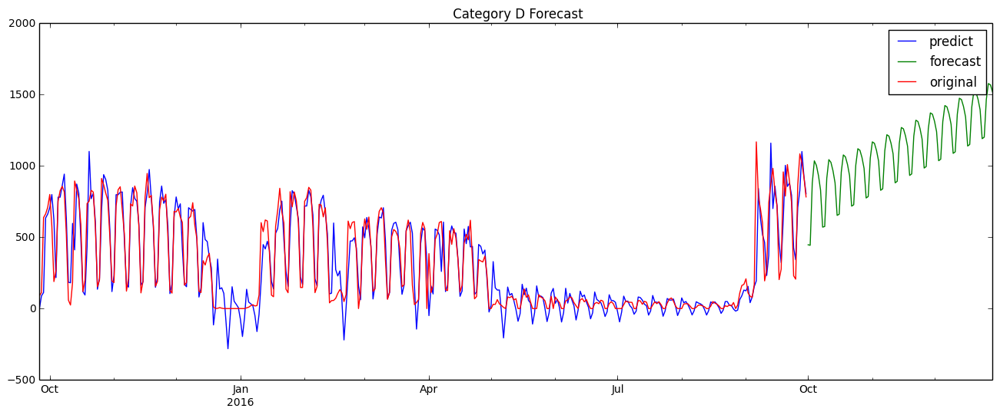

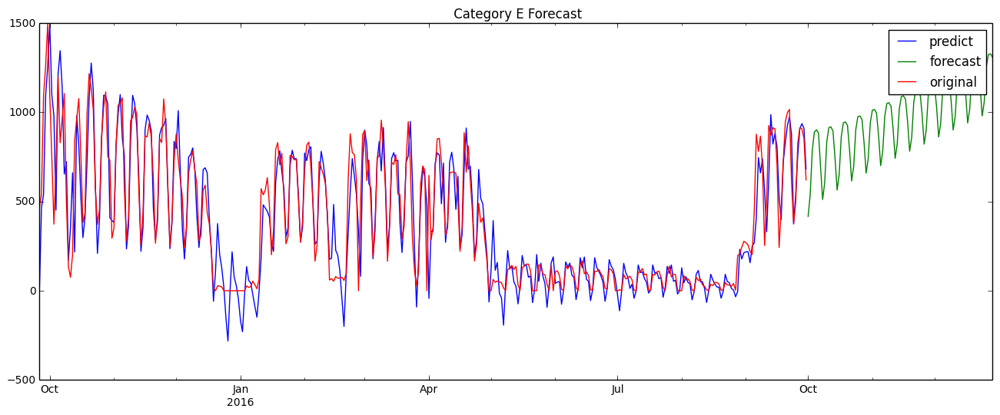

...

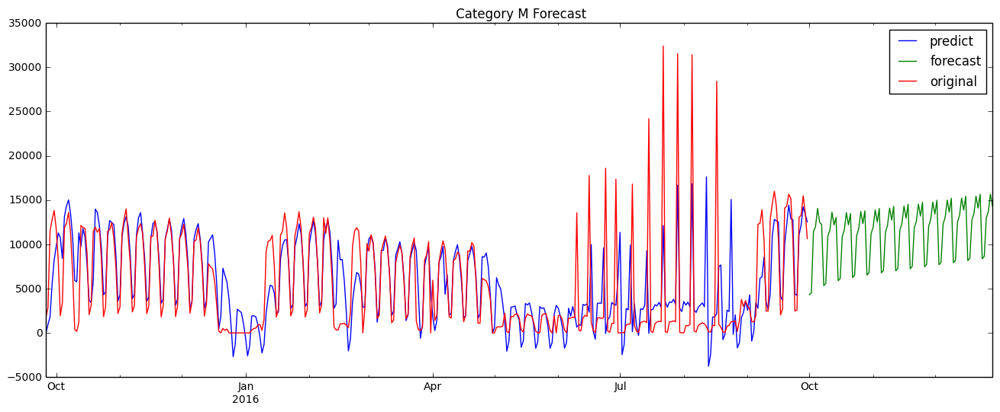

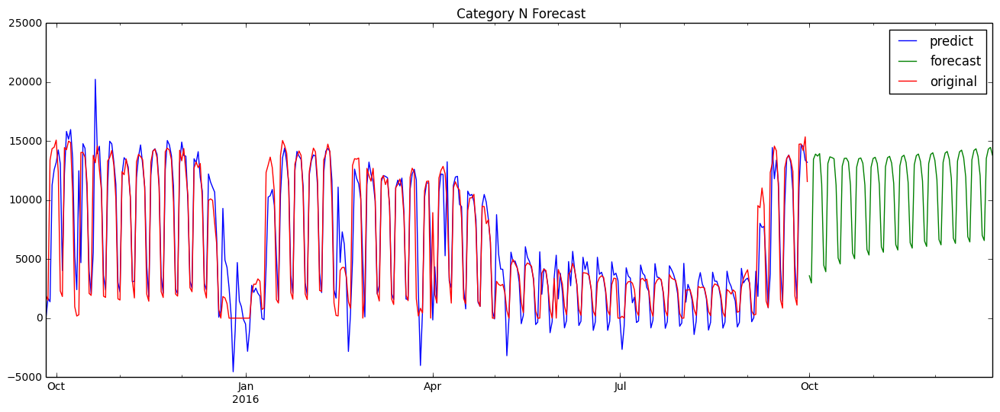

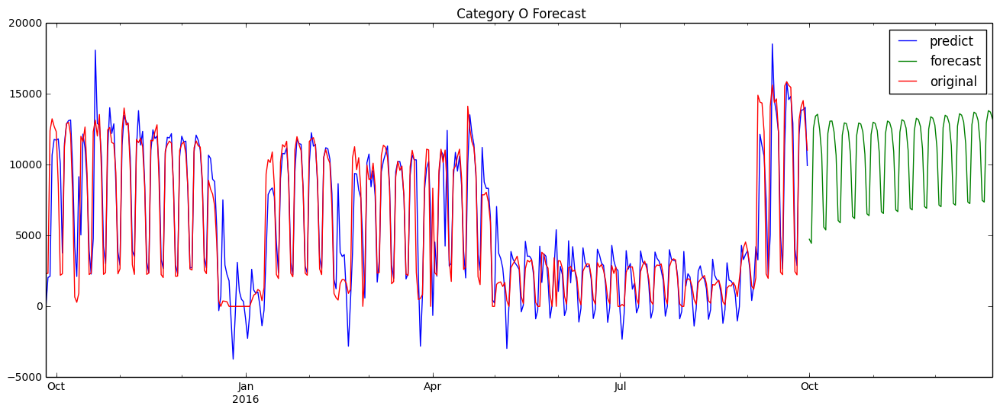

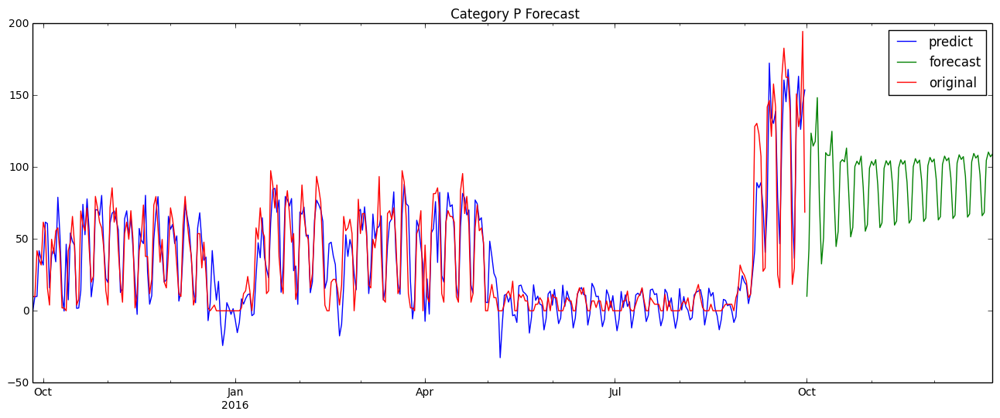

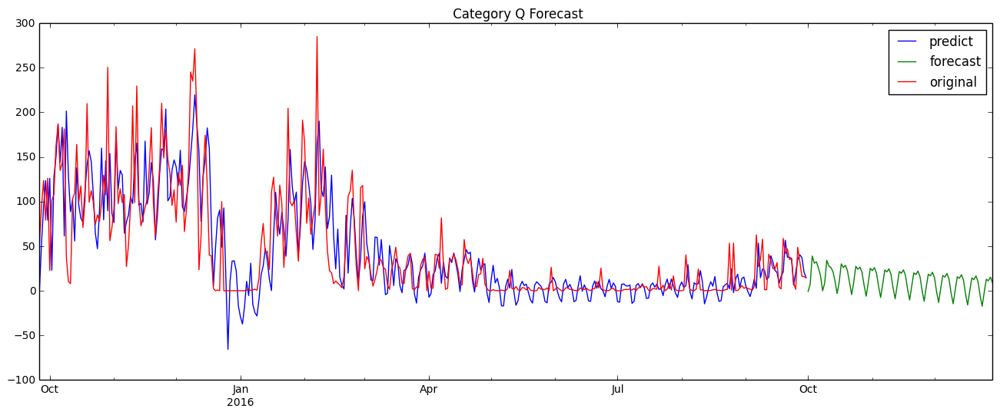

In [216]:
pred_obs_one = map(plot_forecast, results_obs_one, splitted_data, temp_list)

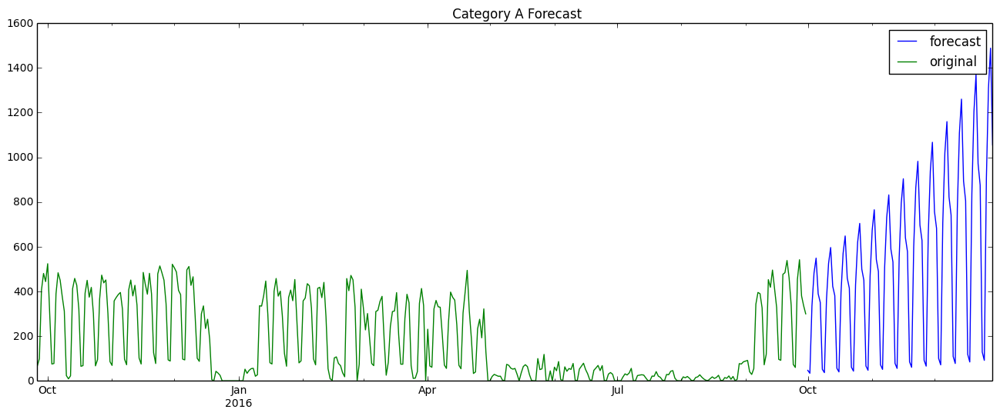

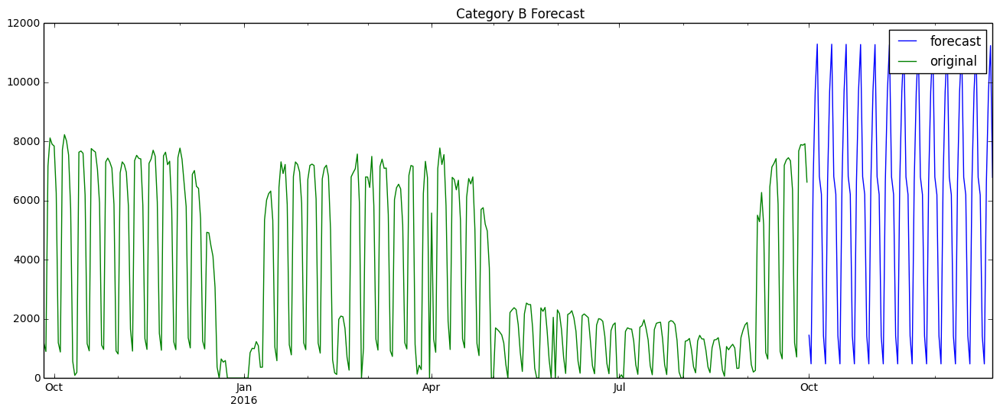

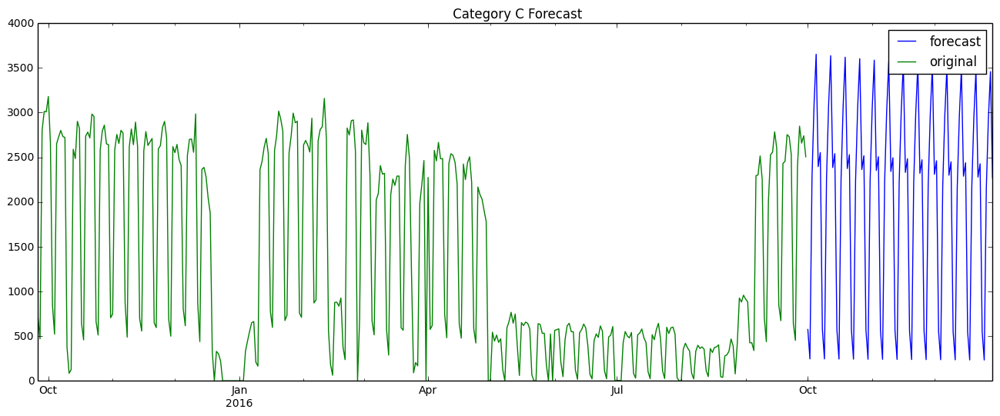

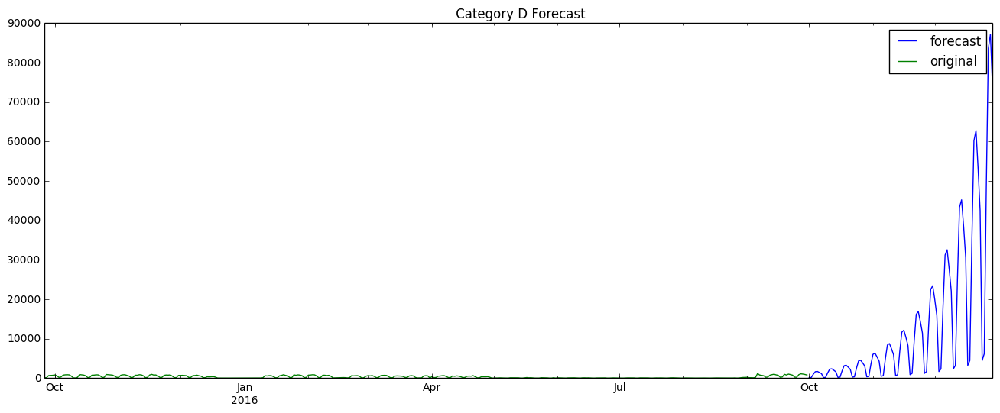

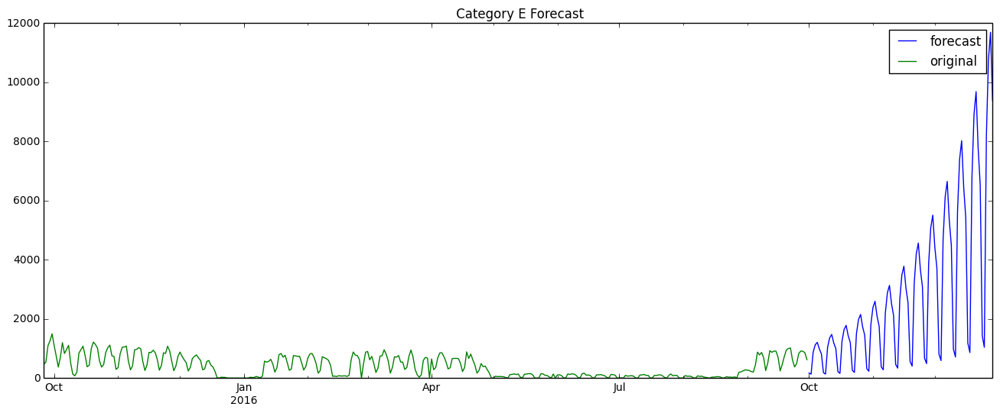

...

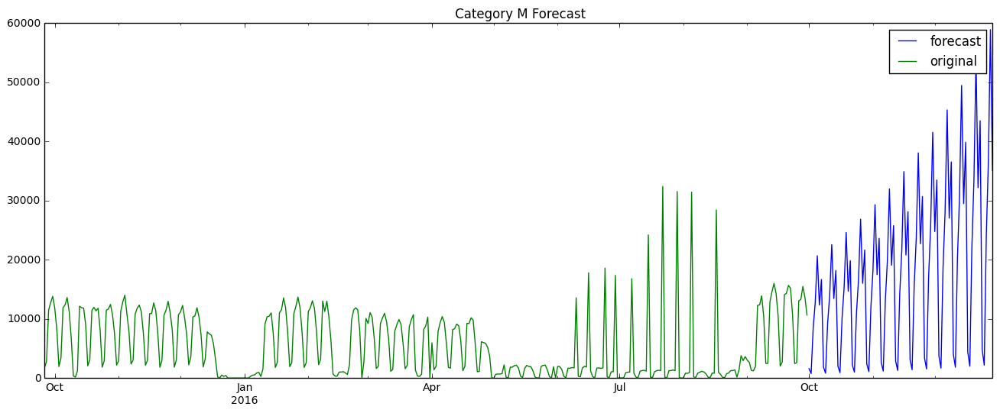

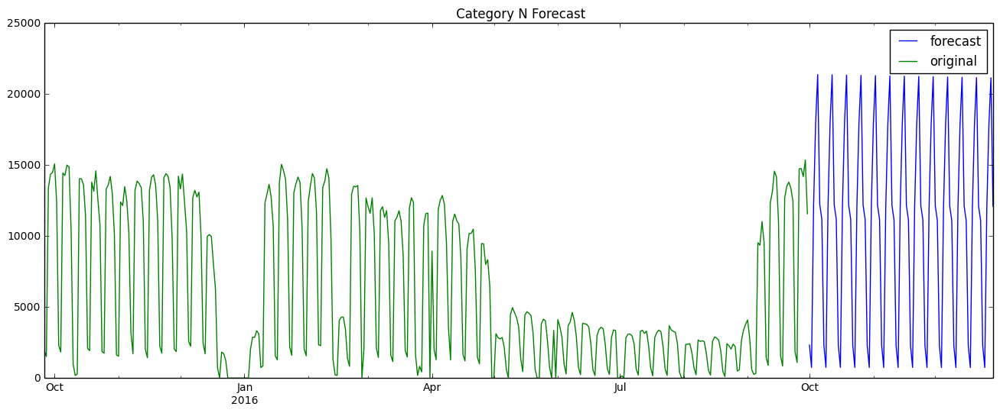

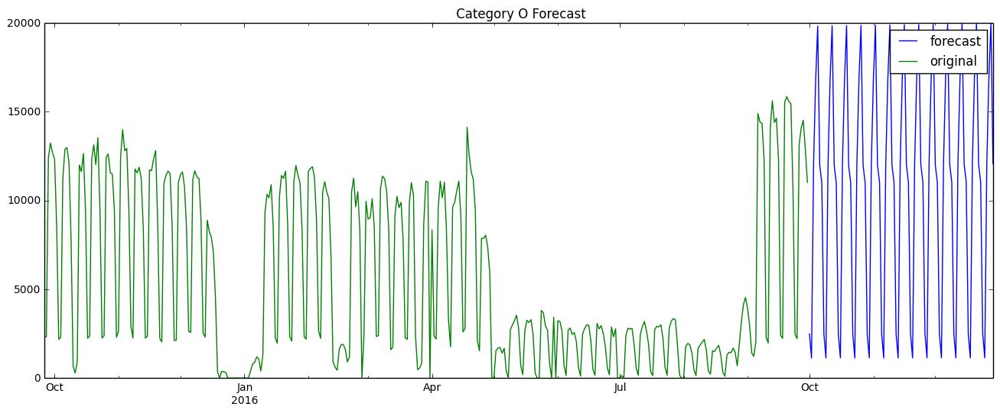

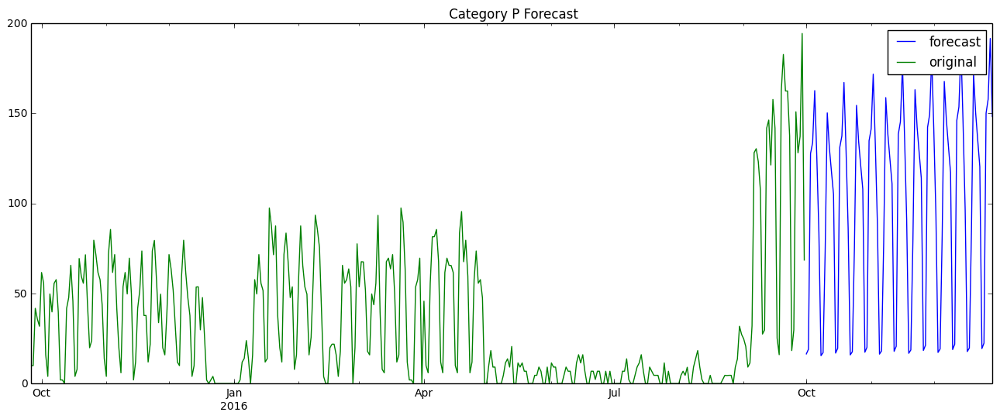

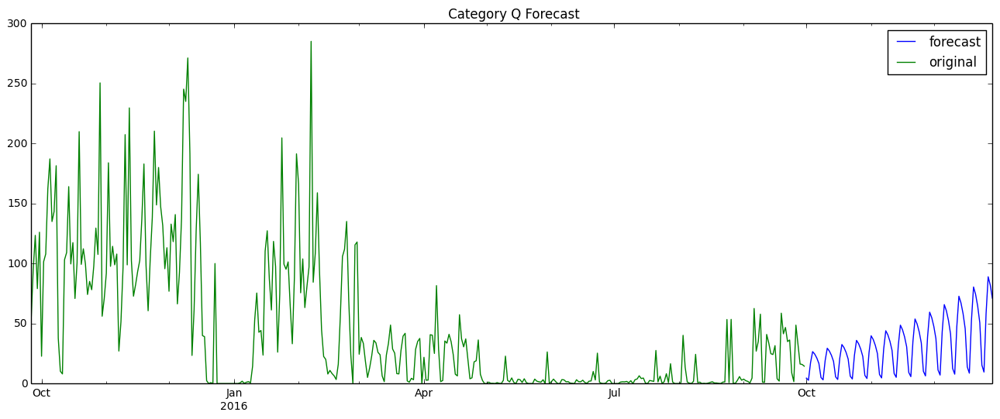

In [275]:
pred_log_one = map(plot_forecast, results_log_one, splitted_data, temp_list)

In [186]:
# Report performance
def rmse_measurement(timeseries, pred, item):
    mse = mean_squared_error(timeseries, pred)
    rmse = sqrt(mse)
#     print('Category {} - RMSE: %.3f'.format(item) % rmse)
    return rmse

In [228]:
rmse_total_obs = map(rmse_measurement, splitted_data, pred_obs, temp_list)
rmse_total_log = map(rmse_measurement, splitted_data, pred_log, temp_list)
rmse_total_obs_one = map(rmse_measurement, splitted_data, pred_obs_one, temp_list)
rmse_total_log_one = map(rmse_measurement, splitted_data, pred_log_one, temp_list)

In [229]:
print 'Total RMSE Obs: ', np.sum(rmse_total_obs)
print 'Total RMSE Log: ', np.sum(rmse_total_log)
print 'Total RMSE Obs One: ', np.sum(rmse_total_obs_one)
print 'Total RMSE Log One: ', np.sum(rmse_total_log_one)

Total RMSE Obs:  17222.2592513
Total RMSE Log:  22448.144449
Total RMSE Obs One:  17051.8697665
Total RMSE Log One:  228504.466277


# Total Forecast

In [232]:
forecast_obs = map(lambda x: x.forecast(steps=90), results_obs)
forecast_log = map(lambda x: np.sinh(x.forecast(steps=90)), results_log)
forecast_obs_one = map(lambda x: x.forecast(steps=90), results_obs_one)
forecast_log_one = map(lambda x: np.sinh(x.forecast(steps=90)), results_log_one)

In [242]:
def sum_forecast(forecast_90, lab, original=True):
    total_forecast = pd.Series()
    original_sales = pd.Series()
    for i, df in enumerate(forecast_90):
        if i == 0:
            total_forecast = df
            original_sales = splitted_data[i]
        else:
            total_forecast = total_forecast + df
            original_sales = original_sales + splitted_data[i]
    
    if original:
        plt.plot(original_sales.index, original_sales, 'o-', label='Original')
    
    plt.plot(total_forecast.index, total_forecast, 'o-', label='{}'.format(lab))
    plt.legend(loc='lower left')
    return total_forecast

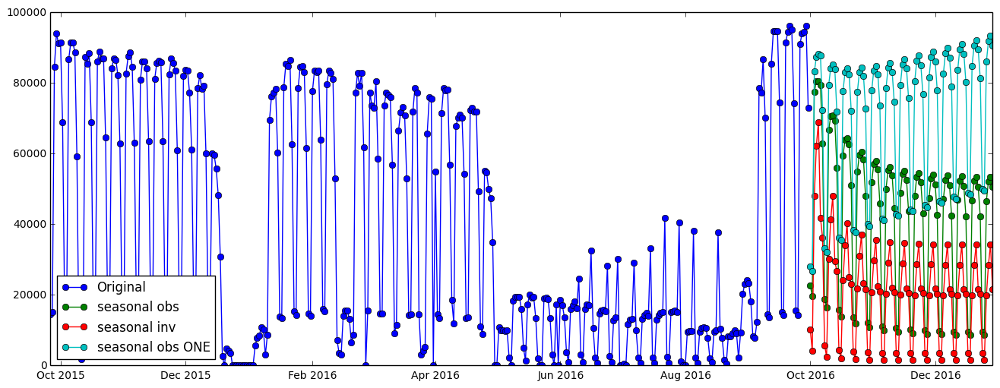

In [245]:
order_zero = sum_forecast(forecast_obs, 'seasonal obs')
_ = sum_forecast(forecast_log, 'seasonal inv', False)
order_one = sum_forecast(forecast_obs_one, 'seasonal obs ONE', False)
# _ = sum_forecast(forecast_log_one, 'seasonal inv ONE', False)

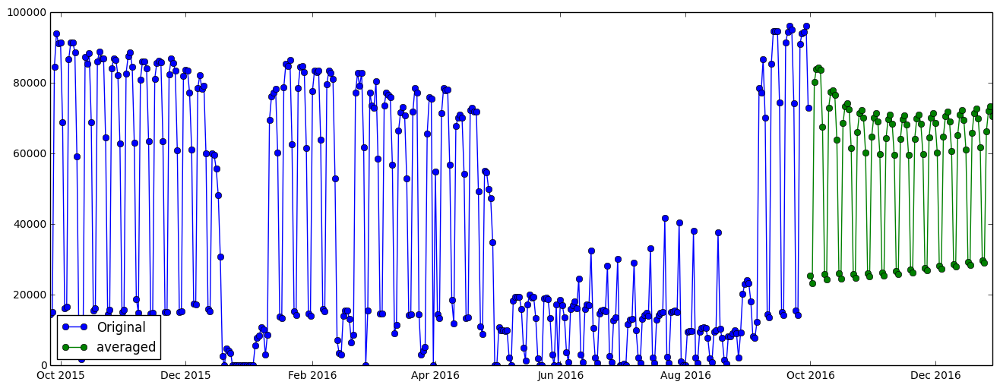

In [248]:
original_sales = pd.Series()
for i in range(16):
    if i == 0:
        original_sales = splitted_data[i]
    else:
        original_sales = original_sales + splitted_data[i]
plt.plot(original_sales.index, original_sales, 'o-', label='Original')   
plt.plot(order_zero.index, (order_zero + order_one)/2, 'o-', label='averaged')
plt.legend(loc='lower left')

In [ ]:
def relative_cont_plot(forecast_90, item):
    category = forecast_90 / total_forecast
#     print 'Category {}: '.format(item), category.mean()
    if category.mean() >= 0.08:
        print 'Category {} Sales Contribution: '.format(item), category.mean()
    _ = plt.plot(category.index, category, '-o', label=item)
    _ = plt.legend(loc='right')
    _ = plt.title('Relative Contribution from Each Category')

print 'Top contributors are...'
_ = map(relative_cont_plot, forecast_90, temp_list)

# Top Down Approach - Build Model and Forecast on All Categories.

In [102]:
original_sales = pd.Series()
for i, df in enumerate(splitted_data):
    if i == 0:
        original_sales = splitted_data[i]
    else:
        original_sales = original_sales + splitted_data[i]

In [103]:
print original_sales.head()
idx = pd.date_range('09-26-2015', '09-30-2016')    

original_sales.index = pd.DatetimeIndex(original_sales.index)
original_sales = original_sales.reindex(idx, fill_value=0)
print original_sales.shape, '-', original_sales.index

print '\n', original_sales.head()

2015-09-26    15537.95
2015-09-27    16093.33
2015-09-28    84535.83
2015-09-29    94145.18
2015-09-30    91173.07
Freq: D, Name: sales, dtype: float64
(371,) - DatetimeIndex(['2015-09-26', '2015-09-27', '2015-09-28', '2015-09-29',
               '2015-09-30', '2015-10-01', '2015-10-02', '2015-10-03',
               '2015-10-04', '2015-10-05',
               ...
               '2016-09-21', '2016-09-22', '2016-09-23', '2016-09-24',
               '2016-09-25', '2016-09-26', '2016-09-27', '2016-09-28',
               '2016-09-29', '2016-09-30'],
              dtype='datetime64[ns]', length=371, freq='D')

2015-09-26    15537.95
2015-09-27    16093.33
2015-09-28    84535.83
2015-09-29    94145.18
2015-09-30    91173.07
Freq: D, Name: sales, dtype: float64


In [119]:
inversed_sales = np.arcsinh(original_sales)

# 1) Forecast on inversed sales, order 0

In [156]:
total_forecast_inversed = model_building(inversed_sales, 'Total')

# Plot.
total_pred_inversed = np.sinh(total_forecast_inversed.predict())
forecast_90_inversed = np.sinh(total_forecast_inversed.forecast(steps=90))

# total_pred_inversed.plot(label='pred')
original_sales.plot(label='original')
forecast_90_inversed.plot(label='forecast')
plt.legend()

could not broadcast input array from shape (0,0) into shape (7,7)
SARIMA(0, 0, 0) (0, 1, 1, 7) AIC=904.619
SARIMA(0, 0, 0) (0, 1, 2, 7) AIC=898.663
SARIMA(0, 0, 0) (0, 1, 3, 7) AIC=891.310
SARIMA(0, 0, 0) (1, 1, 0, 7) AIC=910.275
SARIMA(0, 0, 0) (1, 1, 1, 7) AIC=881.862


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (1, 1, 2, 7) AIC=883.234


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (1, 1, 3, 7) AIC=884.065
SARIMA(0, 0, 0) (2, 1, 0, 7) AIC=908.716
SARIMA(0, 0, 0) (2, 1, 1, 7) AIC=882.027


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=882.056


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 3, 7) AIC=883.738
SARIMA(0, 0, 0) (3, 1, 0, 7) AIC=905.744
SARIMA(0, 0, 0) (3, 1, 1, 7) AIC=883.639


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (3, 1, 2, 7) AIC=883.671


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (3, 1, 3, 7) AIC=884.549
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=814.994
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=760.583
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=750.012
SARIMA(0, 0, 1) (0, 1, 3, 7) AIC=748.525
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=782.678
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=742.665


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=743.931


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (1, 1, 3, 7) AIC=745.931
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=769.861
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=742.851


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=744.918


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 3, 7) AIC=745.329
SARIMA(0, 0, 1) (3, 1, 0, 7) AIC=765.602
SARIMA(0, 0, 1) (3, 1, 1, 7) AIC=743.939


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (3, 1, 2, 7) AIC=745.993


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (3, 1, 3, 7) AIC=746.988
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=777.618
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=696.931
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=692.867
SARIMA(0, 0, 2) (0, 1, 3, 7) AIC=691.999
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=728.561
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=688.875
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=689.666
SARIMA(0, 0, 2) (1, 1, 3, 7) AIC=690.926
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=712.367
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=686.191


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=688.208


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (2, 1, 3, 7) AIC=687.582
SARIMA(0, 0, 2) (3, 1, 0, 7) AIC=709.721
SARIMA(0, 0, 2) (3, 1, 1, 7) AIC=686.239
SARIMA(0, 0, 2) (3, 1, 2, 7) AIC=688.048


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (3, 1, 3, 7) AIC=689.602
SARIMA(0, 0, 3) (0, 1, 0, 7) AIC=nan
SARIMA(0, 0, 3) (0, 1, 1, 7) AIC=nan
SARIMA(0, 0, 3) (0, 1, 2, 7) AIC=nan
SARIMA(0, 0, 3) (0, 1, 3, 7) AIC=nan
SARIMA(0, 0, 3) (1, 1, 0, 7) AIC=nan
SARIMA(0, 0, 3) (1, 1, 1, 7) AIC=nan
SARIMA(0, 0, 3) (1, 1, 2, 7) AIC=nan
SARIMA(0, 0, 3) (1, 1, 3, 7) AIC=nan
SARIMA(0, 0, 3) (2, 1, 0, 7) AIC=nan
SARIMA(0, 0, 3) (2, 1, 1, 7) AIC=nan
SARIMA(0, 0, 3) (2, 1, 2, 7) AIC=nan
SARIMA(0, 0, 3) (2, 1, 3, 7) AIC=nan
SARIMA(0, 0, 3) (3, 1, 0, 7) AIC=nan
SARIMA(0, 0, 3) (3, 1, 1, 7) AIC=nan
SARIMA(0, 0, 3) (3, 1, 2, 7) AIC=nan
SARIMA(0, 0, 3) (3, 1, 3, 7) AIC=nan
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=751.552
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=618.504
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=616.357
SARIMA(1, 0, 0) (0, 1, 3, 7) AIC=618.151
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=688.195
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=615.893


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=617.729


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (1, 1, 3, 7) AIC=619.707
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=651.321
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=617.238


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=619.173
SARIMA(1, 0, 0) (2, 1, 3, 7) AIC=614.599
SARIMA(1, 0, 0) (3, 1, 0, 7) AIC=639.624
SARIMA(1, 0, 0) (3, 1, 1, 7) AIC=614.257


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (3, 1, 2, 7) AIC=616.329


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (3, 1, 3, 7) AIC=615.740
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=749.136
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=606.832
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=605.755
SARIMA(1, 0, 1) (0, 1, 3, 7) AIC=607.242
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=678.919
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=605.243


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=606.991


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (1, 1, 3, 7) AIC=608.817
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=641.461
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=606.020


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=608.446


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 3, 7) AIC=603.820
SARIMA(1, 0, 1) (3, 1, 0, 7) AIC=629.753
SARIMA(1, 0, 1) (3, 1, 1, 7) AIC=603.173


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (3, 1, 2, 7) AIC=605.554


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (3, 1, 3, 7) AIC=605.050
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=750.171
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=606.898
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=605.846
SARIMA(1, 0, 2) (0, 1, 3, 7) AIC=607.516
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=680.442
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=605.492


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=607.430


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 3, 7) AIC=609.336
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=643.441
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=606.706


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=609.083


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 3, 7) AIC=604.871
SARIMA(1, 0, 2) (3, 1, 0, 7) AIC=631.394
SARIMA(1, 0, 2) (3, 1, 1, 7) AIC=604.384


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (3, 1, 2, 7) AIC=606.800


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (3, 1, 3, 7) AIC=606.145
SARIMA(1, 0, 3) (0, 1, 0, 7) AIC=751.701
SARIMA(1, 0, 3) (0, 1, 1, 7) AIC=607.648
SARIMA(1, 0, 3) (0, 1, 2, 7) AIC=606.784
SARIMA(1, 0, 3) (0, 1, 3, 7) AIC=608.381
SARIMA(1, 0, 3) (1, 1, 0, 7) AIC=682.211
SARIMA(1, 0, 3) (1, 1, 1, 7) AIC=606.435


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 3) (1, 1, 2, 7) AIC=608.385


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 3) (1, 1, 3, 7) AIC=610.256
SARIMA(1, 0, 3) (2, 1, 0, 7) AIC=645.041
SARIMA(1, 0, 3) (2, 1, 1, 7) AIC=607.555


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 3) (2, 1, 2, 7) AIC=609.652


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 3) (2, 1, 3, 7) AIC=605.962
SARIMA(1, 0, 3) (3, 1, 0, 7) AIC=633.110
SARIMA(1, 0, 3) (3, 1, 1, 7) AIC=605.382


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 3) (3, 1, 2, 7) AIC=607.601


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 3) (3, 1, 3, 7) AIC=607.203
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=748.607
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=609.163
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=608.024
SARIMA(2, 0, 0) (0, 1, 3, 7) AIC=609.482
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=678.315
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=607.448


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=609.152


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (1, 1, 3, 7) AIC=610.952
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=641.689
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=608.051


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=609.925
SARIMA(2, 0, 0) (2, 1, 3, 7) AIC=605.628
SARIMA(2, 0, 0) (3, 1, 0, 7) AIC=631.052
SARIMA(2, 0, 0) (3, 1, 1, 7) AIC=604.835


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (3, 1, 2, 7) AIC=606.881
SARIMA(2, 0, 0) (3, 1, 3, 7) AIC=606.747
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=750.558
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=605.690
SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=604.512


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (0, 1, 3, 7) AIC=606.207
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=680.315
SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=604.179


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=606.146


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 3, 7) AIC=608.025
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=643.432


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=605.526


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=607.544


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 3, 7) AIC=604.020
SARIMA(2, 0, 1) (3, 1, 0, 7) AIC=631.262
SARIMA(2, 0, 1) (3, 1, 1, 7) AIC=603.600


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (3, 1, 2, 7) AIC=605.644


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (3, 1, 3, 7) AIC=605.975
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=748.557
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=607.626


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=606.331


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 3, 7) AIC=608.040
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=682.617


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=605.947


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=607.996


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 3, 7) AIC=609.831


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=645.434


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=607.213


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=609.288


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 3, 7) AIC=605.751
SARIMA(2, 0, 2) (3, 1, 0, 7) AIC=633.162
SARIMA(2, 0, 2) (3, 1, 1, 7) AIC=605.232


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (3, 1, 2, 7) AIC=607.396


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (3, 1, 3, 7) AIC=607.115
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` se

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 0) (1, 1, 2, 7) AIC=609.081


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 0) (1, 1, 3, 7) AIC=611.024
SARIMA(3, 0, 0) (2, 1, 0, 7) AIC=643.513
SARIMA(3, 0, 0) (2, 1, 1, 7) AIC=608.328


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 0) (2, 1, 2, 7) AIC=610.311


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 0) (2, 1, 3, 7) AIC=606.096
SARIMA(3, 0, 0) (3, 1, 0, 7) AIC=631.958
SARIMA(3, 0, 0) (3, 1, 1, 7) AIC=605.552


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 0) (3, 1, 2, 7) AIC=607.736


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 0) (3, 1, 3, 7) AIC=607.352
SARIMA(3, 0, 1) (0, 1, 0, 7) AIC=745.849
SARIMA(3, 0, 1) (0, 1, 1, 7) AIC=607.612
SARIMA(3, 0, 1) (0, 1, 2, 7) AIC=606.315
SARIMA(3, 0, 1) (0, 1, 3, 7) AIC=607.955
SARIMA(3, 0, 1) (1, 1, 0, 7) AIC=682.312
SARIMA(3, 0, 1) (1, 1, 1, 7) AIC=605.927


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 1) (1, 1, 2, 7) AIC=607.802


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 1) (1, 1, 3, 7) AIC=609.718
SARIMA(3, 0, 1) (2, 1, 0, 7) AIC=645.180
SARIMA(3, 0, 1) (2, 1, 1, 7) AIC=607.169


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 1) (2, 1, 2, 7) AIC=609.137


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 1) (2, 1, 3, 7) AIC=607.979
SARIMA(3, 0, 1) (3, 1, 0, 7) AIC=633.130
SARIMA(3, 0, 1) (3, 1, 1, 7) AIC=605.237


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 1) (3, 1, 2, 7) AIC=607.130


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 1) (3, 1, 3, 7) AIC=609.709
SARIMA(3, 0, 2) (0, 1, 0, 7) AIC=747.950
SARIMA(3, 0, 2) (0, 1, 1, 7) AIC=609.655
SARIMA(3, 0, 2) (0, 1, 2, 7) AIC=608.338
SARIMA(3, 0, 2) (0, 1, 3, 7) AIC=609.984


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 2) (1, 1, 0, 7) AIC=680.087
SARIMA(3, 0, 2) (1, 1, 1, 7) AIC=607.950


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 2) (1, 1, 2, 7) AIC=609.882


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 2) (1, 1, 3, 7) AIC=612.080
SARIMA(3, 0, 2) (2, 1, 0, 7) AIC=644.335
SARIMA(3, 0, 2) (2, 1, 1, 7) AIC=609.208


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 2) (2, 1, 2, 7) AIC=611.265


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 2) (2, 1, 3, 7) AIC=608.062
SARIMA(3, 0, 2) (3, 1, 0, 7) AIC=635.215


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 2) (3, 1, 1, 7) AIC=607.308


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 2) (3, 1, 2, 7) AIC=609.518


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 2) (3, 1, 3, 7) AIC=609.524
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` se

# Forecast on inversed sales, order 1

In [177]:
total_forecast_inversed_order_1 = model_building(inversed_sales, 'Total')

# Plot.
total_pred_inversed_order_1 = np.sinh(total_forecast_inversed_order_1.predict())
forecast_90_inversed_order_1 = np.sinh(total_forecast_inversed_order_1.forecast(steps=90))

# total_pred_inversed_order_1.plot(label='pred')
original_sales.plot(label='original')
forecast_90_inversed_order_1.plot(label='forecast')
plt.legend()

could not broadcast input array from shape (0,0) into shape (8,8)
SARIMA(0, 1, 0) (0, 1, 1, 7) AIC=653.005
SARIMA(0, 1, 0) (0, 1, 2, 7) AIC=652.355
SARIMA(0, 1, 0) (0, 1, 3, 7) AIC=654.354
SARIMA(0, 1, 0) (1, 1, 0, 7) AIC=744.899
SARIMA(0, 1, 0) (1, 1, 1, 7) AIC=652.301
SARIMA(0, 1, 0) (1, 1, 2, 7) AIC=653.797
SARIMA(0, 1, 0) (1, 1, 3, 7) AIC=655.622
SARIMA(0, 1, 0) (2, 1, 0, 7) AIC=695.065
SARIMA(0, 1, 0) (2, 1, 1, 7) AIC=654.219
SARIMA(0, 1, 0) (2, 1, 2, 7) AIC=655.553


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 0) (2, 1, 3, 7) AIC=651.780
SARIMA(0, 1, 0) (3, 1, 0, 7) AIC=678.196
SARIMA(0, 1, 0) (3, 1, 1, 7) AIC=651.023


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 0) (3, 1, 2, 7) AIC=653.108


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 0) (3, 1, 3, 7) AIC=651.941
SARIMA(0, 1, 1) (0, 1, 0, 7) AIC=789.038
SARIMA(0, 1, 1) (0, 1, 1, 7) AIC=621.691
SARIMA(0, 1, 1) (0, 1, 2, 7) AIC=621.381
SARIMA(0, 1, 1) (0, 1, 3, 7) AIC=622.933
SARIMA(0, 1, 1) (1, 1, 0, 7) AIC=704.314
SARIMA(0, 1, 1) (1, 1, 1, 7) AIC=621.072


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 1) (1, 1, 2, 7) AIC=623.008


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 1) (1, 1, 3, 7) AIC=624.793
SARIMA(0, 1, 1) (2, 1, 0, 7) AIC=661.838
SARIMA(0, 1, 1) (2, 1, 1, 7) AIC=622.068


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 1) (2, 1, 2, 7) AIC=624.212


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 1) (2, 1, 3, 7) AIC=620.255
SARIMA(0, 1, 1) (3, 1, 0, 7) AIC=647.720
SARIMA(0, 1, 1) (3, 1, 1, 7) AIC=619.527


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 1) (3, 1, 2, 7) AIC=621.621


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 1) (3, 1, 3, 7) AIC=621.441
SARIMA(0, 1, 2) (0, 1, 0, 7) AIC=789.451
SARIMA(0, 1, 2) (0, 1, 1, 7) AIC=615.984
SARIMA(0, 1, 2) (0, 1, 2, 7) AIC=615.562
SARIMA(0, 1, 2) (0, 1, 3, 7) AIC=617.406
SARIMA(0, 1, 2) (1, 1, 0, 7) AIC=704.830
SARIMA(0, 1, 2) (1, 1, 1, 7) AIC=615.402


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 2) (1, 1, 2, 7) AIC=617.435
SARIMA(0, 1, 2) (1, 1, 3, 7) AIC=619.551
SARIMA(0, 1, 2) (2, 1, 0, 7) AIC=661.780
SARIMA(0, 1, 2) (2, 1, 1, 7) AIC=617.052
SARIMA(0, 1, 2) (2, 1, 2, 7) AIC=619.401


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 2) (2, 1, 3, 7) AIC=616.205
SARIMA(0, 1, 2) (3, 1, 0, 7) AIC=645.747
SARIMA(0, 1, 2) (3, 1, 1, 7) AIC=615.875


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 2) (3, 1, 2, 7) AIC=617.952


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 2) (3, 1, 3, 7) AIC=617.648
SARIMA(0, 1, 3) (0, 1, 0, 7) AIC=786.091
SARIMA(0, 1, 3) (0, 1, 1, 7) AIC=614.938
SARIMA(0, 1, 3) (0, 1, 2, 7) AIC=614.306
SARIMA(0, 1, 3) (0, 1, 3, 7) AIC=616.044
SARIMA(0, 1, 3) (1, 1, 0, 7) AIC=701.874
SARIMA(0, 1, 3) (1, 1, 1, 7) AIC=614.084


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 3) (1, 1, 2, 7) AIC=616.146
SARIMA(0, 1, 3) (1, 1, 3, 7) AIC=618.306
SARIMA(0, 1, 3) (2, 1, 0, 7) AIC=660.046
SARIMA(0, 1, 3) (2, 1, 1, 7) AIC=615.572


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 3) (2, 1, 2, 7) AIC=617.731


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 3) (2, 1, 3, 7) AIC=614.902
SARIMA(0, 1, 3) (3, 1, 0, 7) AIC=645.604
SARIMA(0, 1, 3) (3, 1, 1, 7) AIC=614.444


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 3) (3, 1, 2, 7) AIC=616.607


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 3) (3, 1, 3, 7) AIC=616.388
SARIMA(1, 1, 0) (0, 1, 0, 7) AIC=795.423
SARIMA(1, 1, 0) (0, 1, 1, 7) AIC=630.880
SARIMA(1, 1, 0) (0, 1, 2, 7) AIC=630.604
SARIMA(1, 1, 0) (0, 1, 3, 7) AIC=632.226
SARIMA(1, 1, 0) (1, 1, 0, 7) AIC=711.007
SARIMA(1, 1, 0) (1, 1, 1, 7) AIC=630.292
SARIMA(1, 1, 0) (1, 1, 2, 7) AIC=632.889
SARIMA(1, 1, 0) (1, 1, 3, 7) AIC=634.465
SARIMA(1, 1, 0) (2, 1, 0, 7) AIC=667.830
SARIMA(1, 1, 0) (2, 1, 1, 7) AIC=631.244


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 0) (2, 1, 2, 7) AIC=633.288


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 0) (2, 1, 3, 7) AIC=628.754
SARIMA(1, 1, 0) (3, 1, 0, 7) AIC=655.115
SARIMA(1, 1, 0) (3, 1, 1, 7) AIC=627.638


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 0) (3, 1, 2, 7) AIC=629.700


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 0) (3, 1, 3, 7) AIC=629.447
SARIMA(1, 1, 1) (0, 1, 0, 7) AIC=756.443
SARIMA(1, 1, 1) (0, 1, 1, 7) AIC=612.430
SARIMA(1, 1, 1) (0, 1, 2, 7) AIC=610.888
SARIMA(1, 1, 1) (0, 1, 3, 7) AIC=612.727
SARIMA(1, 1, 1) (1, 1, 0, 7) AIC=702.057
SARIMA(1, 1, 1) (1, 1, 1, 7) AIC=610.643


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 1) (1, 1, 2, 7) AIC=612.758
SARIMA(1, 1, 1) (1, 1, 3, 7) AIC=614.844
SARIMA(1, 1, 1) (2, 1, 0, 7) AIC=659.243
SARIMA(1, 1, 1) (2, 1, 1, 7) AIC=612.356
SARIMA(1, 1, 1) (2, 1, 2, 7) AIC=614.588


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 1) (2, 1, 3, 7) AIC=611.968
SARIMA(1, 1, 1) (3, 1, 0, 7) AIC=643.488
SARIMA(1, 1, 1) (3, 1, 1, 7) AIC=611.606


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 1) (3, 1, 2, 7) AIC=614.045


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 1) (3, 1, 3, 7) AIC=616.103
SARIMA(1, 1, 2) (0, 1, 0, 7) AIC=nan
SARIMA(1, 1, 2) (0, 1, 1, 7) AIC=nan
SARIMA(1, 1, 2) (0, 1, 2, 7) AIC=nan
SARIMA(1, 1, 2) (0, 1, 3, 7) AIC=nan
SARIMA(1, 1, 2) (1, 1, 0, 7) AIC=nan
SARIMA(1, 1, 2) (1, 1, 1, 7) AIC=nan
SARIMA(1, 1, 2) (1, 1, 2, 7) AIC=nan
SARIMA(1, 1, 2) (1, 1, 3, 7) AIC=nan
SARIMA(1, 1, 2) (2, 1, 0, 7) AIC=nan
SARIMA(1, 1, 2) (2, 1, 1, 7) AIC=nan
SARIMA(1, 1, 2) (2, 1, 2, 7) AIC=nan
SARIMA(1, 1, 2) (2, 1, 3, 7) AIC=nan
SARIMA(1, 1, 2) (3, 1, 0, 7) AIC=nan
SARIMA(1, 1, 2) (3, 1, 1, 7) AIC=nan
SARIMA(1, 1, 2) (3, 1, 2, 7) AIC=nan
SARIMA(1, 1, 2) (3, 1, 3, 7) AIC=nan
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_statio

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 1, 0) (1, 1, 2, 7) AIC=626.743
SARIMA(2, 1, 0) (1, 1, 3, 7) AIC=628.868
SARIMA(2, 1, 0) (2, 1, 0, 7) AIC=666.443
SARIMA(2, 1, 0) (2, 1, 1, 7) AIC=626.268
SARIMA(2, 1, 0) (2, 1, 2, 7) AIC=628.670


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 1, 0) (2, 1, 3, 7) AIC=624.322
SARIMA(2, 1, 0) (3, 1, 0, 7) AIC=651.525
SARIMA(2, 1, 0) (3, 1, 1, 7) AIC=623.802


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 1, 0) (3, 1, 2, 7) AIC=626.026


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 1, 0) (3, 1, 3, 7) AIC=625.536
SARIMA(2, 1, 1) (0, 1, 0, 7) AIC=753.266
SARIMA(2, 1, 1) (0, 1, 1, 7) AIC=614.215
SARIMA(2, 1, 1) (0, 1, 2, 7) AIC=612.126
SARIMA(2, 1, 1) (0, 1, 3, 7) AIC=613.788
SARIMA(2, 1, 1) (1, 1, 0, 7) AIC=683.311
SARIMA(2, 1, 1) (1, 1, 1, 7) AIC=611.677


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 1, 1) (1, 1, 2, 7) AIC=613.768
SARIMA(2, 1, 1) (1, 1, 3, 7) AIC=616.125
SARIMA(2, 1, 1) (2, 1, 0, 7) AIC=646.938
SARIMA(2, 1, 1) (2, 1, 1, 7) AIC=613.044
SARIMA(2, 1, 1) (2, 1, 2, 7) AIC=615.677


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 1, 1) (2, 1, 3, 7) AIC=612.348


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 1, 1) (3, 1, 0, 7) AIC=636.515
SARIMA(2, 1, 1) (3, 1, 1, 7) AIC=611.410


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 1, 1) (3, 1, 2, 7) AIC=613.810


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 1, 1) (3, 1, 3, 7) AIC=613.816
SARIMA(2, 1, 2) (0, 1, 0, 7) AIC=nan
SARIMA(2, 1, 2) (0, 1, 1, 7) AIC=nan
SARIMA(2, 1, 2) (0, 1, 2, 7) AIC=nan
SARIMA(2, 1, 2) (0, 1, 3, 7) AIC=nan
SARIMA(2, 1, 2) (1, 1, 0, 7) AIC=nan
SARIMA(2, 1, 2) (1, 1, 1, 7) AIC=nan
SARIMA(2, 1, 2) (1, 1, 2, 7) AIC=nan
SARIMA(2, 1, 2) (1, 1, 3, 7) AIC=nan
SARIMA(2, 1, 2) (2, 1, 0, 7) AIC=nan
SARIMA(2, 1, 2) (2, 1, 1, 7) AIC=nan
SARIMA(2, 1, 2) (2, 1, 2, 7) AIC=nan
SARIMA(2, 1, 2) (2, 1, 3, 7) AIC=nan
SARIMA(2, 1, 2) (3, 1, 0, 7) AIC=nan
SARIMA(2, 1, 2) (3, 1, 1, 7) AIC=nan
SARIMA(2, 1, 2) (3, 1, 2, 7) AIC=nan
SARIMA(2, 1, 2) (3, 1, 3, 7) AIC=nan
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_statio

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 0) (1, 1, 2, 7) AIC=624.464
SARIMA(3, 1, 0) (1, 1, 3, 7) AIC=626.701
SARIMA(3, 1, 0) (2, 1, 0, 7) AIC=665.189
SARIMA(3, 1, 0) (2, 1, 1, 7) AIC=623.853


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 0) (2, 1, 2, 7) AIC=625.971
SARIMA(3, 1, 0) (2, 1, 3, 7) AIC=622.318
SARIMA(3, 1, 0) (3, 1, 0, 7) AIC=650.269
SARIMA(3, 1, 0) (3, 1, 1, 7) AIC=621.772


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 0) (3, 1, 2, 7) AIC=623.836


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 0) (3, 1, 3, 7) AIC=623.789
SARIMA(3, 1, 1) (0, 1, 0, 7) AIC=755.196
SARIMA(3, 1, 1) (0, 1, 1, 7) AIC=616.125
SARIMA(3, 1, 1) (0, 1, 2, 7) AIC=613.891
SARIMA(3, 1, 1) (0, 1, 3, 7) AIC=615.469


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 1) (1, 1, 0, 7) AIC=685.307
SARIMA(3, 1, 1) (1, 1, 1, 7) AIC=613.340


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 1) (1, 1, 2, 7) AIC=615.488


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 1) (1, 1, 3, 7) AIC=617.641


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 1) (2, 1, 0, 7) AIC=648.716
SARIMA(3, 1, 1) (2, 1, 1, 7) AIC=614.555


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 1) (2, 1, 2, 7) AIC=617.165


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 1) (2, 1, 3, 7) AIC=613.305
SARIMA(3, 1, 1) (3, 1, 0, 7) AIC=637.316


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 1) (3, 1, 1, 7) AIC=612.517


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 1) (3, 1, 2, 7) AIC=614.647


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 1) (3, 1, 3, 7) AIC=614.742
SARIMA(3, 1, 2) (0, 1, 0, 7) AIC=nan
SARIMA(3, 1, 2) (0, 1, 1, 7) AIC=nan
SARIMA(3, 1, 2) (0, 1, 2, 7) AIC=nan
SARIMA(3, 1, 2) (0, 1, 3, 7) AIC=nan
SARIMA(3, 1, 2) (1, 1, 0, 7) AIC=nan
SARIMA(3, 1, 2) (1, 1, 1, 7) AIC=nan
SARIMA(3, 1, 2) (1, 1, 2, 7) AIC=nan
SARIMA(3, 1, 2) (1, 1, 3, 7) AIC=nan
SARIMA(3, 1, 2) (2, 1, 0, 7) AIC=nan
SARIMA(3, 1, 2) (2, 1, 1, 7) AIC=nan
SARIMA(3, 1, 2) (2, 1, 2, 7) AIC=nan
SARIMA(3, 1, 2) (2, 1, 3, 7) AIC=nan
SARIMA(3, 1, 2) (3, 1, 0, 7) AIC=nan
SARIMA(3, 1, 2) (3, 1, 1, 7) AIC=nan
SARIMA(3, 1, 2) (3, 1, 2, 7) AIC=nan
SARIMA(3, 1, 2) (3, 1, 3, 7) AIC=nan
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_statio

# Forecast on original sales. Order 1

could not broadcast input array from shape (0,0) into shape (8,8)
SARIMA(0, 1, 0) (0, 1, 1, 7) AIC=8018.076
SARIMA(0, 1, 0) (0, 1, 2, 7) AIC=8000.468
SARIMA(0, 1, 0) (0, 1, 3, 7) AIC=7995.907
SARIMA(0, 1, 0) (1, 1, 0, 7) AIC=8037.734
SARIMA(0, 1, 0) (1, 1, 1, 7) AIC=7989.133
SARIMA(0, 1, 0) (1, 1, 2, 7) AIC=7990.548


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 0) (1, 1, 3, 7) AIC=7993.106
SARIMA(0, 1, 0) (2, 1, 0, 7) AIC=8024.672
SARIMA(0, 1, 0) (2, 1, 1, 7) AIC=7988.875


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 0) (2, 1, 2, 7) AIC=7990.942


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 0) (2, 1, 3, 7) AIC=7992.985
SARIMA(0, 1, 0) (3, 1, 0, 7) AIC=8025.144
SARIMA(0, 1, 0) (3, 1, 1, 7) AIC=7990.249
SARIMA(0, 1, 0) (3, 1, 2, 7) AIC=7991.616


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 0) (3, 1, 3, 7) AIC=7993.315
SARIMA(0, 1, 1) (0, 1, 0, 7) AIC=8059.054
SARIMA(0, 1, 1) (0, 1, 1, 7) AIC=8010.882
SARIMA(0, 1, 1) (0, 1, 2, 7) AIC=8001.758
SARIMA(0, 1, 1) (0, 1, 3, 7) AIC=7997.761
SARIMA(0, 1, 1) (1, 1, 0, 7) AIC=8026.036
SARIMA(0, 1, 1) (1, 1, 1, 7) AIC=7991.833


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 1) (1, 1, 2, 7) AIC=7982.196


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 1) (1, 1, 3, 7) AIC=7995.142
SARIMA(0, 1, 1) (2, 1, 0, 7) AIC=8017.027
SARIMA(0, 1, 1) (2, 1, 1, 7) AIC=7992.247


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 1) (2, 1, 2, 7) AIC=7994.263


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 1) (2, 1, 3, 7) AIC=7996.055
SARIMA(0, 1, 1) (3, 1, 0, 7) AIC=8016.041
SARIMA(0, 1, 1) (3, 1, 1, 7) AIC=7994.138
SARIMA(0, 1, 1) (3, 1, 2, 7) AIC=7995.817


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 1) (3, 1, 3, 7) AIC=7996.697
SARIMA(0, 1, 2) (0, 1, 0, 7) AIC=8059.327
SARIMA(0, 1, 2) (0, 1, 1, 7) AIC=8000.072
SARIMA(0, 1, 2) (0, 1, 2, 7) AIC=7990.387
SARIMA(0, 1, 2) (0, 1, 3, 7) AIC=7988.955
SARIMA(0, 1, 2) (1, 1, 0, 7) AIC=8022.064
SARIMA(0, 1, 2) (1, 1, 1, 7) AIC=7984.647


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 2) (1, 1, 2, 7) AIC=7972.046


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 2) (1, 1, 3, 7) AIC=7988.049
SARIMA(0, 1, 2) (2, 1, 0, 7) AIC=8009.506
SARIMA(0, 1, 2) (2, 1, 1, 7) AIC=7985.213


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 2) (2, 1, 2, 7) AIC=7987.213
SARIMA(0, 1, 2) (2, 1, 3, 7) AIC=7988.692
SARIMA(0, 1, 2) (3, 1, 0, 7) AIC=8008.087
SARIMA(0, 1, 2) (3, 1, 1, 7) AIC=7986.726
SARIMA(0, 1, 2) (3, 1, 2, 7) AIC=7988.418


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 2) (3, 1, 3, 7) AIC=7989.751
SARIMA(0, 1, 3) (0, 1, 0, 7) AIC=8061.443
SARIMA(0, 1, 3) (0, 1, 1, 7) AIC=7993.430
SARIMA(0, 1, 3) (0, 1, 2, 7) AIC=7981.611
SARIMA(0, 1, 3) (0, 1, 3, 7) AIC=7979.971
SARIMA(0, 1, 3) (1, 1, 0, 7) AIC=8018.551
SARIMA(0, 1, 3) (1, 1, 1, 7) AIC=7975.928


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 3) (1, 1, 2, 7) AIC=7977.338


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 3) (1, 1, 3, 7) AIC=7979.319
SARIMA(0, 1, 3) (2, 1, 0, 7) AIC=8004.658
SARIMA(0, 1, 3) (2, 1, 1, 7) AIC=7976.594


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 3) (2, 1, 2, 7) AIC=7978.596


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 3) (2, 1, 3, 7) AIC=7980.131
SARIMA(0, 1, 3) (3, 1, 0, 7) AIC=8002.998
SARIMA(0, 1, 3) (3, 1, 1, 7) AIC=7978.214
SARIMA(0, 1, 3) (3, 1, 2, 7) AIC=7979.785


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 3) (3, 1, 3, 7) AIC=7980.398
SARIMA(1, 1, 0) (0, 1, 0, 7) AIC=8061.906
SARIMA(1, 1, 0) (0, 1, 1, 7) AIC=8013.645
SARIMA(1, 1, 0) (0, 1, 2, 7) AIC=8003.789
SARIMA(1, 1, 0) (0, 1, 3, 7) AIC=7999.889
SARIMA(1, 1, 0) (1, 1, 0, 7) AIC=8029.266
SARIMA(1, 1, 0) (1, 1, 1, 7) AIC=7994.035
SARIMA(1, 1, 0) (1, 1, 2, 7) AIC=7985.060


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 0) (1, 1, 3, 7) AIC=7997.399
SARIMA(1, 1, 0) (2, 1, 0, 7) AIC=8019.885
SARIMA(1, 1, 0) (2, 1, 1, 7) AIC=7994.565


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 0) (2, 1, 2, 7) AIC=7996.586


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 0) (2, 1, 3, 7) AIC=7998.304
SARIMA(1, 1, 0) (3, 1, 0, 7) AIC=8018.896
SARIMA(1, 1, 0) (3, 1, 1, 7) AIC=7996.440
SARIMA(1, 1, 0) (3, 1, 2, 7) AIC=7998.047


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 0) (3, 1, 3, 7) AIC=7998.715
SARIMA(1, 1, 1) (0, 1, 0, 7) AIC=8027.573
SARIMA(1, 1, 1) (0, 1, 1, 7) AIC=7988.577
SARIMA(1, 1, 1) (0, 1, 2, 7) AIC=7979.969
SARIMA(1, 1, 1) (0, 1, 3, 7) AIC=7977.463
SARIMA(1, 1, 1) (1, 1, 0, 7) AIC=8001.454
SARIMA(1, 1, 1) (1, 1, 1, 7) AIC=7972.172


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 1) (1, 1, 2, 7) AIC=7966.040


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 1) (1, 1, 3, 7) AIC=7975.781
SARIMA(1, 1, 1) (2, 1, 0, 7) AIC=7992.989
SARIMA(1, 1, 1) (2, 1, 1, 7) AIC=7973.325


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 1) (2, 1, 2, 7) AIC=7975.344


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 1) (2, 1, 3, 7) AIC=7977.003
SARIMA(1, 1, 1) (3, 1, 0, 7) AIC=7992.996
SARIMA(1, 1, 1) (3, 1, 1, 7) AIC=7975.192
SARIMA(1, 1, 1) (3, 1, 2, 7) AIC=7976.726


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 1) (3, 1, 3, 7) AIC=7977.346


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 2) (0, 1, 0, 7) AIC=8029.622


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 2) (0, 1, 1, 7) AIC=7990.259
SARIMA(1, 1, 2) (0, 1, 2, 7) AIC=7981.853
SARIMA(1, 1, 2) (0, 1, 3, 7) AIC=7979.590


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 2) (1, 1, 0, 7) AIC=8003.538
SARIMA(1, 1, 2) (1, 1, 1, 7) AIC=7974.363


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 2) (1, 1, 2, 7) AIC=7976.044


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 2) (1, 1, 3, 7) AIC=7977.990


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 2) (2, 1, 0, 7) AIC=7995.101


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 2) (2, 1, 1, 7) AIC=7975.489


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 2) (2, 1, 2, 7) AIC=7977.543


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 2) (2, 1, 3, 7) AIC=7979.187


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 2) (3, 1, 0, 7) AIC=7994.986


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 2) (3, 1, 1, 7) AIC=7977.363
SARIMA(1, 1, 2) (3, 1, 2, 7) AIC=7978.913


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 2) (3, 1, 3, 7) AIC=7979.603
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` s

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 1, 0) (1, 1, 2, 7) AIC=7980.584


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 1, 0) (1, 1, 3, 7) AIC=7993.572
SARIMA(2, 1, 0) (2, 1, 0, 7) AIC=8015.105
SARIMA(2, 1, 0) (2, 1, 1, 7) AIC=7990.690


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 1, 0) (2, 1, 2, 7) AIC=7992.698
SARIMA(2, 1, 0) (2, 1, 3, 7) AIC=7994.260
SARIMA(2, 1, 0) (3, 1, 0, 7) AIC=8013.770
SARIMA(2, 1, 0) (3, 1, 1, 7) AIC=7992.342
SARIMA(2, 1, 0) (3, 1, 2, 7) AIC=7994.022


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 1, 0) (3, 1, 3, 7) AIC=7995.302
SARIMA(2, 1, 1) (0, 1, 0, 7) AIC=8027.817
SARIMA(2, 1, 1) (0, 1, 1, 7) AIC=7990.044
SARIMA(2, 1, 1) (0, 1, 2, 7) AIC=7981.525
SARIMA(2, 1, 1) (0, 1, 3, 7) AIC=7979.212
SARIMA(2, 1, 1) (1, 1, 0, 7) AIC=8002.155
SARIMA(2, 1, 1) (1, 1, 1, 7) AIC=7973.962


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 1, 1) (1, 1, 2, 7) AIC=7965.989


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 1, 1) (1, 1, 3, 7) AIC=7977.548
SARIMA(2, 1, 1) (2, 1, 0, 7) AIC=7994.403
SARIMA(2, 1, 1) (2, 1, 1, 7) AIC=7975.084


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 1, 1) (2, 1, 2, 7) AIC=7977.125


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 1, 1) (2, 1, 3, 7) AIC=7978.798
SARIMA(2, 1, 1) (3, 1, 0, 7) AIC=7994.399
SARIMA(2, 1, 1) (3, 1, 1, 7) AIC=7976.957
SARIMA(2, 1, 1) (3, 1, 2, 7) AIC=7978.499


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 1, 1) (3, 1, 3, 7) AIC=7979.339
SARIMA(2, 1, 2) (0, 1, 0, 7) AIC=nan
SARIMA(2, 1, 2) (0, 1, 1, 7) AIC=nan
SARIMA(2, 1, 2) (0, 1, 2, 7) AIC=nan
SARIMA(2, 1, 2) (0, 1, 3, 7) AIC=nan
SARIMA(2, 1, 2) (1, 1, 0, 7) AIC=nan
SARIMA(2, 1, 2) (1, 1, 1, 7) AIC=nan
SARIMA(2, 1, 2) (1, 1, 2, 7) AIC=nan
SARIMA(2, 1, 2) (1, 1, 3, 7) AIC=nan
SARIMA(2, 1, 2) (2, 1, 0, 7) AIC=nan
SARIMA(2, 1, 2) (2, 1, 1, 7) AIC=nan
SARIMA(2, 1, 2) (2, 1, 2, 7) AIC=nan
SARIMA(2, 1, 2) (2, 1, 3, 7) AIC=nan
SARIMA(2, 1, 2) (3, 1, 0, 7) AIC=nan
SARIMA(2, 1, 2) (3, 1, 1, 7) AIC=nan
SARIMA(2, 1, 2) (3, 1, 2, 7) AIC=nan
SARIMA(2, 1, 2) (3, 1, 3, 7) AIC=nan
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stati

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 0) (1, 1, 2, 7) AIC=7986.498


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 0) (1, 1, 3, 7) AIC=7994.202
SARIMA(3, 1, 0) (2, 1, 0, 7) AIC=8016.132
SARIMA(3, 1, 0) (2, 1, 1, 7) AIC=7991.291


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 0) (2, 1, 2, 7) AIC=7993.300
SARIMA(3, 1, 0) (2, 1, 3, 7) AIC=7994.904
SARIMA(3, 1, 0) (3, 1, 0, 7) AIC=8014.844
SARIMA(3, 1, 0) (3, 1, 1, 7) AIC=7992.987
SARIMA(3, 1, 0) (3, 1, 2, 7) AIC=7994.653


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 0) (3, 1, 3, 7) AIC=7995.795
SARIMA(3, 1, 1) (0, 1, 0, 7) AIC=8029.790
SARIMA(3, 1, 1) (0, 1, 1, 7) AIC=7991.280
SARIMA(3, 1, 1) (0, 1, 2, 7) AIC=7983.390
SARIMA(3, 1, 1) (0, 1, 3, 7) AIC=7981.170
SARIMA(3, 1, 1) (1, 1, 0, 7) AIC=8004.035
SARIMA(3, 1, 1) (1, 1, 1, 7) AIC=7975.889


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 1) (1, 1, 2, 7) AIC=7976.469


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 1) (1, 1, 3, 7) AIC=7979.502
SARIMA(3, 1, 1) (2, 1, 0, 7) AIC=7995.873
SARIMA(3, 1, 1) (2, 1, 1, 7) AIC=7976.967


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 1) (2, 1, 2, 7) AIC=7979.011


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 1) (2, 1, 3, 7) AIC=7980.676
SARIMA(3, 1, 1) (3, 1, 0, 7) AIC=7995.739
SARIMA(3, 1, 1) (3, 1, 1, 7) AIC=7978.799
SARIMA(3, 1, 1) (3, 1, 2, 7) AIC=7980.352


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 1) (3, 1, 3, 7) AIC=7981.139
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` s

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Category Total:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(2, 1, 1)x(1, 1, 2, 7)   Log Likelihood               -3975.995
Date:                           Mon, 27 Feb 2017   AIC                           7965.989
Time:                                   01:13:14   BIC                           7993.402
Sample:                               09-26-2015   HQIC                          7976.877
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6863      0.049     13.928      0.000       0.590       0.783
ar.L2          0.0507     

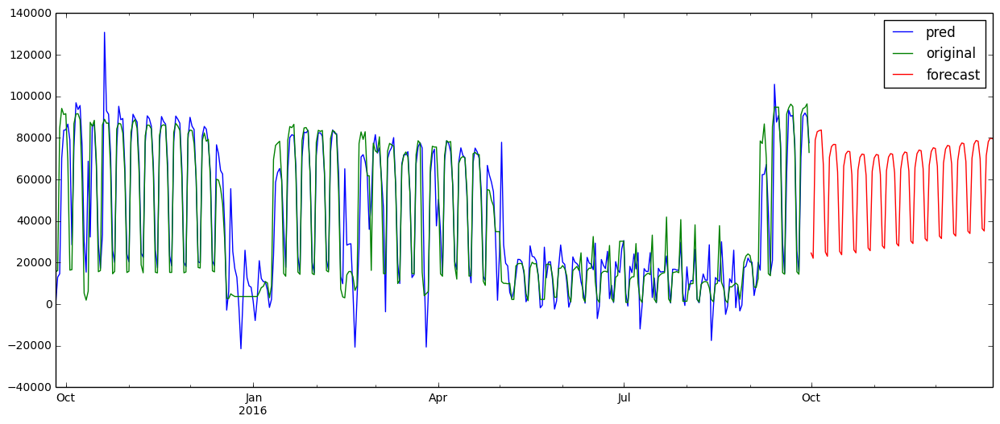

In [190]:
total_forecast = model_building(original_sales, 'Total')

# Plot.
total_pred = total_forecast.predict()
forecast_90 = total_forecast.forecast(steps=90)

total_pred.plot(label='pred')
original_sales.plot(label='original')
forecast_90.plot(label='forecast')
plt.legend()

# Plots to compare diff models.

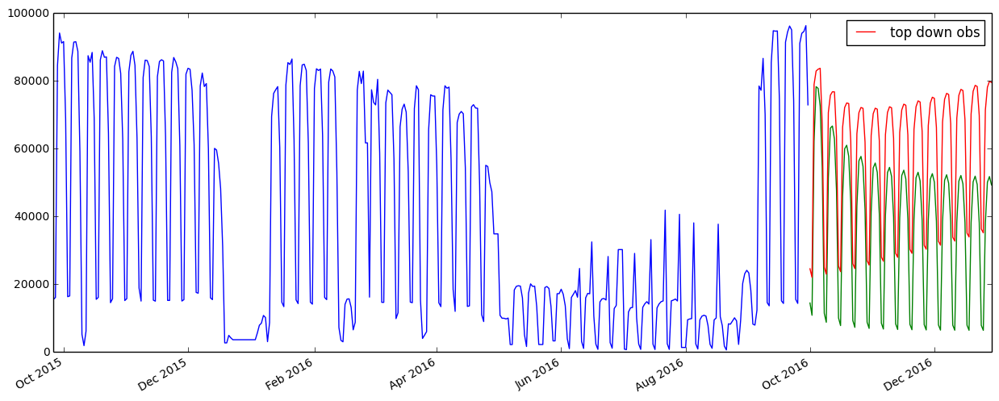

In [194]:
sum_forecast_inv = sum_forecast(forecast_inv) # Bottom up approach, order 0.
# forecast_90_inversed.plot(label='top down inverse') # Top down, order 0.
forecast_90.plot(label='top down obs') # Top down, order 1.
# forecast_90_inversed_order_1.plot(label='order 1')
plt.legend()

# Averaging models.

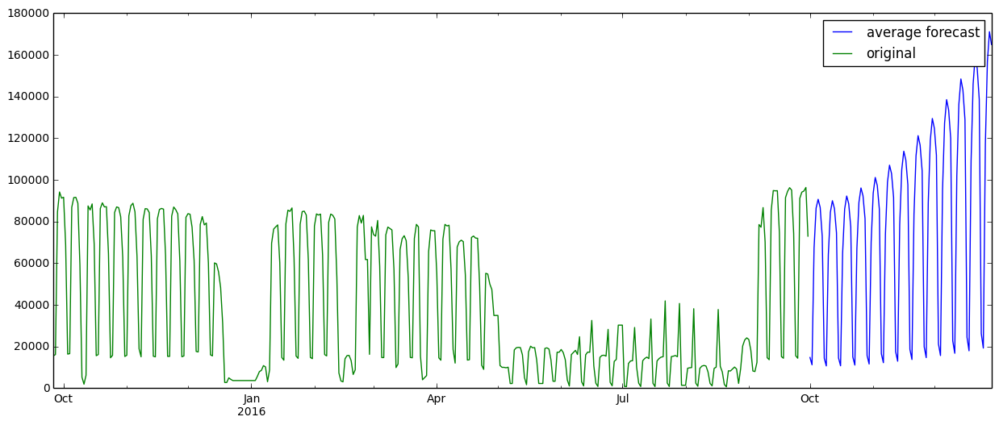

In [189]:
avg_forecast = (sum_forecast_inv + forecast_90_inversed_order_1) / 2
avg_forecast.plot(label='average forecast')
original_sales.plot(label='original')
plt.legend()

In [127]:
print 'Observed: ', rmse_measurement(original_sales, total_pred, 'Total')
print 'Inversed: ', rmse_measurement(original_sales, total_pred_inversed, 'Total')

Observed:  14352.9738171
Inversed:  17804.5435246


# Summary
## 1) Statistical tests suggest
### - We have lags and seasonal effects in the data
### - So we need to use seasonal ARIMA model as opposed to regular ARIMA model
### - The SARIMA models for each category will be slightly different, but shouldn't deviate too much from order 1
## 2) SARIMA models were used for forecasting each category
### - Category E: (1, 1, 1)x(0, 1, 1, 7)
### - Category M: (0, 1, 1)x(1, 1, 1, 7)
### - All other categories: (1, 1, 1)x(1, 1, 1, 7)
## 3) We also used a top down approach (directly forecast without breaking down the categories)
### - Top down approach (RMSE=14,958)
### - Bottom up approach (RMSE=17,118)
### - Seems like top down was able to generalize the time series better, it's interesting because one would expect the opposite
### - But it could be the top down method is overfitting, so further validation is needed.
## 4) What could be improved?
### - More data: if we have 5 years of data, we can definitely build more accurate models.
### - More features: we could use weather data to see how climate affects sales in diff categories
### - More features: also features like promotion or not, number of competitors nearby would also help
### - Diff models: we could try xgboost